In [383]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sqlite3 as sq
from datetime import datetime, timedelta, date
from netaddr import IPNetwork
import re
from pprint import pprint
from IPython.display import Markdown, display, HTML
import matplotlib.ticker as mtick
import scipy.stats as stats

In [2]:
display(HTML("<style>.container { width:80% !important; }</style>"))

def printmd(string):
    display(Markdown(string))

In [3]:
protocols = ['QUIC', 'TLS', 'HTTPS', 'TCP', 'UDP']

In [4]:
connection = sq.connect("./performance-measurements/merged-web-new.db")
connection.row_factory = sq.Row

In [270]:
query = """
SELECT id, domain, protocol, server, vantagePoint, requestStart, responseStart, firstContentfulPaint, loadEventStart, loadEventEnd, encodedBodySize, decodedBodySize, transferSize, timestamp, redirectEnd
FROM measurements 
WHERE (error = "" or error is null) AND cacheWarming = 0
"""
df1 = pd.read_sql(query, connection, index_col="id")
df1.head()

,domain,protocol,server,vantagePoint,requestStart,responseStart,firstContentfulPaint,loadEventStart,loadEventEnd,encodedBodySize,decodedBodySize,transferSize,timestamp,redirectEnd
id,,,,,,,,,,,,,,
71056cec-5bea-e3b9-0772-7ffeaac7ef95,www.google.com,tls,64.225.50.86,US East,74.3,156.6,265.7,976.1,980.0,44006.0,135410,44306,2022-02-26 00:01:17.547539,0.0
49be49aa-5f8b-16a2-cb6b-60c01b3ac208,www.netflix.com,tls,64.225.50.86,US East,197.5,468.3,695.4,1150.4,1150.4,39860.0,290764,40160,2022-02-26 00:01:22.082721,0.0
e2d4ad1d-927c-089c-b726-463e24905b23,www.youtube.com,tls,64.225.50.86,US East,72.7,126.5,315.5,1417.0,1417.5,65084.0,689687,65384,2022-02-26 00:01:27.499763,0.0
32c86f00-b092-6167-c782-269892844973,www.facebook.com,tls,64.225.50.86,US East,75.0,164.1,373.9,628.5,633.4,23831.0,80242,24131,2022-02-26 00:01:32.457141,0.0
f5605a19-2faf-8b6c-7b72-1686498382a7,www.microsoft.com,tls,64.225.50.86,US East,100.1,480.6,1472.8,1460.8,1475.7,45729.0,214760,46029,2022-02-26 00:01:36.623494,99.4


In [130]:
domain_order = df1.head(12)['domain'].tolist()

In [271]:
query = """
SELECT measurement_id, MAX(elapsed), MIN(elapsed), AVG(elapsed), COUNT(answer)
FROM lookups 
WHERE status = "NOERROR"
GROUP BY measurement_id
"""
df2 = pd.read_sql(query, connection, index_col="measurement_id")
df2.index.names = ['id']
df2.rename({'MAX(elapsed)': 'max_lookup_end', 'MIN(elapsed)': 'min_lookup_end', 'AVG(elapsed)': 'avg_lookup_end', 'COUNT(answer)': 'queries'}, axis=1, inplace=True)
df2.head()

,max_lookup_end,min_lookup_end,avg_lookup_end,queries
id,,,,
000006c3-f044-73f9-0d70-9c56b72cbe53,236.500189,115.456986,155.876260,3
000007e9-226d-5b66-13ea-7c150a3737e7,10.443566,2.748022,6.374078,3
000016e5-0039-8f6d-1ab1-25f6a9b1787b,25.609517,25.609517,25.609517,1
00002b1d-03fe-bd70-5735-a0b8e6ad9505,23.835989,9.122182,11.587377,9
00005be3-86d2-a728-fad6-2aa1907c1207,9.995469,2.338816,4.386341,4


In [272]:
query = """
SELECT measurement_id, answer, elapsed
FROM lookups
WHERE 
(domain = "www.google.com."
OR domain = "www.youtube.com."
OR domain = "www.facebook.com."
OR domain = "www.netflix.com."
OR domain = "www.microsoft.com."
OR domain = "twitter.com."
OR domain = "www.instagram.com."
OR domain = "www.linkedin.com."
OR domain = "www.apple.com."
OR domain = "www.wikipedia.org."
OR domain = "www.baidu.com."
OR domain = "www.amazon.com.")
GROUP BY measurement_id
"""
df3 = pd.read_sql(query, connection, index_col="measurement_id")
df3.index.names = ['id']
df3.head()

,answer,elapsed
id,,
000006c3-f044-73f9-0d70-9c56b72cbe53,"www.facebook.com.,17,IN,CNAME,star-mini.c10r.f...",236.500189
000007e9-226d-5b66-13ea-7c150a3737e7,"twitter.com.,1627,IN,A,104.244.42.1|twitter.co...",10.443566
000016e5-0039-8f6d-1ab1-25f6a9b1787b,"www.instagram.com.,632,IN,CNAME,geo-p42.instag...",25.609517
00002b1d-03fe-bd70-5735-a0b8e6ad9505,"www.google.com.,173,IN,A,172.217.161.36|",11.270360
00005be3-86d2-a728-fad6-2aa1907c1207,"twitter.com.,1093,IN,A,104.244.42.65|twitter.c...",9.995469


In [273]:
df = pd.merge(df1, df2, 'left', on='id')
df = pd.merge(df, df3, 'left', on='id')
df['protocol'] = df['protocol'].str.upper()
df['timestamp'] = pd.to_datetime(df['timestamp'])
df.head(11)

,domain,protocol,server,vantagePoint,requestStart,responseStart,firstContentfulPaint,loadEventStart,loadEventEnd,encodedBodySize,decodedBodySize,transferSize,timestamp,redirectEnd,max_lookup_end,min_lookup_end,avg_lookup_end,queries,answer,elapsed
id,,,,,,,,,,,,,,,,,,,,
71056cec-5bea-e3b9-0772-7ffeaac7ef95,www.google.com,TLS,64.225.50.86,US East,74.3,156.6,265.7,976.1,980.0,44006.0,135410,44306,2022-02-26 00:01:17.547539,0.0,22.870604,7.476486,10.247104,7,"www.google.com.,178,IN,A,142.251.35.164|",22.870604
49be49aa-5f8b-16a2-cb6b-60c01b3ac208,www.netflix.com,TLS,64.225.50.86,US East,197.5,468.3,695.4,1150.4,1150.4,39860.0,290764,40160,2022-02-26 00:01:22.082721,0.0,22.727574,7.373224,12.758572,6,"www.netflix.com.,22,IN,CNAME,www.dradis.netfli...",22.705402
e2d4ad1d-927c-089c-b726-463e24905b23,www.youtube.com,TLS,64.225.50.86,US East,72.7,126.5,315.5,1417.0,1417.5,65084.0,689687,65384,2022-02-26 00:01:27.499763,0.0,22.902655,7.492171,10.748737,6,"www.youtube.com.,52,IN,CNAME,youtube-ui.l.goog...",22.902655
32c86f00-b092-6167-c782-269892844973,www.facebook.com,TLS,64.225.50.86,US East,75.0,164.1,373.9,628.5,633.4,23831.0,80242,24131,2022-02-26 00:01:32.457141,0.0,22.388064,7.457388,12.559182,3,"www.facebook.com.,45,IN,CNAME,star-mini.c10r.f...",22.388064
f5605a19-2faf-8b6c-7b72-1686498382a7,www.microsoft.com,TLS,64.225.50.86,US East,100.1,480.6,1472.8,1460.8,1475.7,45729.0,214760,46029,2022-02-26 00:01:36.623494,99.4,33.393071,7.321926,11.939380,10,"www.microsoft.com.,4,IN,CNAME,www.microsoft.co...",22.918156
4433a025-996d-a8e1-4711-f7290162cb6e,twitter.com,TLS,64.225.50.86,US East,90.5,141.6,227.1,658.6,658.6,20147.0,93591,20447,2022-02-26 00:01:41.483109,0.0,22.938248,7.487187,11.716558,4,"twitter.com.,353,IN,A,104.244.42.65|twitter.co...",22.938248
8b929577-755a-8866-044c-fc8a00126538,www.instagram.com,TLS,64.225.50.86,US East,126.5,277.3,0.0,362.0,362.1,20643.0,20643,20943,2022-02-26 00:01:45.480609,125.3,23.797426,23.797426,23.797426,1,"www.instagram.com.,18,IN,CNAME,geo-p42.instagr...",23.797426
5dc821e3-4378-6285-432d-153761c0da5b,www.baidu.com,TLS,64.225.50.86,US East,201.1,443.4,691.4,1682.2,1686.7,85320.0,343638,85620,2022-02-26 00:01:51.576838,0.0,22.972880,7.431210,12.707272,6,"www.baidu.com.,196,IN,CNAME,www.a.shifen.com.|...",22.959162
47ef940e-9e83-092d-fe1e-8256d611247d,www.linkedin.com,TLS,64.225.50.86,US East,59.5,211.7,368.5,393.2,393.3,12345.0,108070,12645,2022-02-26 00:01:56.460028,0.0,23.877657,7.491783,13.755629,5,"www.linkedin.com.,102,IN,CNAME,www-linkedin-co...",22.317511


In [274]:
# order vantage Points
vp_order = ['US East', 'US West', 'South America East', 'Europe Central', 'Asia Pacific Southeast', 'Asia Pacific Northeast', 'Africa South']
# Limit results to these resolvers
limited_df = pd.DataFrame()
df_resolvers = df.groupby(['vantagePoint', 'server'])['server'].count().reset_index(name="count").sort_values(by=['vantagePoint', 'count'], ascending=False).reset_index(drop=True)
for vp in vp_order:
    df_vp = df_resolvers[df_resolvers['vantagePoint'] == vp]
    i = 1
    for row in df_vp.itertuples():
        df_1 = df[df['vantagePoint'] == row.vantagePoint]
        df_2 = df_1[df_1['server'] == row.server]
        limited_df = pd.concat([limited_df, df_2])
        if i > 4:
            break
        i+=1
print(len(limited_df))

175128


In [275]:
df = limited_df

In [276]:
# Add an approximation for the rtt to the dataframe
df_udp = df[df['protocol'] == 'UDP']
df_udp = df_udp[['server', 'vantagePoint', 'elapsed', 'timestamp']]
approx_rtt = []
last_server = ''

for index, row in df.iterrows():
    current_server = row.server
    if current_server != last_server:
        last_server = current_server
        time_slice = df_udp[(df_udp['timestamp'] > row.timestamp - timedelta(minutes = 60)) & (df_udp['timestamp'] < row.timestamp + timedelta(minutes = 60))].copy()
        time_slice = time_slice.groupby(['server', 'vantagePoint'], as_index=False, sort=False).mean()
    approx_rtt.append(float(time_slice[(time_slice['vantagePoint']==row.vantagePoint) & (time_slice['server']==current_server)]['elapsed']))
df['approx_rtt'] = approx_rtt

In [277]:
# Calculate the rts
rts = []
for index, row in df.iterrows():
    rt = row.elapsed / row.approx_rtt
    rts.append(rt)
df['rts'] = rts

In [278]:
# some metrics
df['timeByTransferSize'] = df['loadEventStart'] / df['transferSize']
df['timeByDecodedSize'] = df['loadEventStart'] / df['decodedBodySize']
df['difLookupFcp'] = df['firstContentfulPaint'] - df['max_lookup_end']
df['difFcpEnd'] = df['loadEventStart'] - df['firstContentfulPaint']
df['difLookupEnd'] = df['loadEventStart'] - df['elapsed']
df['serverRTT'] = df['responseStart'] - df['requestStart']

In [123]:
# order by average number of queries
df_new = df[['domain', 'queries']].copy()
df_new = df_new.groupby('domain').agg('mean')
df_new = df_new.sort_values('queries')
domain_order = df_new.index.tolist()

# Functions

In [332]:
def datespan(startDate, endDate, delta=timedelta(days=1)):
    currentDate = startDate
    while currentDate < endDate:
        yield currentDate
        currentDate += delta

In [124]:
def annotate_medians(ax, m1):
    mL1 = [str(int(s)) for s in m1]
    ind = 0
    offset = 0.16
    for tick in range(len(ax.get_yticklabels())):
        ax.text(m1[ind], tick-2*offset, mL1[ind],  verticalalignment='center',  color='black', weight='normal')
        ax.text(m1[ind+1], tick-offset, mL1[ind+1],  verticalalignment='center',  color='black', weight='normal')
        ax.text(m1[ind+2], tick, mL1[ind+2],  verticalalignment='center',  color='black', weight='normal')
        ax.text(m1[ind+3], tick+offset, mL1[ind+3],  verticalalignment='center',  color='black', weight='normal')
        ax.text(m1[ind+4], tick+2*offset, mL1[ind+4],  verticalalignment='center',  color='black', weight='normal')   
        ind += 5

In [125]:
def multiCompare(first='vantagePoint', first_val='All', second='domain', value_vars=['max_lookup_end', 'firstContentfulPaint', 'loadEventEnd'], medians=True, xlabel='ms', ylabel=None, server_domain=None, showfliers=False, xlim=None, save=None, showmeans=True):
    printmd(f"**{first_val}**")
    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")
    
    if first_val == 'All' or first_val == '':
        df_filtered = df.copy()
    else:
        df_filtered = df[df[first] == first_val].copy()
    
    if second == 'vantagePoint':
        order = vp_order
    if second == 'domain':
        order = []
        for index, row in df_new.iterrows():
            domain_string = f"{index} ({int(row['queries'])})"
            df_filtered.loc[df_filtered.domain==index, 'domain'] = domain_string
            order.append(domain_string)
            
    if second == 'server':
        order = df_filtered['server'].unique().tolist()
        if server_domain:
            df_filtered = df_filtered[df_filtered['domain'] == server_domain]

    df_melted = pd.melt(df_filtered, id_vars=['protocol', second], value_vars=value_vars)
    axes = []
    for i, val_var in enumerate(value_vars):
        axes.append(sns.boxplot(x='value', y=second, meanprops=dict(markerfacecolor='white', markeredgecolor='red', marker='s'), medianprops=dict(color="lime", alpha=1, linewidth=2), hue='protocol', hue_order=protocols, data=df_melted[df_melted['variable'] == val_var], orient='h', showfliers=showfliers, showmeans=showmeans, order=order))
        if i == 0:
            ax0 = axes[0]
            handles, labels = ax0.get_legend_handles_labels()
        ax = axes[i]
        
        # set alpha
        #for patch in ax.artists:
        #   r, g, b, a = patch.get_facecolor()
        #   patch.set_facecolor((r, g, b, .9))
        
    if not ylabel:
        ylabel=second
    if xlim:
        ax0.set_xlim(xlim[0], xlim[1])
    ax0.set_ylabel(ylabel, fontsize=25)
    ax0.set_xlabel(xlabel, fontsize=22)
    ax0.tick_params(axis='y', labelsize=22)
    ax0.tick_params(axis='x', labelsize=18)
    ax0.grid(True)
    
    # medians
    if medians:
        for i, val_var in enumerate(value_vars):
            data=df_melted[df_melted['variable'] == val_var].copy()
            data[second] = pd.Categorical(data[second], order)
            data['protocol'] = pd.Categorical(data['protocol'], protocols)
            m1  = data.sort_values([second, 'protocol']).groupby([second, 'protocol'])['value'].median().values
            ax = axes[i]
            annotate_medians(ax, m1)
    
    plt.legend(handles, ['DoQ', 'DoT', 'DoH', 'DoTCP', 'DoUDP'], loc='best', fontsize='medium')
    if save:
        plt.savefig(f"figures/{save}.pdf", bbox_inches='tight')
    plt.show()

In [298]:
def calculateCDF(items, bins=500):
    count, bins_count = np.histogram(items, bins=bins)
    pdf = count / sum(count)
    # using numpy np.cumsum to calculate the CDF
    cdf = np.cumsum(pdf)
    # return bins_count, cdf
    return bins_count[1:], cdf

In [183]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx, array[idx]

def print_cdf_values(times_dict, percentage):
    data = {'UDP': [], 'QUIC': [], 'TLS': [], 'HTTPS': [], 'TCP': []}
    keys = []
    for key, value in times_dict.items():
        keys.append(key)
        st = value
        
        x,y = calculateCDF(st['UDP'])
        idx, val = find_nearest(y, percentage)
        data['UDP'].append(int(x[idx]))

        x,y = calculateCDF(st['QUIC'])
        idx, val = find_nearest(y, percentage)
        data['QUIC'].append(int(x[idx]))

        x,y = calculateCDF(st['TLS'])
        idx, val = find_nearest(y, percentage)
        data['TLS'].append(int(x[idx]))

        x,y = calculateCDF(st['HTTPS'])
        idx, val = find_nearest(y, percentage)
        data['HTTPS'].append(int(x[idx]))

        x,y = calculateCDF(st['TCP'])
        idx, val = find_nearest(y, percentage)
        data['TCP'].append(int(x[idx]))
        
    return pd.DataFrame(data, keys)

# Plots for Thesis

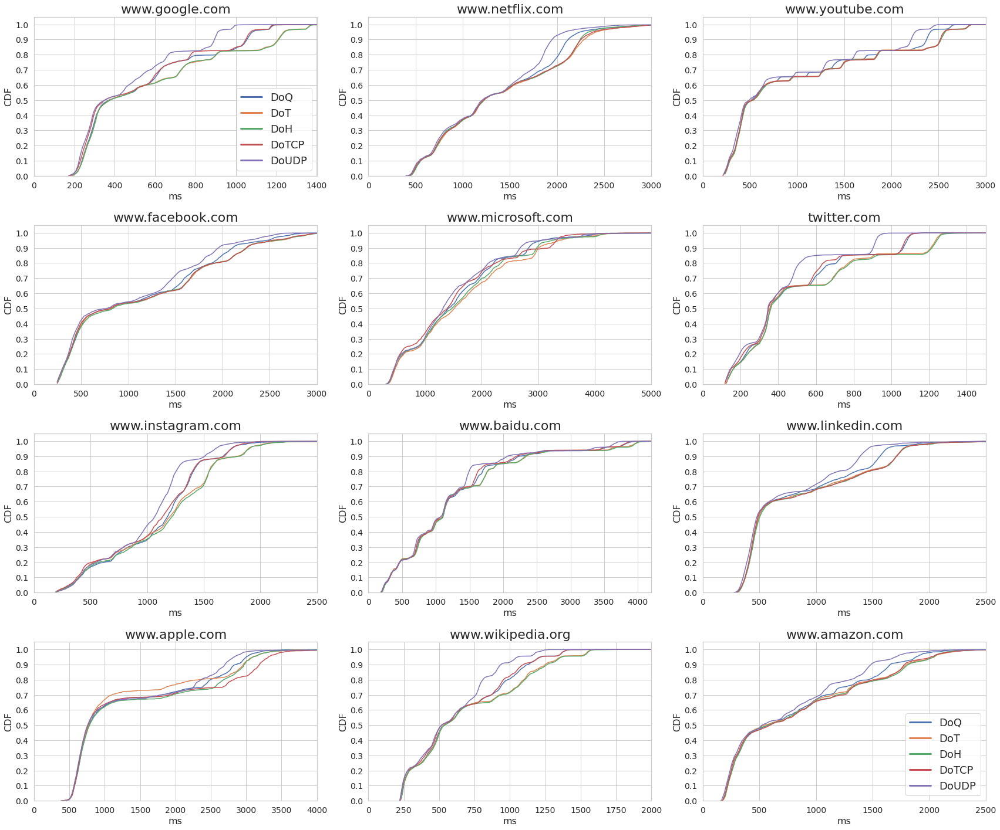

In [535]:
i = 0
fig, axs = plt.subplots(4, 3, figsize=(24, 20), sharey='col')
axes = []
times = {}

for domain in domain_order:
    dom_df = df[df['domain'] == domain]
    dom_df = dom_df[dom_df['firstContentfulPaint'] > 0]
    for protocol in protocols:
        times[protocol] = dom_df[dom_df['protocol'] == protocol]['firstContentfulPaint']
    ax = axs[int(i/3),i%3]
    sns.lineplot(x=calculateCDF(times['QUIC'])[0], y=calculateCDF(times['QUIC'])[1], label="DoQ", ax=ax)
    sns.lineplot(x=calculateCDF(times['TLS'])[0], y=calculateCDF(times['TLS'])[1], label="DoT", ax=ax)
    sns.lineplot(x=calculateCDF(times['HTTPS'])[0], y=calculateCDF(times['HTTPS'])[1], label="DoH", ax=ax)
    sns.lineplot(x=calculateCDF(times['TCP'])[0], y=calculateCDF(times['TCP'])[1], label="DoTCP", ax=ax)
    sns.lineplot(x=calculateCDF(times['UDP'])[0], y=calculateCDF(times['UDP'])[1], label="DoUDP", ax=ax)

    ax.set_xlabel("ms", fontsize = 16)
    ax.set_ylabel("CDF", fontsize = 16)
    ax.tick_params(labelleft=True)
    ax.tick_params(labelbottom=True)
    ax.set_title(domain, fontsize = 22)
    ax.tick_params(axis='both', labelsize=14)
    ax.set_ylim(0.0, 1.05)
    ax.yaxis.set_ticks(np.arange(0.0, 1.01, 0.1))
    
    switcher = {
        'www.netflix.com': 3000,
        'www.google.com': 1401,
        'www.youtube.com': 3000,
        'www.facebook.com': 3000,
        'twitter.com': 1501,
        'www.instagram.com': 2501,
        'www.linkedin.com': 2501,
        'www.apple.com': 4000,
        'www.wikipedia.org': 2000,
        'www.amazon.com': 2501,
        'www.baidu.com': 4200
    }
    ax.set_xlim(0, switcher.get(domain, 5000))
    
    if i == 11 or i == 0:
        leg = ax.legend(loc="lower right", fontsize='medium')
        for line in leg.get_lines():
            line.set_linewidth(3.0)
    else:
        ax.get_legend().remove()
    fig.tight_layout()

    i += 1
plt.savefig("figures/domains-cdf.pdf", bbox_inches='tight')
plt.show()

In [201]:
times_dict = {}
for domain in domain_order:
    dom_df = df[df['domain'] == domain]
    times_dict[domain] = {}
    dom_df = dom_df[dom_df['firstContentfulPaint'] > 0]
    print(f"\n{domain}\n")
    for protocol in protocols:
        times_dict[domain][protocol] = dom_df[dom_df['protocol'] == protocol]['firstContentfulPaint']
        print(f"{protocol} - {times_dict[domain][protocol].mean()}")
print_cdf_values(times_dict, 0.75)


www.google.com

QUIC - 527.4358188627851
TLS - 570.7882753925902
HTTPS - 574.014659862048
TCP - 513.3202316078892
UDP - 464.62303504768624

www.netflix.com

QUIC - 1357.8682344903243
TLS - 1401.1125341534125
HTTPS - 1392.184014996868
TCP - 1394.625860305458
UDP - 1288.9132924326116

www.youtube.com

QUIC - 954.6387678704511
TLS - 993.49033800088
HTTPS - 998.8061904719086
TCP - 992.3262244900878
UDP - 890.922082342717

www.facebook.com

QUIC - 1086.1161934813824
TLS - 1124.0443349736915
HTTPS - 1129.6119047624557
TCP - 1117.5298178005485
UDP - 1018.565194532573

www.microsoft.com

QUIC - 1549.6553846137815
TLS - 1653.7523236743996
HTTPS - 1597.9147746750646
TCP - 1521.0226597807498
UDP - 1485.681260840475

twitter.com

QUIC - 476.0702453954088
TLS - 516.2355624111918
HTTPS - 529.0226575784017
TCP - 465.51776718671346
UDP - 415.7295299734342

www.instagram.com

QUIC - 1082.541696968223
TLS - 1129.0589530055258
HTTPS - 1145.4302436119733
TCP - 1060.5211242610885
UDP - 996.4946865656839



,UDP,QUIC,TLS,HTTPS,TCP
www.google.com,628,697,788,774,696
www.netflix.com,1820,1962,2075,2066,2060
www.youtube.com,1308,1418,1497,1501,1501
www.facebook.com,1568,1696,1740,1737,1721
www.microsoft.com,1988,2058,2241,2182,2014
twitter.com,487,628,719,730,603
www.instagram.com,1217,1375,1521,1523,1362
www.baidu.com,1450,1607,1705,1703,1581
www.linkedin.com,1078,1188,1275,1305,1302
www.apple.com,2253,2372,1858,2550,2657


**Africa South**

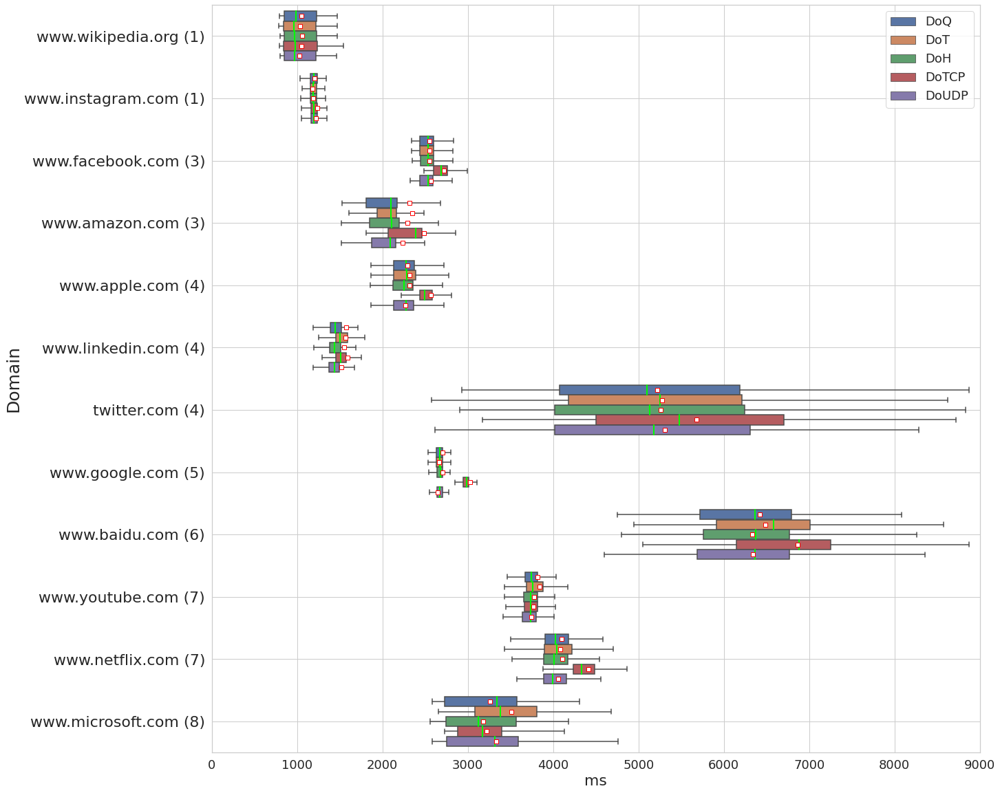

In [284]:
plt.rcParams["figure.figsize"] = (20,20)
multiCompare('vantagePoint', 'Africa South', 'domain', ['difLookupEnd'], ylabel='Domain', save='domains-af', medians=False, xlim=(0,9000))

**www.netflix.com**

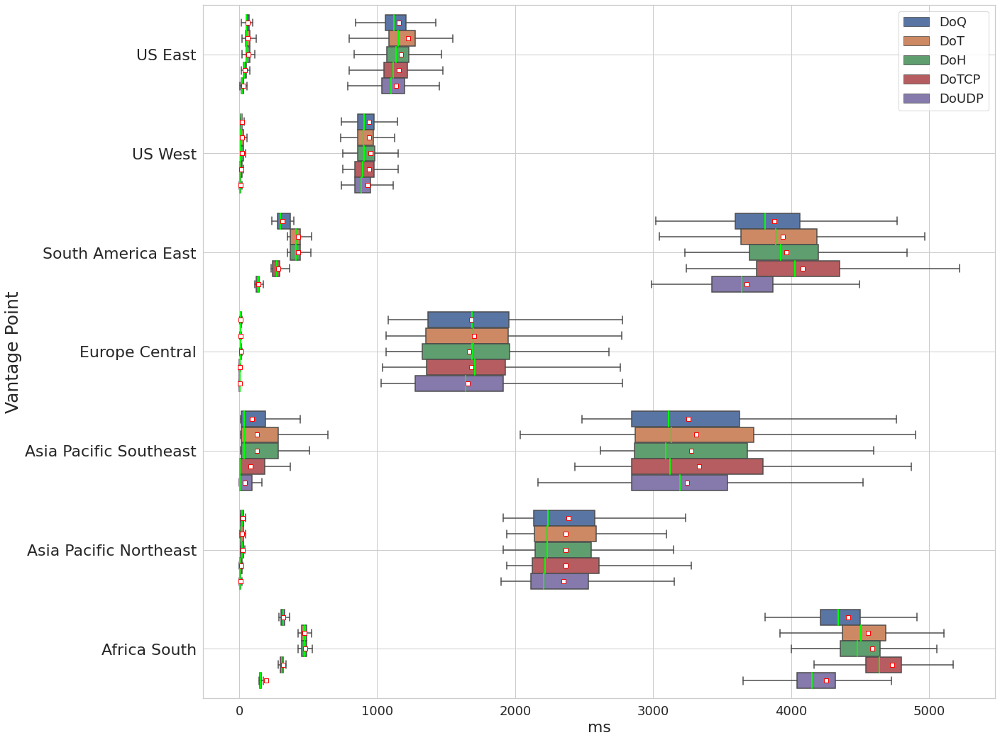

In [140]:
plt.rcParams["figure.figsize"] = (20,18)
multiCompare('domain', 'www.netflix.com', 'vantagePoint', ['elapsed', 'loadEventStart'], ylabel='Vantage Point', save='vp-netflix', medians=False)

In [147]:
print(df.groupby(['vantagePoint'])['queries'].agg(['sum','count']))

                           sum  count
vantagePoint                         
Africa South            115879  24029
Asia Pacific Northeast  129105  25165
Asia Pacific Southeast  119609  25167
Europe Central          105297  25193
South America East      120215  25194
US East                 127070  25189
US West                 126454  25191


**Asia Pacific Southeast**

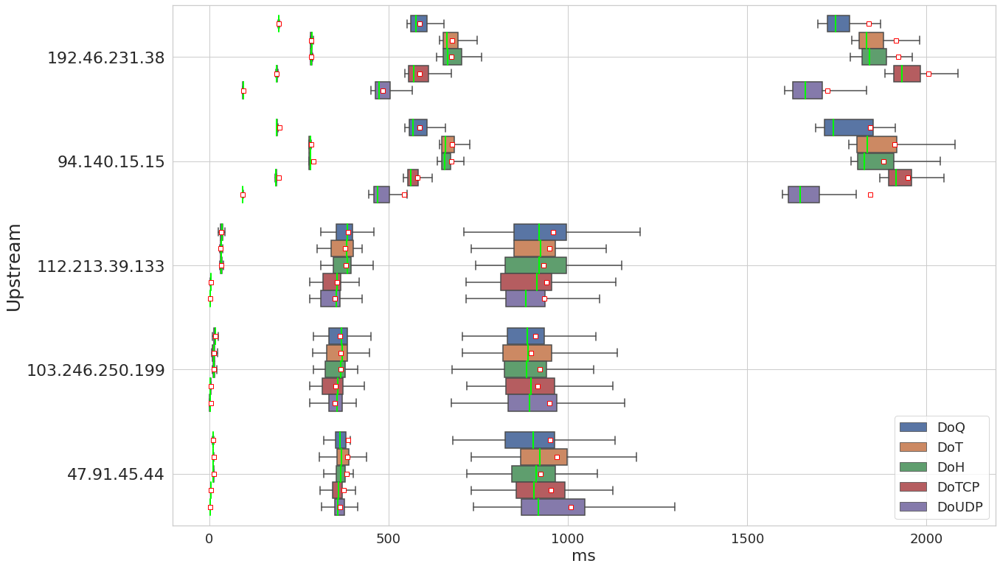

In [493]:
plt.rcParams["figure.figsize"] = (20,13)

multiCompare('vantagePoint', 'Asia Pacific Southeast', 'server', ['elapsed', 'responseStart', 'loadEventStart'], server_domain='www.google.com', ylabel='Upstream', medians=False, save='ap-southeast-upstreams')

In [398]:
# normalize data
normalized_df = pd.DataFrame()
for vp in vp_order:
    df_vp = df[df['vantagePoint'] == vp].copy()
    for server in df_vp['server'].unique():
        df_server = df_vp[df_vp['server'] == server].copy()
        for domain in domain_order:
            df_domain = df_server[df_server['domain'] == domain].copy()
            df_domain['loadEventStart']=(df_domain['loadEventStart']-df_domain['loadEventStart'].mean())/df_domain['loadEventStart'].std()
            normalized_df = pd.concat([normalized_df, df_domain])

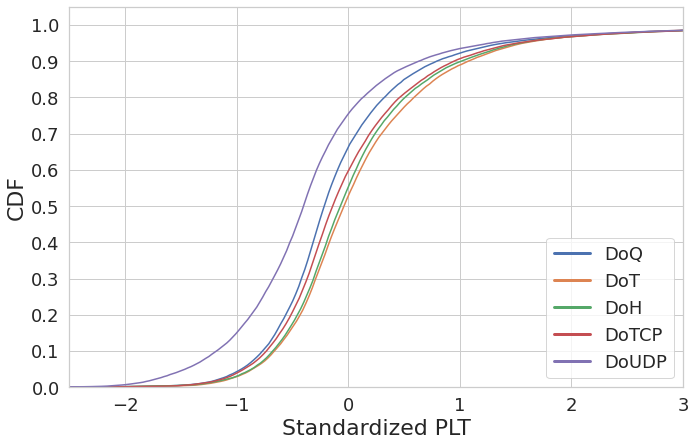

In [420]:
fig, ax = plt.subplots(figsize=(11, 7))
times = {}

for protocol in protocols:
    times[protocol] = normalized_df[normalized_df['protocol'] == protocol]['loadEventStart']

sns.lineplot(x=calculateCDF(times['QUIC'], bins=1000)[0], y=calculateCDF(times['QUIC'], bins=1000)[1], label="DoQ", ax=ax)
sns.lineplot(x=calculateCDF(times['TLS'], bins=1000)[0], y=calculateCDF(times['TLS'], bins=1000)[1], label="DoT", ax=ax)
sns.lineplot(x=calculateCDF(times['HTTPS'], bins=1000)[0], y=calculateCDF(times['HTTPS'], bins=1000)[1], label="DoH", ax=ax)
sns.lineplot(x=calculateCDF(times['TCP'], bins=1000)[0], y=calculateCDF(times['TCP'], bins=1000)[1], label="DoTCP", ax=ax)
sns.lineplot(x=calculateCDF(times['UDP'], bins=1000)[0], y=calculateCDF(times['UDP'], bins=1000)[1], label="DoUDP", ax=ax)

ax.set_xlabel("Standardized PLT", fontsize = 22)
ax.set_ylabel("CDF", fontsize = 22)
ax.tick_params(labelleft=True)
ax.tick_params(labelbottom=True)
ax.tick_params(axis='both', labelsize=18)
ax.set_ylim(0.0, 1.05)
ax.yaxis.set_ticks(np.arange(0.0, 1.01, 0.1))
ax.set_xlim(-2.5, 3)

leg = ax.legend(loc="lower right", fontsize='medium')
for line in leg.get_lines():
    line.set_linewidth(3.0)

plt.savefig("figures/standard-cdf.pdf", bbox_inches='tight')
plt.show()

In [593]:
x_vp = 'Africa South'
x_ser = '23.94.120.177'
x_dom = 'www.youtube.com'
times_normal = df[(df['vantagePoint'] == x_vp) & (df['server'] == x_ser) & (df['domain'] == x_dom)].copy()
times_std = normalized_df[(normalized_df['vantagePoint'] == x_vp) & (normalized_df['server'] == x_ser) & (normalized_df['domain'] == x_dom)].copy()

median_normal_udp = times_normal[times_normal['protocol'] == 'TLS']['loadEventStart'].median()
median_normal_quic = times_normal[times_normal['protocol'] == 'UDP']['loadEventStart'].median()

median_std_udp = times_std[times_std['protocol'] == 'TLS']['loadEventStart'].median()
median_std_quic = times_std[times_std['protocol'] == 'UDP']['loadEventStart'].median()

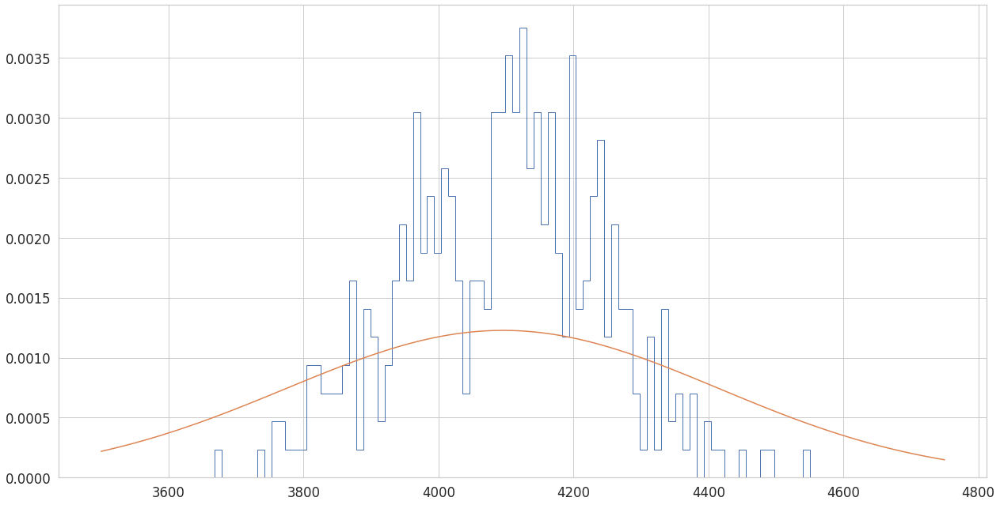

In [594]:
noise = times_normal['loadEventStart'].tolist()
density = stats.gaussian_kde(noise)
n, x, _ = plt.hist(noise, bins=np.linspace(3500, 4750, 120), 
                   histtype=u'step', density=True)  
plt.plot(x, density(x))
plt.show()

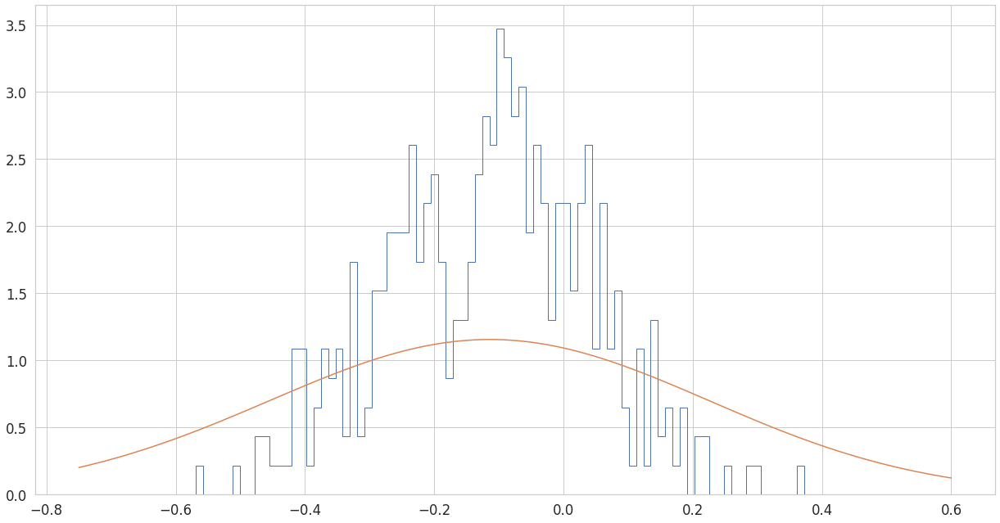

In [592]:
noise = times_std['loadEventStart'].tolist()
density = stats.gaussian_kde(noise)
n, x, _ = plt.hist(noise, bins=np.linspace(-0.75, 0.6, 120), 
                   histtype=u'step', density=True)  
plt.plot(x, density(x))
plt.show()

In [406]:
diff_df2 = pd.DataFrame(columns = ['DoQ', 'DoT', 'DoH', 'DoTCP'])
for vp in vp_order:
    df_vp = df[df['vantagePoint'] == vp].copy()
    for server in df_vp['server'].unique():
        df_server = df_vp[df_vp['server'] == server].copy()
        for domain in domain_order:
            df_domain = df_server[df_server['domain'] == domain].copy()
            df_udp = df_domain[df_domain['protocol'] == 'UDP'].copy()
            mean_udp = df_udp['loadEventStart'].median()
            if mean_udp is not np.nan:
                next_df_row = []
                for protocol in ['QUIC', 'TLS', 'HTTPS', 'TCP']:
                    df_protocol = df_domain[df_domain['protocol'] == protocol].copy()
                    mean_protocol = df_protocol['loadEventStart'].median()
                    increase = (mean_protocol/(mean_udp/100))-100
                    if increase is np.nan:
                        increase = 0
                    next_df_row.append(increase)
                next_df_series = pd.Series(next_df_row, index = diff_df2.columns)
                diff_df2 = diff_df2.append(next_df_series, ignore_index=True)

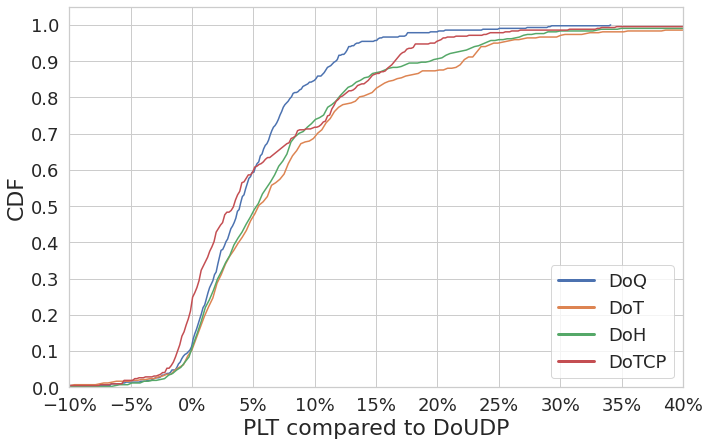

In [418]:
fig, ax = plt.subplots(figsize=(11, 7))
times = {}

for protocol in ['DoQ', 'DoT', 'DoH', 'DoTCP']:
    times[protocol] = diff_df2[protocol]

sns.lineplot(x=calculateCDF(times['DoQ'], bins=400)[0], y=calculateCDF(times['DoQ'], bins=400)[1], label="DoQ", ax=ax)
sns.lineplot(x=calculateCDF(times['DoT'], bins=400)[0], y=calculateCDF(times['DoT'], bins=400)[1], label="DoT", ax=ax)
sns.lineplot(x=calculateCDF(times['DoH'], bins=400)[0], y=calculateCDF(times['DoH'], bins=400)[1], label="DoH", ax=ax)
sns.lineplot(x=calculateCDF(times['DoTCP'], bins=400)[0], y=calculateCDF(times['DoTCP'], bins=400)[1], label="DoTCP", ax=ax)

ax.set_xlabel("PLT compared to DoUDP", fontsize = 22)
ax.set_ylabel("CDF", fontsize = 22)
ax.tick_params(labelleft=True)
ax.tick_params(labelbottom=True)
ax.tick_params(axis='both', labelsize=18)
ax.set_ylim(0.0, 1.05)
ax.yaxis.set_ticks(np.arange(0.0, 1.01, 0.1))

ax.set_xlim(-10, 40)
ax.xaxis.set_ticks(np.arange(-10, 41, 5))

ax.xaxis.set_major_formatter(mtick.PercentFormatter())

leg = ax.legend(loc="lower right", fontsize='medium')
for line in leg.get_lines():
    line.set_linewidth(3.0)

plt.savefig("figures/udp-baseline.pdf", bbox_inches='tight')
plt.show()

In [504]:
df_medians = pd.DataFrame(columns = ['protocol', 'vantagePoint', 'domain', 'medianSTDPLT'])
for vp in vp_order:
    df_vp = normalized_df[normalized_df['vantagePoint'] == vp].copy()
    for domain in domain_order:
        df_domain = df_vp[df_vp['domain'] == domain].copy()
        for protocol in protocols:
            df_protocol = df_domain[df_domain['protocol'] == protocol].copy()
            median = df_protocol['loadEventStart'].mean()
            next_df_row = [protocol, vp, domain, median]
            next_df_series = pd.Series(next_df_row, index = df_medians.columns)
            df_medians = df_medians.append(next_df_series, ignore_index=True)

In [505]:
DoQ = df_medians[df_medians['protocol'] == 'QUIC'].sort_values(by=['vantagePoint', 'domain']).reset_index(drop=True)

DoT = df_medians[df_medians['protocol'] == 'TLS'].sort_values(by=['vantagePoint', 'domain']).reset_index(drop=True)
DoQ['DoQ-DoT'] = DoQ['medianSTDPLT'] - DoT['medianSTDPLT']

DoH = df_medians[df_medians['protocol'] == 'HTTPS'].sort_values(by=['vantagePoint', 'domain']).reset_index(drop=True)
DoQ['DoQ-DoH'] = DoQ['medianSTDPLT'] - DoH['medianSTDPLT']

DoUDP = df_medians[df_medians['protocol'] == 'UDP'].sort_values(by=['vantagePoint', 'domain']).reset_index(drop=True)
DoQ['DoQ-DoUDP'] = DoQ['medianSTDPLT'] - DoUDP['medianSTDPLT']

DoTCP = df_medians[df_medians['protocol'] == 'TCP'].sort_values(by=['vantagePoint', 'domain']).reset_index(drop=True)
DoQ['DoQ-DoTCP'] = DoQ['medianSTDPLT'] - DoTCP['medianSTDPLT']

In [531]:
print(DoQ.sort_values(by=['DoQ-DoUDP']).head(10))

   protocol            vantagePoint             domain  medianSTDPLT  \
43     QUIC          Europe Central   www.linkedin.com     -0.048805   
20     QUIC  Asia Pacific Northeast  www.microsoft.com     -0.023063   
14     QUIC  Asia Pacific Northeast      www.apple.com     -0.061388   
41     QUIC          Europe Central     www.google.com     -0.078707   
37     QUIC          Europe Central     www.amazon.com      0.017873   
62     QUIC                 US East      www.apple.com     -0.035043   
15     QUIC  Asia Pacific Northeast      www.baidu.com      0.050795   
29     QUIC  Asia Pacific Southeast     www.google.com     -0.052536   
40     QUIC          Europe Central   www.facebook.com      0.013441   
36     QUIC          Europe Central        twitter.com     -0.049737   

     DoQ-DoT   DoQ-DoH  DoQ-DoUDP  DoQ-DoTCP  
43 -0.089236 -0.103507  -0.054380   0.003222  
20 -0.074144  0.008528  -0.052189   0.002232  
14 -0.106429 -0.148961  -0.033474  -0.018119  
41 -0.070487 -0.208

In [412]:
diff_df = pd.DataFrame(columns = ['DoQ', 'DoT'])
for vp in vp_order:
    df_vp = df[df['vantagePoint'] == vp].copy()
    for server in df_vp['server'].unique():
        df_server = df_vp[df_vp['server'] == server].copy()
        for domain in domain_order:
            df_domain = df_server[df_server['domain'] == domain].copy()
            df_doh = df_domain[df_domain['protocol'] == 'HTTPS'].copy()
            mean_doh = df_doh['loadEventStart'].median()
            if mean_doh is not np.nan:
                next_df_row = []
                for protocol in ['QUIC', 'TLS']:
                    df_protocol = df_domain[df_domain['protocol'] == protocol].copy()
                    mean_protocol = df_protocol['loadEventStart'].median()
                    increase = (mean_protocol/(mean_doh/100))-100
                    if increase is np.nan:
                        increase = 0
                    next_df_row.append(increase)
                next_df_series = pd.Series(next_df_row, index = diff_df.columns)
                diff_df = diff_df.append(next_df_series, ignore_index=True)

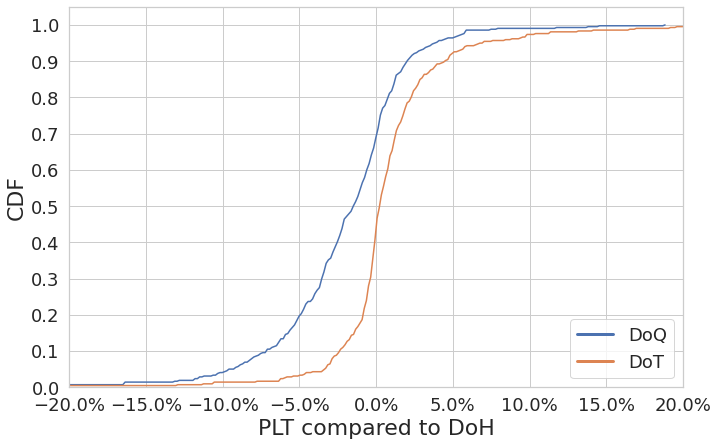

In [419]:
fig, ax = plt.subplots(figsize=(11, 7))
times = {}

for protocol in ['DoQ', 'DoT']:
    times[protocol] = diff_df[protocol]

sns.lineplot(x=calculateCDF(times['DoQ'], bins=400)[0], y=calculateCDF(times['DoQ'], bins=400)[1], label="DoQ", ax=ax)
sns.lineplot(x=calculateCDF(times['DoT'], bins=400)[0], y=calculateCDF(times['DoT'], bins=400)[1], label="DoT", ax=ax)

ax.set_xlabel("PLT compared to DoH", fontsize = 22)
ax.set_ylabel("CDF", fontsize = 22)
ax.tick_params(labelleft=True)
ax.tick_params(labelbottom=True)
ax.tick_params(axis='both', labelsize=18)
ax.set_ylim(0.0, 1.05)
ax.yaxis.set_ticks(np.arange(0.0, 1.01, 0.1))
ax.set_xlim(-20, 20)
ax.xaxis.set_major_formatter(mtick.PercentFormatter())

leg = ax.legend(loc="lower right", fontsize='medium')
for line in leg.get_lines():
    line.set_linewidth(3.0)

plt.savefig("figures/doh-baseline.pdf", bbox_inches='tight')
plt.show()

# Plots

***Slowest Server***

**5.135.233.74**

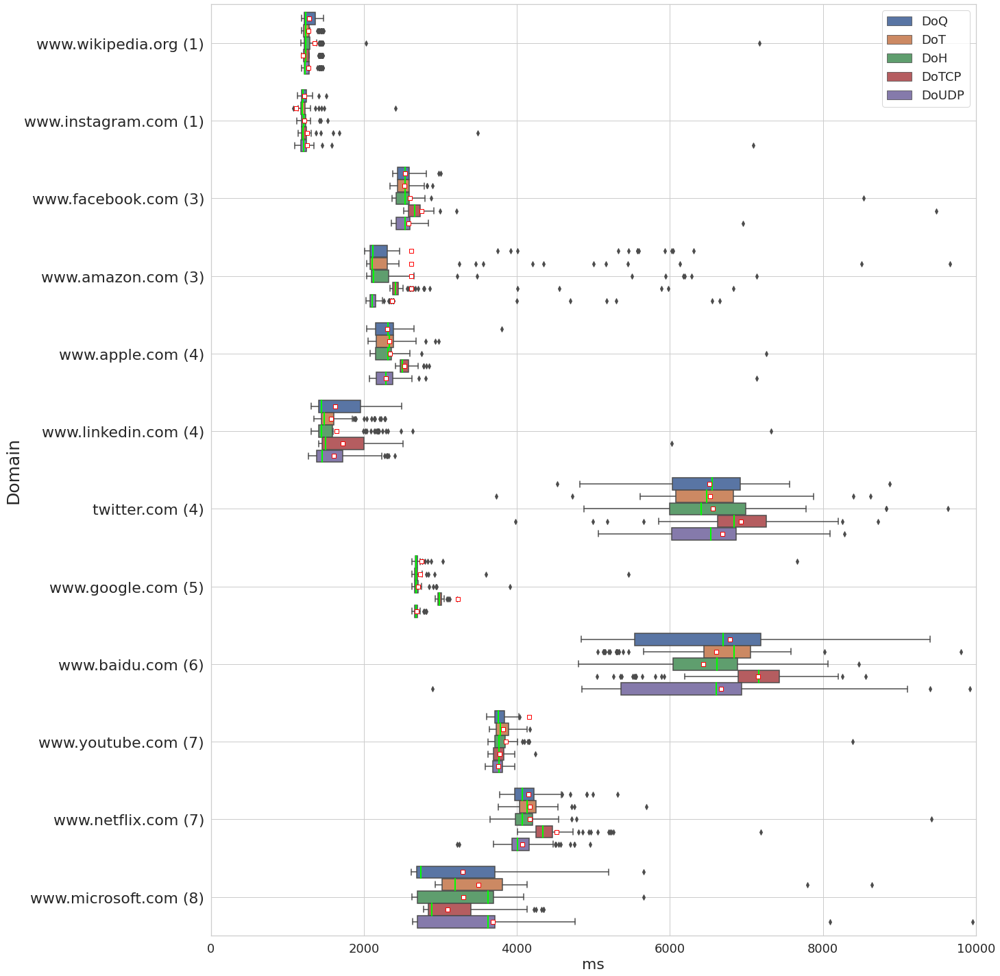

In [532]:
printmd(f"***Slowest Server***")

plt.rcParams["figure.figsize"] = (20,25)
df_udp = df[df['protocol'] == 'UDP']
df_grouped = df_udp.groupby(['vantagePoint', 'server'])['avg_lookup_end'].mean()
slowest_vp, slowest_server = df_grouped.idxmax()
multiCompare('server', slowest_server, 'domain', ['difLookupEnd'], ylabel='Domain', save='slowest_server', medians=False, showfliers=True, xlim=(0,10000))

## Compare Domains

***Page Load Time in Relation to Transfer Size***

**Europe Central**

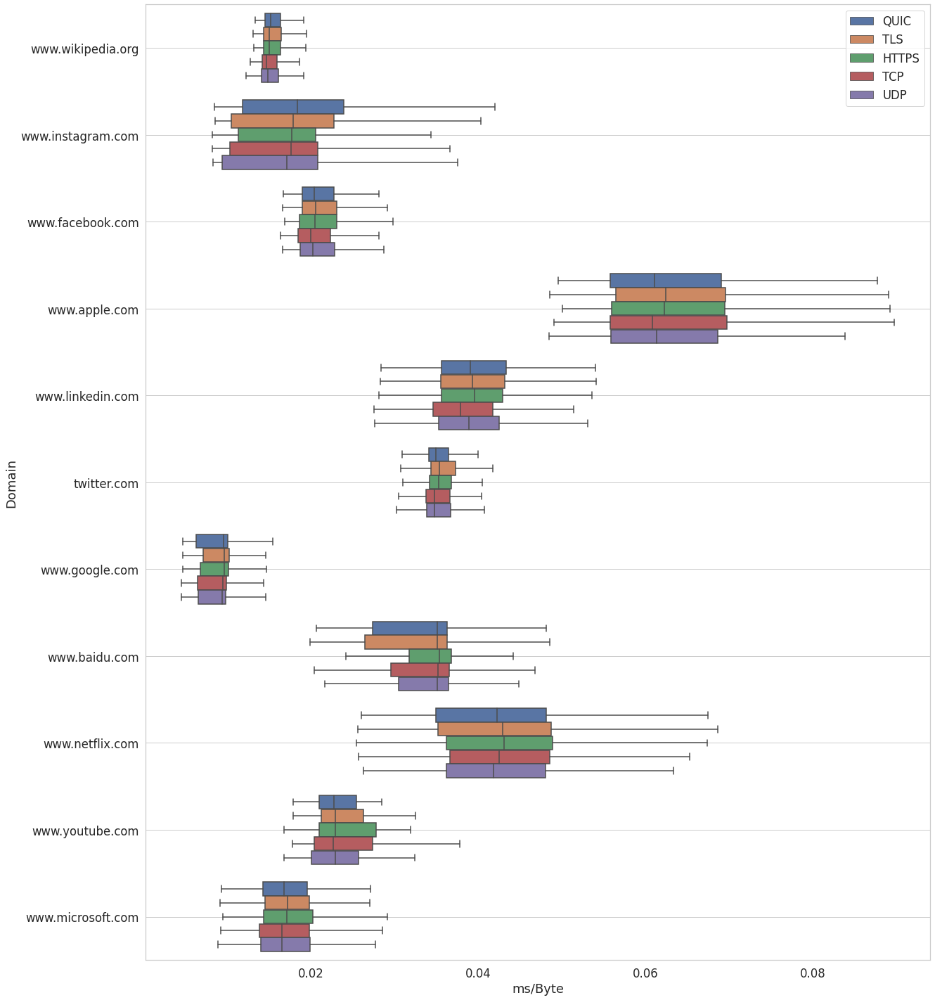

**US West**

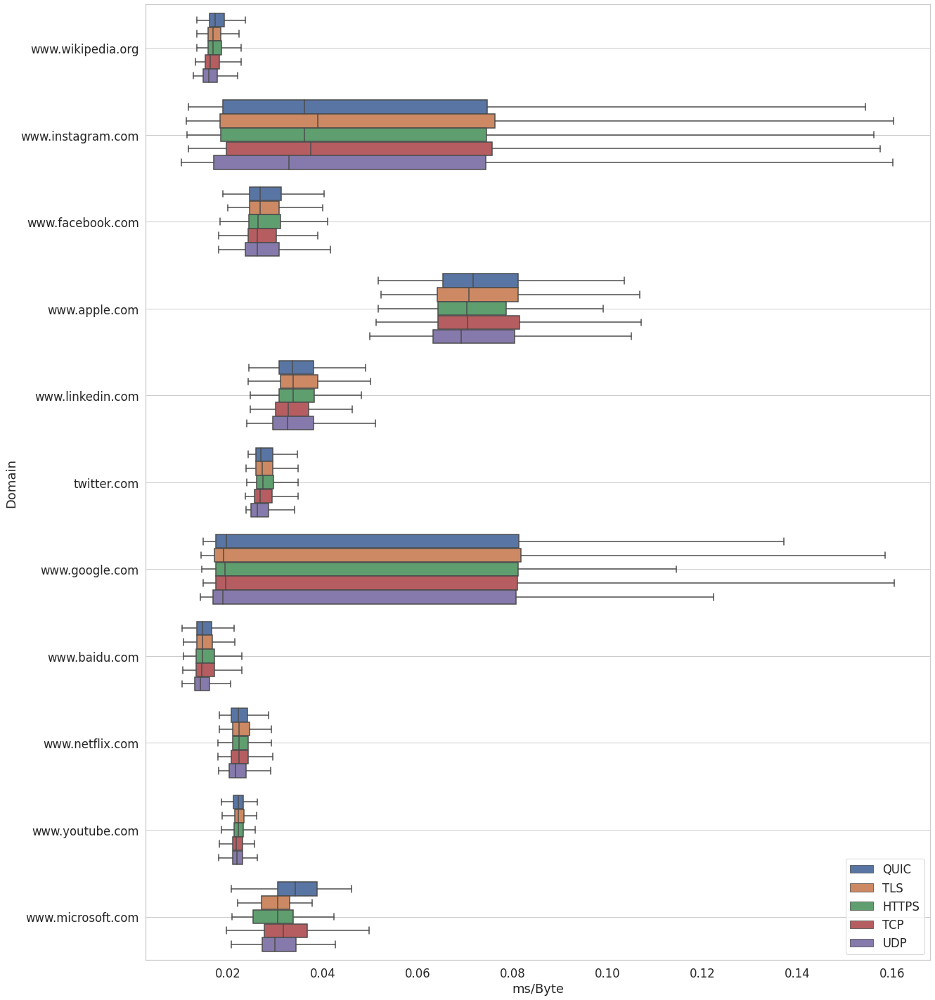

**US East**

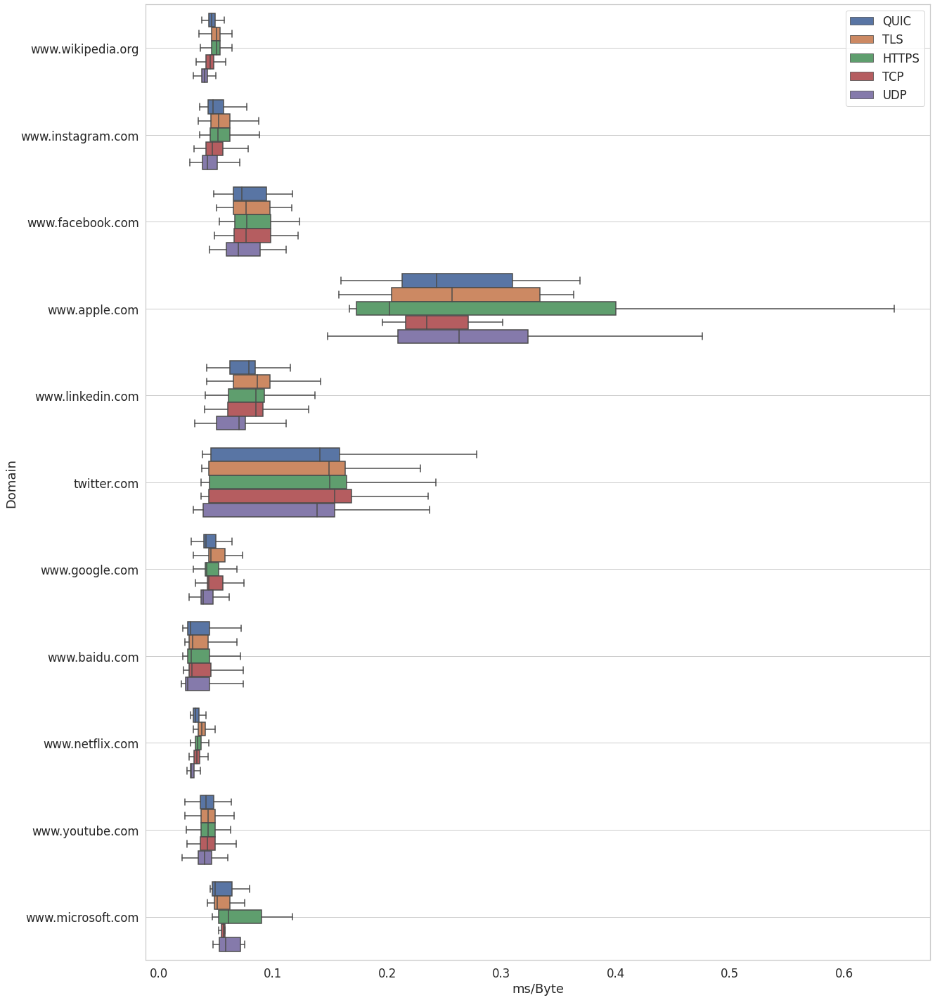

**Asia Pacific Northeast**

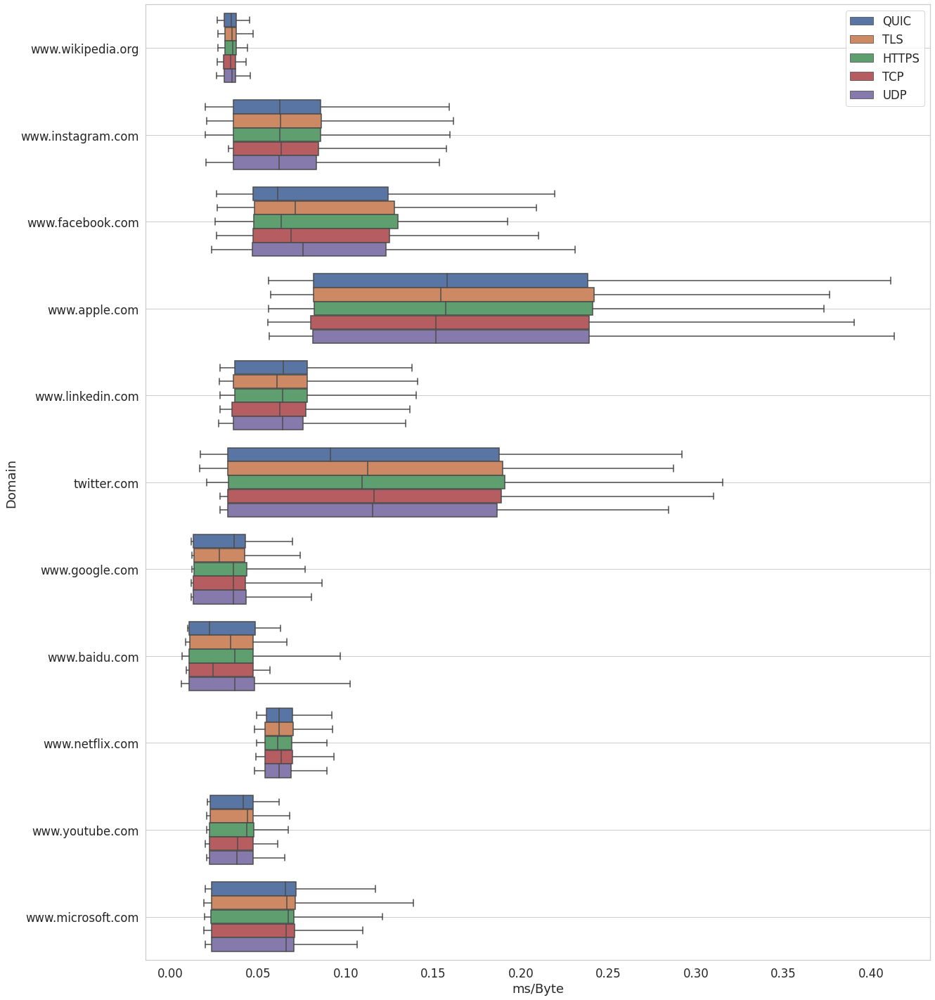

**Asia Pacific Southeast**

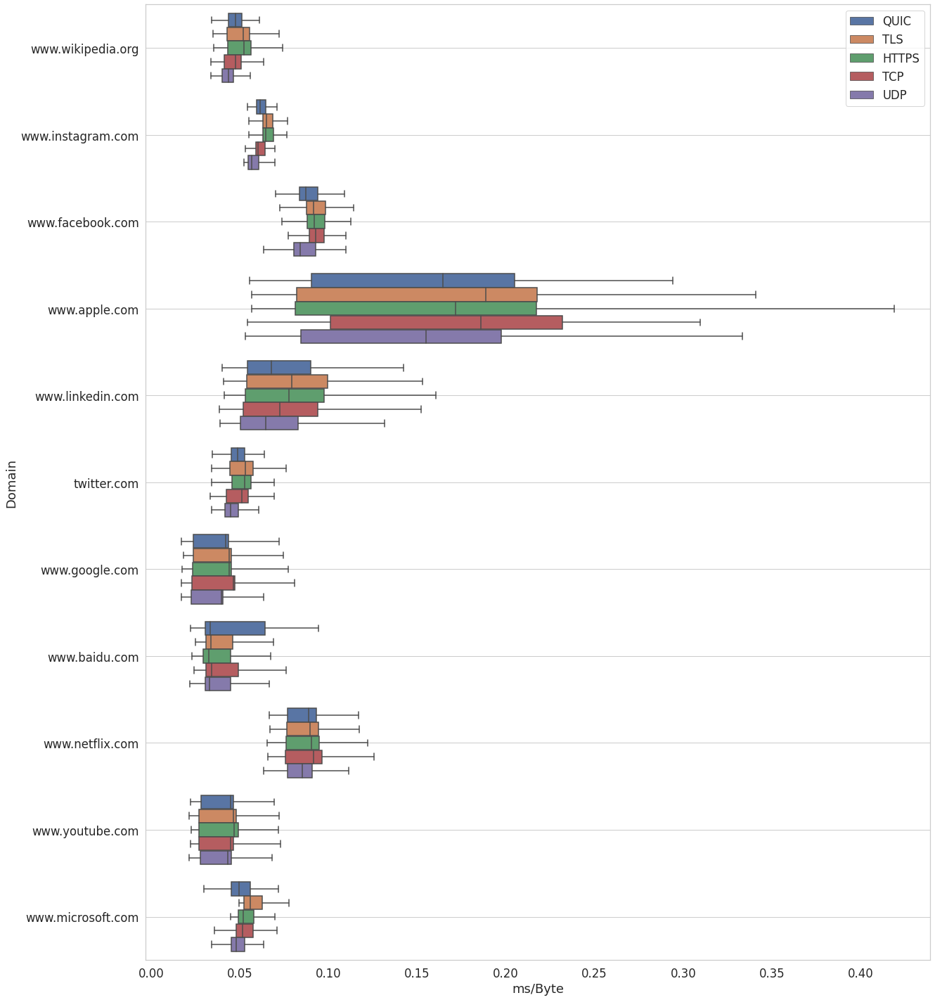

**South America East**

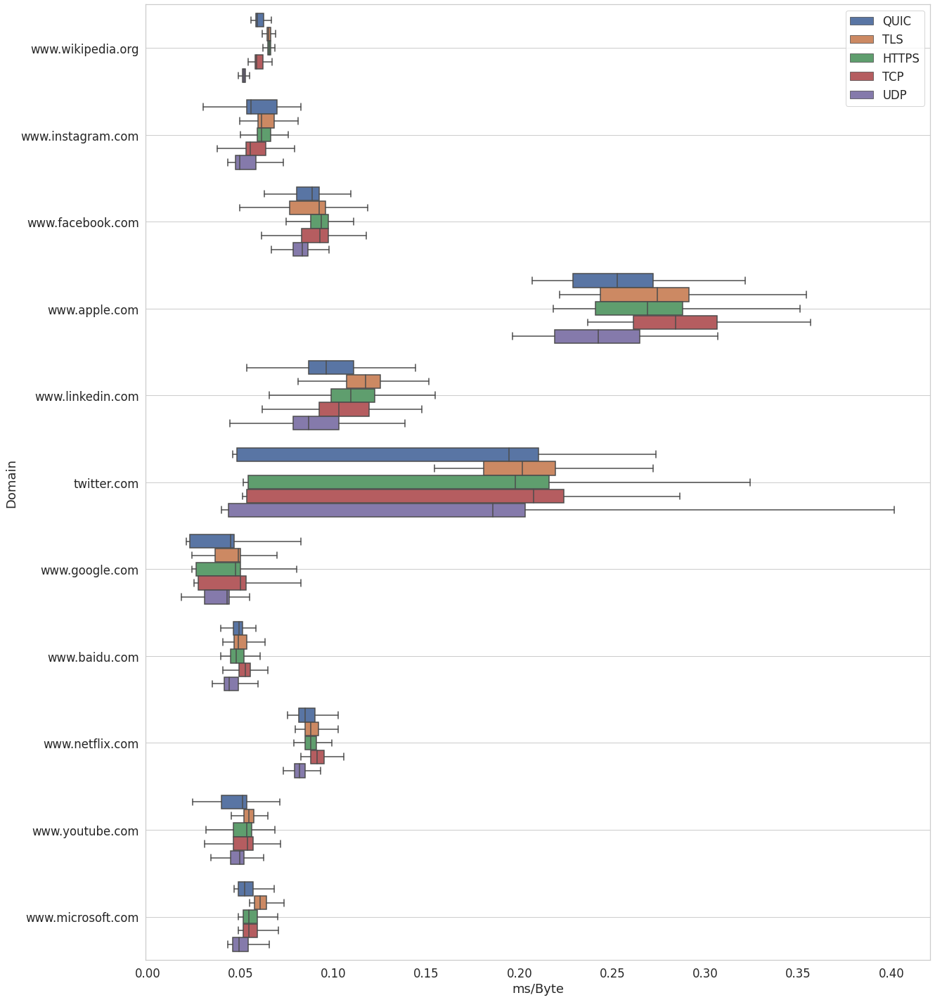

**Africa South**

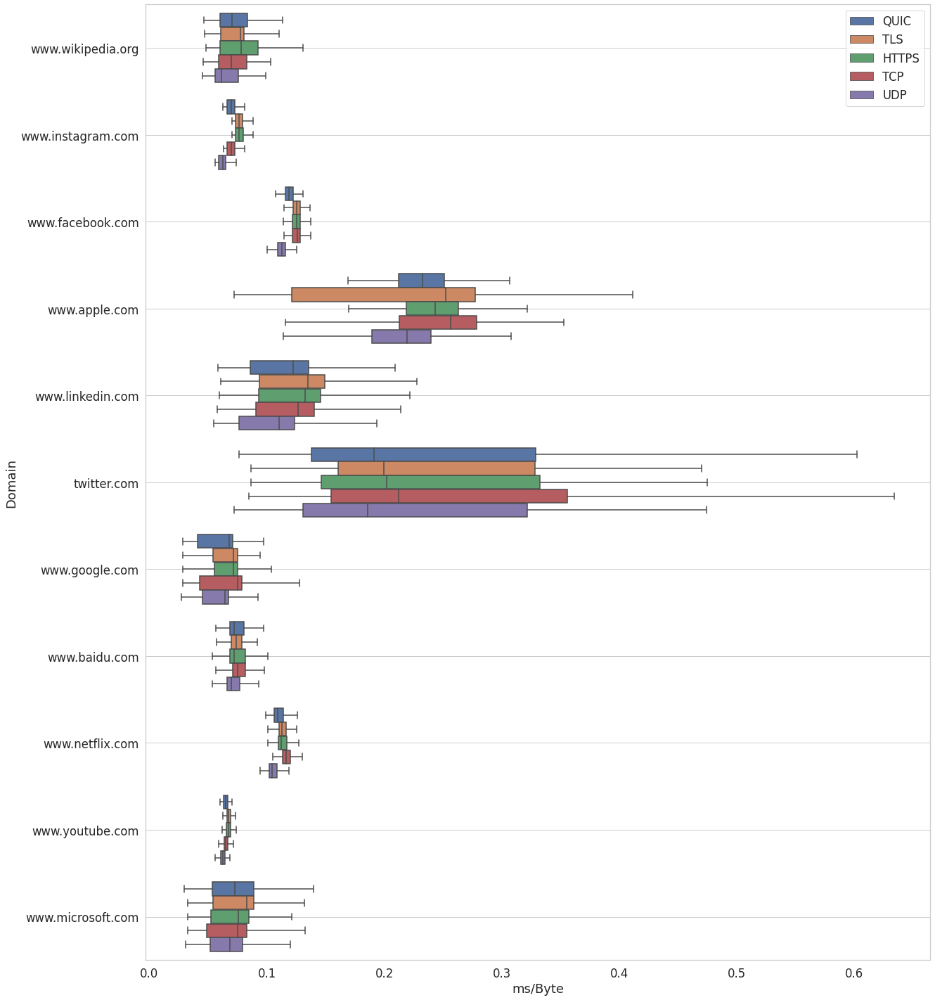

In [56]:
printmd(f"***Page Load Time in Relation to Transfer Size***")

plt.rcParams["figure.figsize"] = (20,25)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'domain', value_vars=['timeByTransferSize'], medians=False, xlabel='ms/Byte', ylabel='Domain')

***Page Load Time in Relation to Decoded Body Size***

**Europe Central**

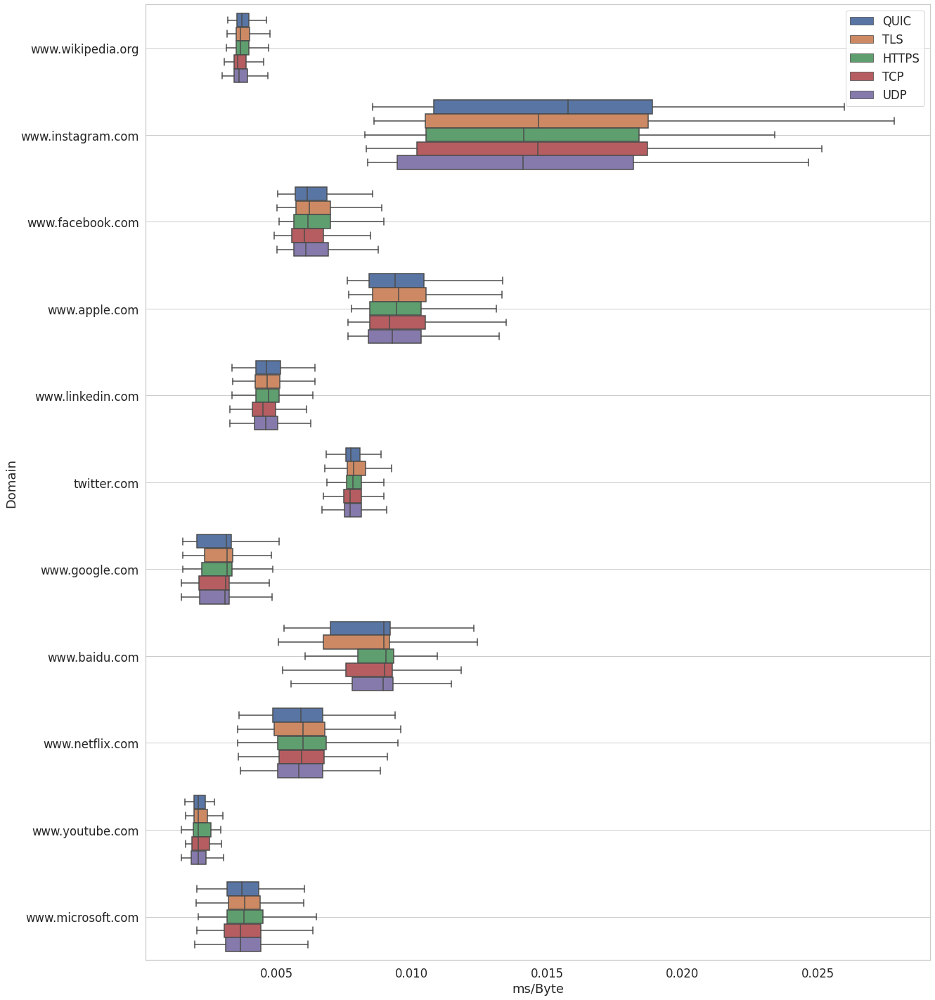

**US West**

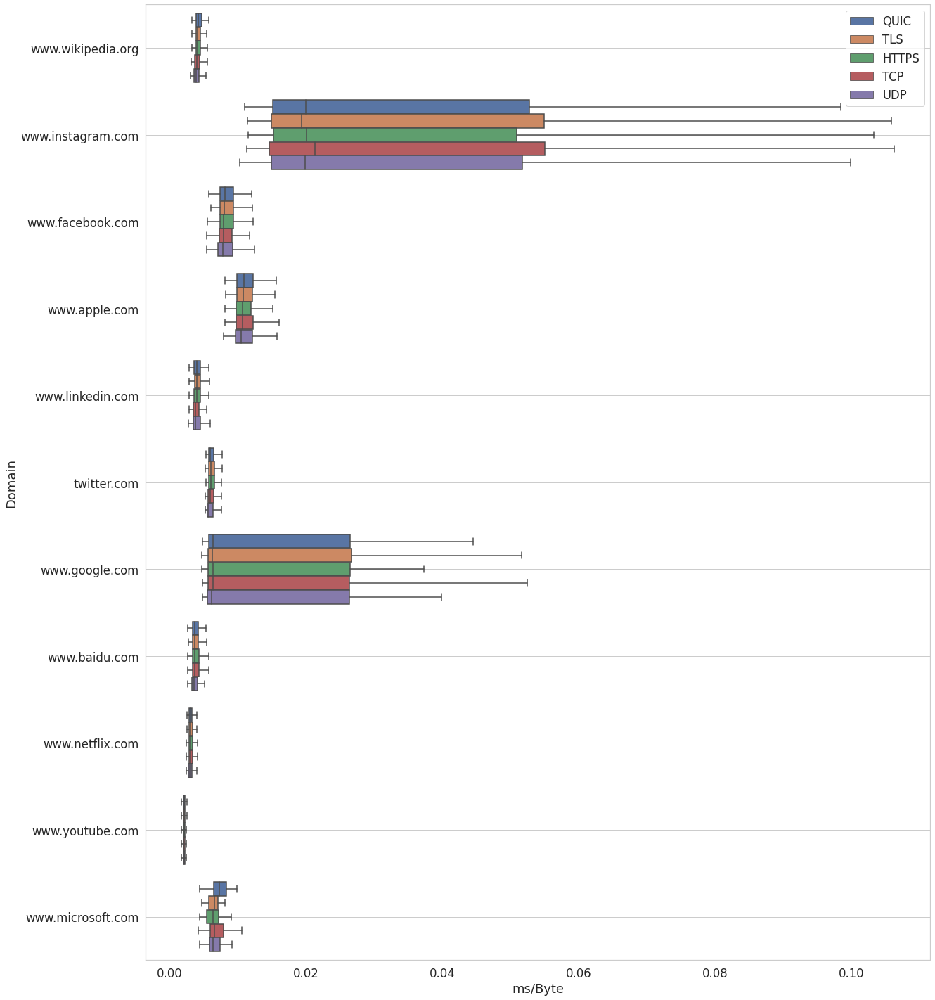

**US East**

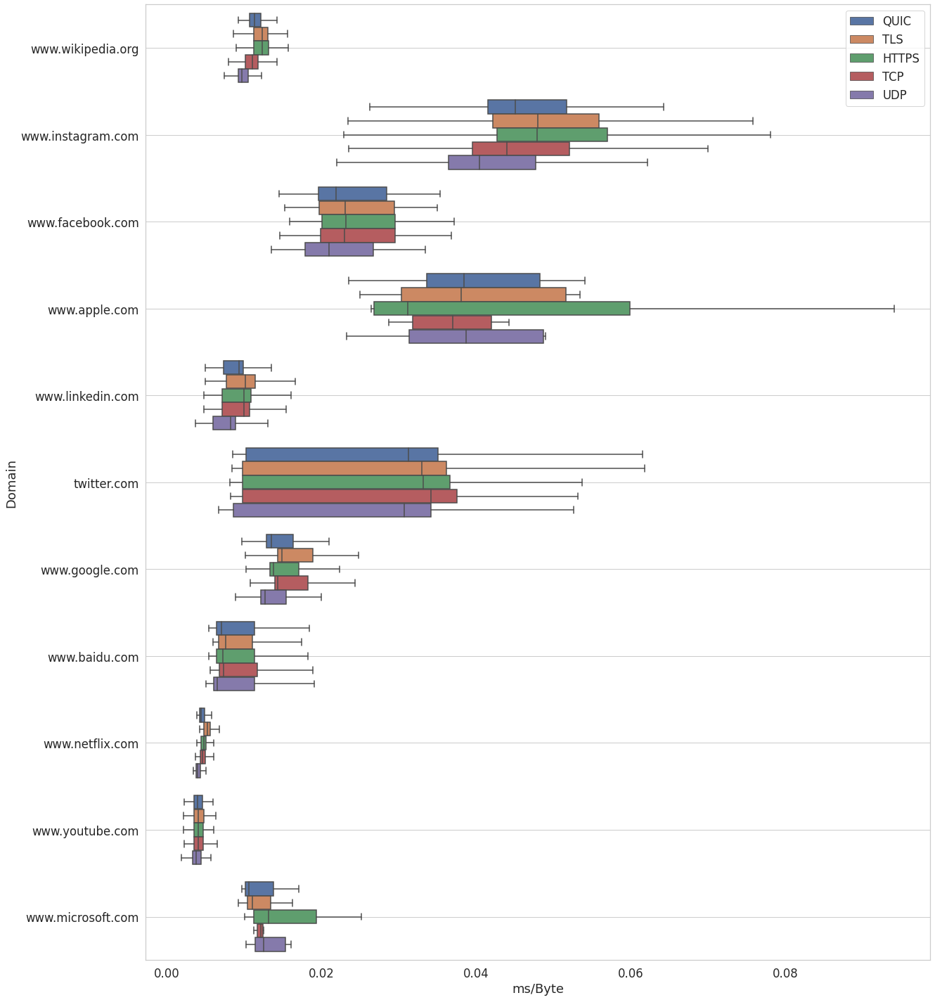

**Asia Pacific Northeast**

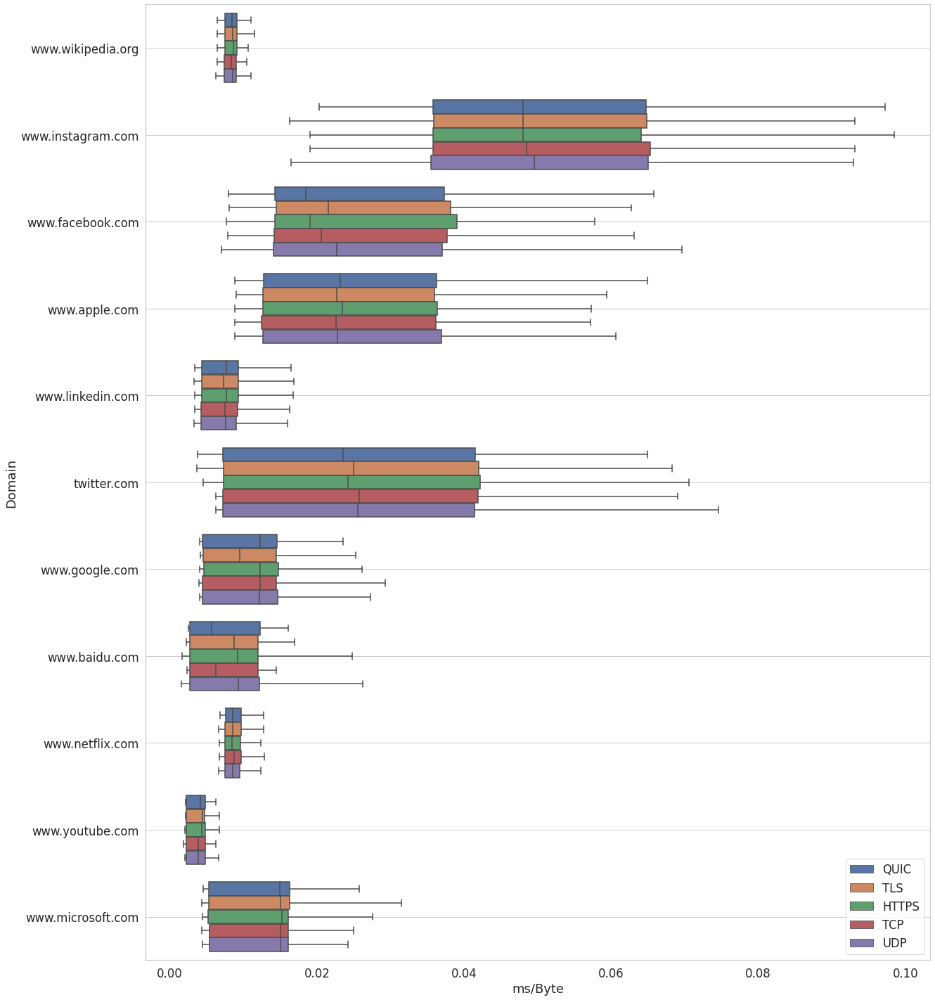

**Asia Pacific Southeast**

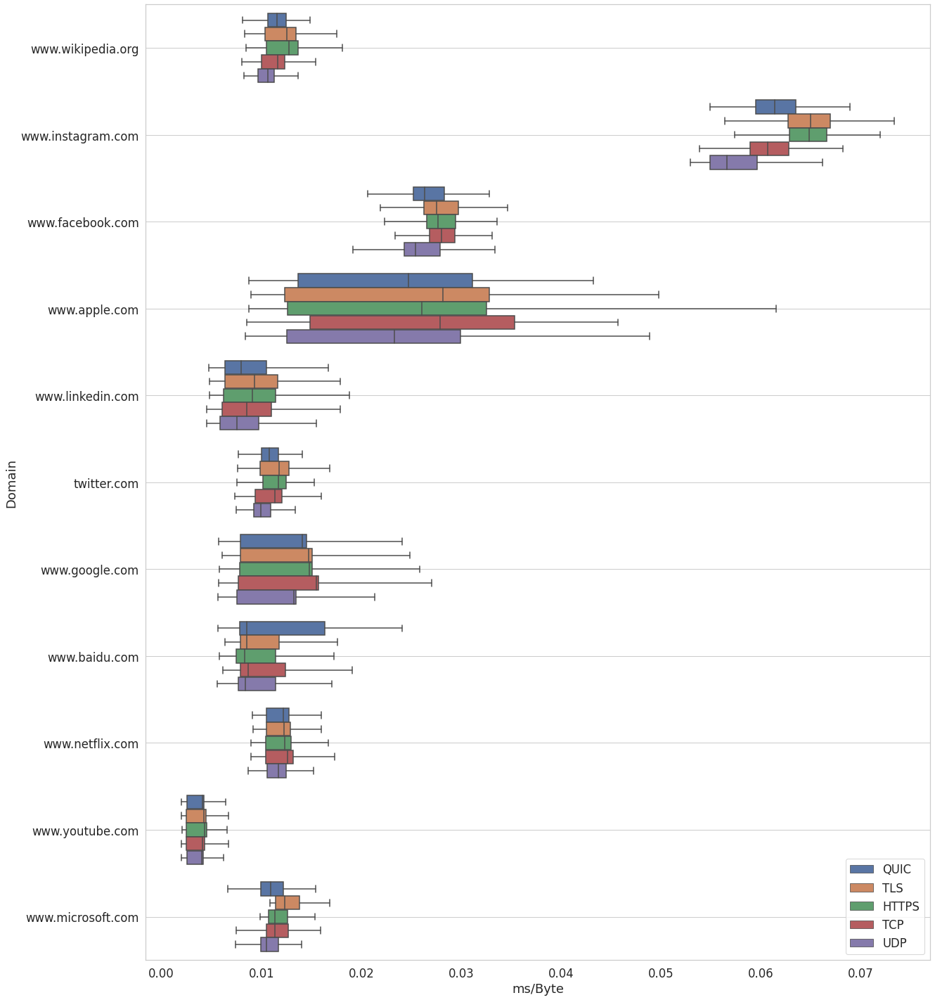

**South America East**

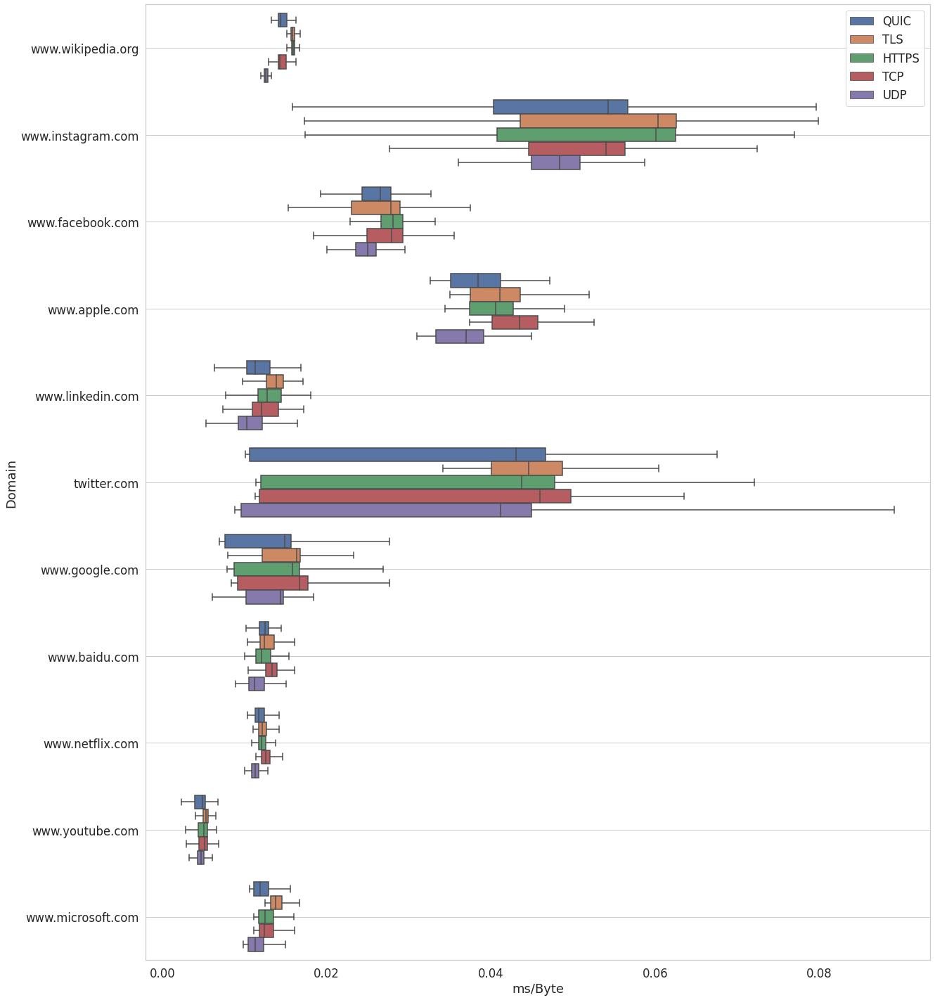

**Africa South**

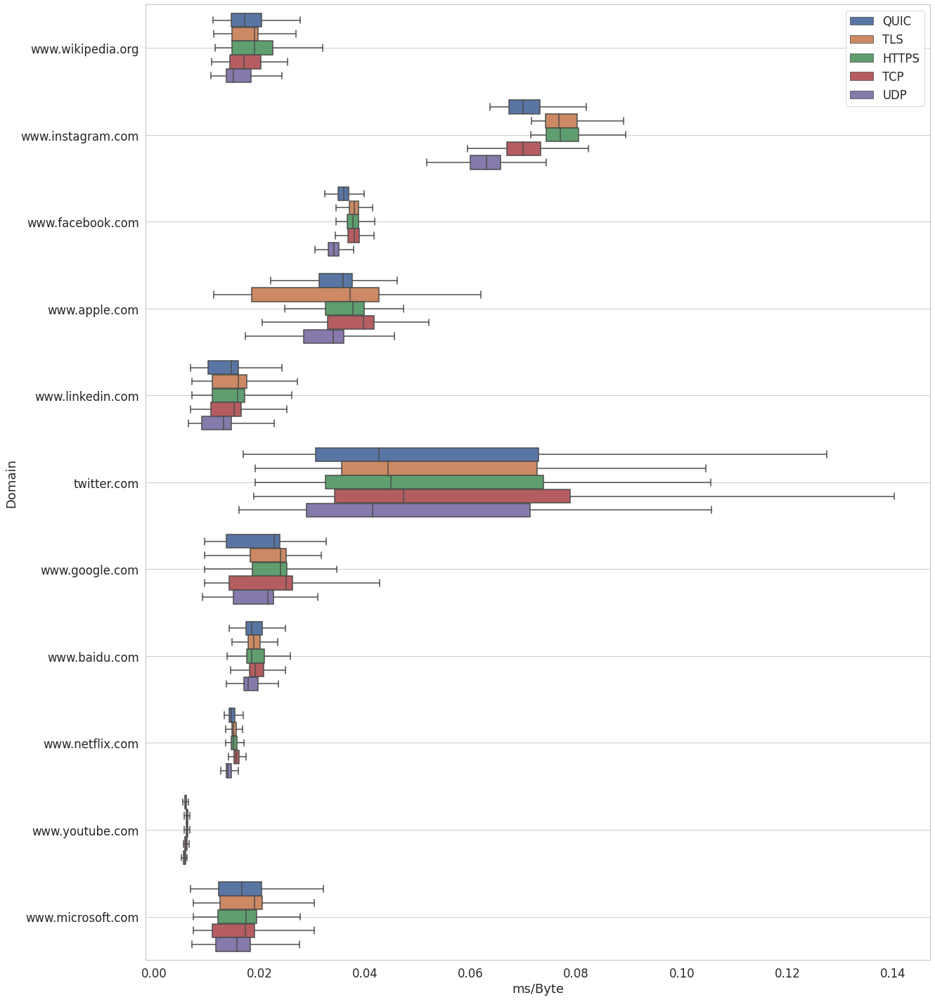

In [57]:
printmd(f"***Page Load Time in Relation to Decoded Body Size***")

plt.rcParams["figure.figsize"] = (20,25)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'domain', value_vars=['timeByDecodedSize'], medians=False, xlabel='ms/Byte', ylabel='Domain')

***Domain Comparison ordered by Number of Queries (Load Event Start)***

**Europe Central**

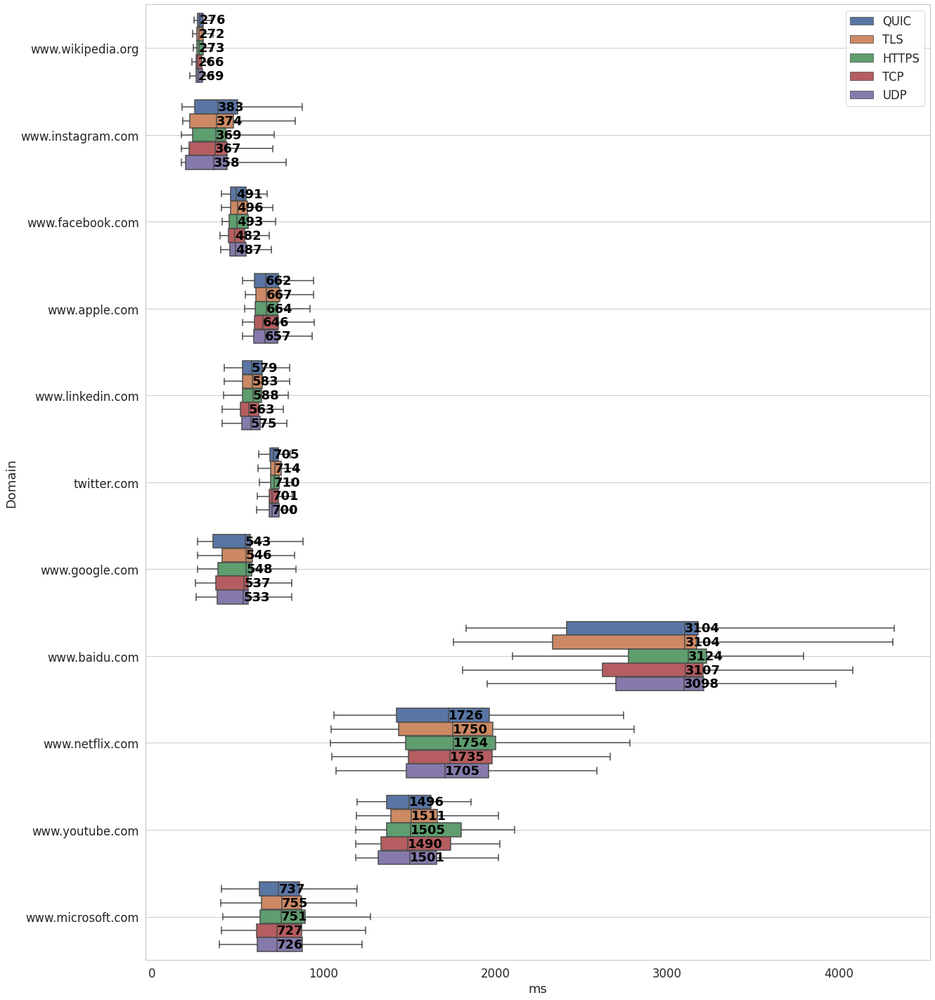

**US West**

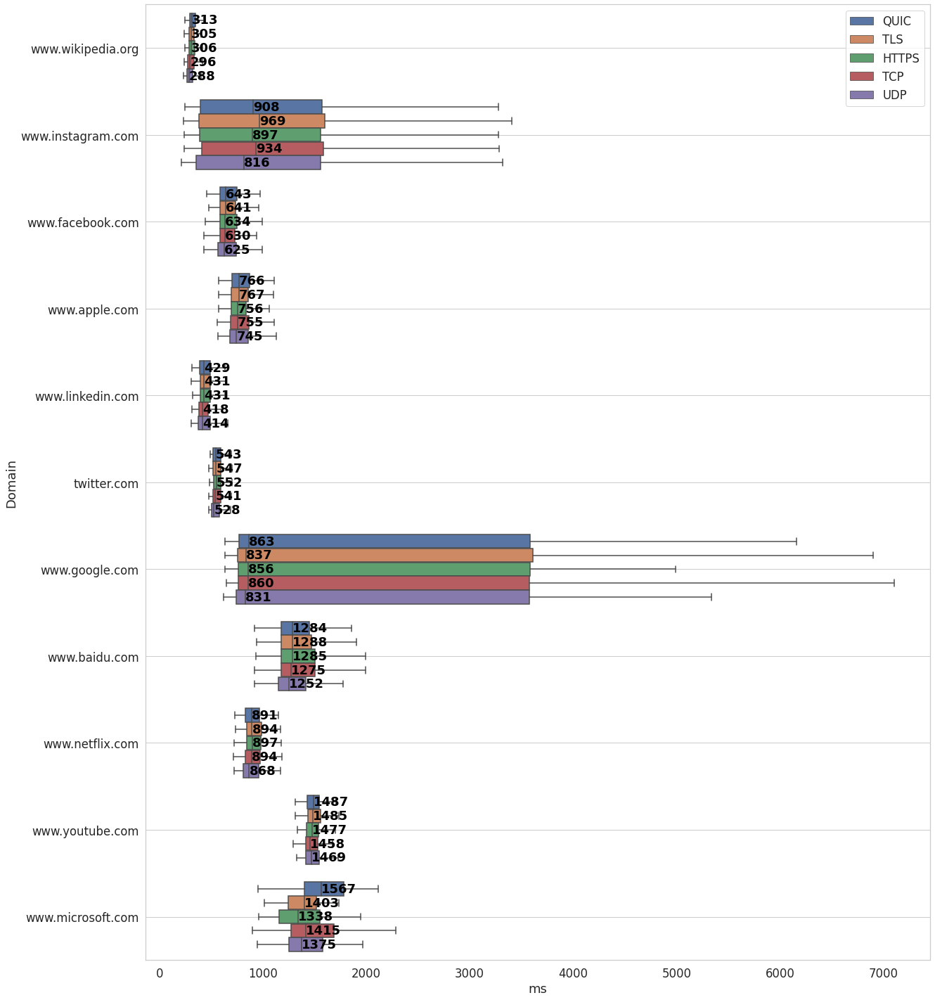

**US East**

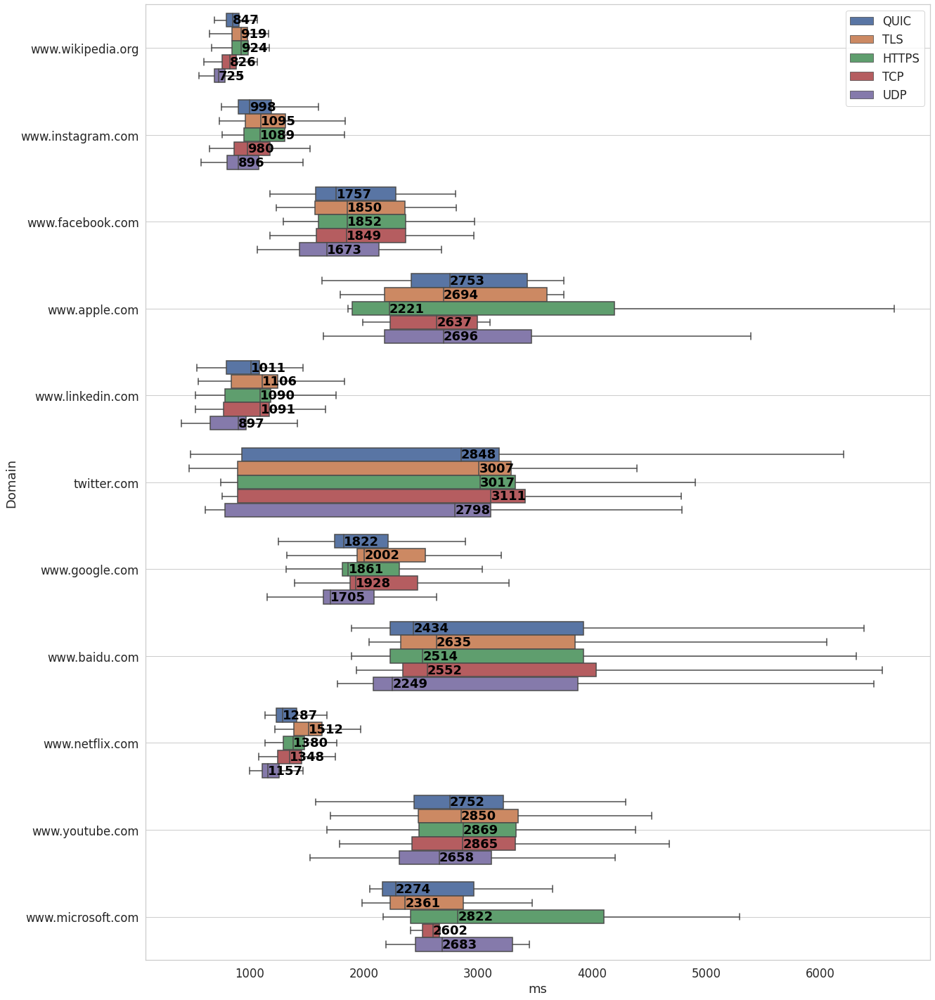

**Asia Pacific Northeast**

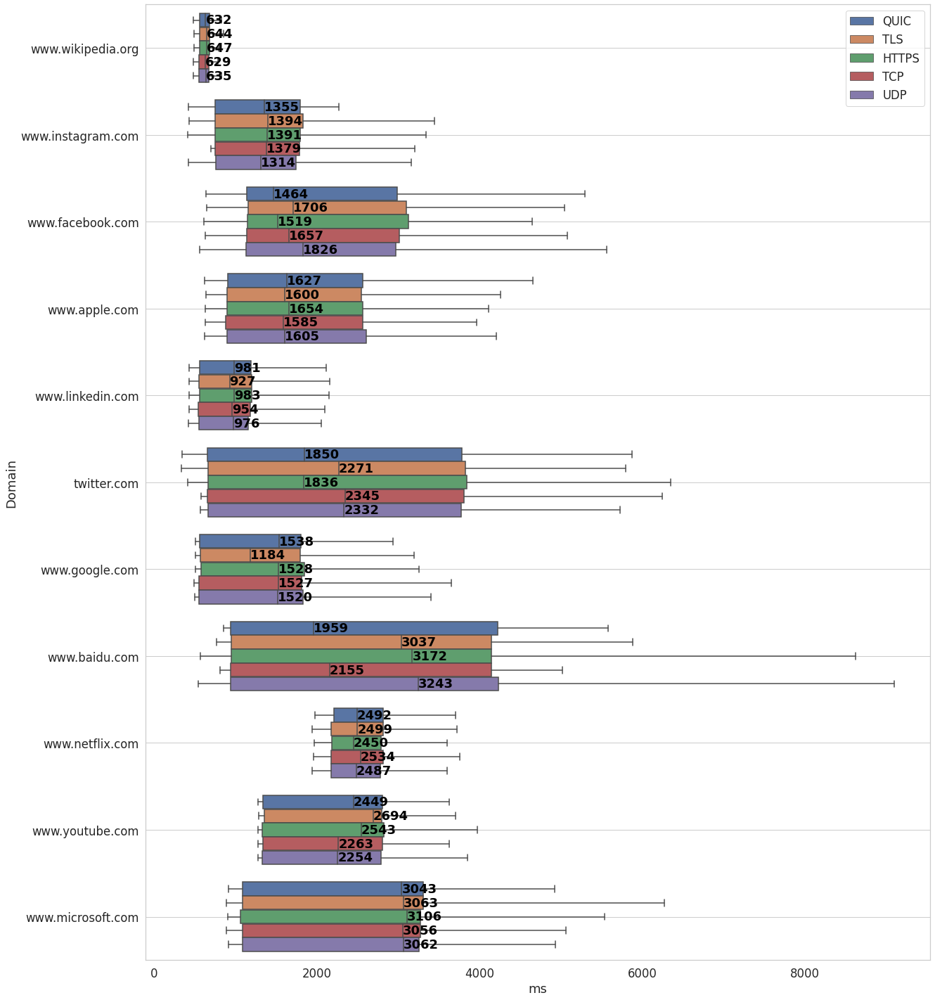

**Asia Pacific Southeast**

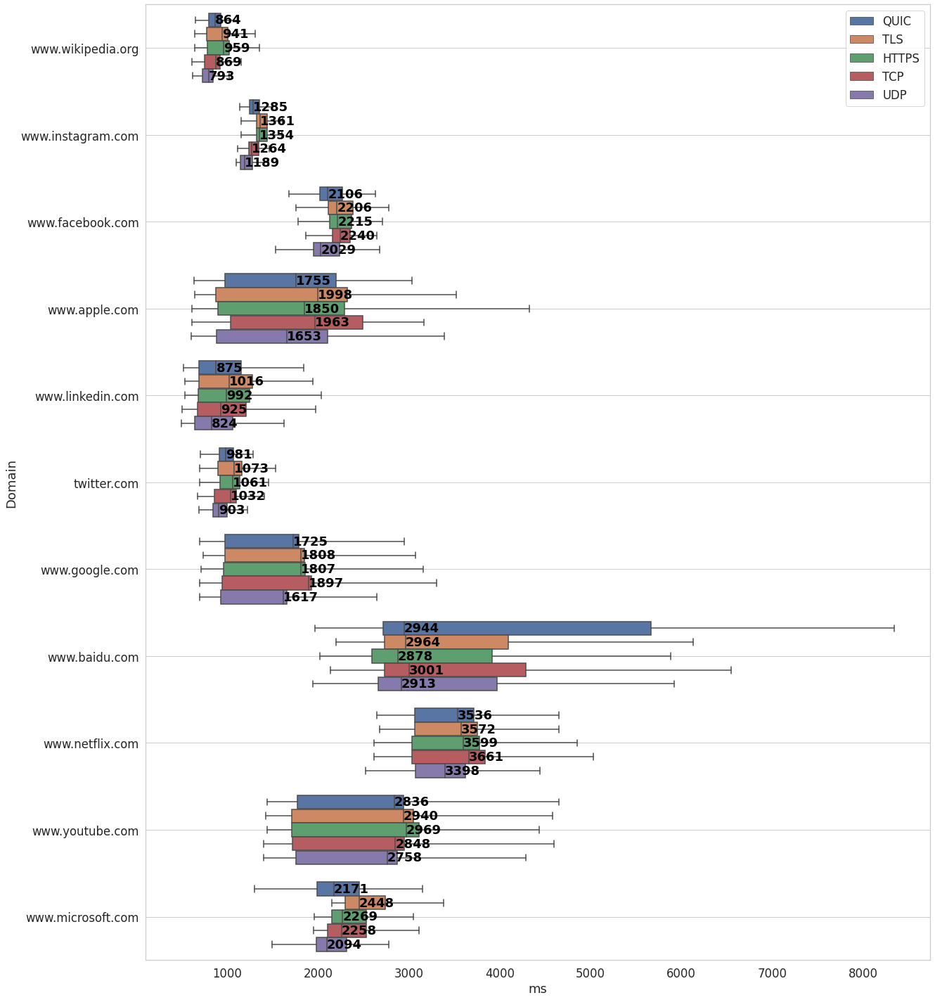

**South America East**

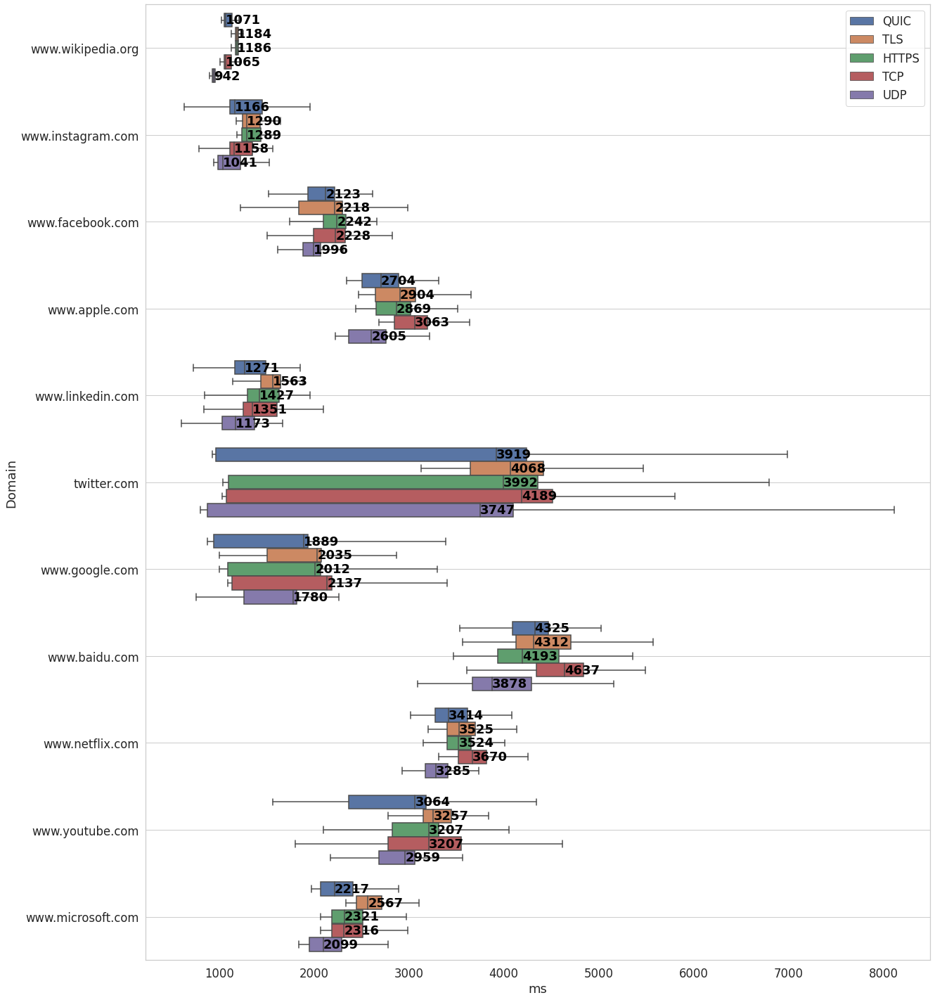

**Africa South**

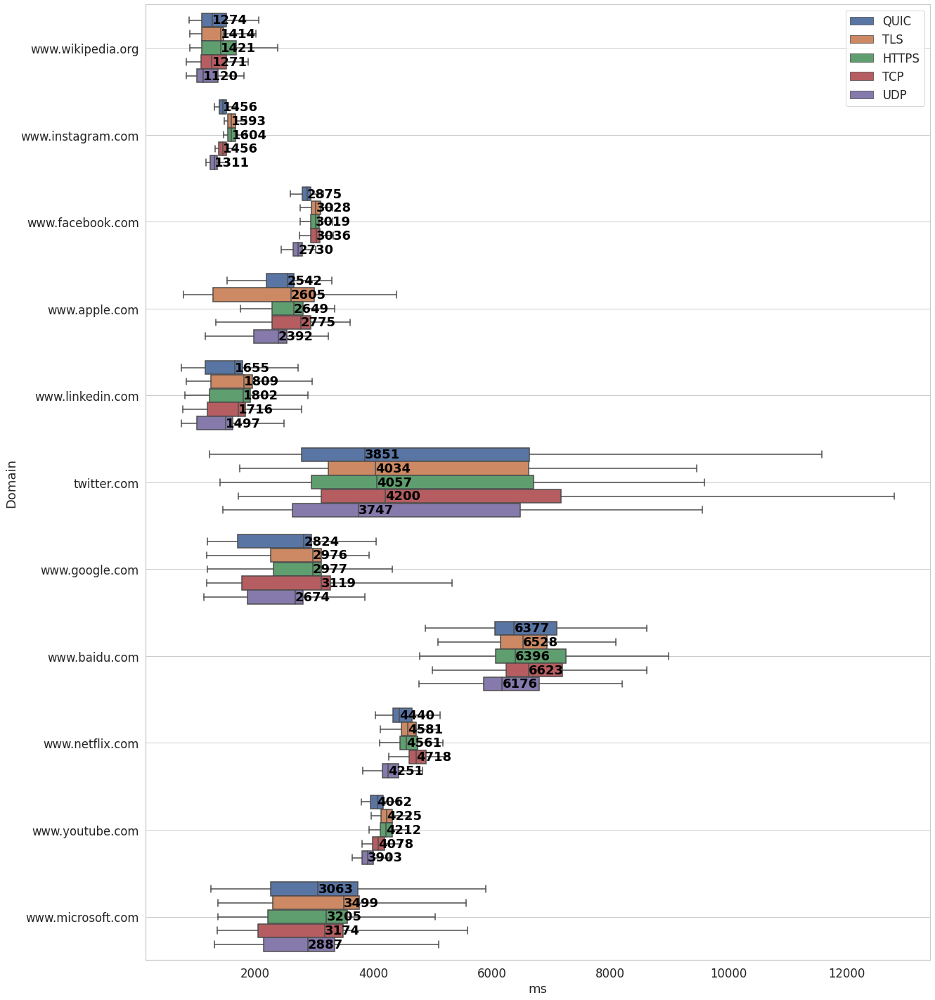

**All**

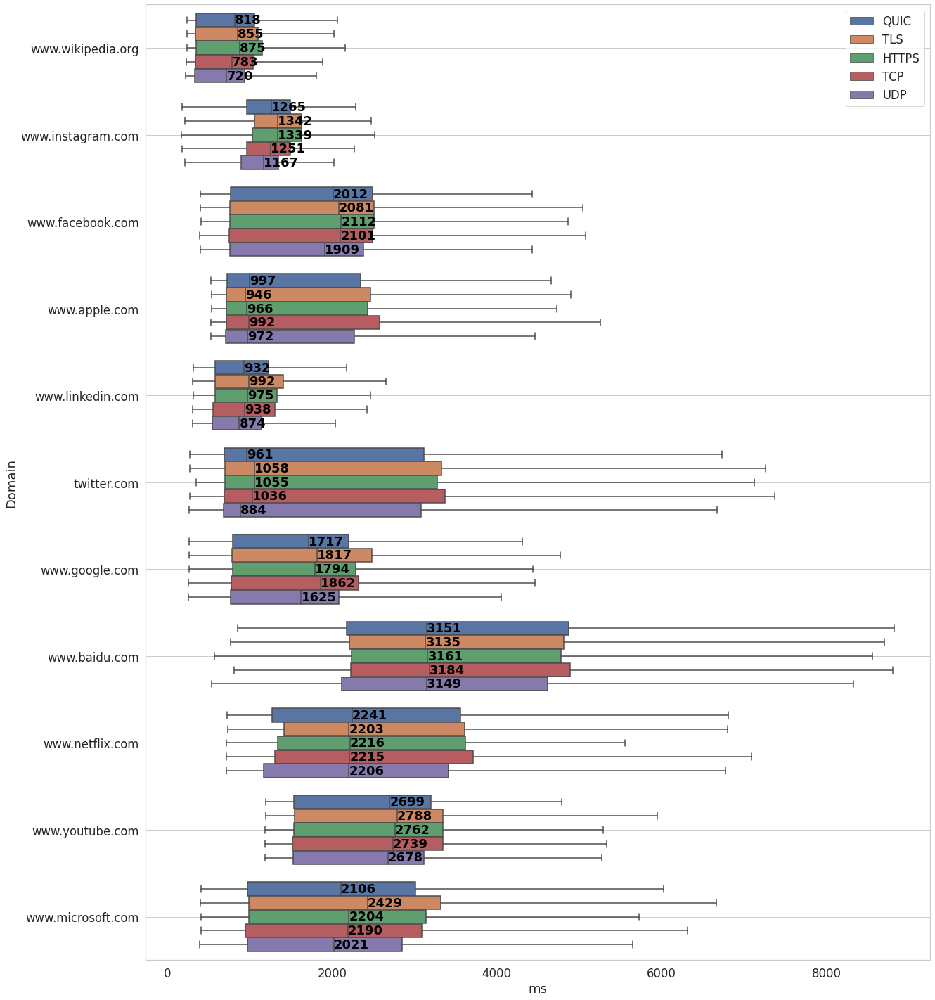

In [58]:
printmd(f"***Domain Comparison ordered by Number of Queries (Load Event Start)***")

plt.rcParams["figure.figsize"] = (20,25)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'domain', ['loadEventStart'], ylabel='Domain')
multiCompare('vantagePoint', 'All', 'domain', ['loadEventStart'], ylabel='Domain')

***Domain Comparison (Lookup End -> Load Event Start)***

**US East**

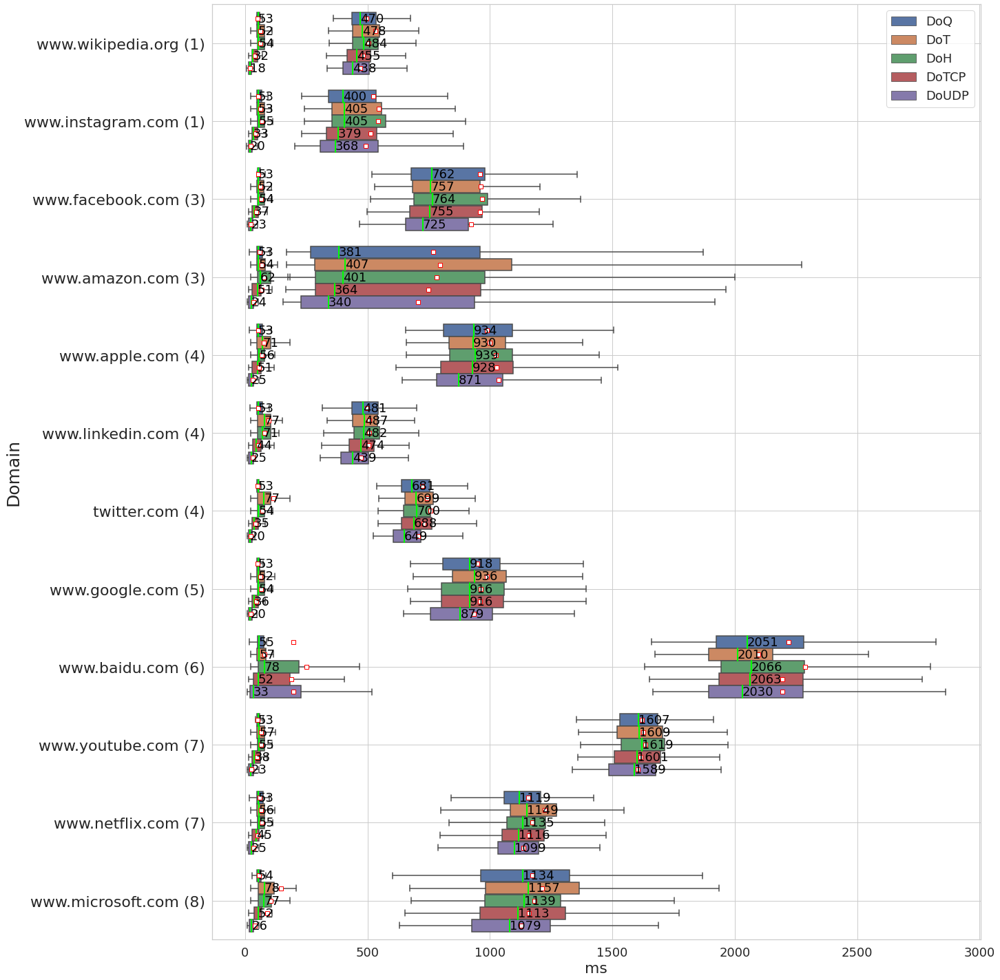

**US West**

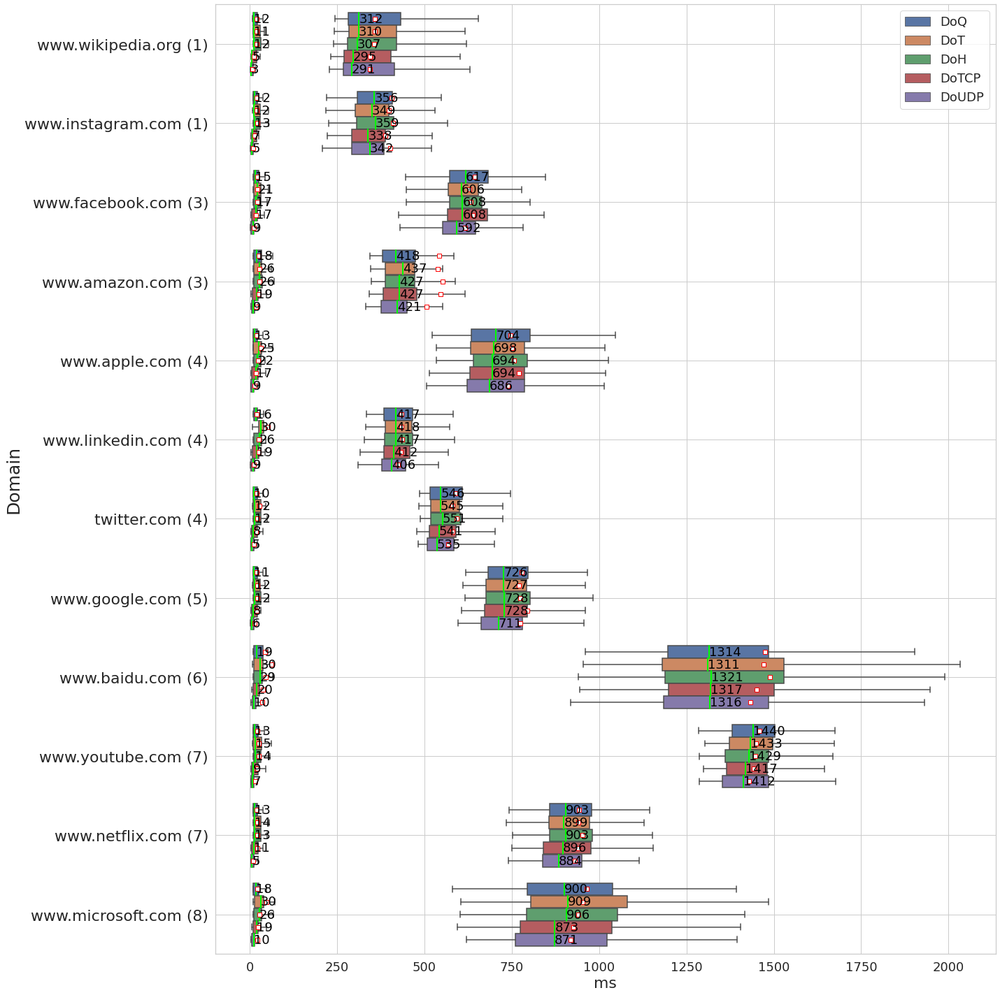

**South America East**

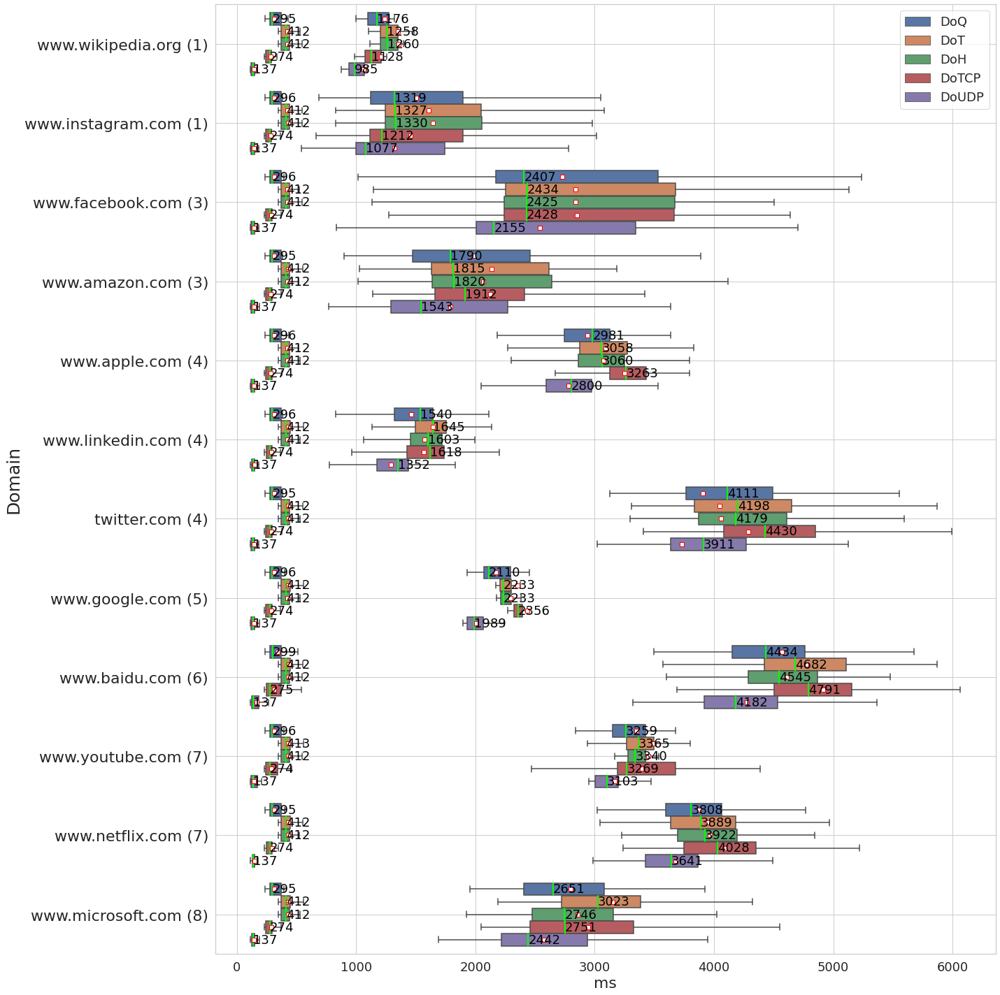

**Europe Central**

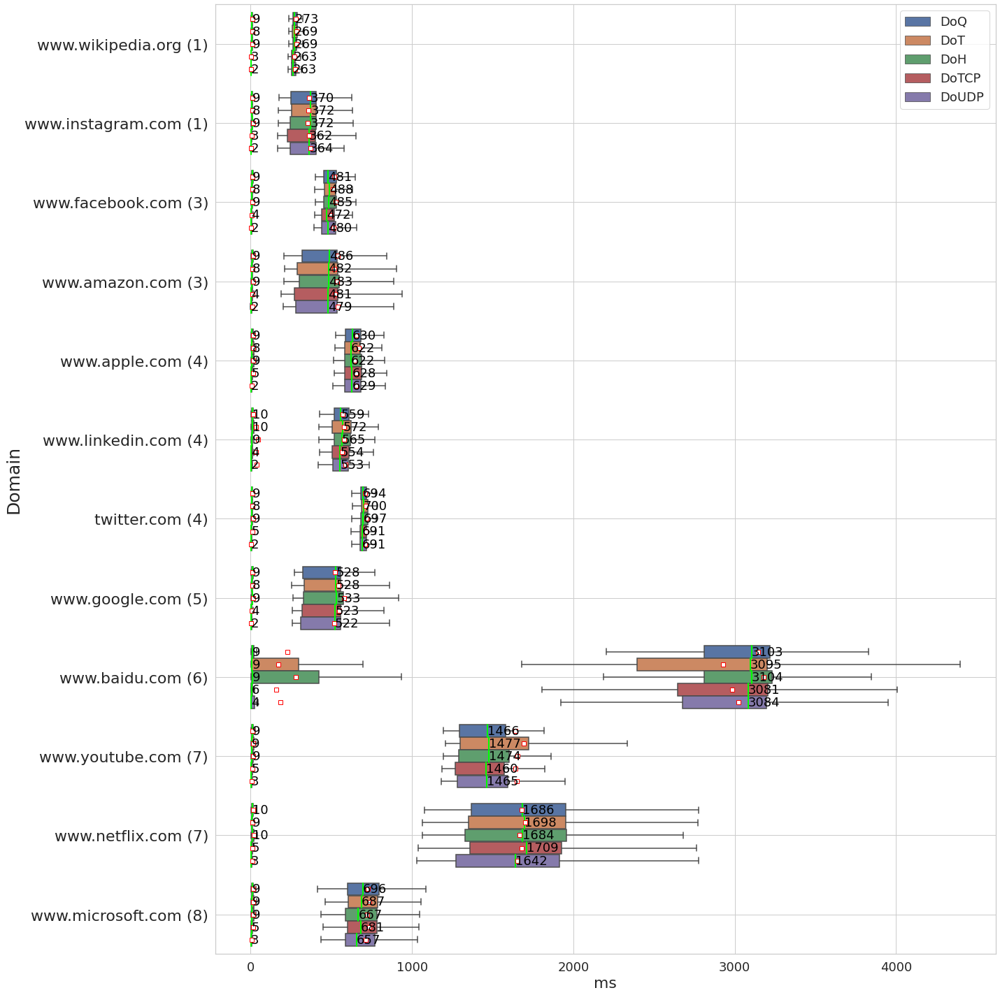

**Asia Pacific Southeast**

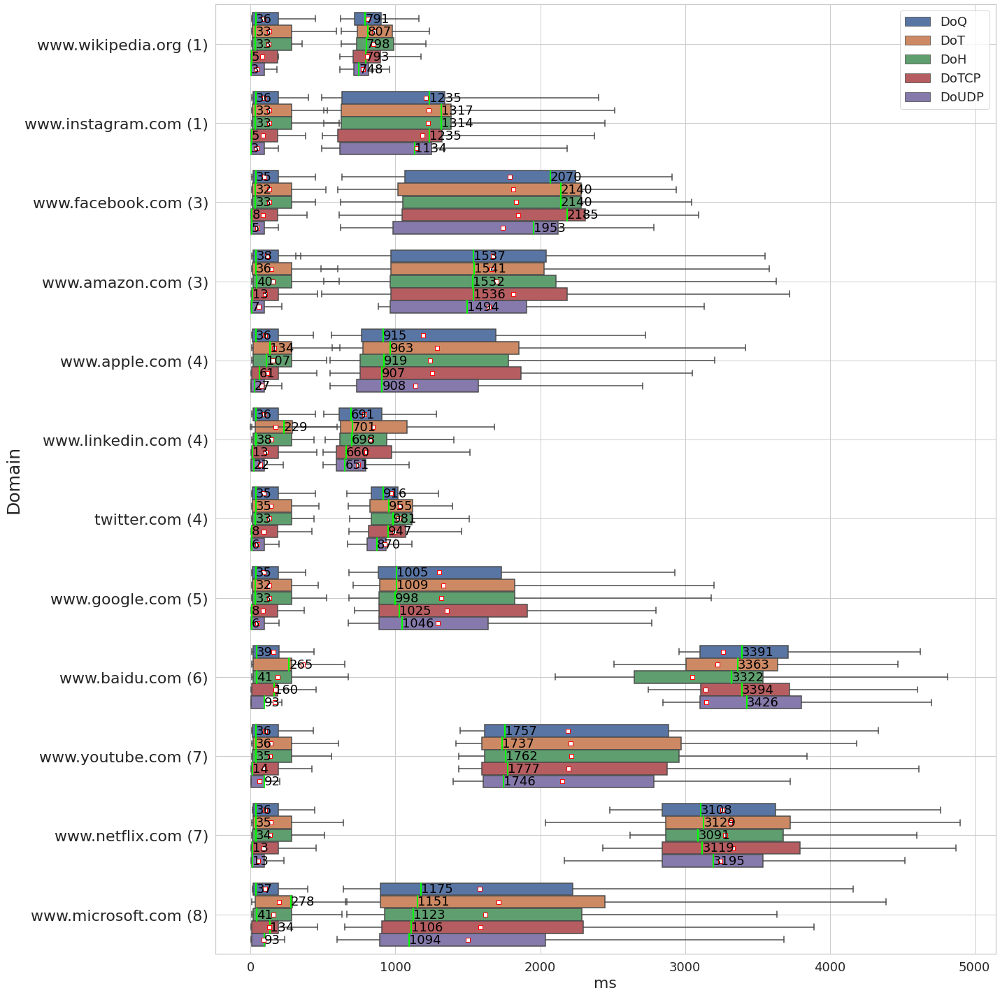

**Asia Pacific Northeast**

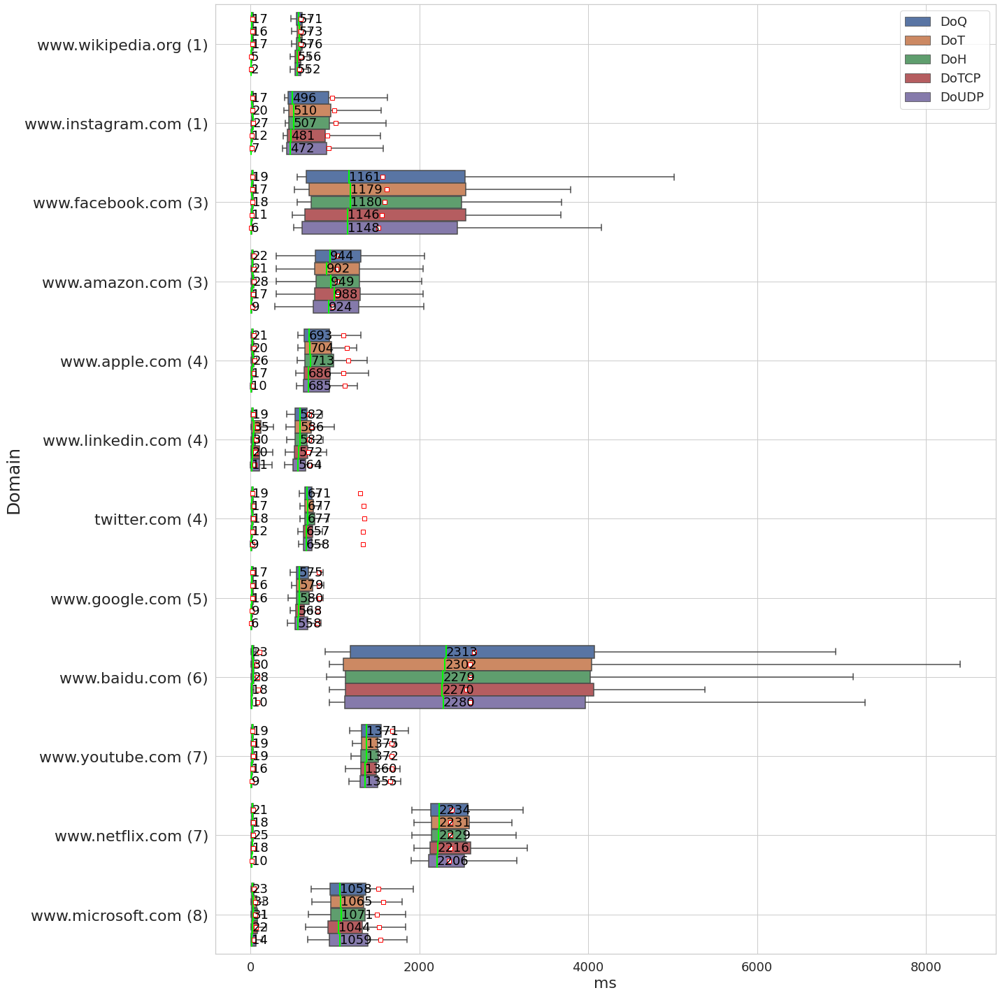

**Africa South**

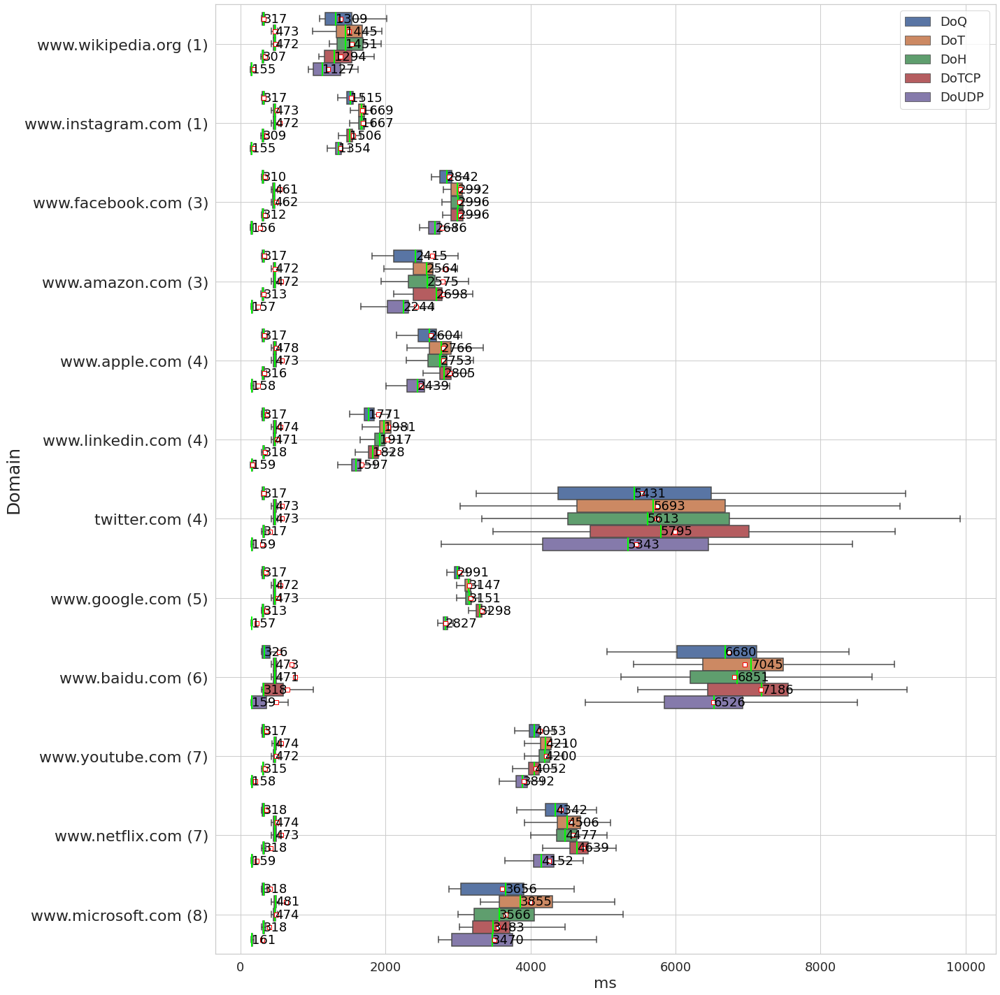

**All**

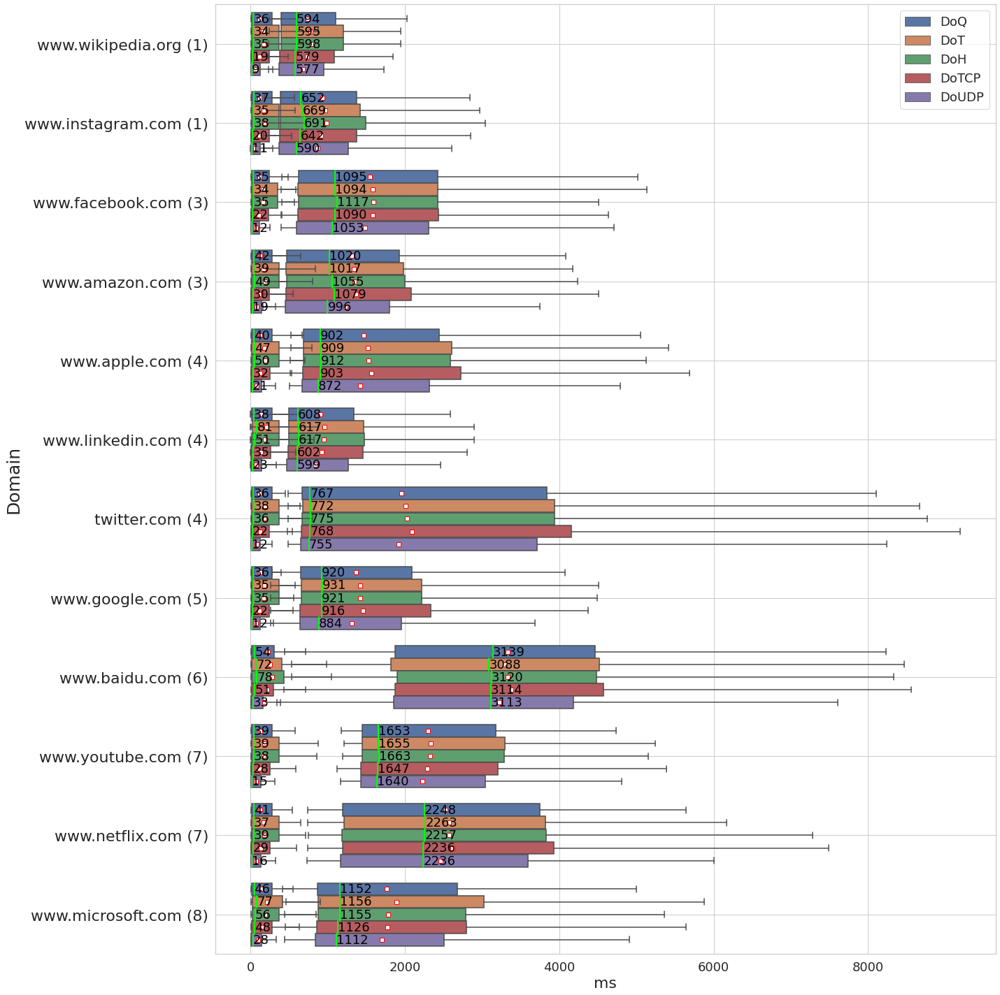

In [521]:
printmd(f"***Domain Comparison (Lookup End -> Load Event Start)***")

plt.rcParams["figure.figsize"] = (20,25)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'domain', ['elapsed', 'loadEventStart'], ylabel='Domain')
multiCompare('vantagePoint', 'All', 'domain', ['elapsed', 'loadEventStart'], ylabel='Domain')

## Compare Upstreams

**Africa South**

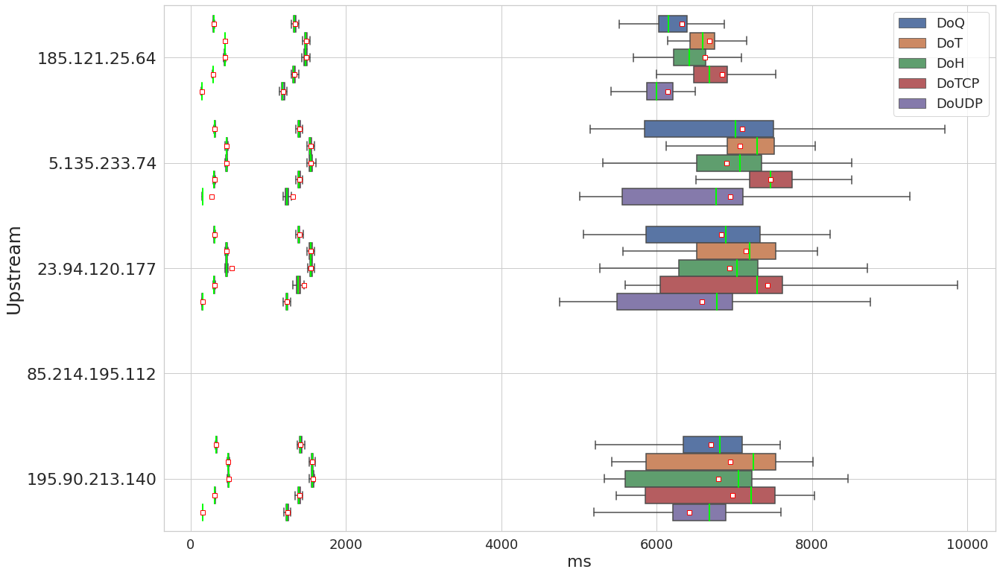

In [538]:
plt.rcParams["figure.figsize"] = (20,13)

multiCompare('vantagePoint', 'Africa South', 'server', ['elapsed', 'responseStart', 'loadEventStart'], server_domain='www.baidu.com', ylabel='Upstream', medians=False)

**Asia Pacific Southeast**

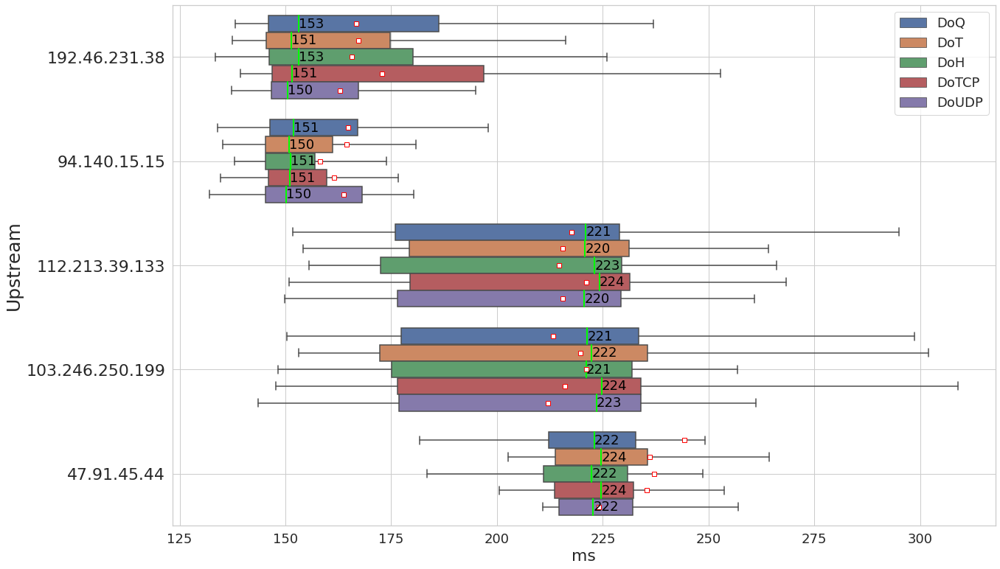

In [279]:
plt.rcParams["figure.figsize"] = (20,13)

multiCompare('vantagePoint', 'Asia Pacific Southeast', 'server', ['serverRTT'], server_domain='www.google.com', ylabel='Upstream')

***Upstream Comparison Google.com (Lookup End -> Load Event Start)***

**US East**

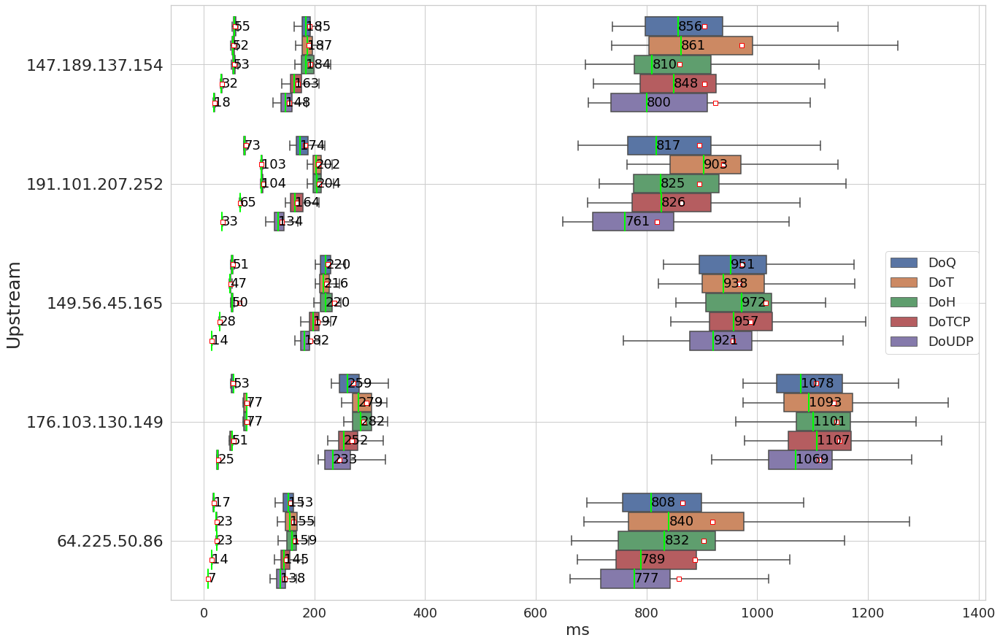

**US West**

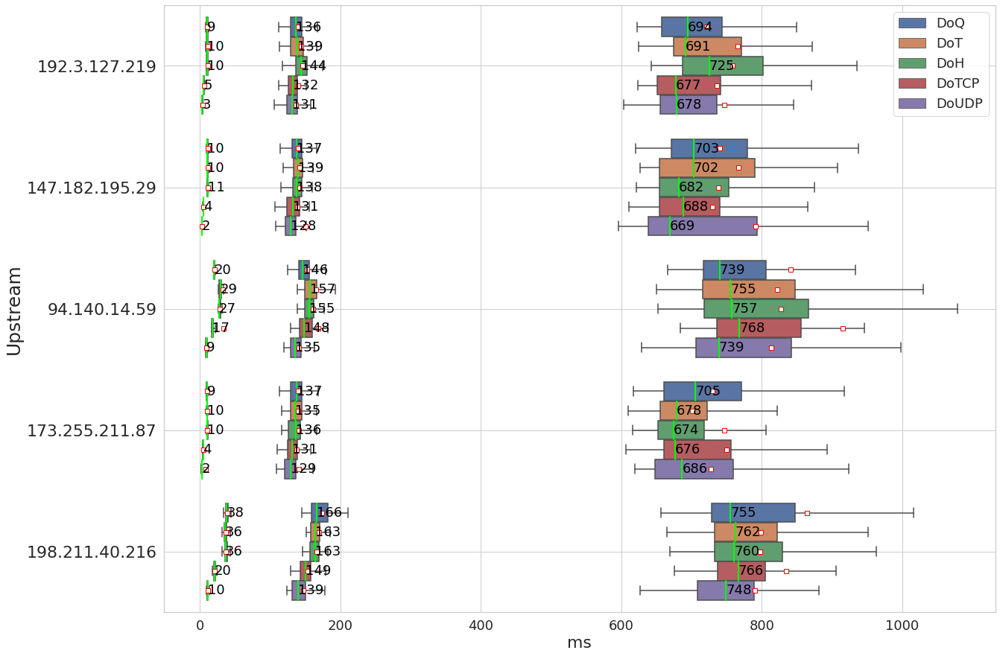

**South America East**

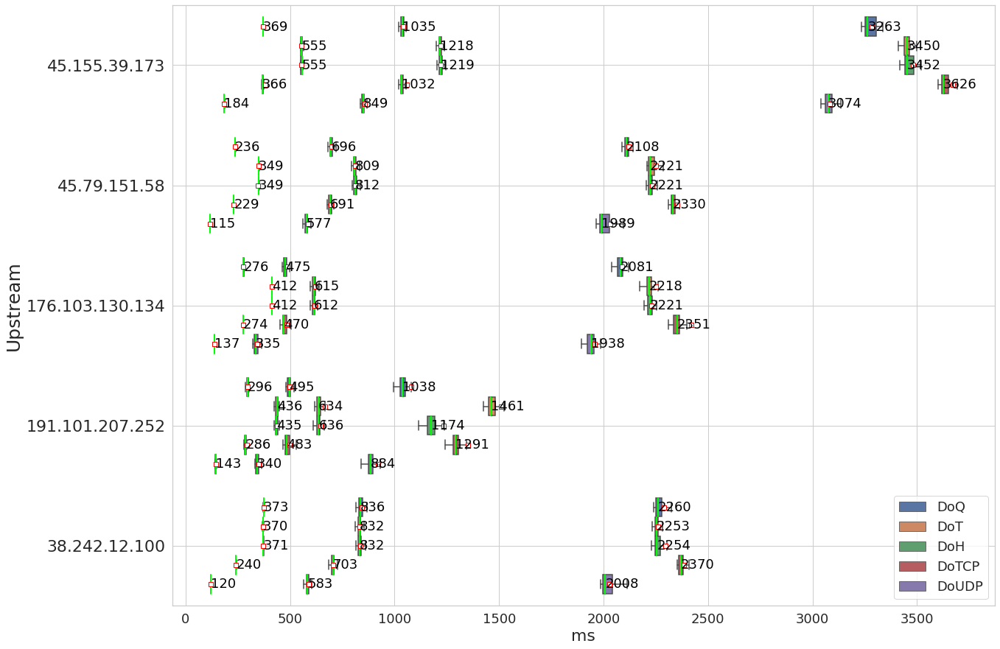

**Europe Central**

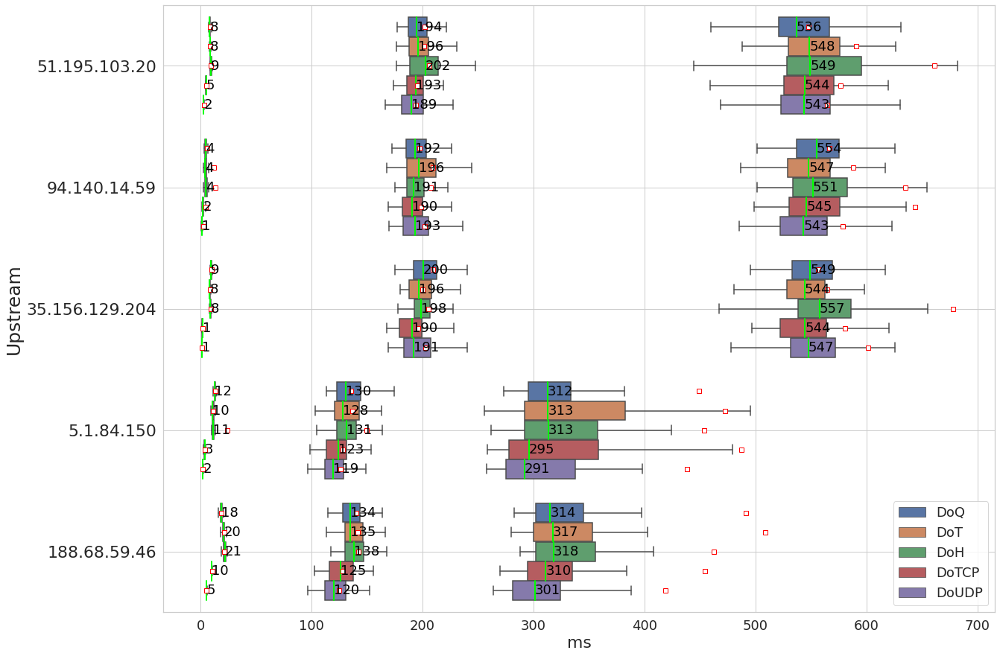

**Asia Pacific Southeast**

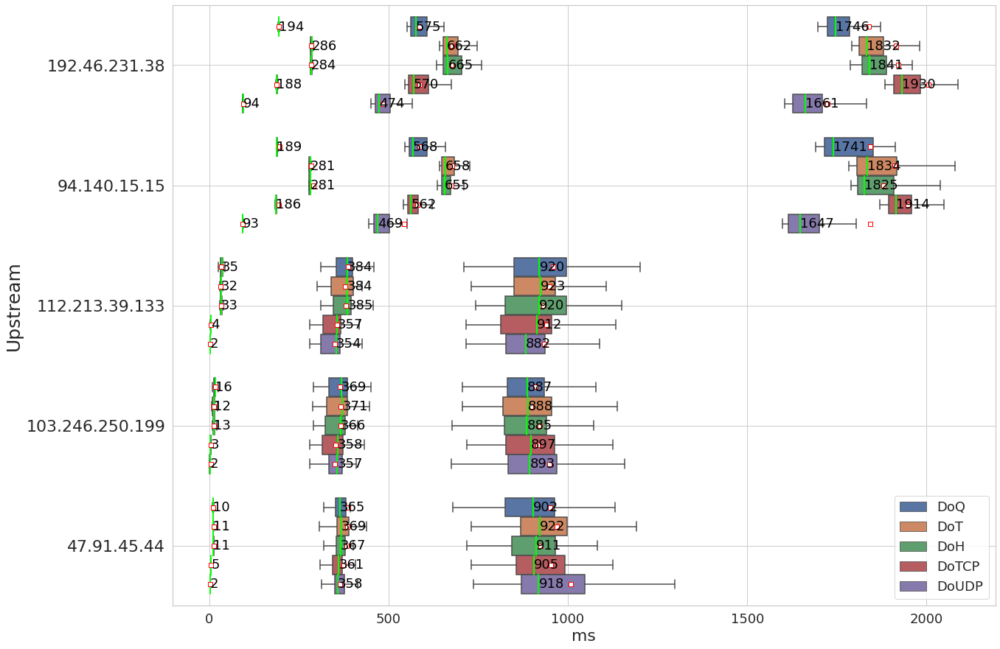

**Asia Pacific Northeast**

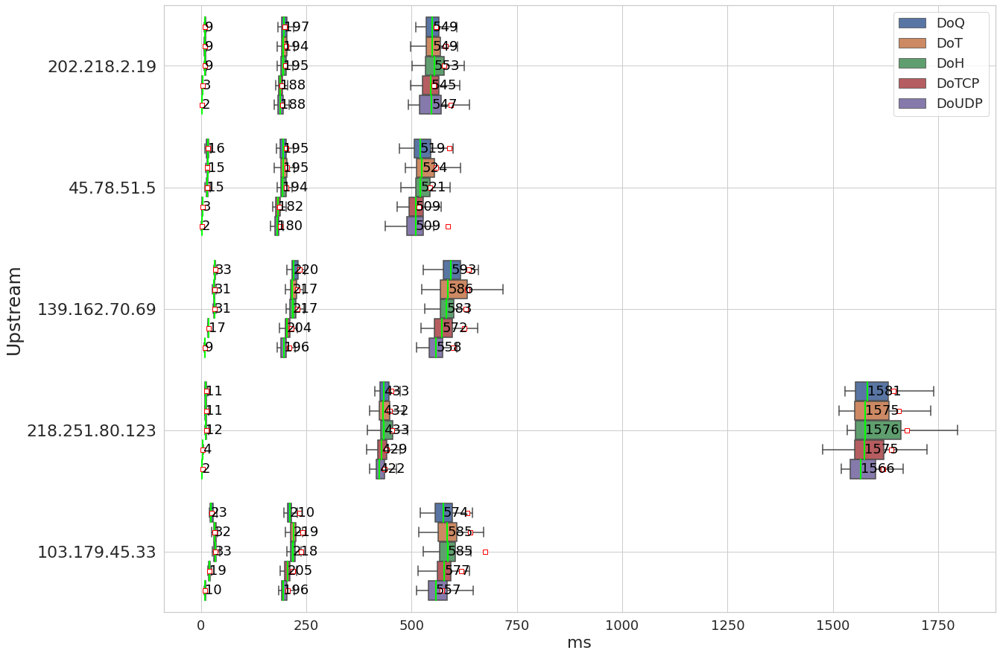

**Africa South**

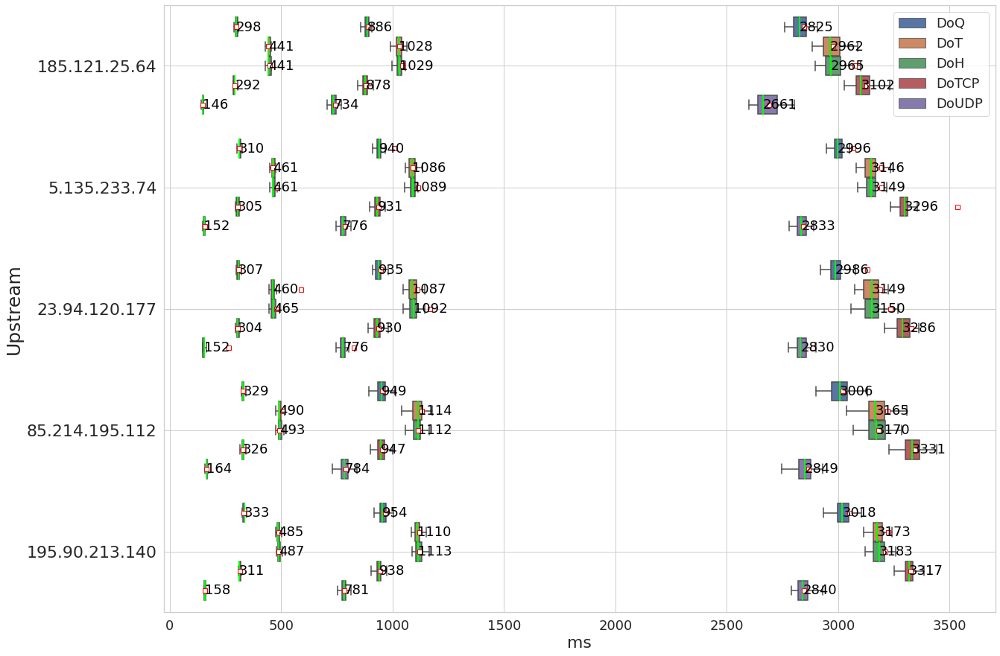

**All**

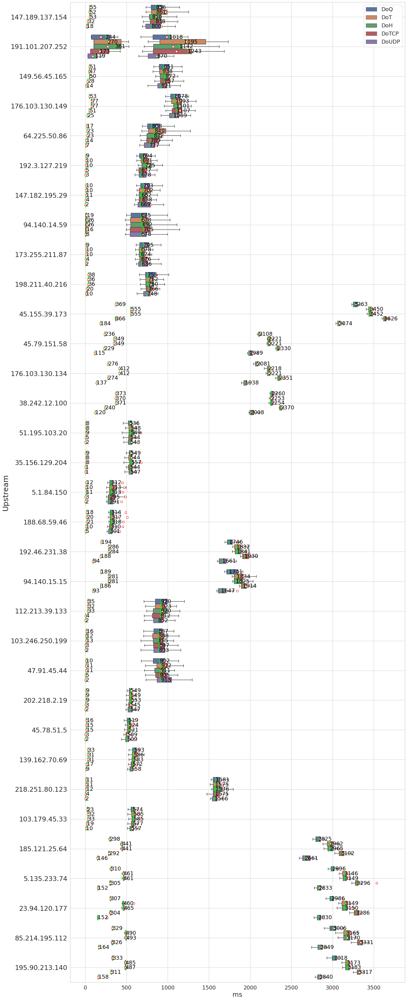

In [281]:
printmd(f"***Upstream Comparison Google.com (Lookup End -> Load Event Start)***")

plt.rcParams["figure.figsize"] = (20,15)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'server', ['elapsed', 'responseStart', 'loadEventStart'], server_domain='www.google.com', ylabel='Upstream')
plt.rcParams["figure.figsize"] = (20,60)
multiCompare('vantagePoint', 'All', 'server', ['elapsed', 'loadEventStart'], server_domain='www.google.com', ylabel='Upstream')

In [266]:
domain = 'www.netflix.com'
df_domain = df[df['domain'] == domain]
for vantagePoint in vp_order:
    print(vantagePoint)
    df_vp = df_domain[df_domain['vantagePoint'] == vantagePoint]
    servers = df_vp['server'].unique().tolist()
    results = {}
    for server in servers:
        results[server] = {}
    for index, row in df_vp.iterrows():
        ip = re.search("(?<=IN,A,)(.*?)(?=\|)", row.answer)[0]            
        subnet = IPNetwork(ip + '/14')
        if subnet in results[row.server]:
            results[row.server][subnet] = results[row.server][subnet] + 1
        else:
            results[row.server][subnet] = 1
    for server in servers:
        for k in list(results[server].keys()):
            if results[server][k] < 100:
                del results[server][k]
    pprint(results)

US East
{'147.189.137.154': {},
 '149.56.45.165': {},
 '176.103.130.149': {IPNetwork('44.242.60.85/14'): 209},
 '191.101.207.252': {IPNetwork('44.242.13.161/14'): 235},
 '64.225.50.86': {}}
US West
{'147.182.195.29': {IPNetwork('44.240.158.19/14'): 200},
 '173.255.211.87': {IPNetwork('44.240.158.19/14'): 220},
 '192.3.127.219': {IPNetwork('44.240.158.19/14'): 218},
 '198.211.40.216': {IPNetwork('44.240.158.19/14'): 215},
 '94.140.14.59': {IPNetwork('44.242.13.161/14'): 224}}
South America East
{'176.103.130.134': {IPNetwork('44.240.158.19/14'): 200},
 '191.101.207.252': {IPNetwork('44.240.158.19/14'): 193},
 '38.242.12.100': {},
 '45.155.39.173': {},
 '45.79.151.58': {}}
Europe Central
{'188.68.59.46': {},
 '35.156.129.204': {},
 '5.1.84.150': {},
 '51.195.103.20': {IPNetwork('54.155.178.5/14'): 100},
 '94.140.14.59': {}}
Asia Pacific Southeast
{'103.246.250.199': {IPNetwork('44.242.60.85/14'): 217},
 '112.213.39.133': {IPNetwork('44.242.60.85/14'): 218},
 '192.46.231.38': {IPNetwork('

***Server Comparison (Lookup End) with Outliers***

**Europe Central**

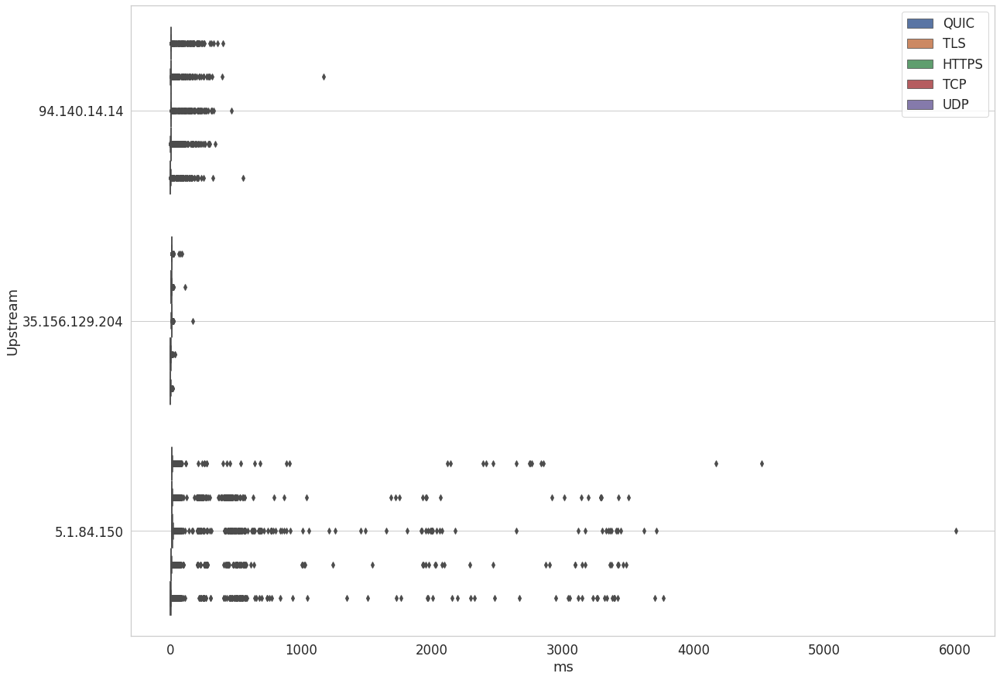

**US West**

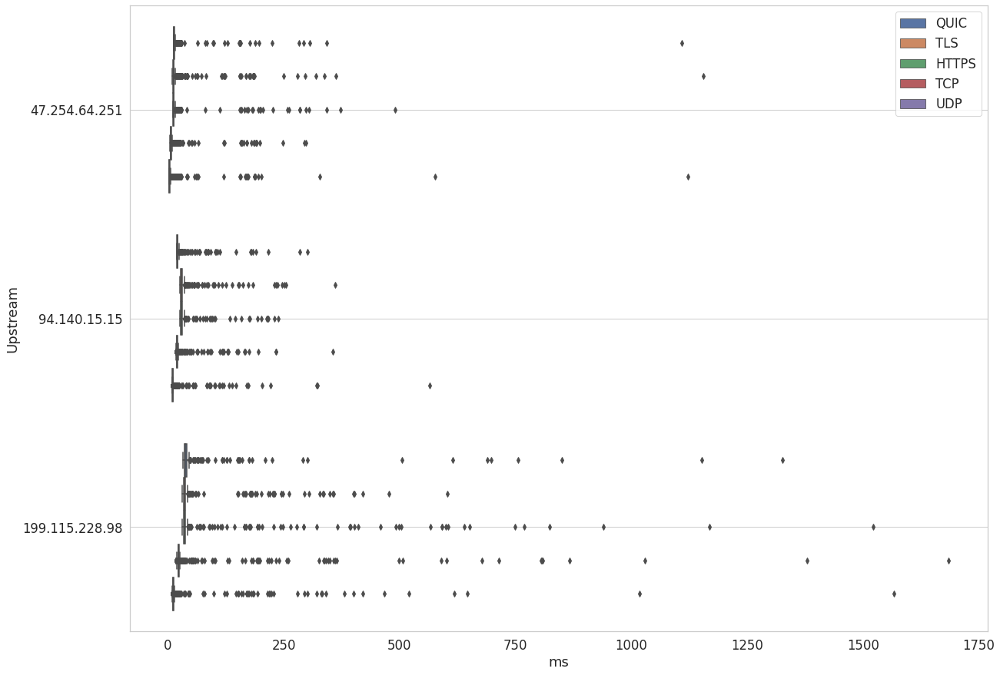

**US East**

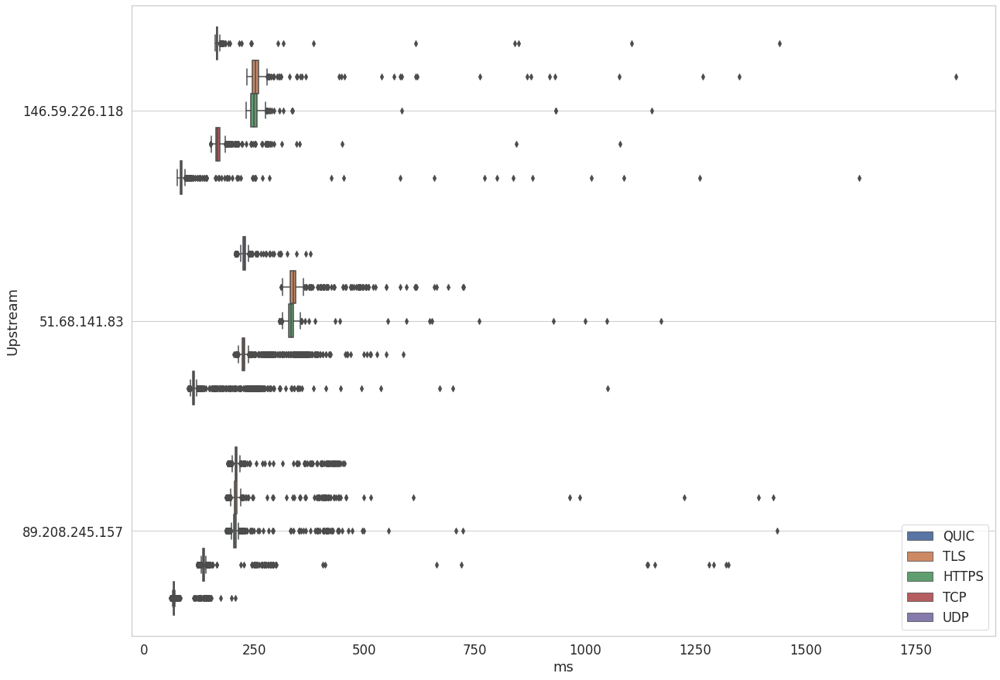

**Asia Pacific Northeast**

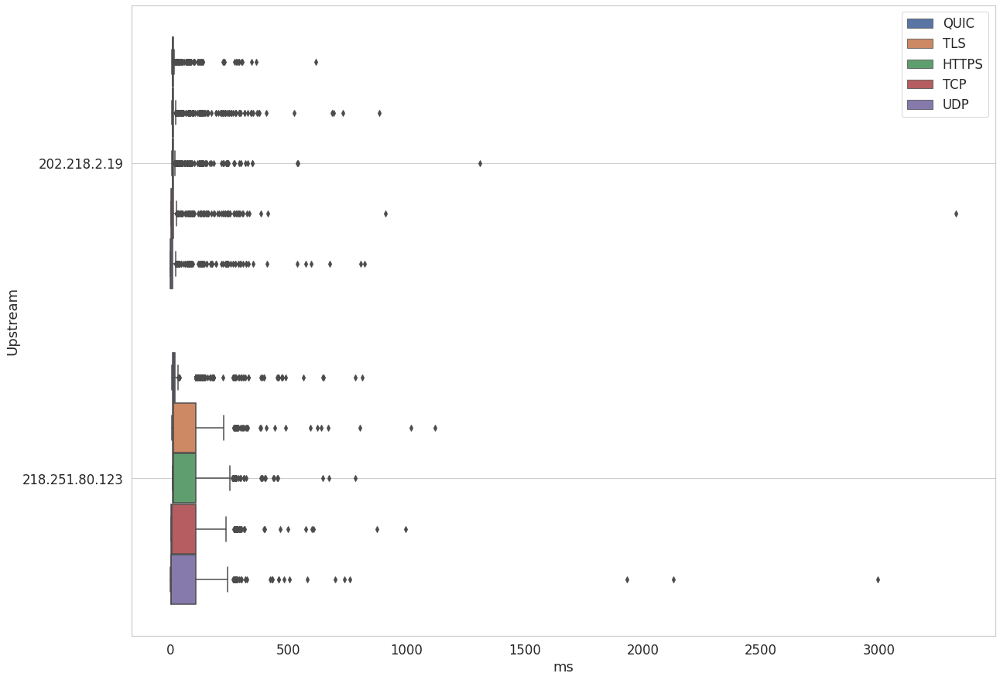

**Asia Pacific Southeast**

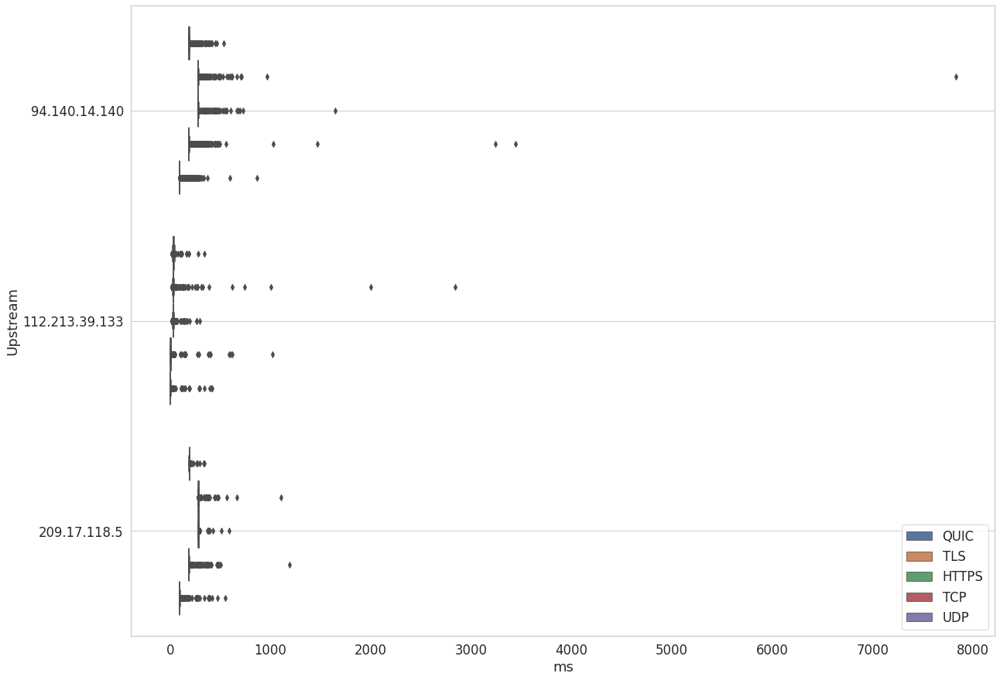

**South America East**

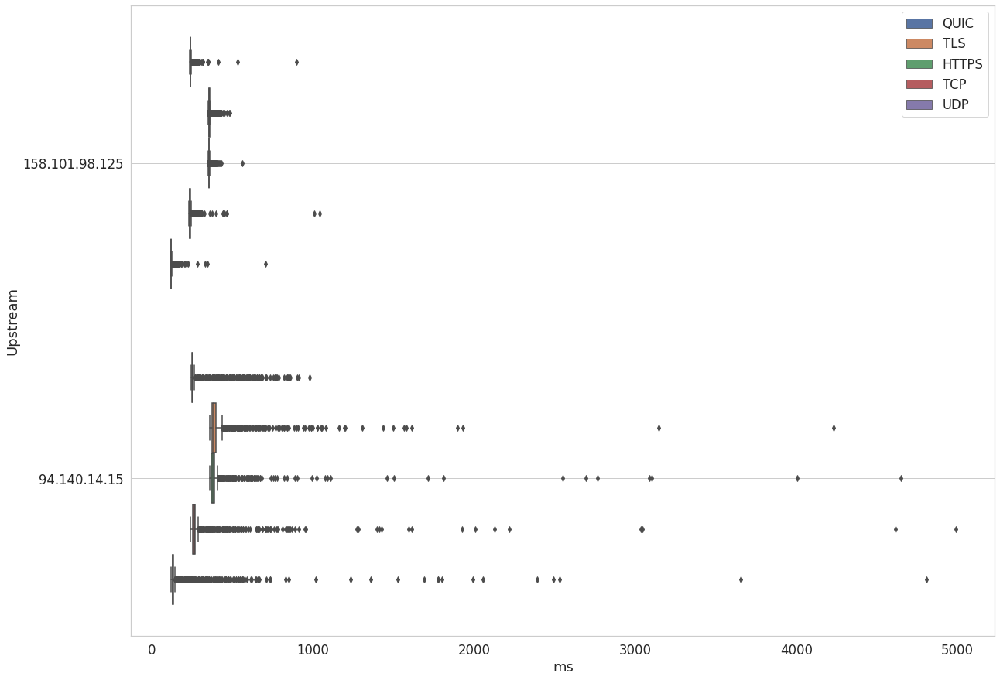

**Africa South**

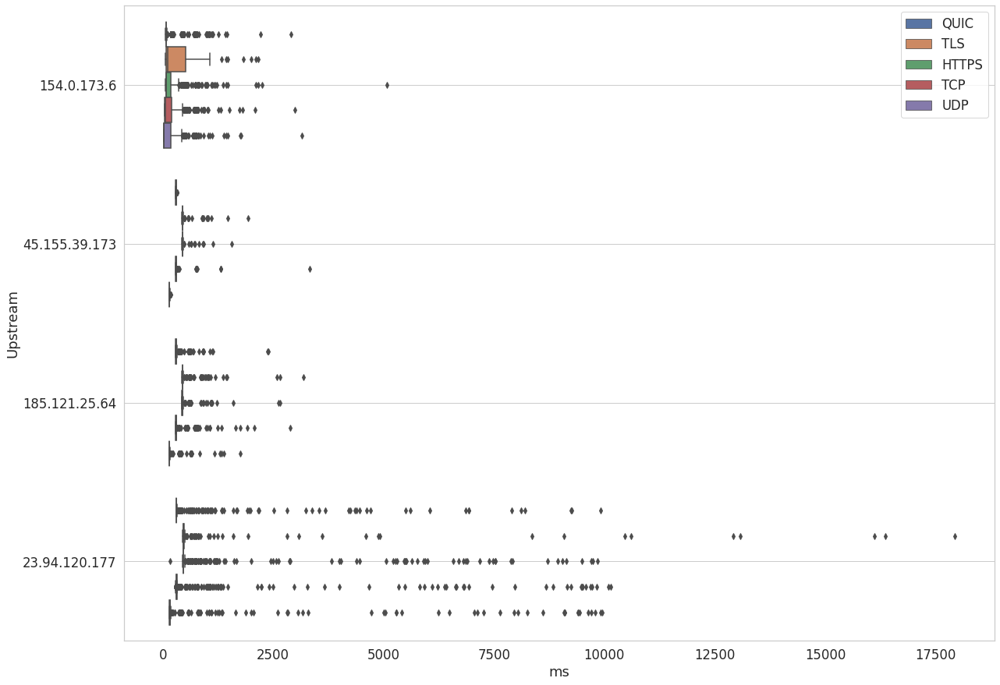

**All**

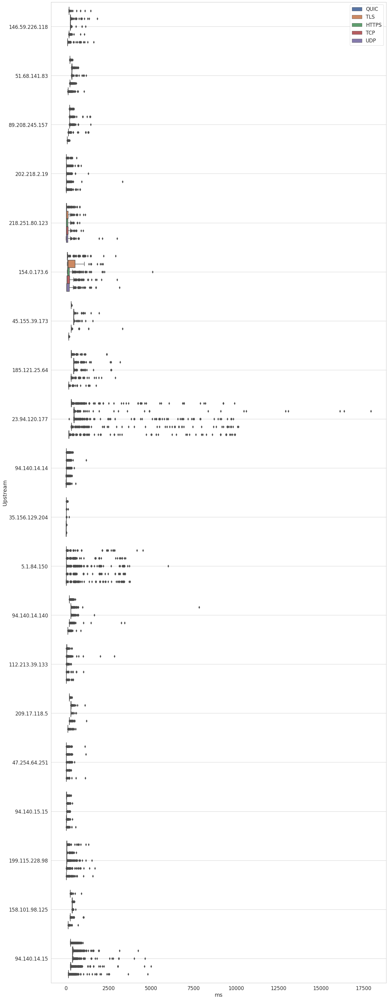

In [25]:
printmd(f"***Server Comparison (Lookup End) with Outliers***")

plt.rcParams["figure.figsize"] = (20,15)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'server', ['max_lookup_end'], ylabel='Upstream', showfliers=True, medians=False)
plt.rcParams["figure.figsize"] = (20,60)
multiCompare('vantagePoint', 'All', 'server', ['max_lookup_end'], ylabel='Upstream', showfliers=True, medians=False)

***Server Comparison (Lookup End)***

**Europe Central**

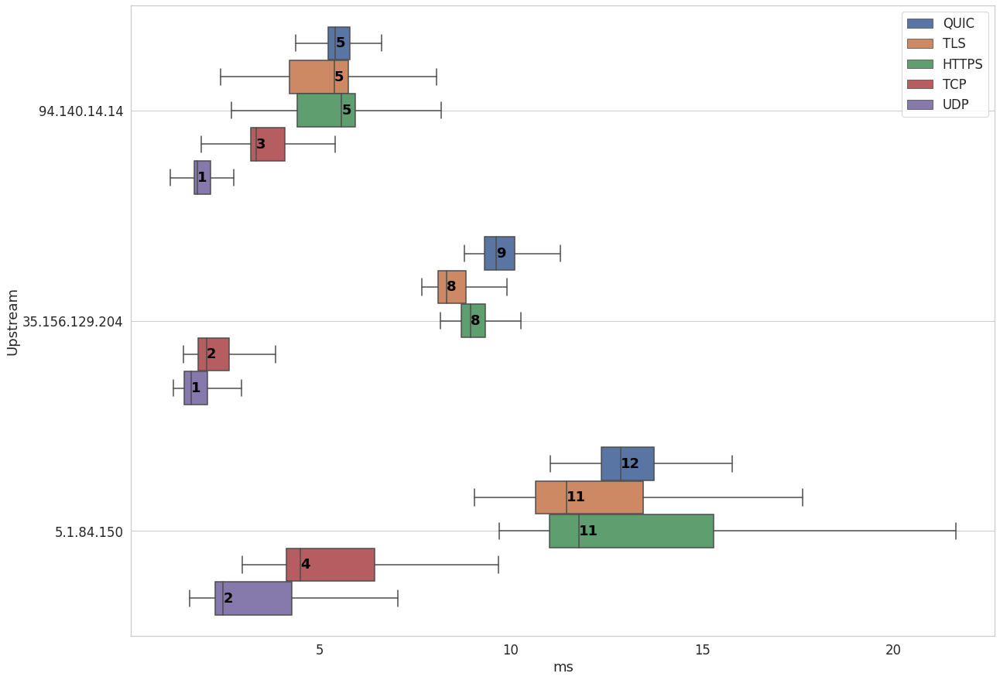

**US West**

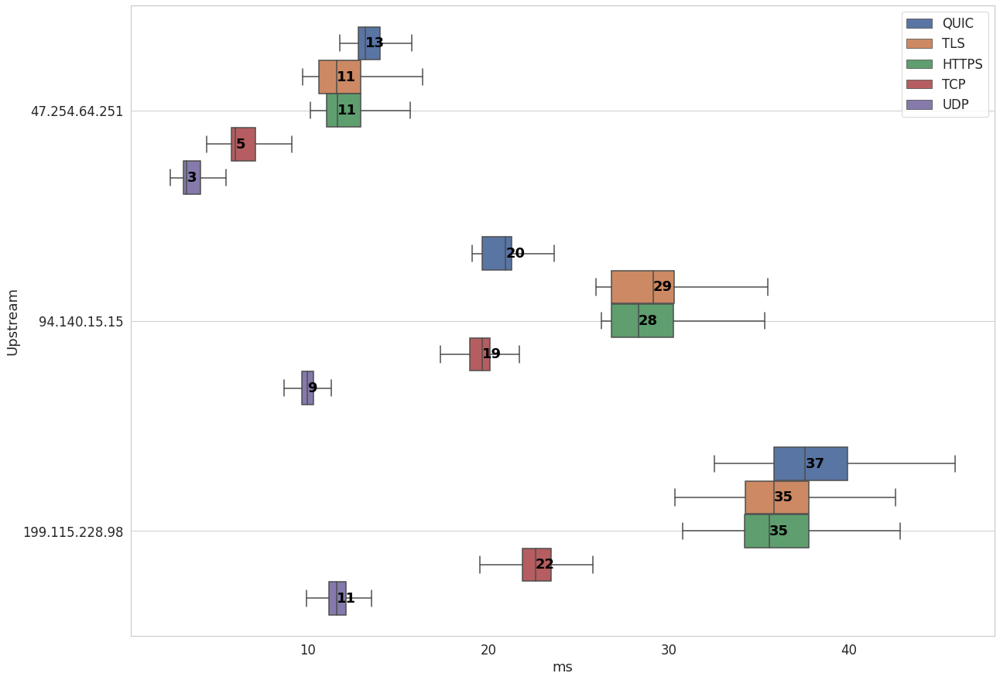

**US East**

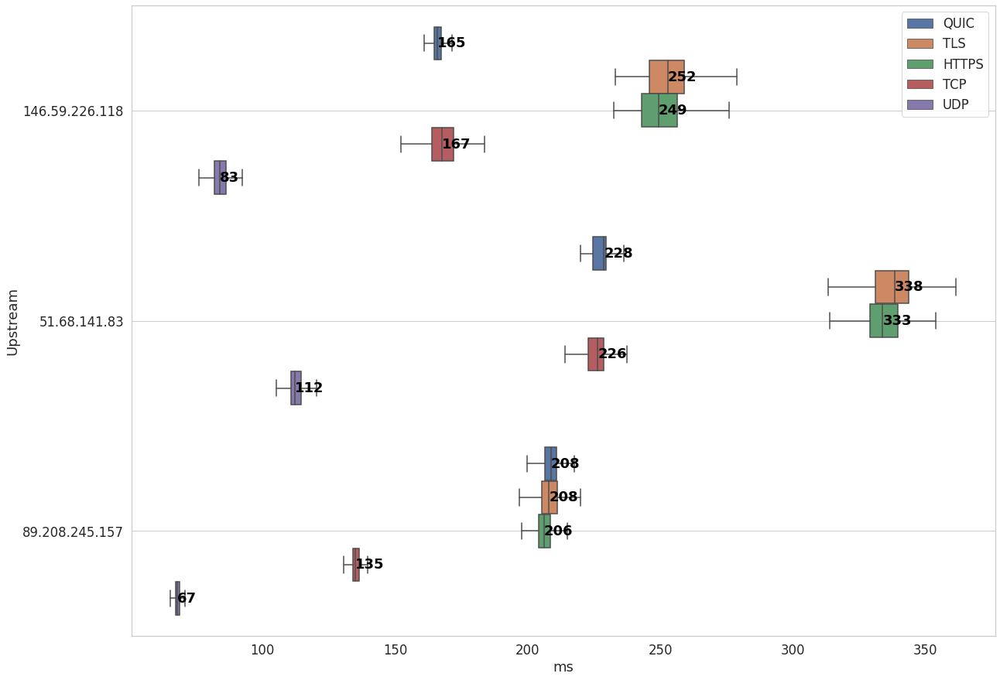

**Asia Pacific Northeast**

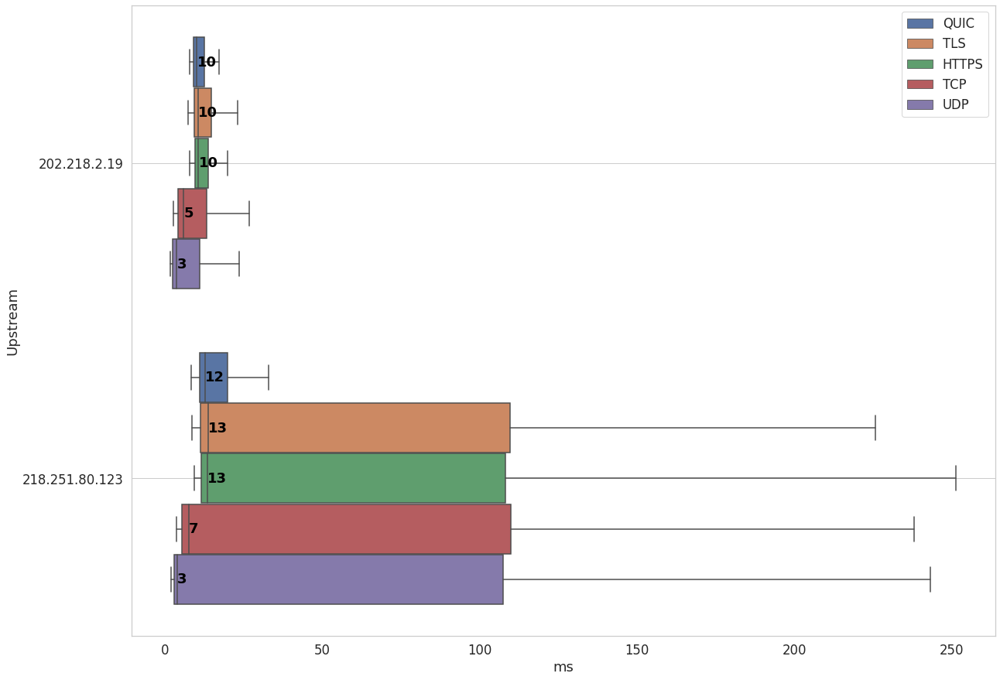

**Asia Pacific Southeast**

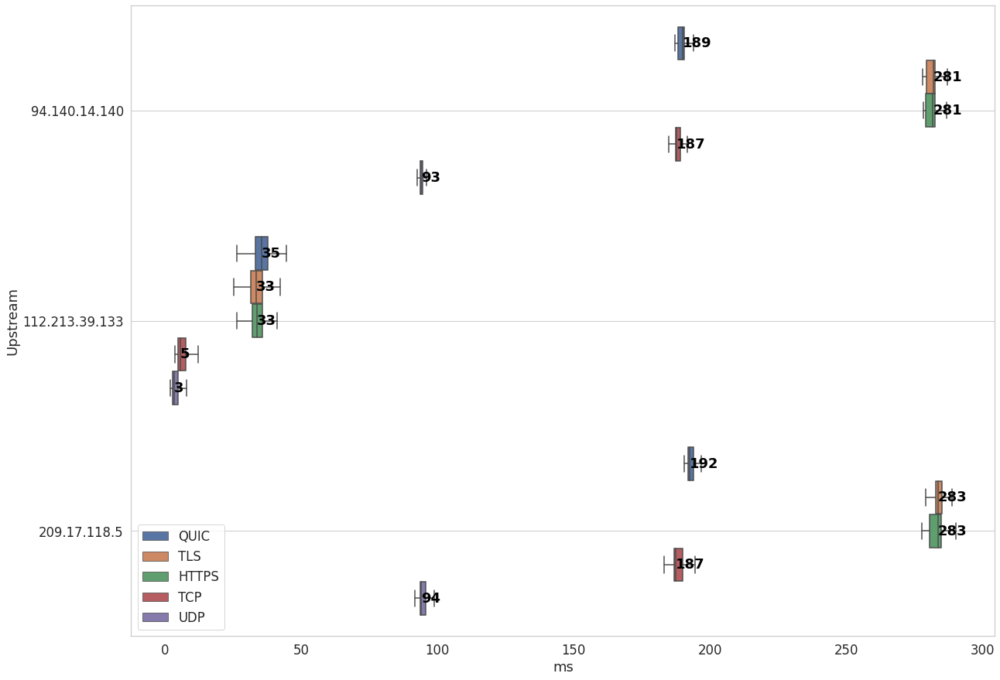

**South America East**

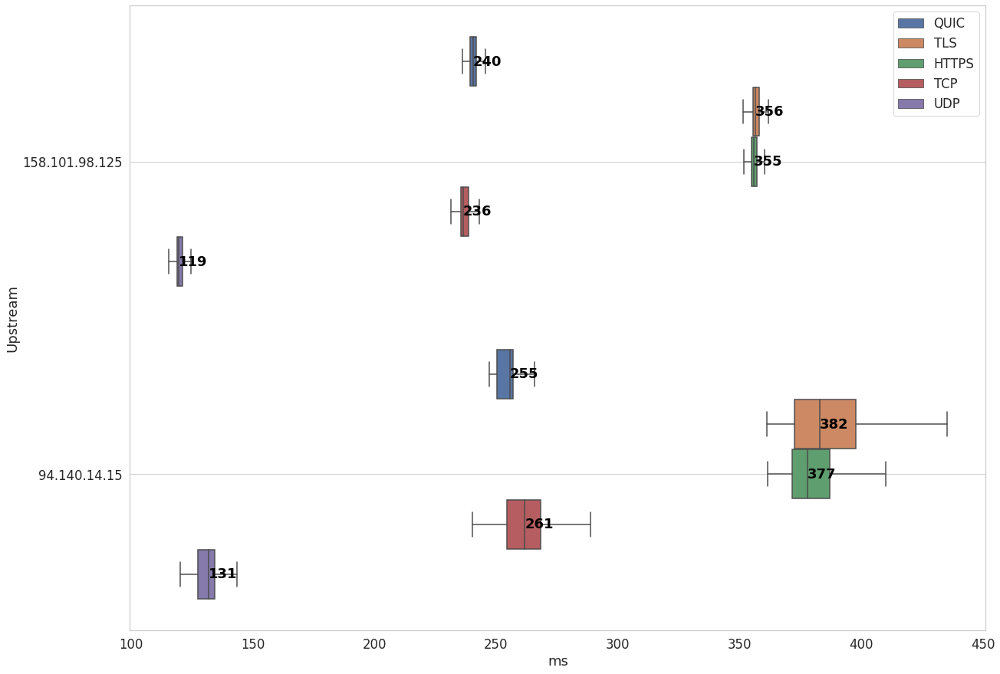

**Africa South**

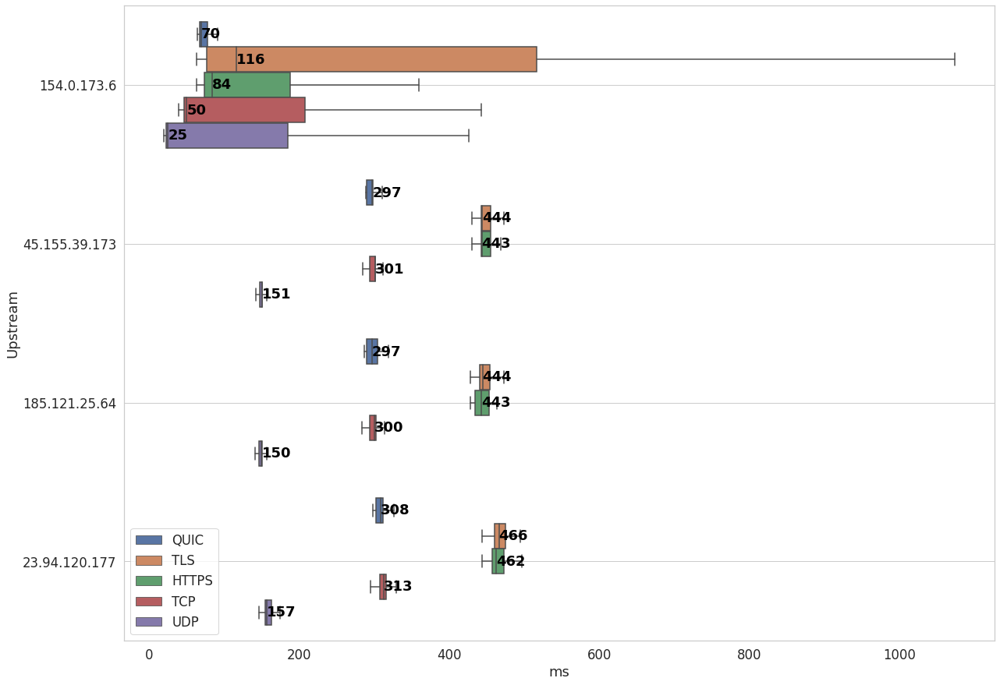

**All**

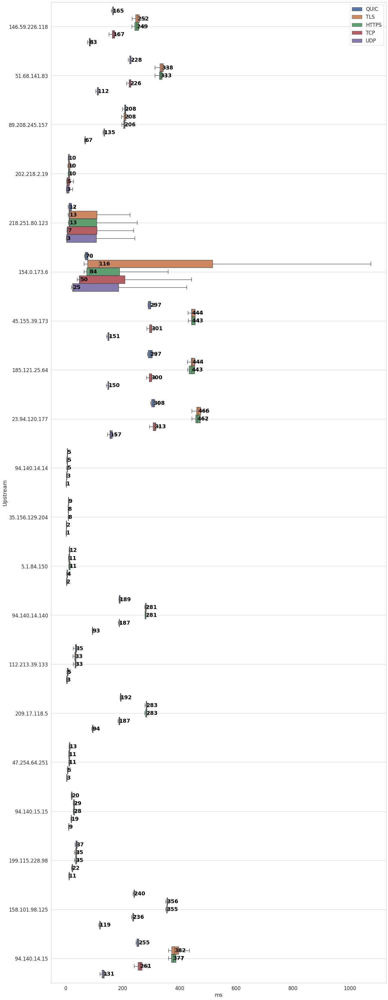

In [26]:
printmd(f"***Server Comparison (Lookup End)***")

plt.rcParams["figure.figsize"] = (20,15)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'server', ['max_lookup_end'], ylabel='Upstream')
plt.rcParams["figure.figsize"] = (20,60)
multiCompare('vantagePoint', 'All', 'server', ['max_lookup_end'], ylabel='Upstream')

***Server Comparison (RTs)***

**Europe Central**

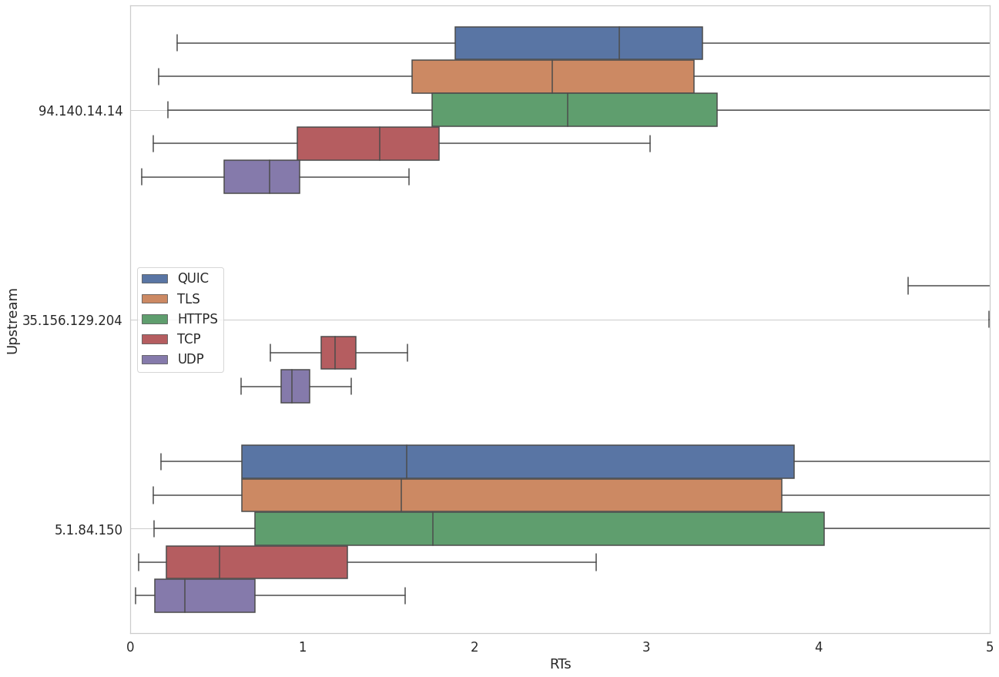

**US West**

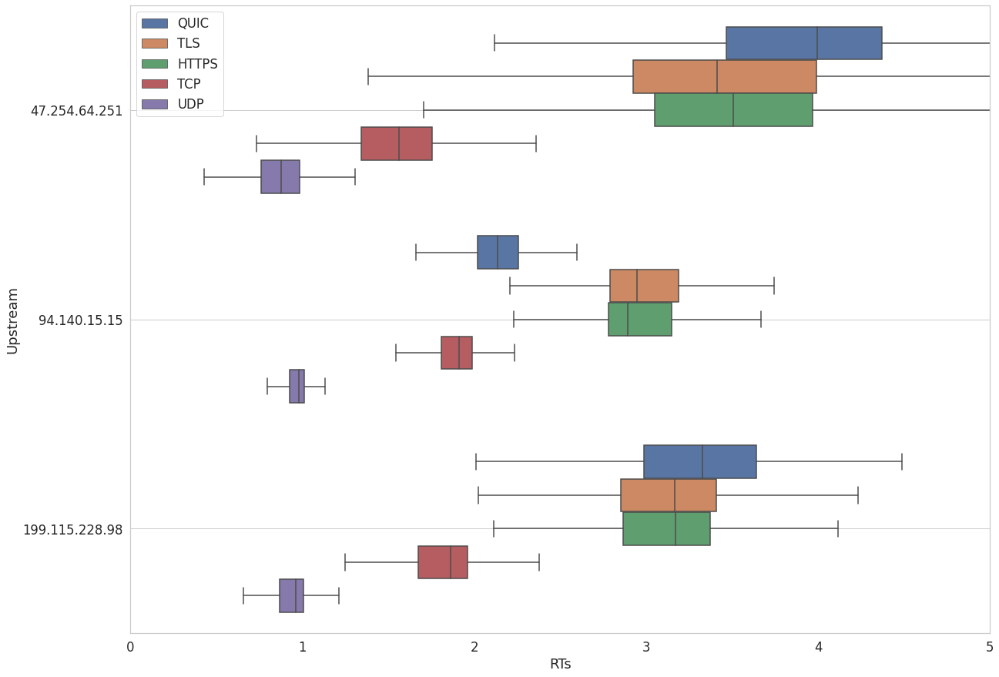

**US East**

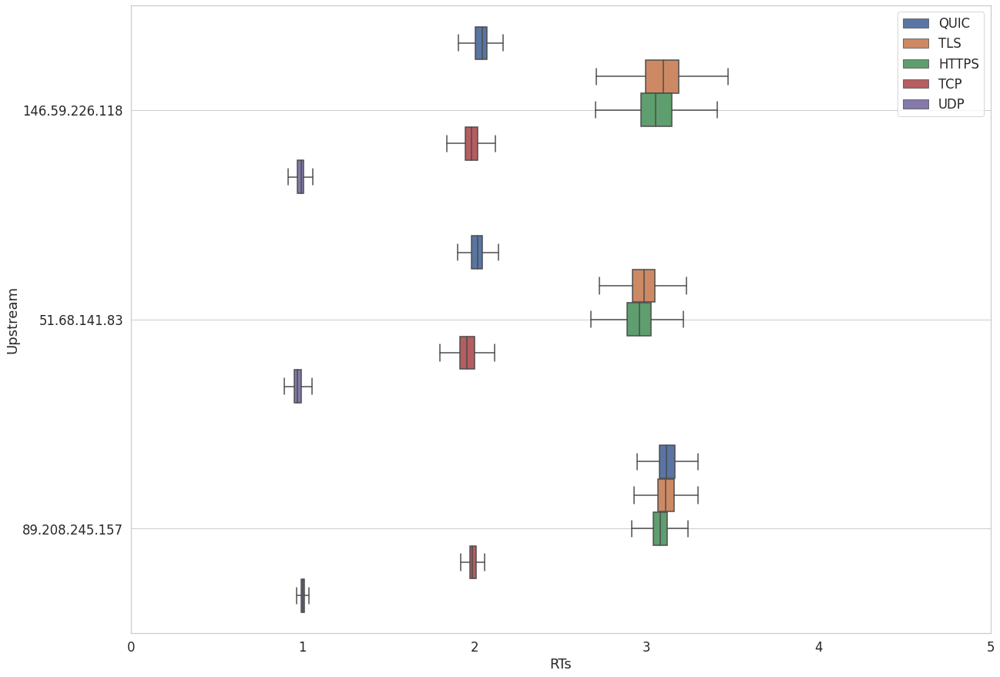

**Asia Pacific Northeast**

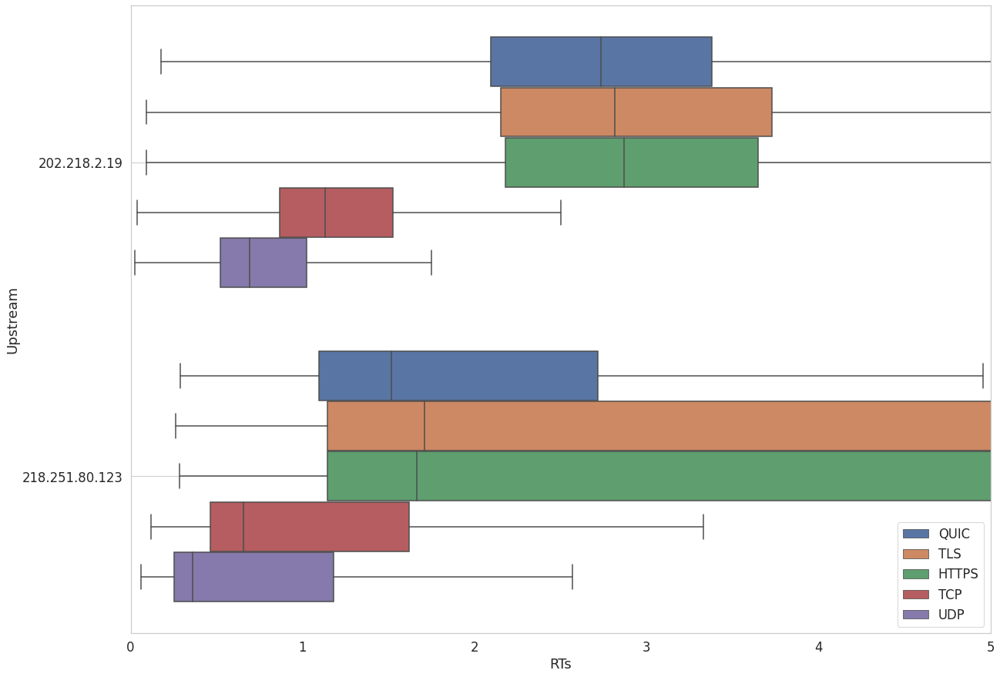

**Asia Pacific Southeast**

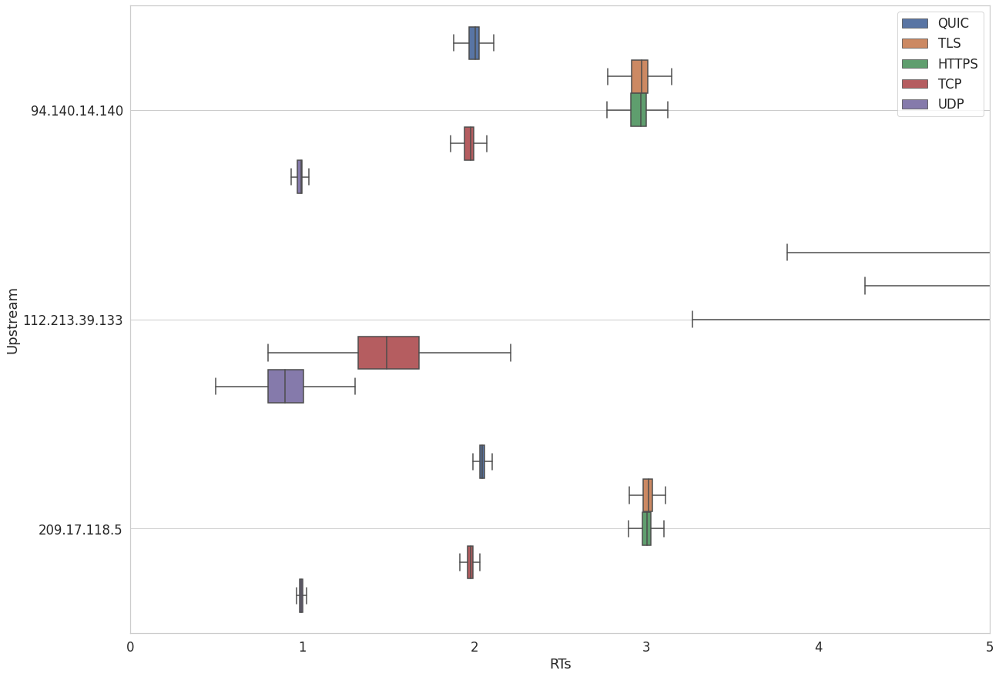

**South America East**

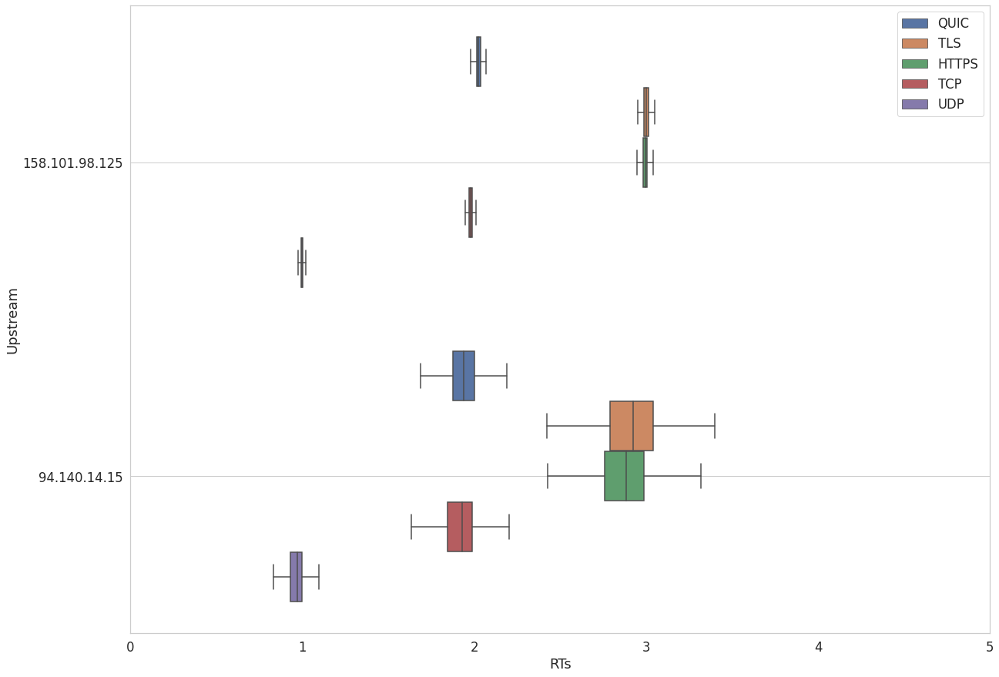

**Africa South**

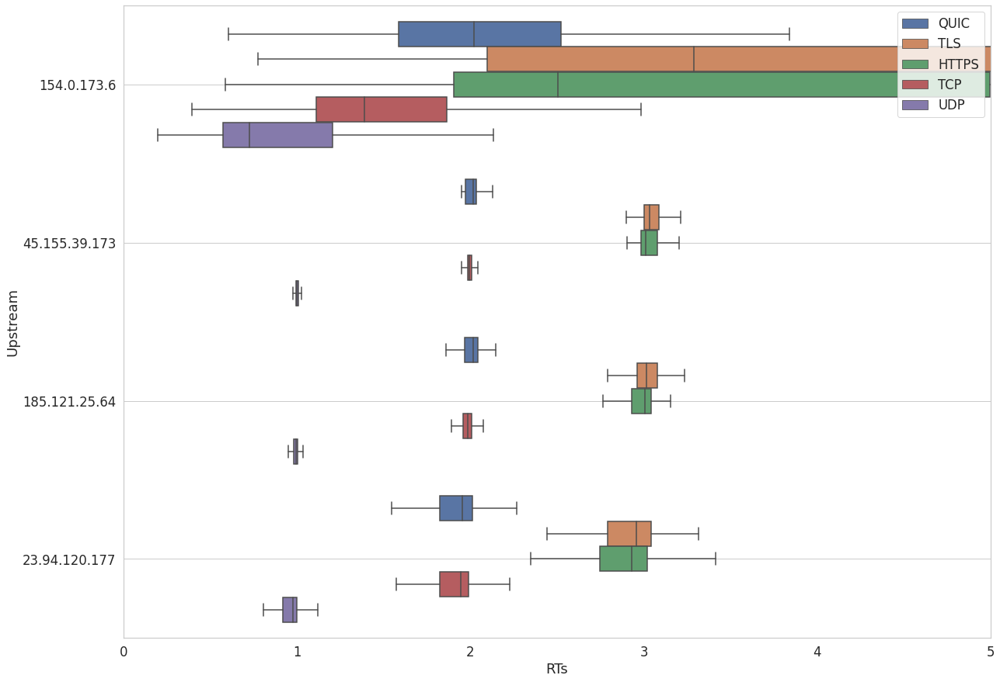

**All**

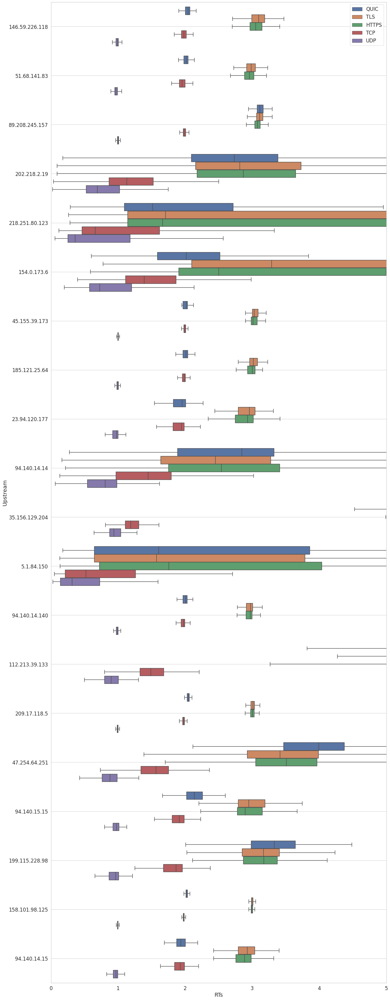

In [27]:
printmd(f"***Server Comparison (RTs)***")

plt.rcParams["figure.figsize"] = (20,15)
for vantagePoint in vp_order:
    multiCompare('vantagePoint', vantagePoint, 'server', ['rts'], ylabel='Upstream', medians=False, xlabel='RTs', xlim=(0, 5))
plt.rcParams["figure.figsize"] = (20,60)
multiCompare('vantagePoint', 'All', 'server', ['rts'], ylabel='Upstream', medians=False, xlabel='RTs', xlim=(0, 5))

## Compare Vantage Points

**www.netflix.com**

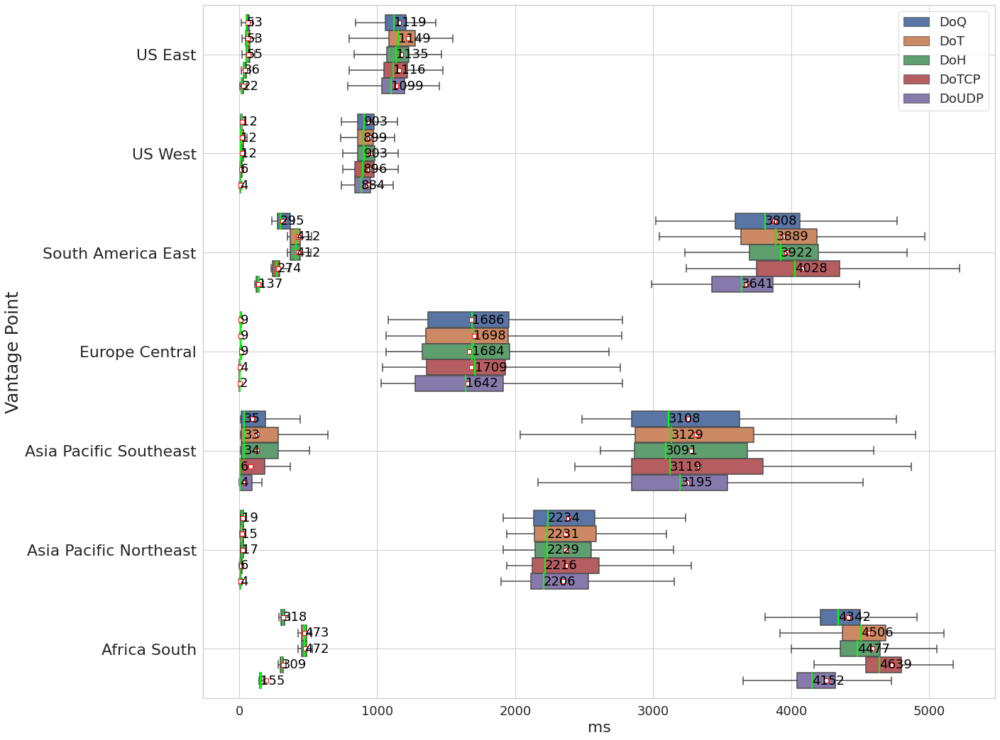

In [539]:
plt.rcParams["figure.figsize"] = (20,18)
multiCompare('domain', 'www.netflix.com', 'vantagePoint', ['elapsed', 'loadEventStart'], ylabel='Vantage Point')

***Vantage Point Comparison (Load Event Start)***

**www.wikipedia.org**

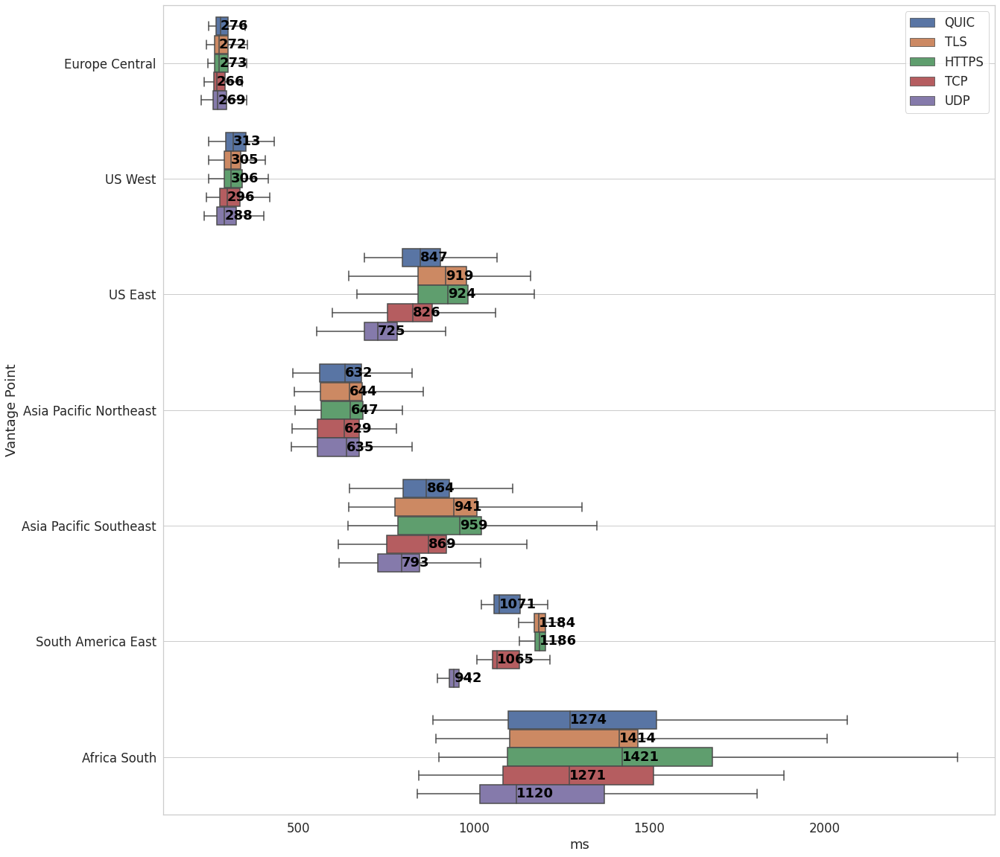

**www.instagram.com**

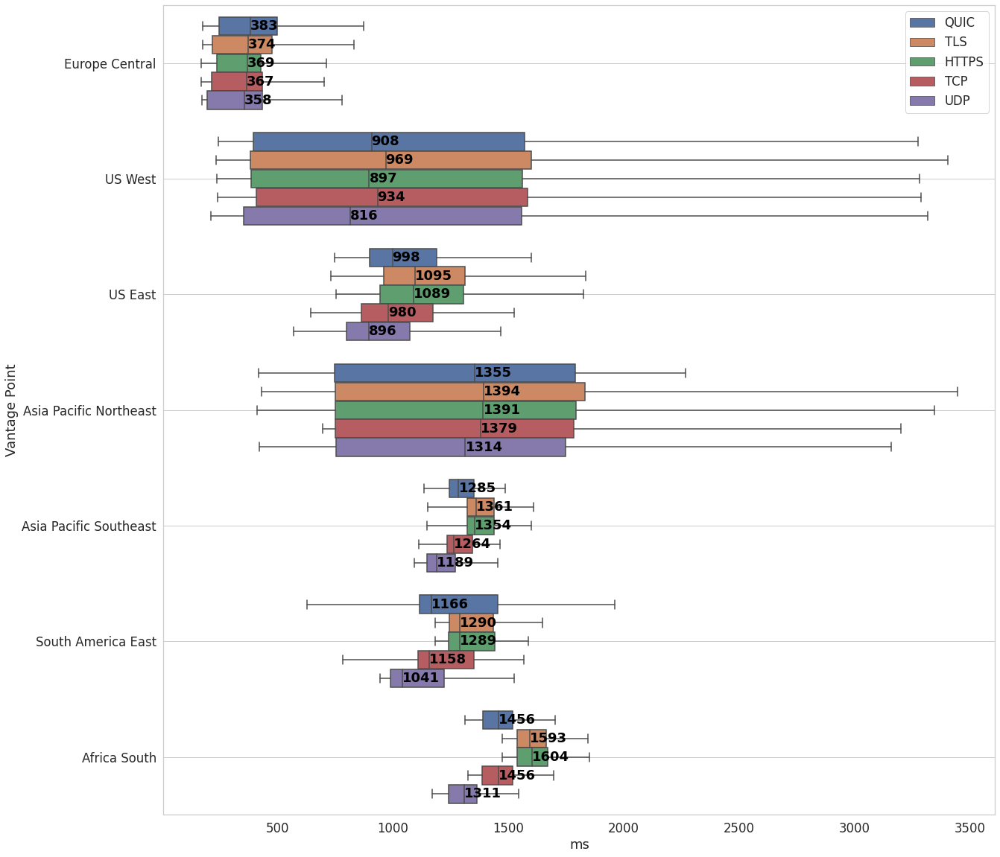

**www.facebook.com**

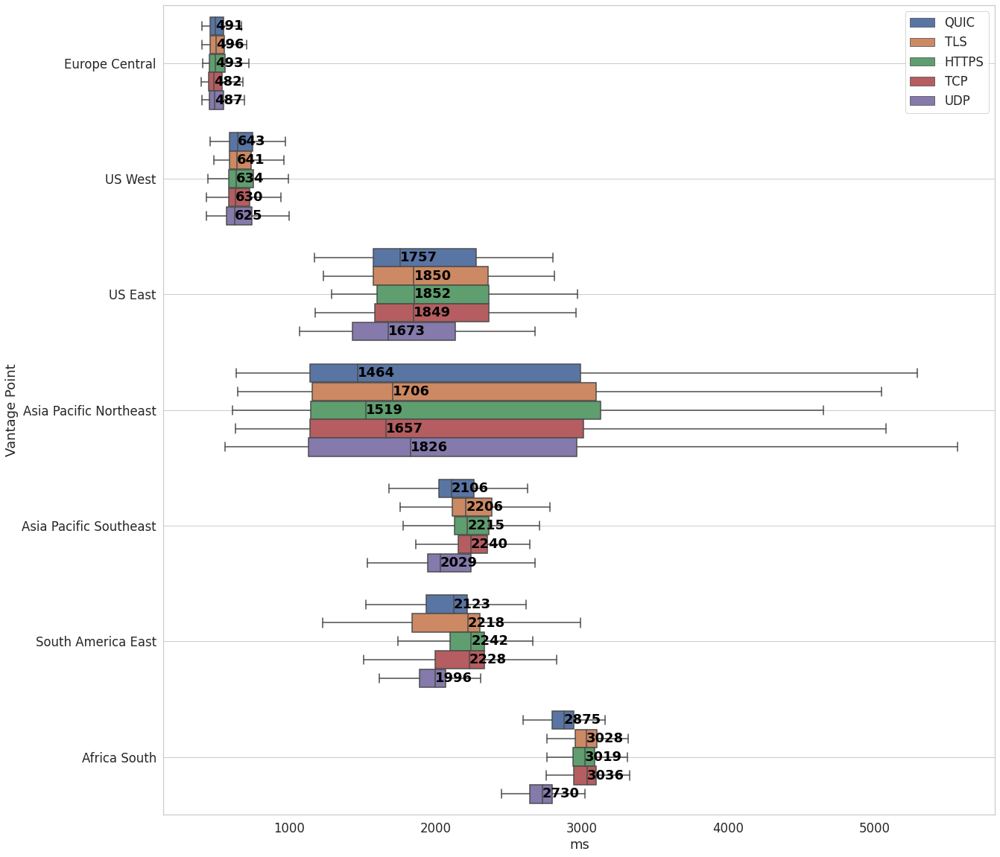

**www.apple.com**

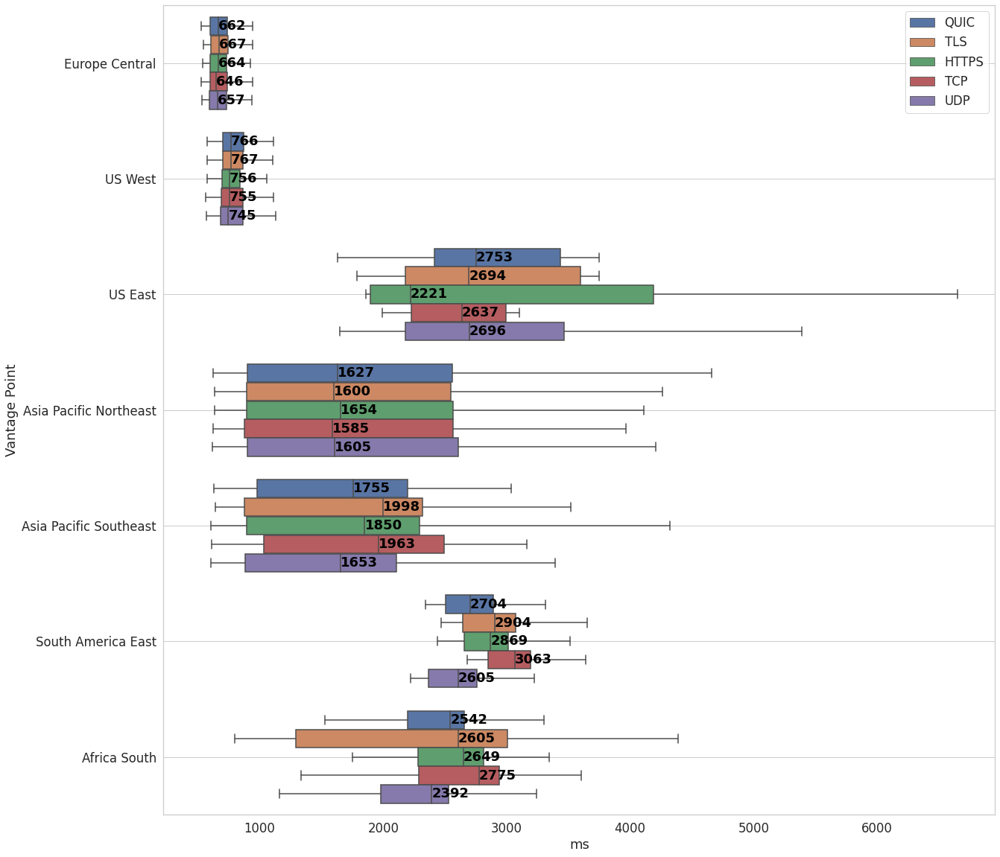

**www.linkedin.com**

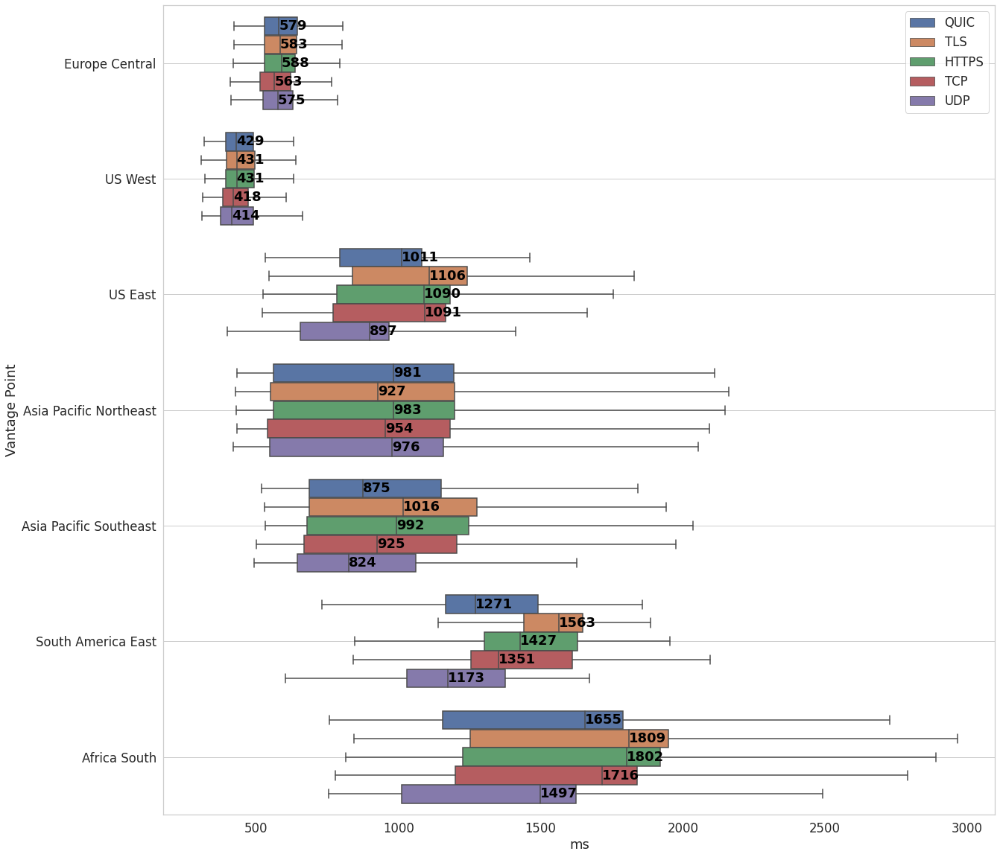

**twitter.com**

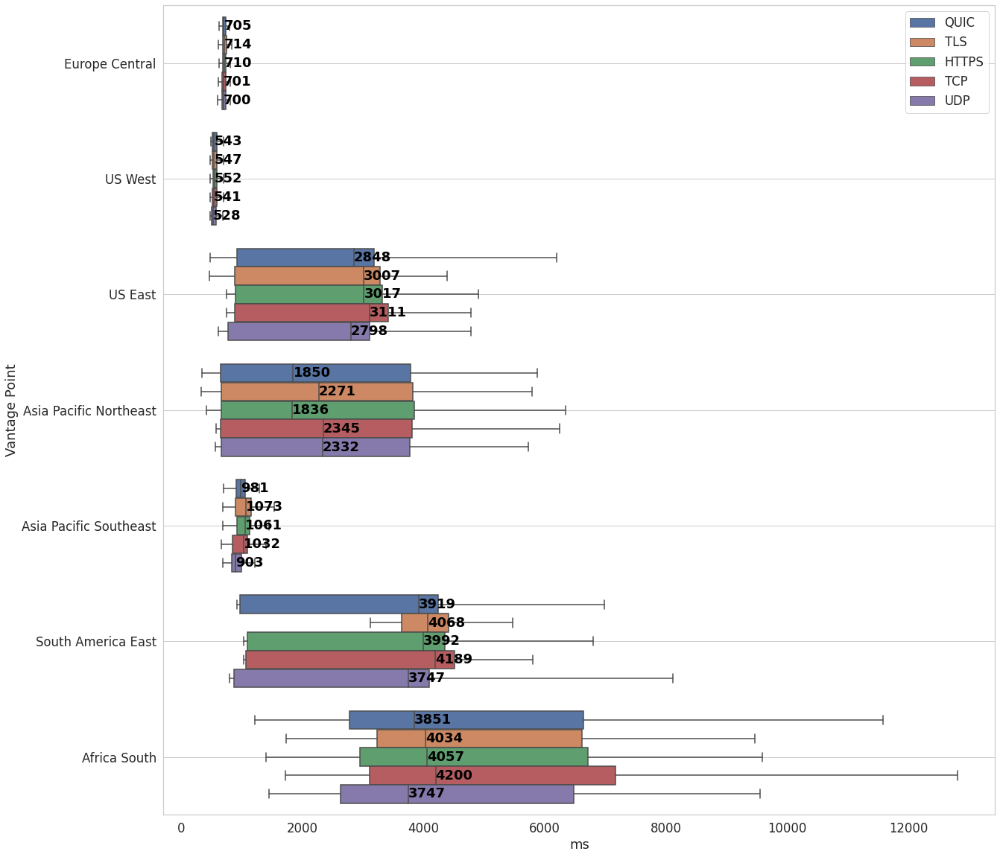

**www.google.com**

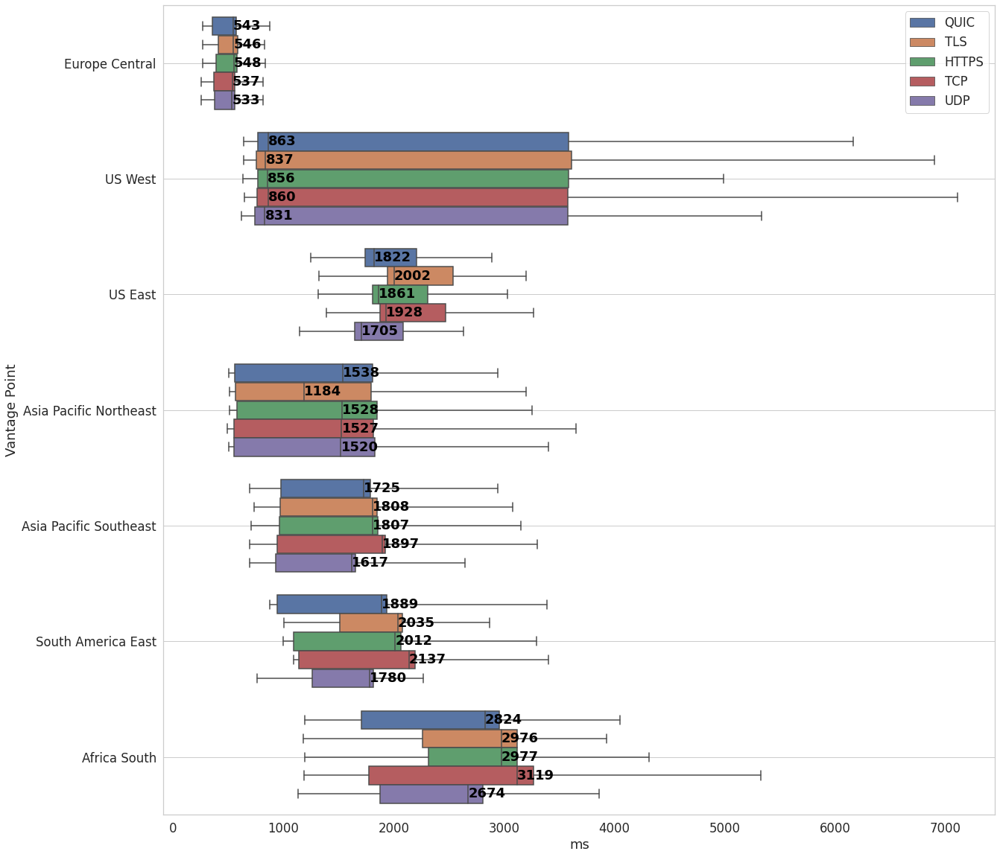

**www.baidu.com**

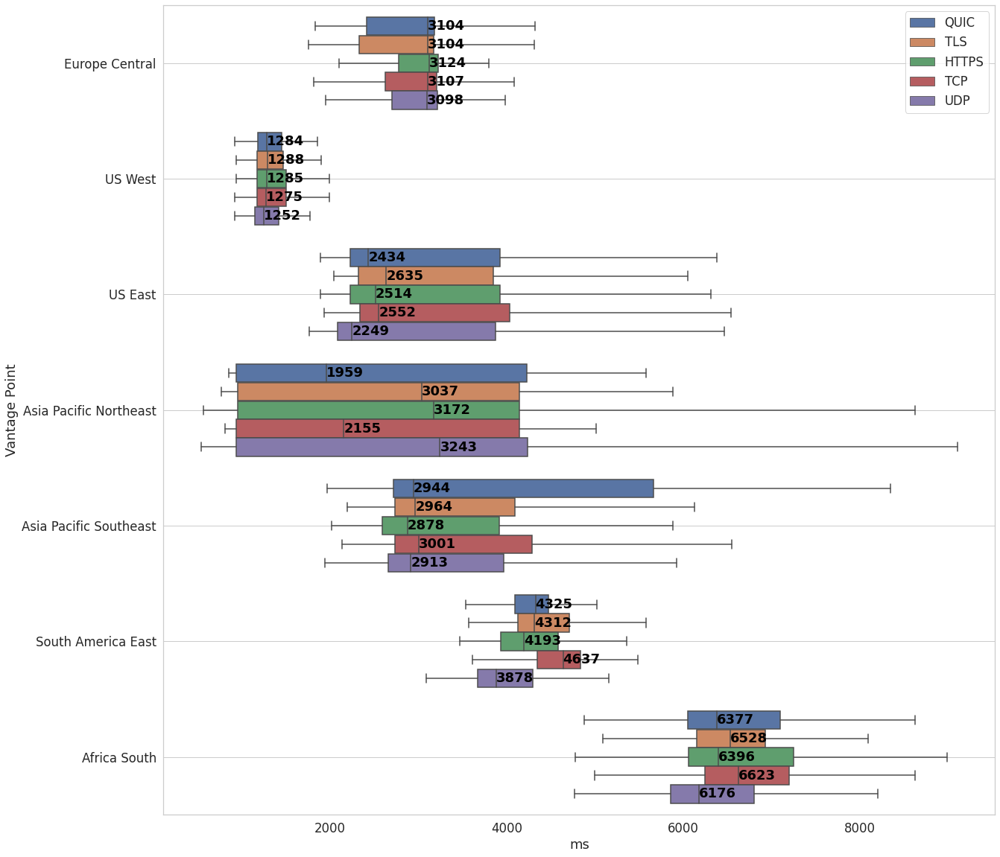

**www.netflix.com**

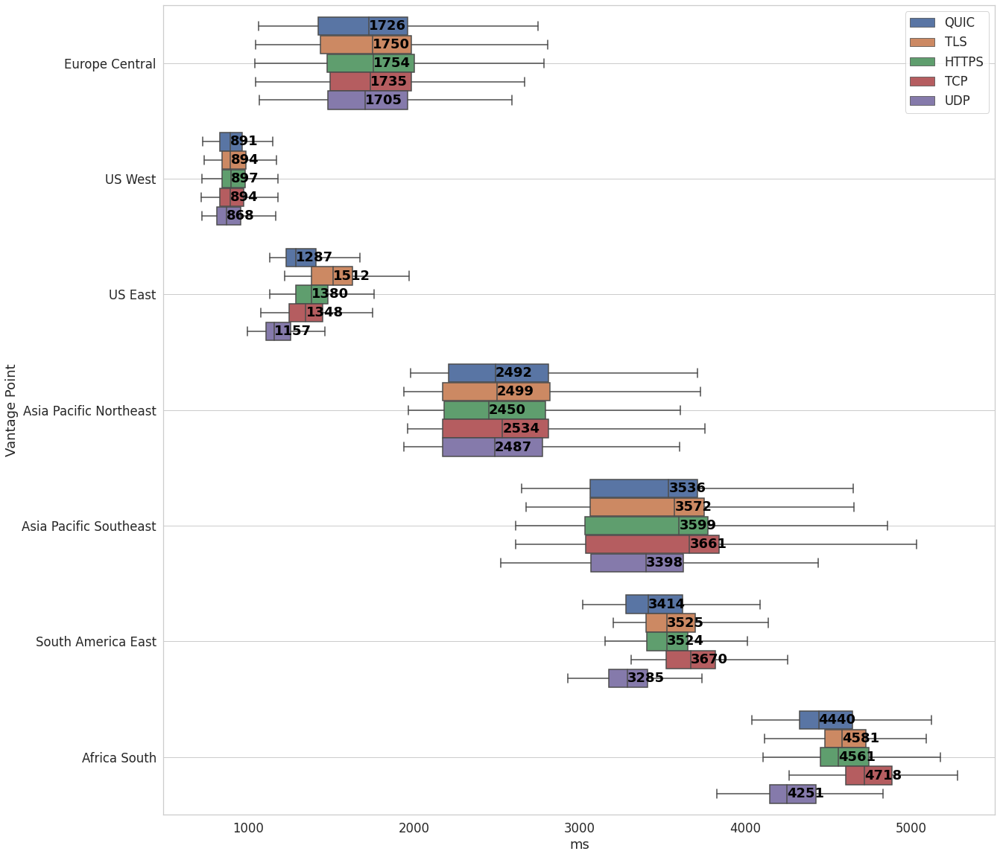

**www.youtube.com**

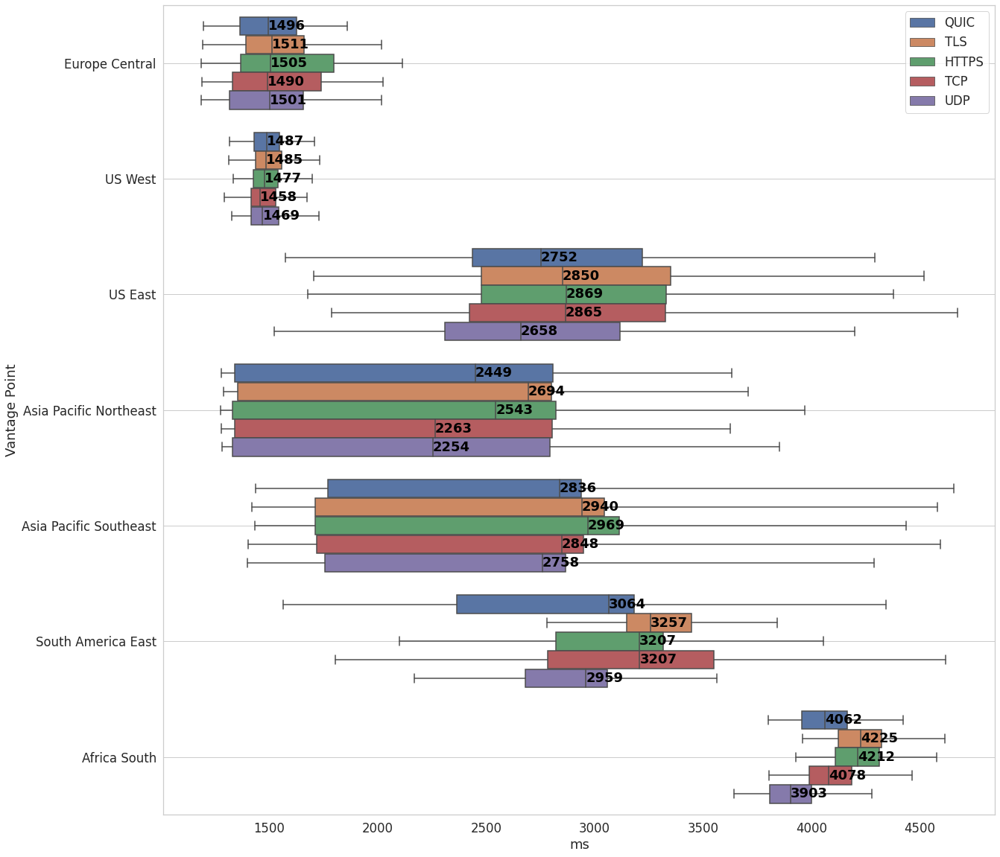

**www.microsoft.com**

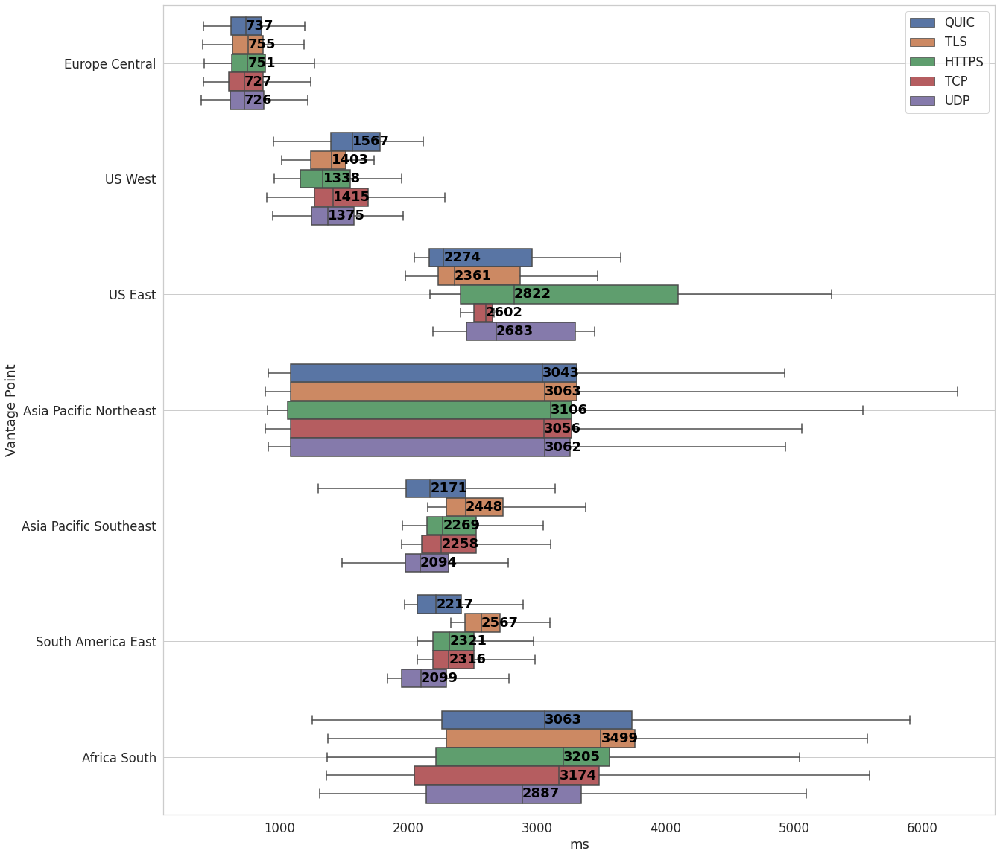

**All**

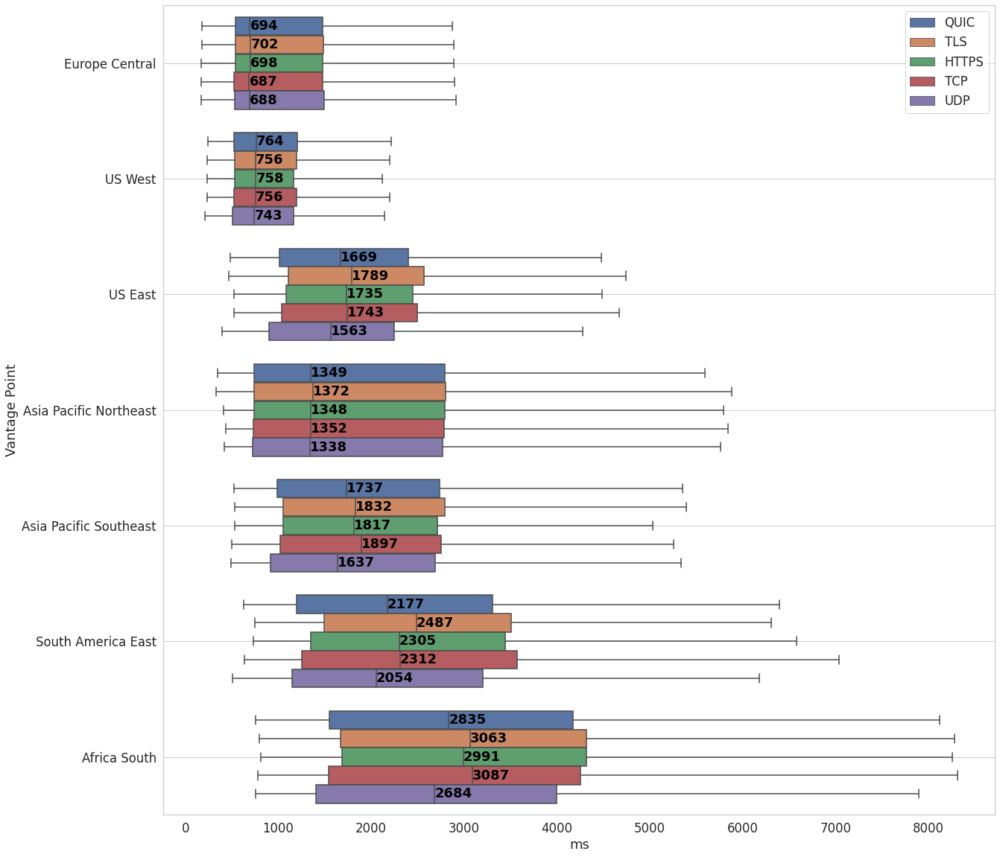

In [61]:
printmd(f"***Vantage Point Comparison (Load Event Start)***")

plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['loadEventStart'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['loadEventStart'], ylabel='Vantage Point')

***Vantage Point Comparison (First Contentful Paint)***

**www.wikipedia.org**

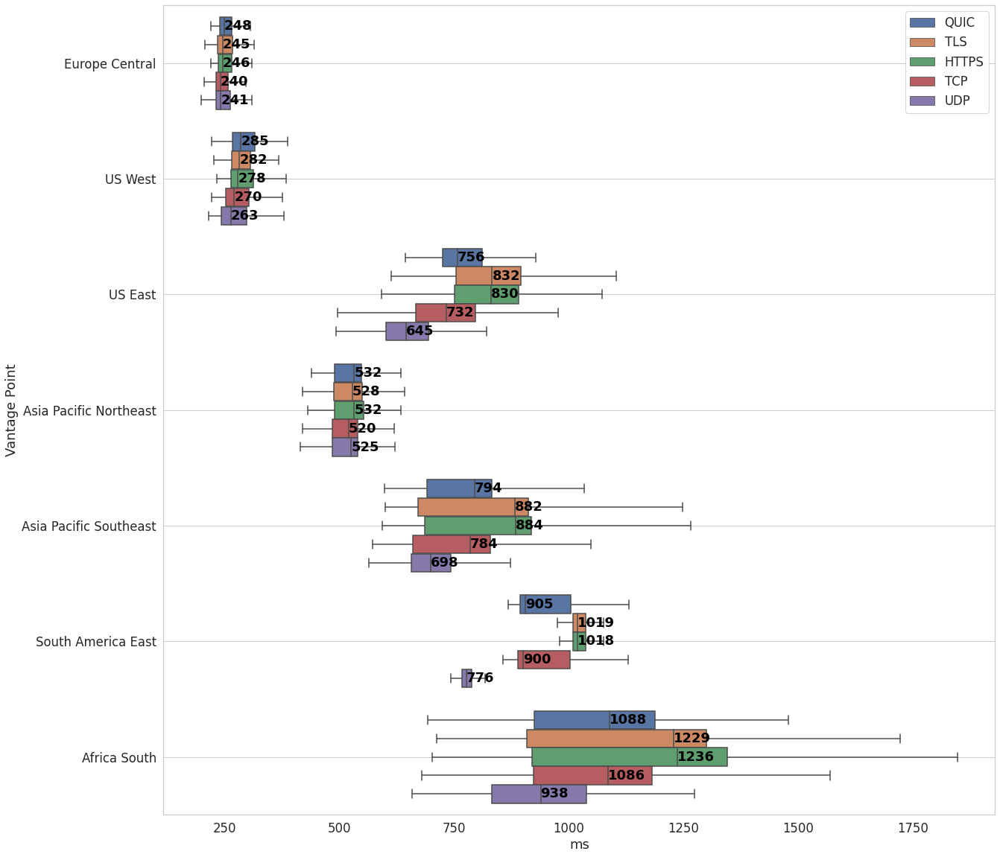

**www.instagram.com**

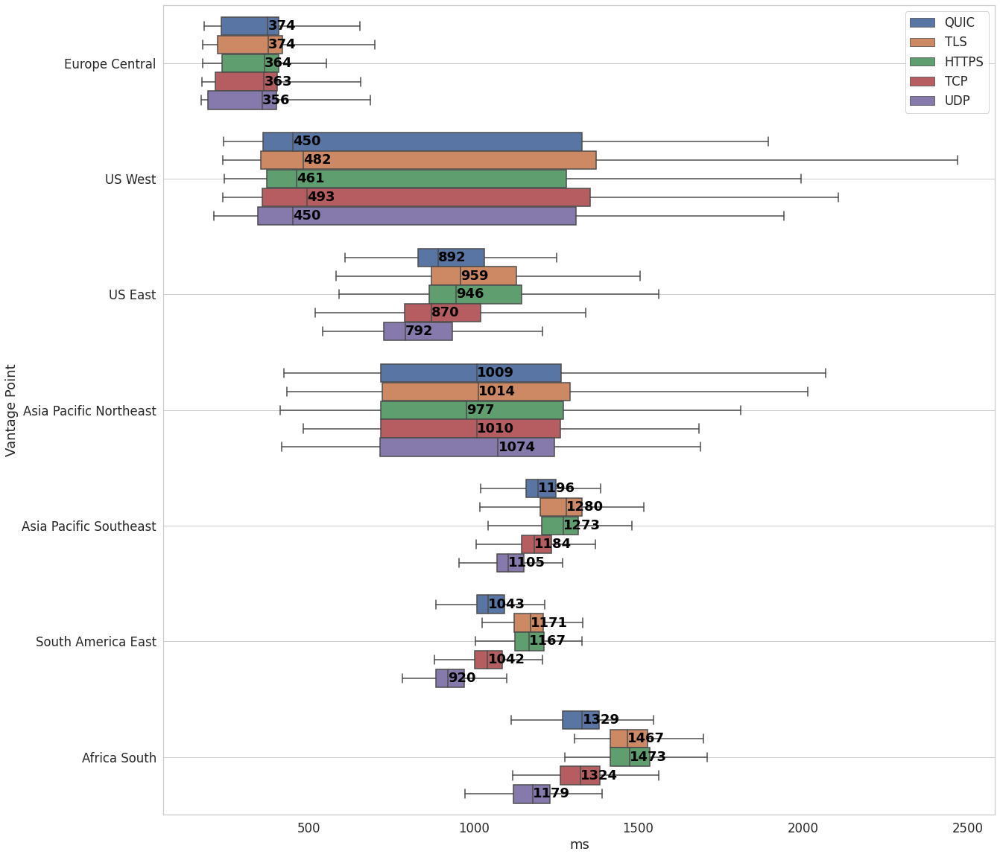

**www.facebook.com**

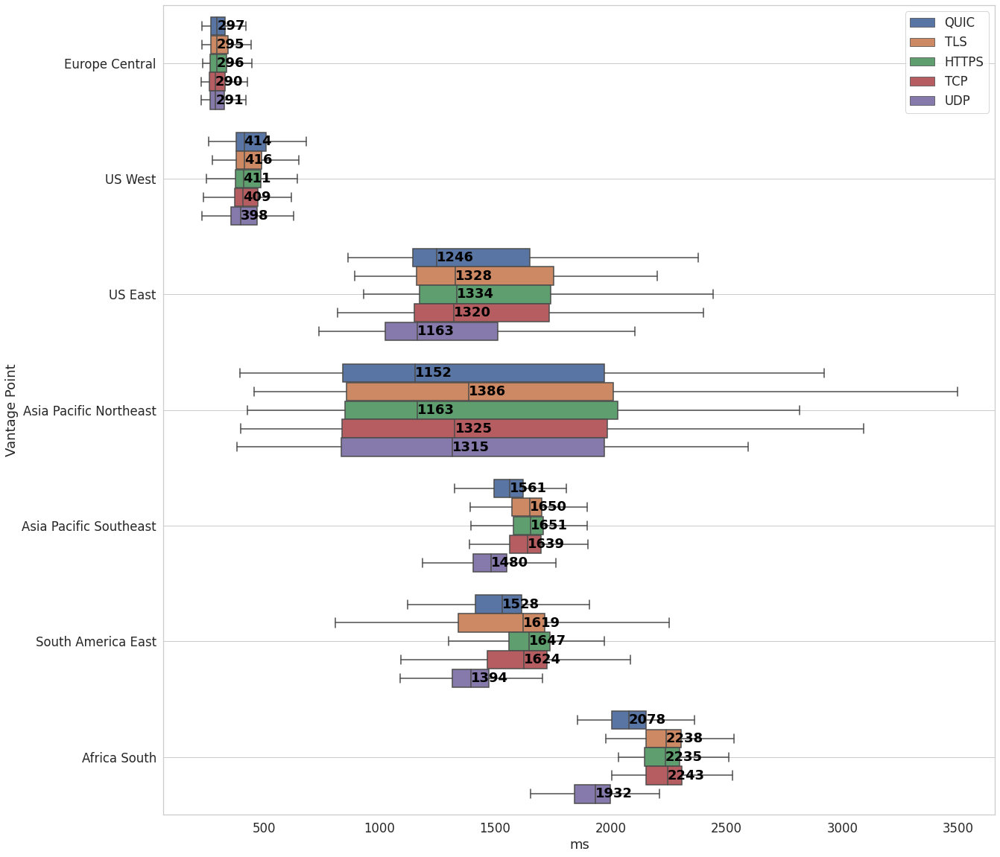

**www.apple.com**

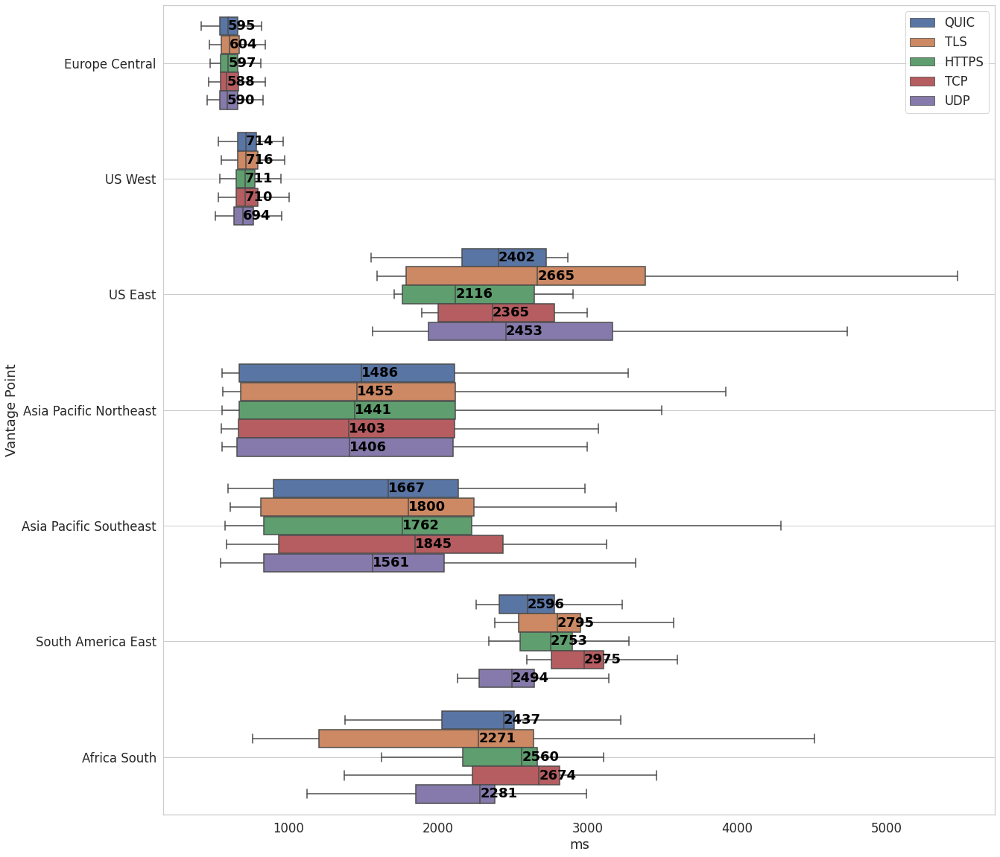

**www.linkedin.com**

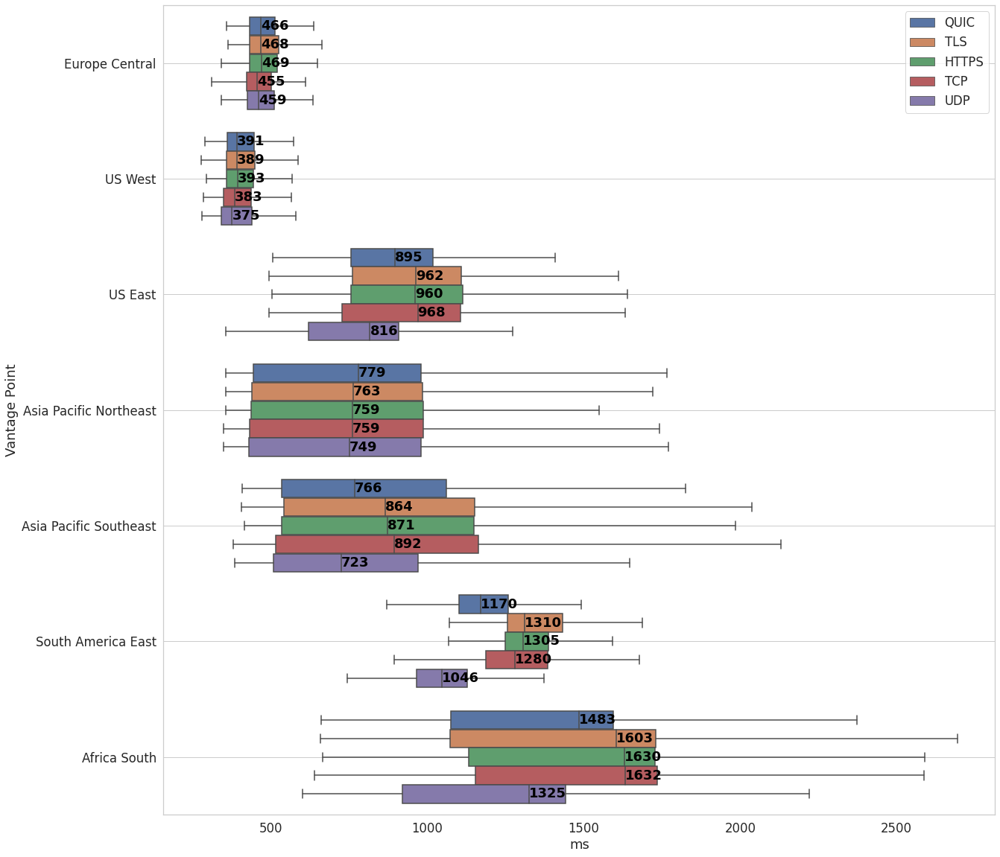

**twitter.com**

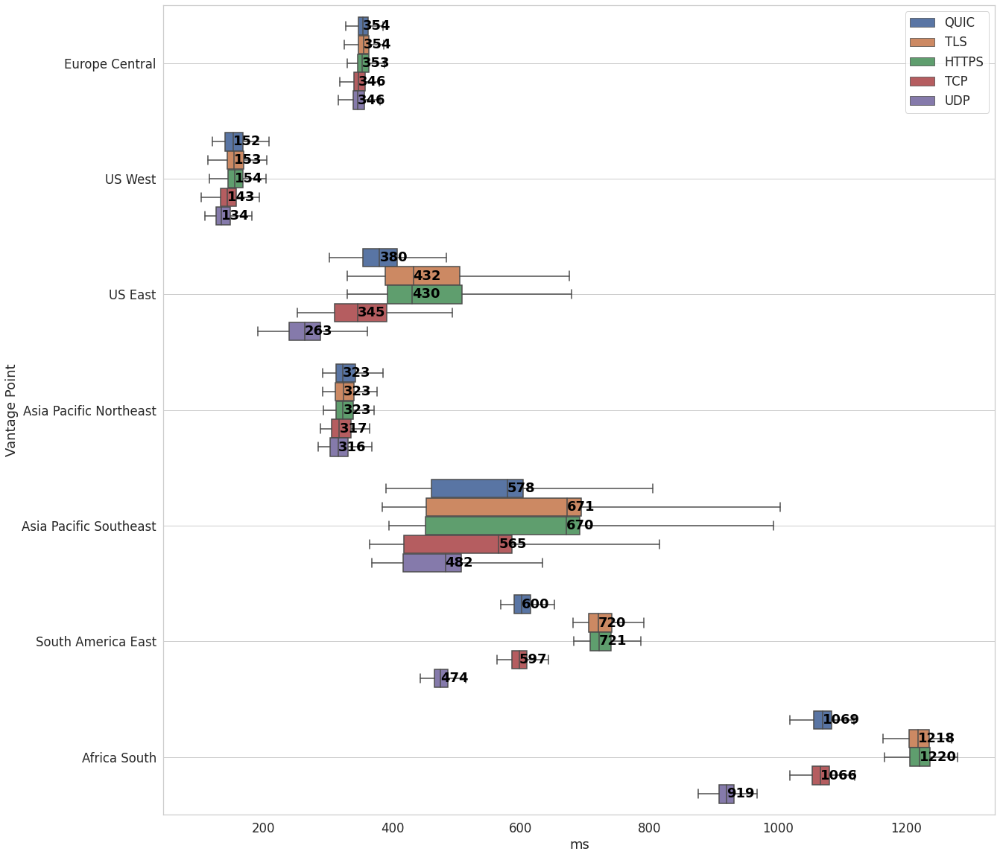

**www.google.com**

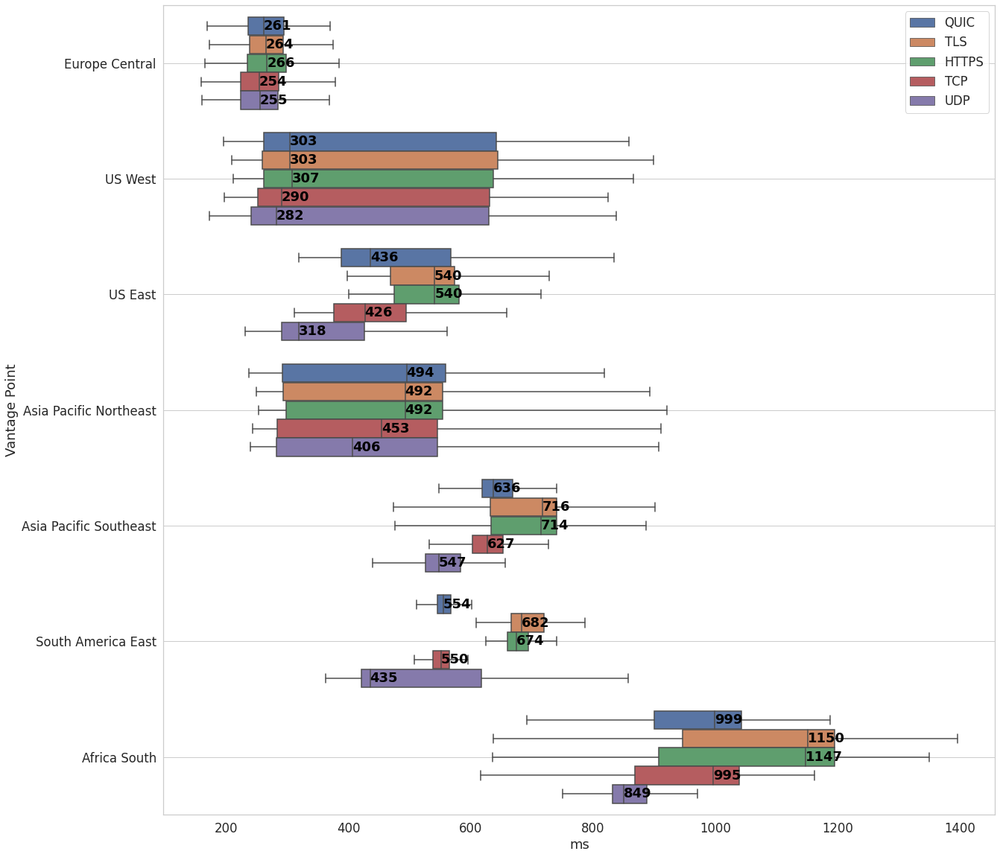

**www.baidu.com**

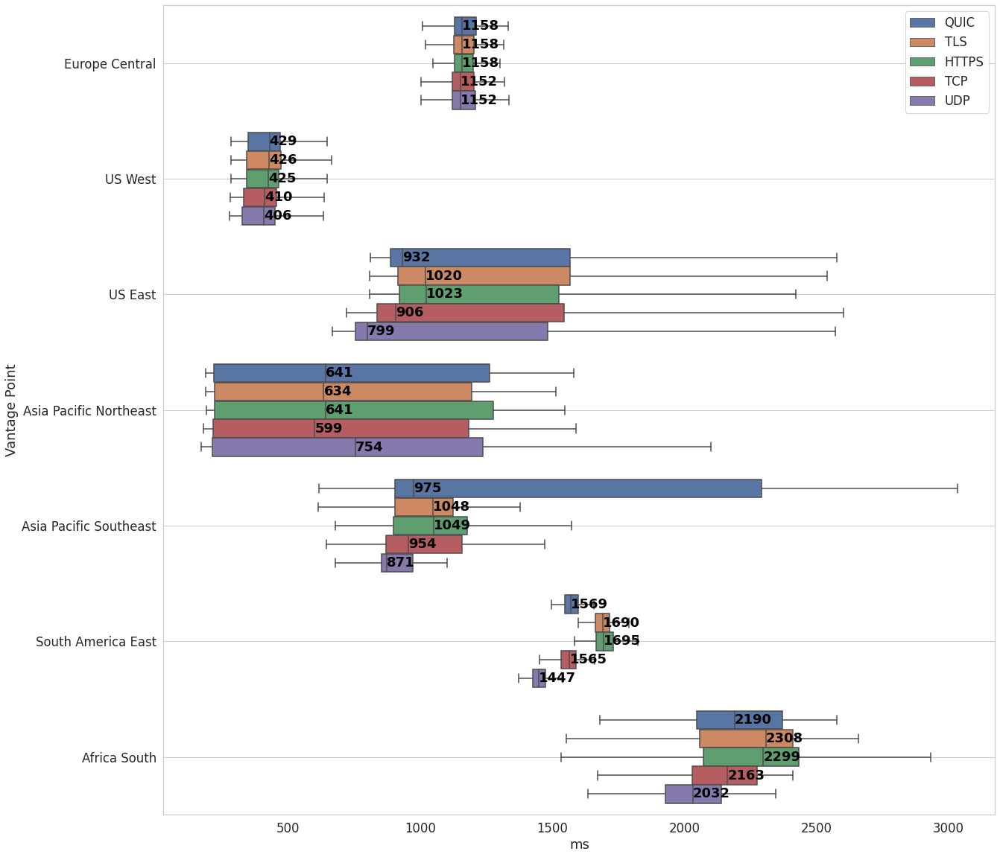

**www.netflix.com**

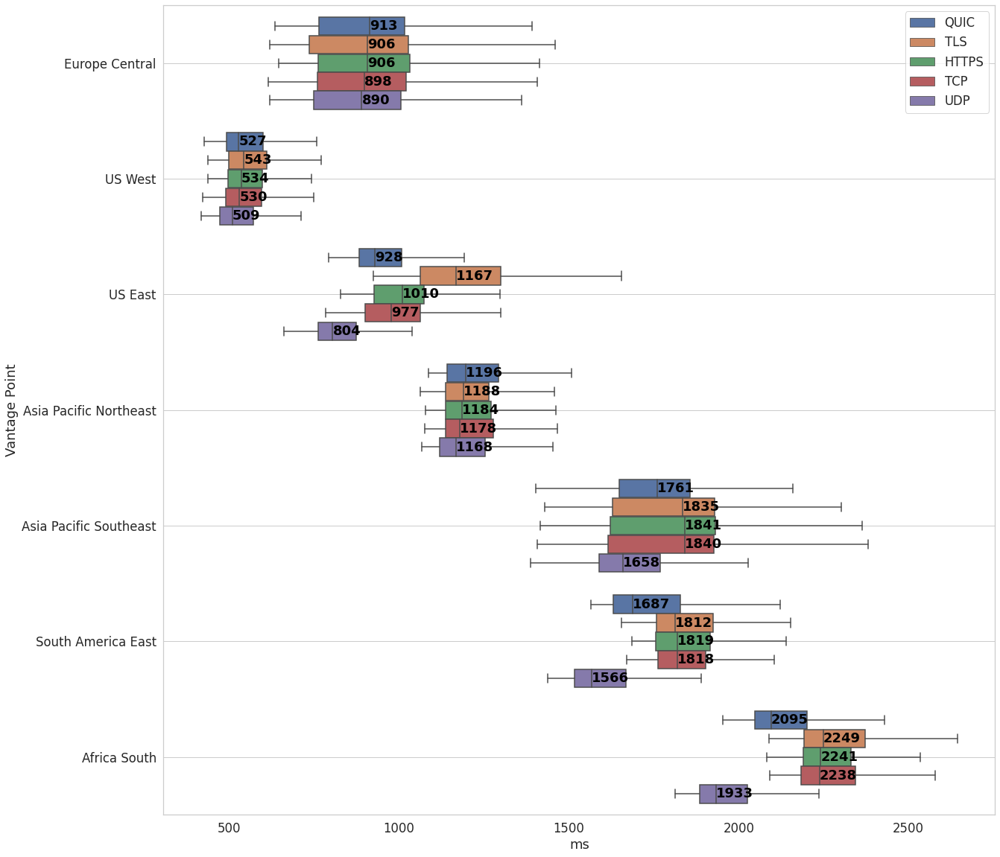

**www.youtube.com**

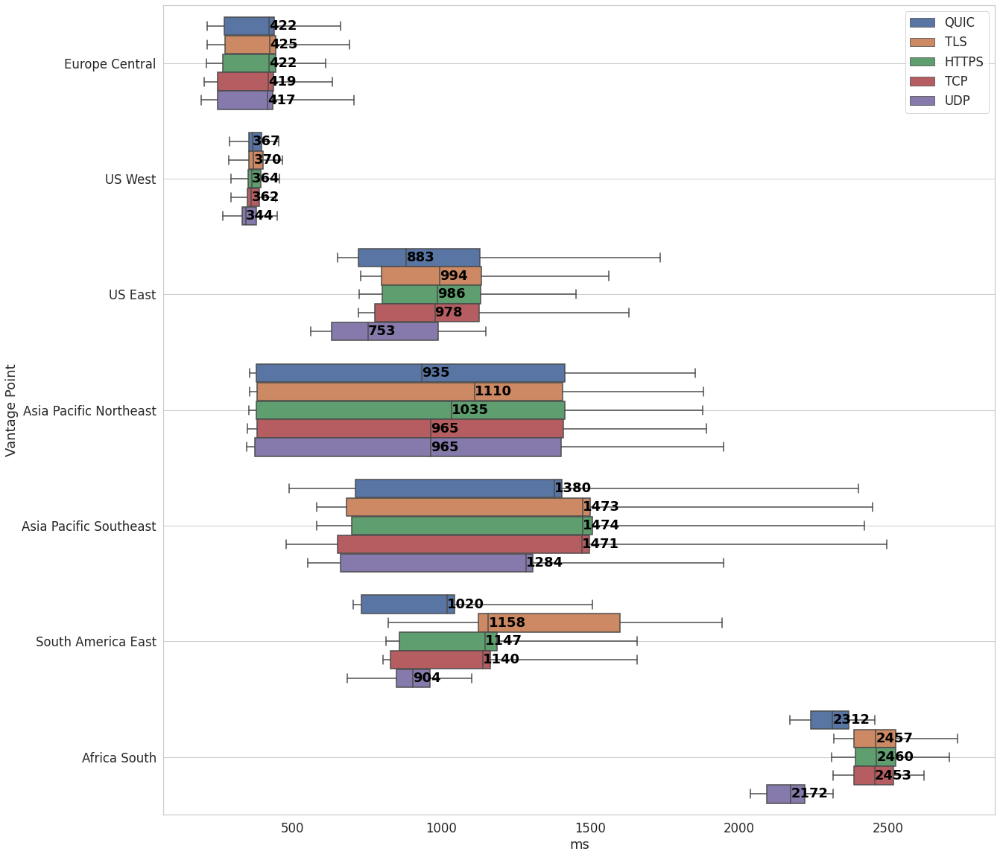

**www.microsoft.com**

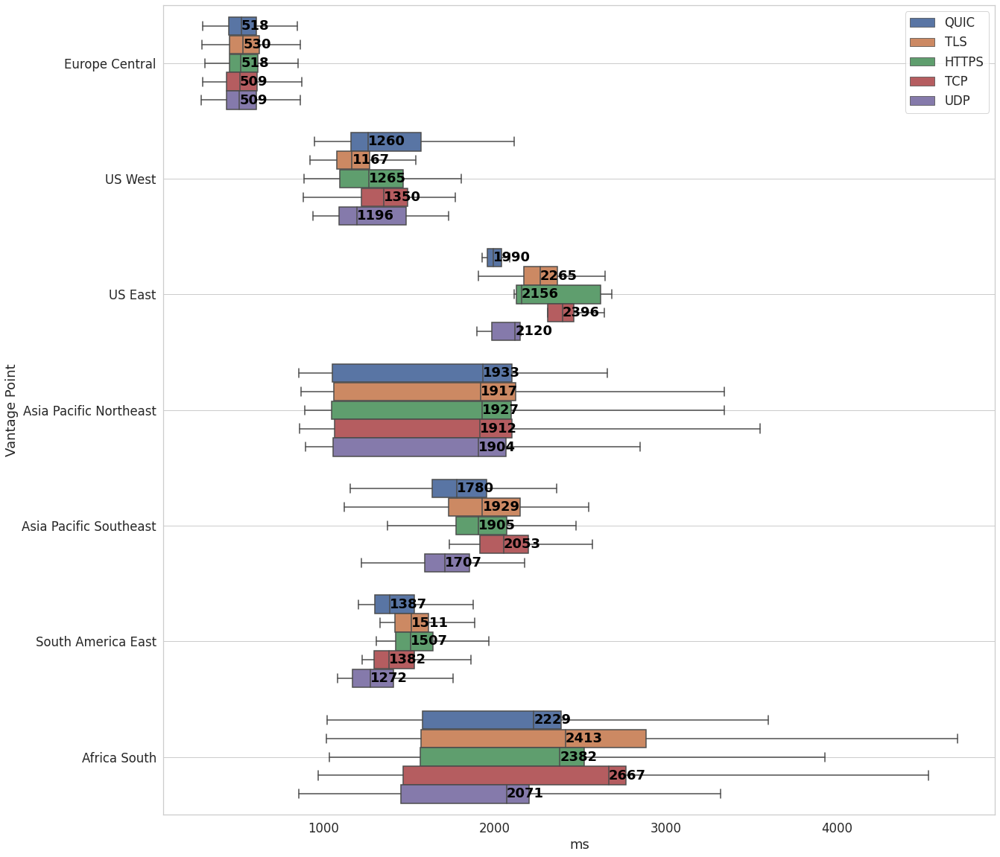

**All**

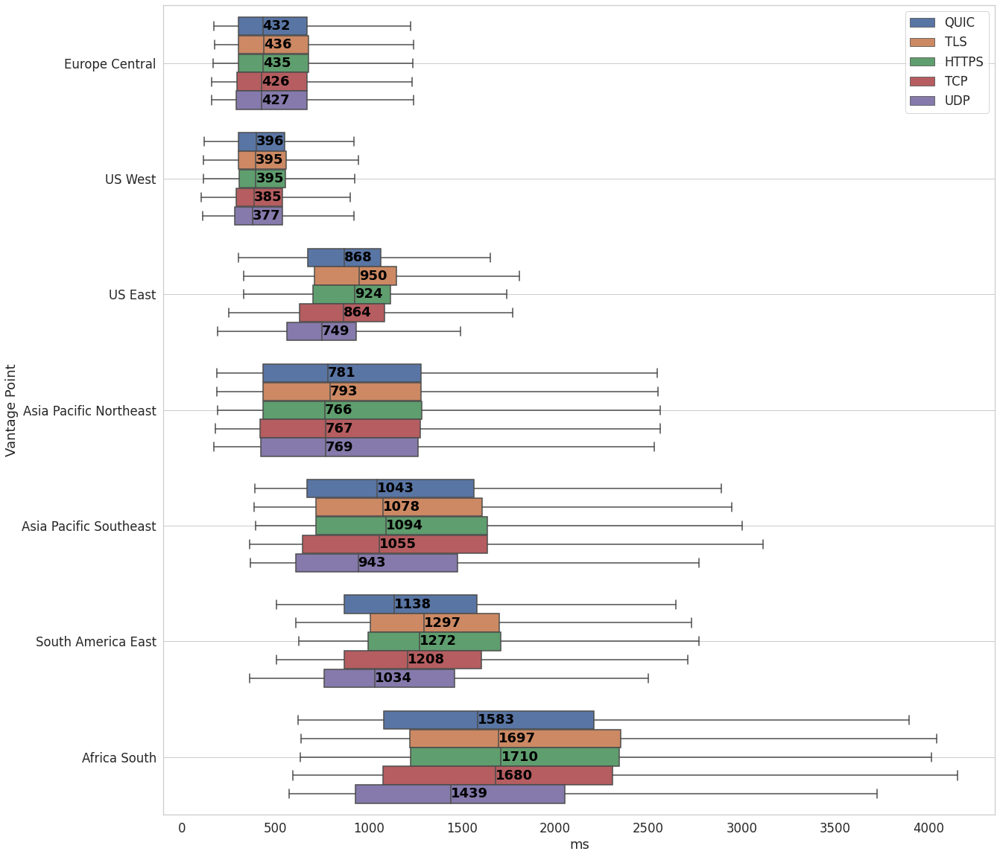

In [62]:
printmd(f"***Vantage Point Comparison (First Contentful Paint)***")

plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['firstContentfulPaint'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['firstContentfulPaint'], ylabel='Vantage Point')

***Vantage Point Comparison (Lookup End - FCP - Load Event Start)***

**www.wikipedia.org**

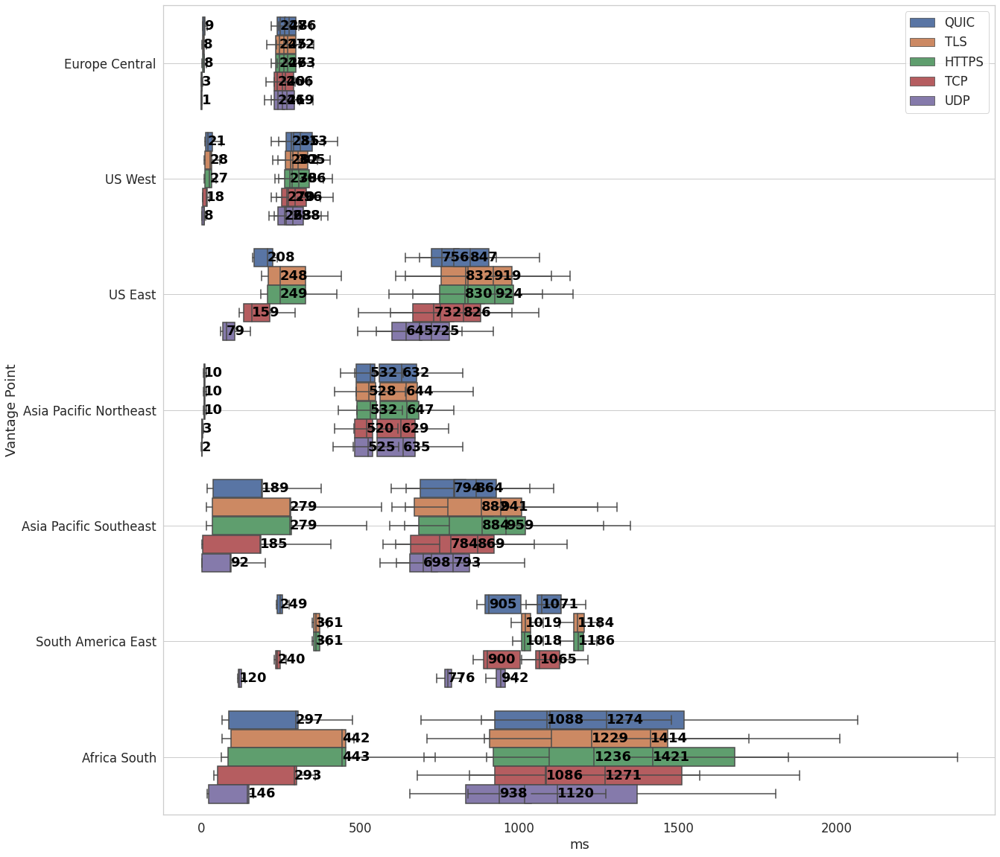

**www.instagram.com**

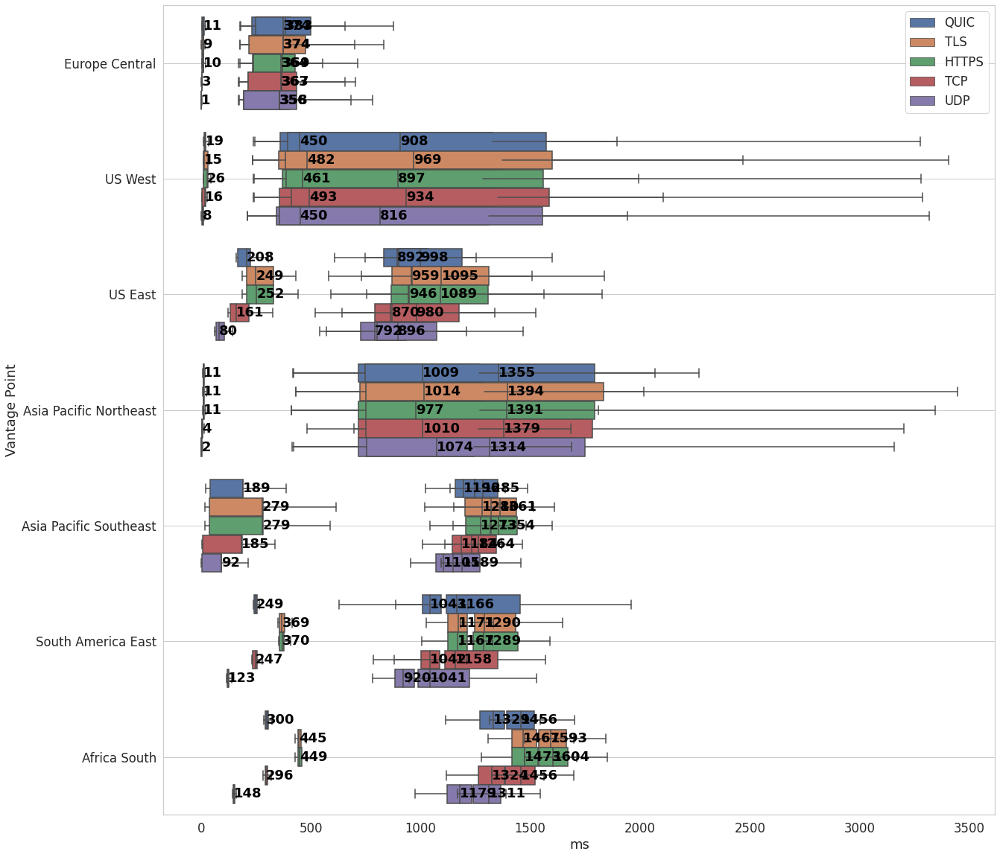

**www.facebook.com**

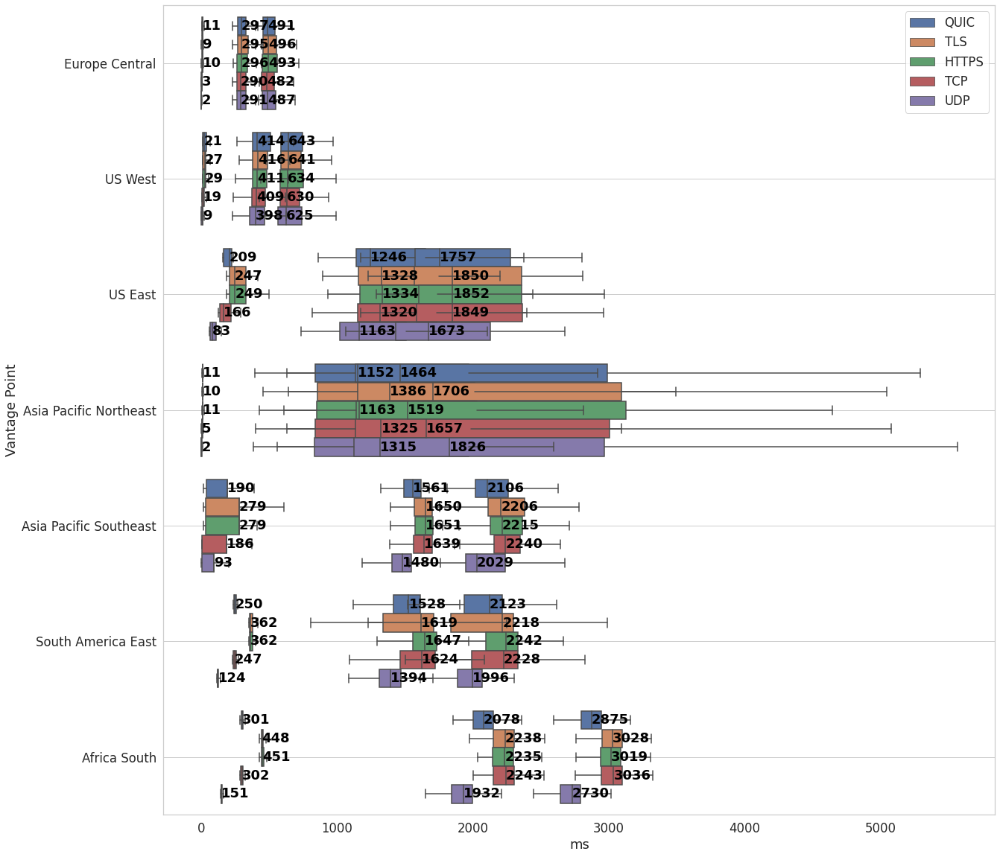

**www.apple.com**

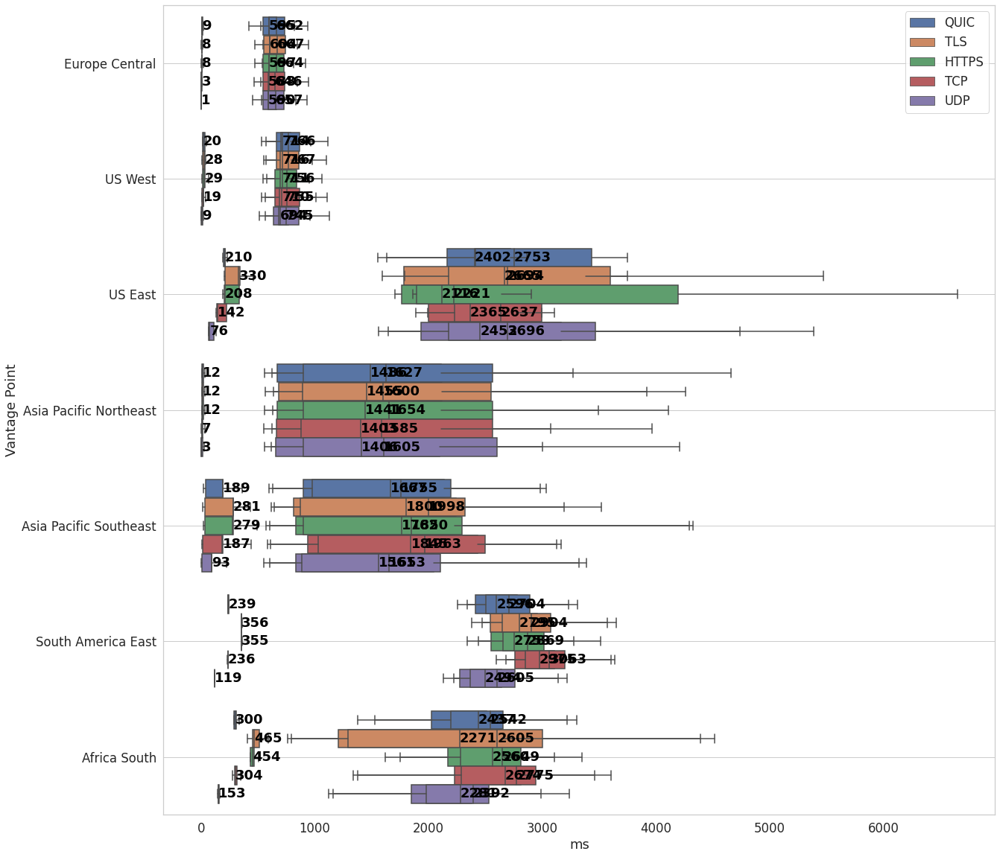

**www.linkedin.com**

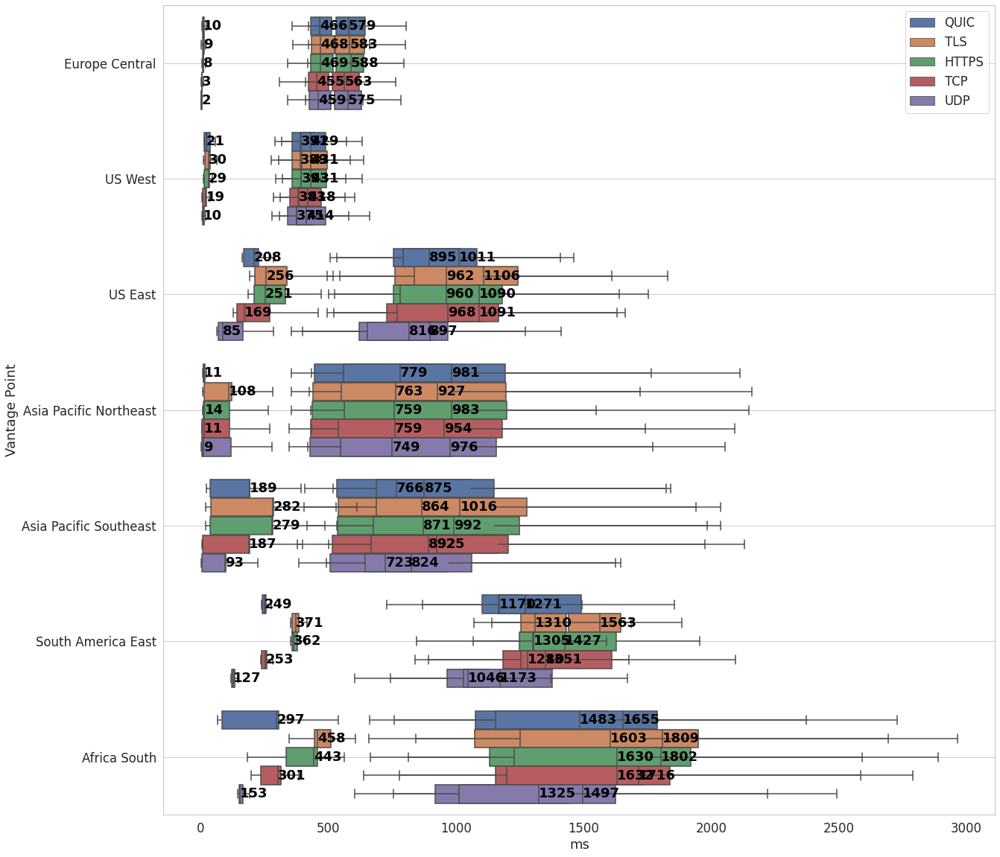

**twitter.com**

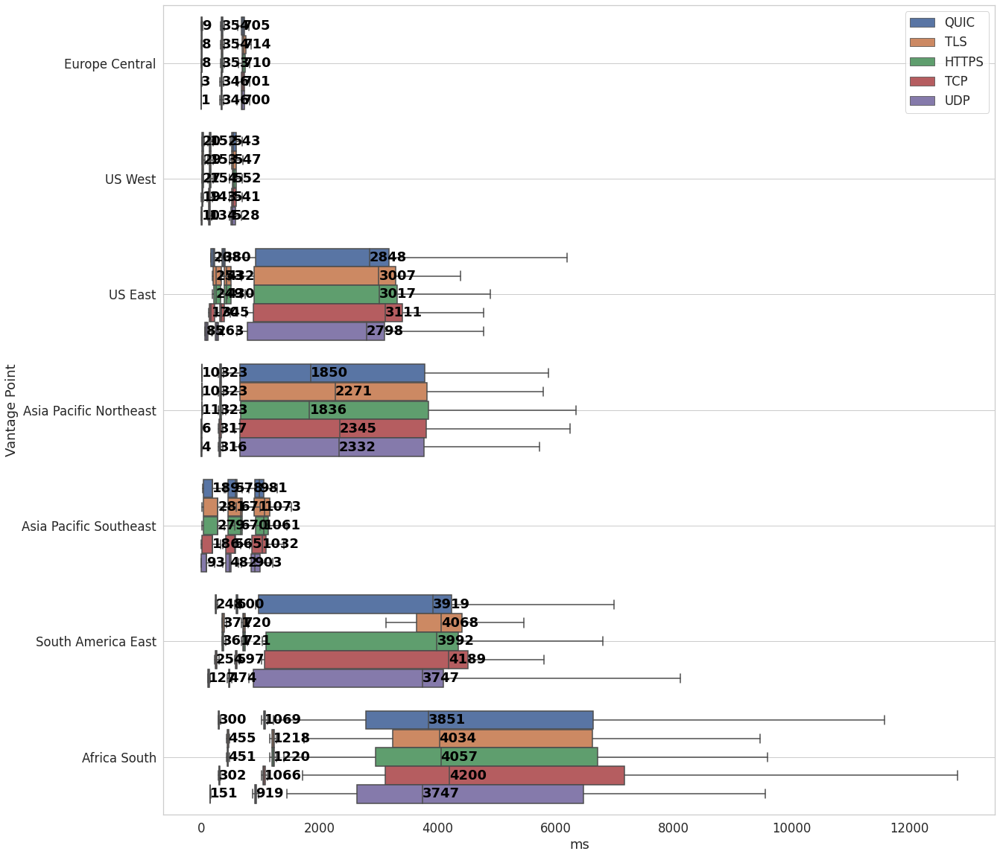

**www.google.com**

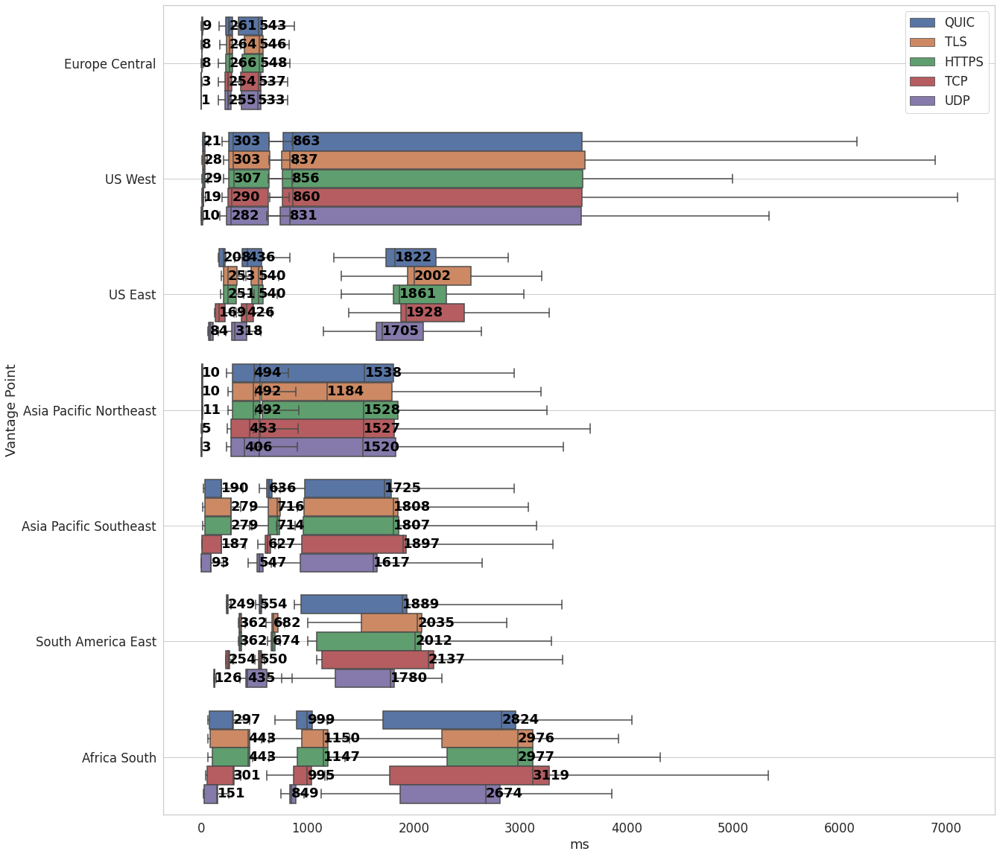

**www.baidu.com**

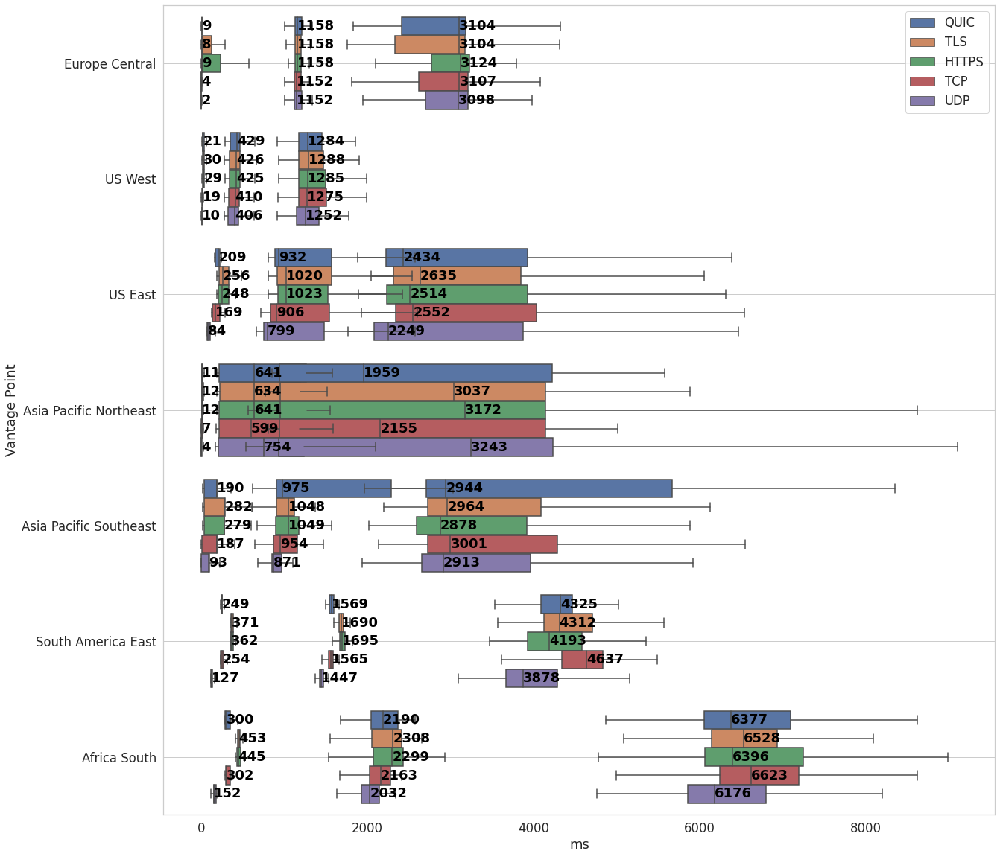

**www.netflix.com**

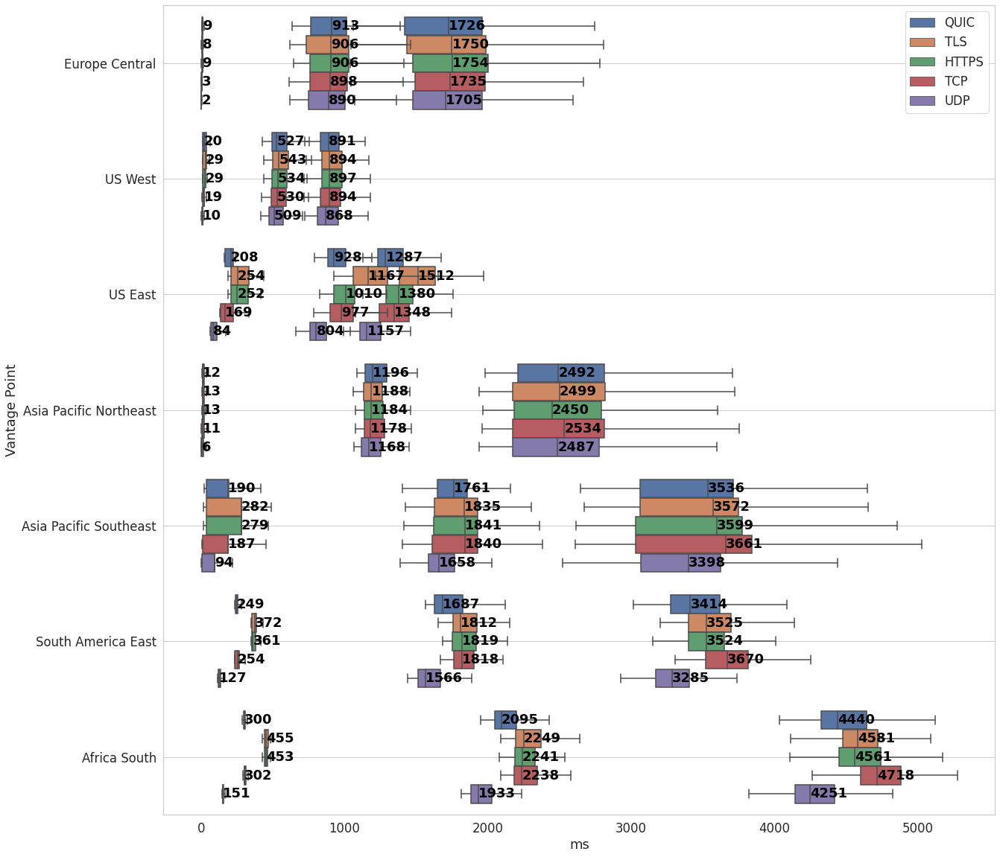

**www.youtube.com**

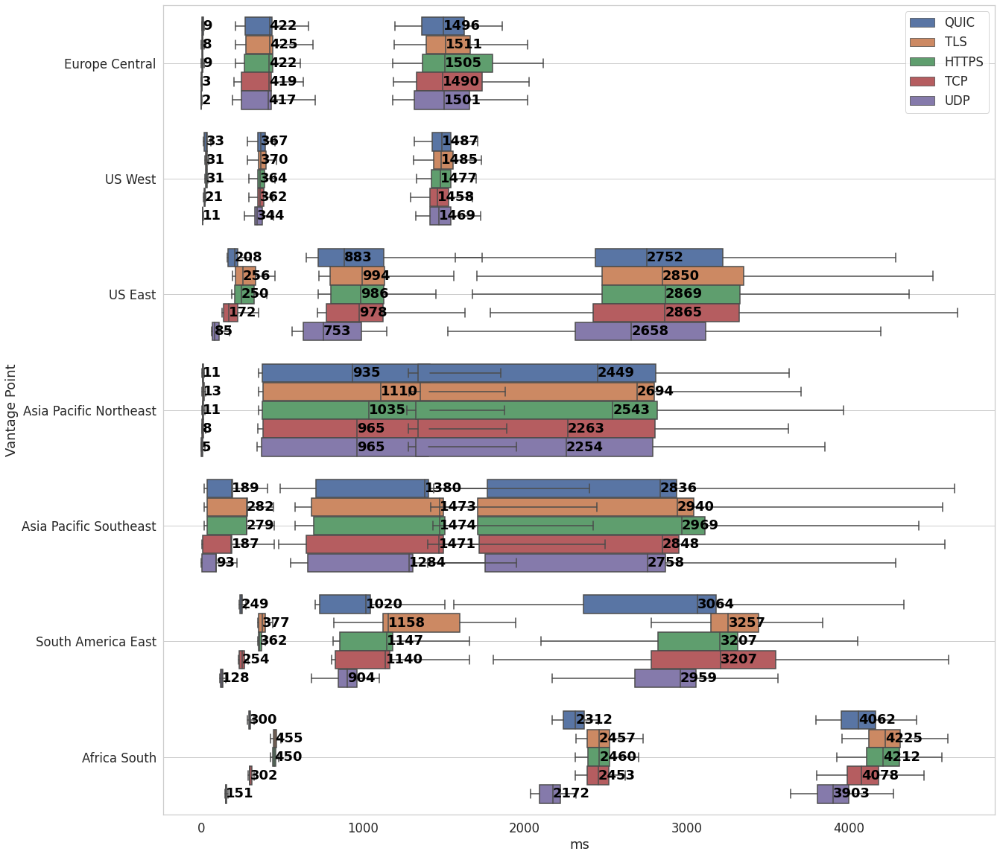

**www.microsoft.com**

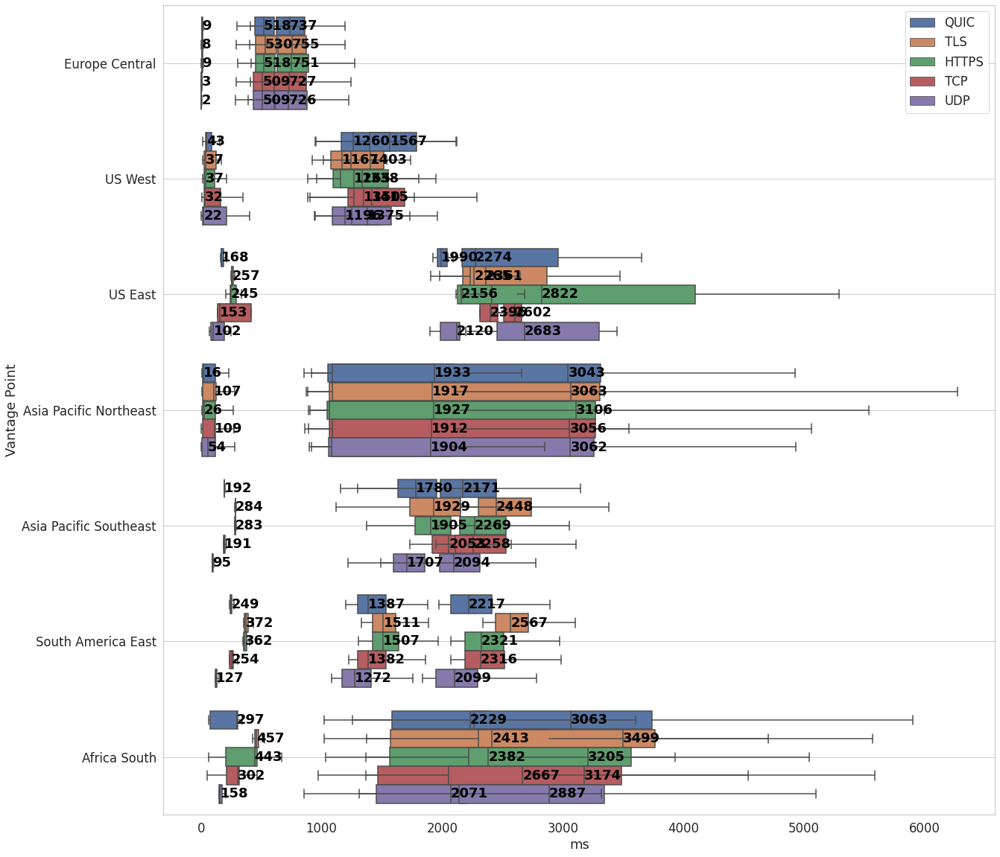

**All**

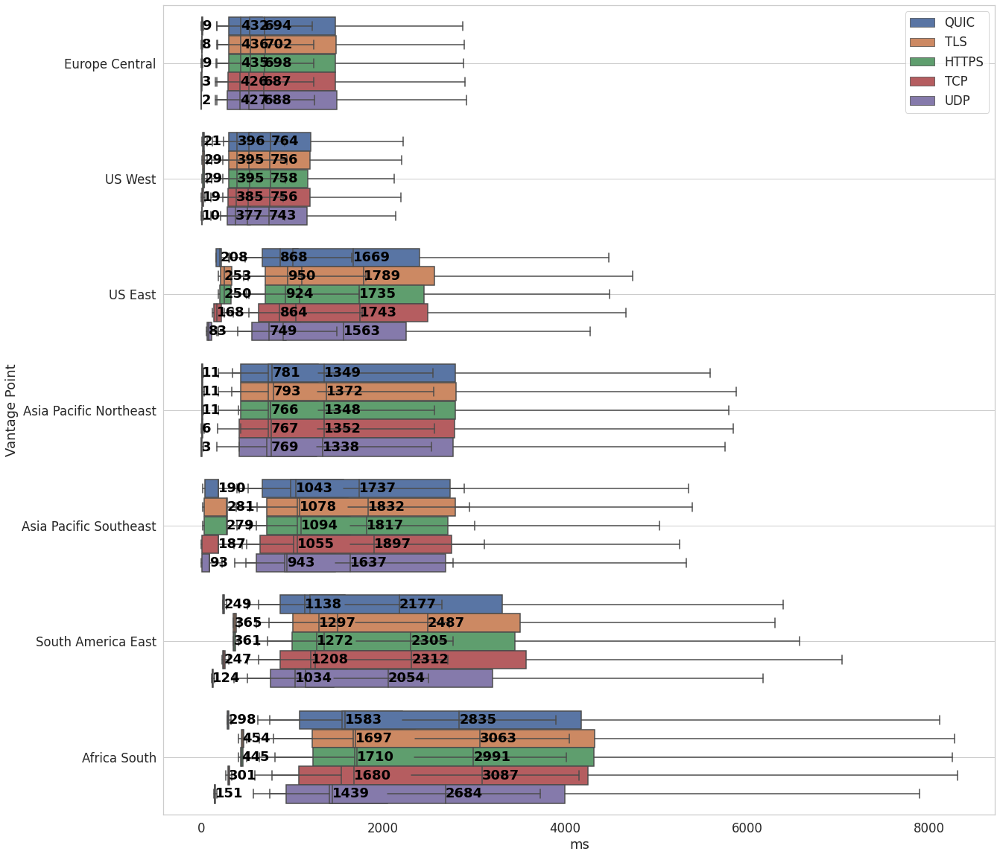

In [65]:
printmd(f"***Vantage Point Comparison (Lookup End - FCP - Load Event Start)***")
plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['max_lookup_end', 'firstContentfulPaint', 'loadEventStart'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['max_lookup_end', 'firstContentfulPaint', 'loadEventStart'], ylabel='Vantage Point')

***Vantage Point Comparison (Lookup End - Load Event Start)***

**www.wikipedia.org**

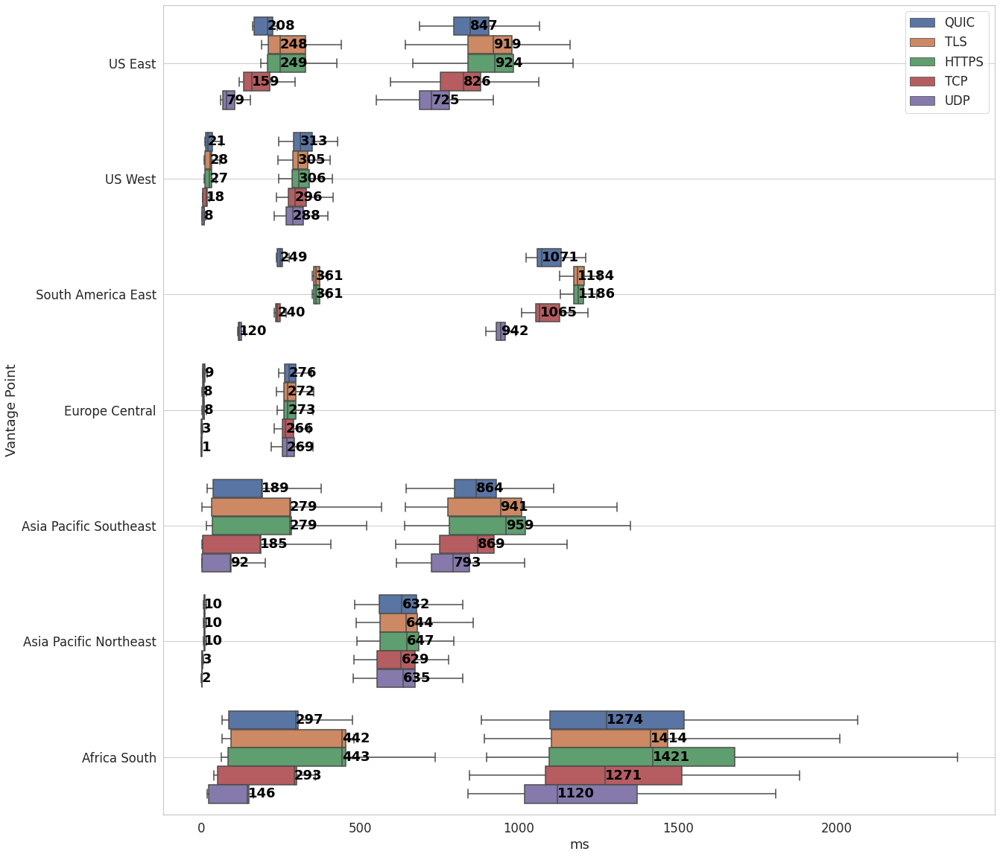

**www.instagram.com**

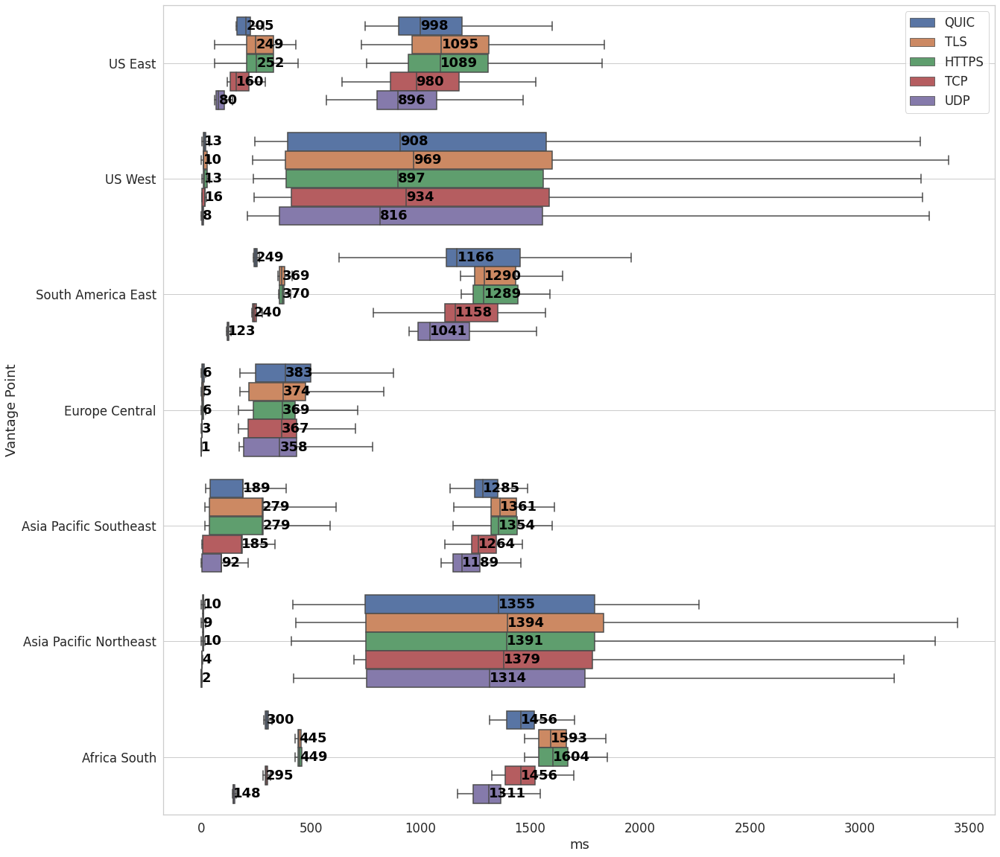

**www.facebook.com**

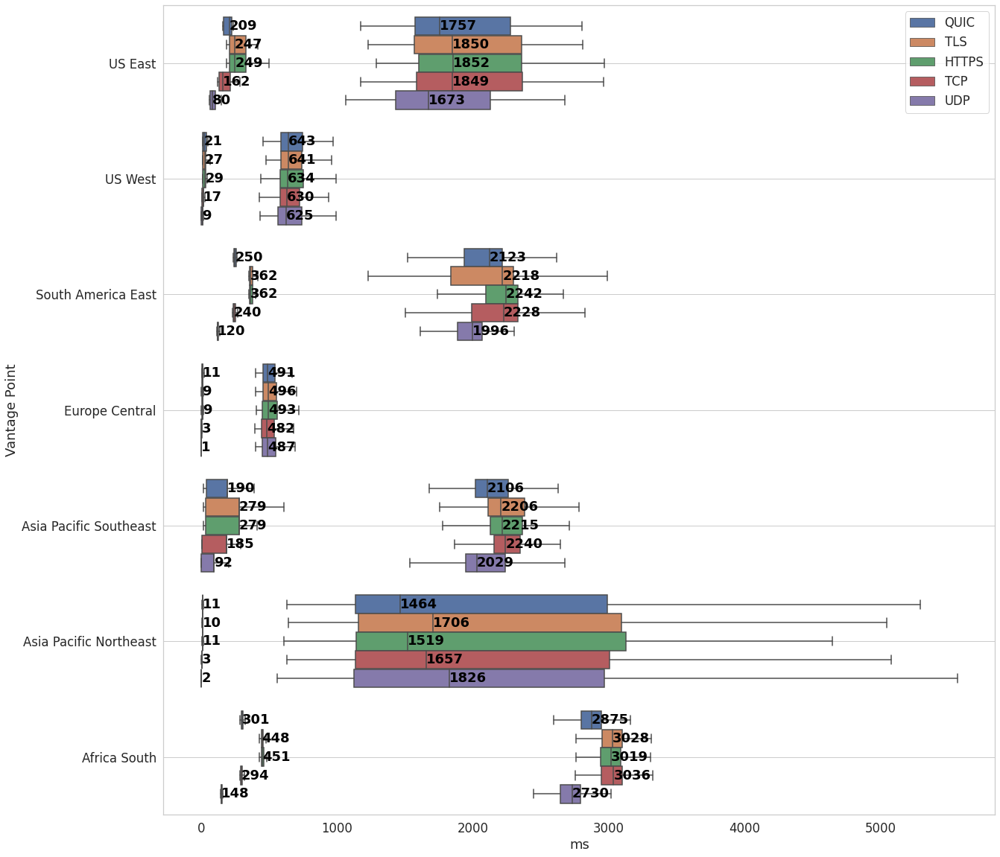

**www.apple.com**

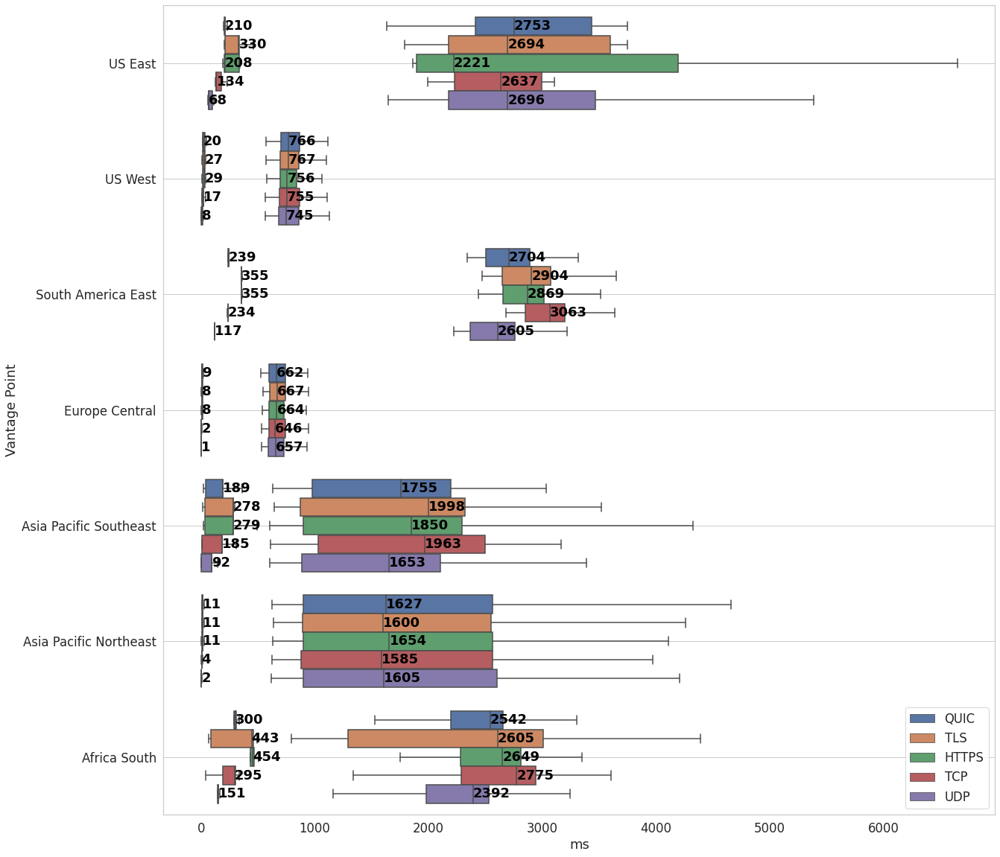

**www.linkedin.com**

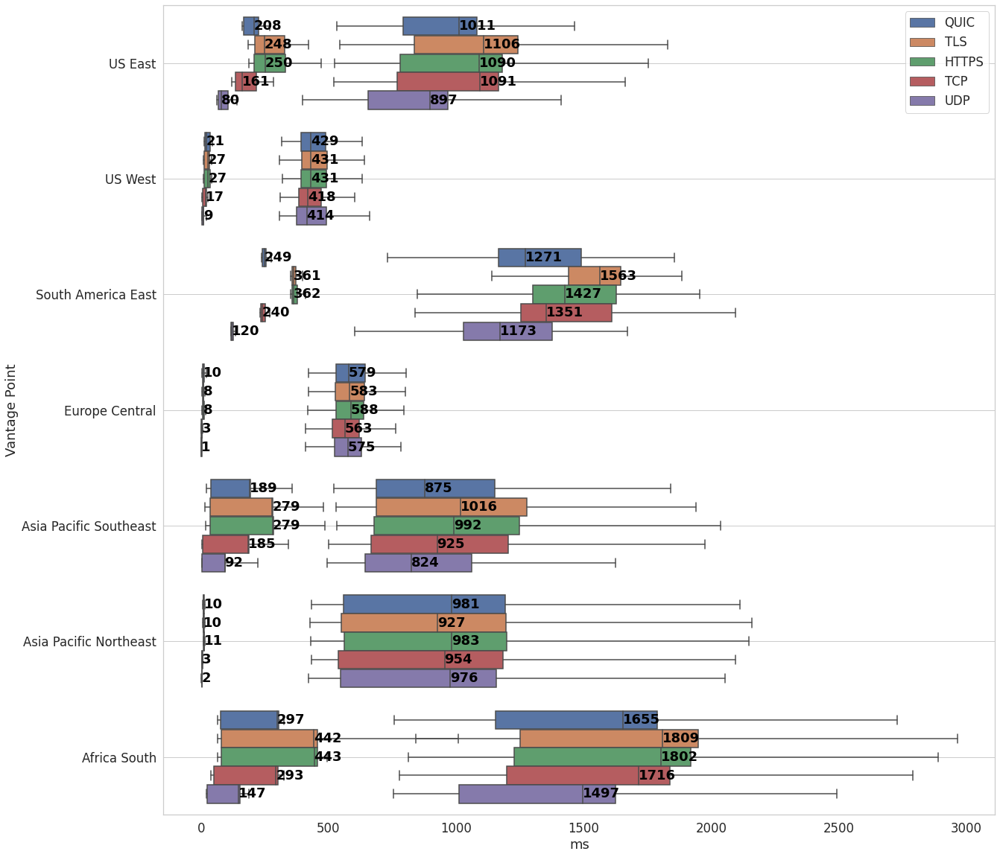

**twitter.com**

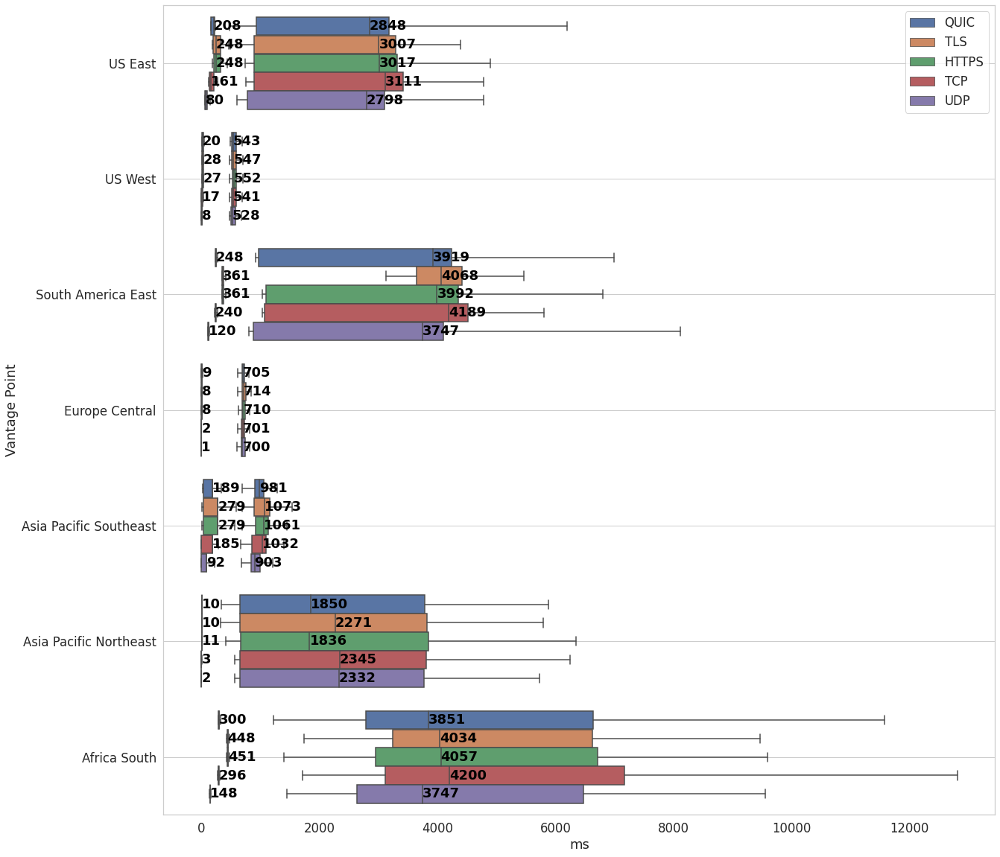

**www.google.com**

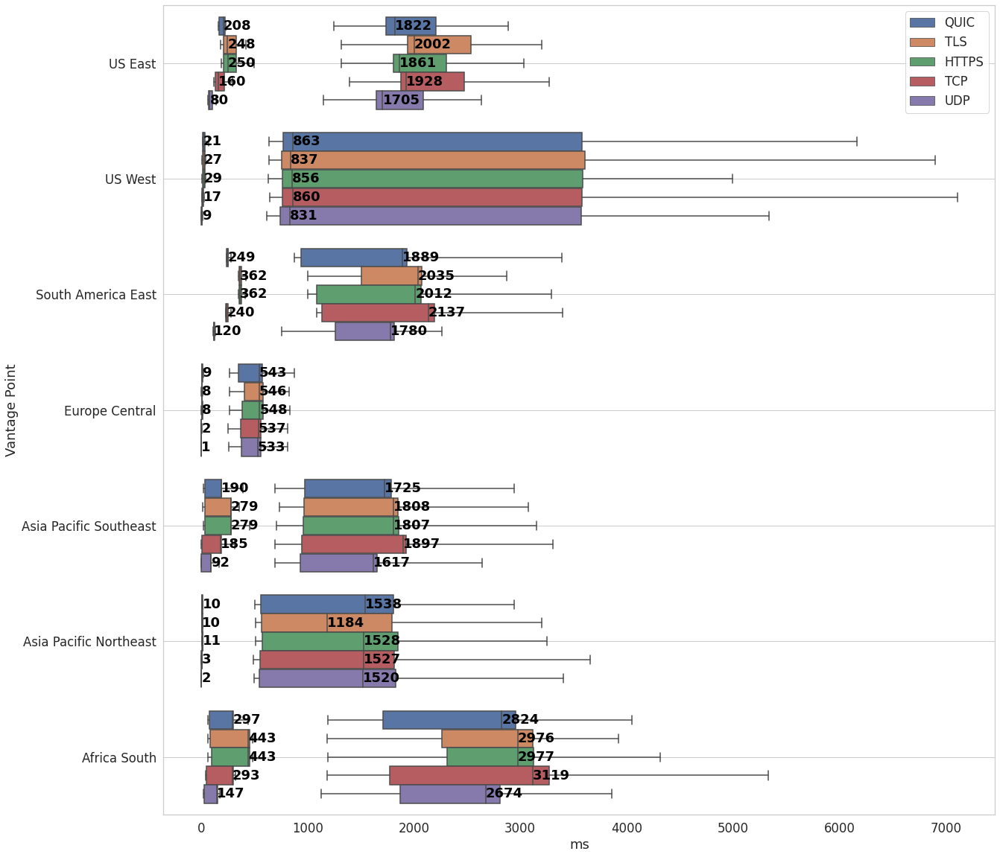

**www.baidu.com**

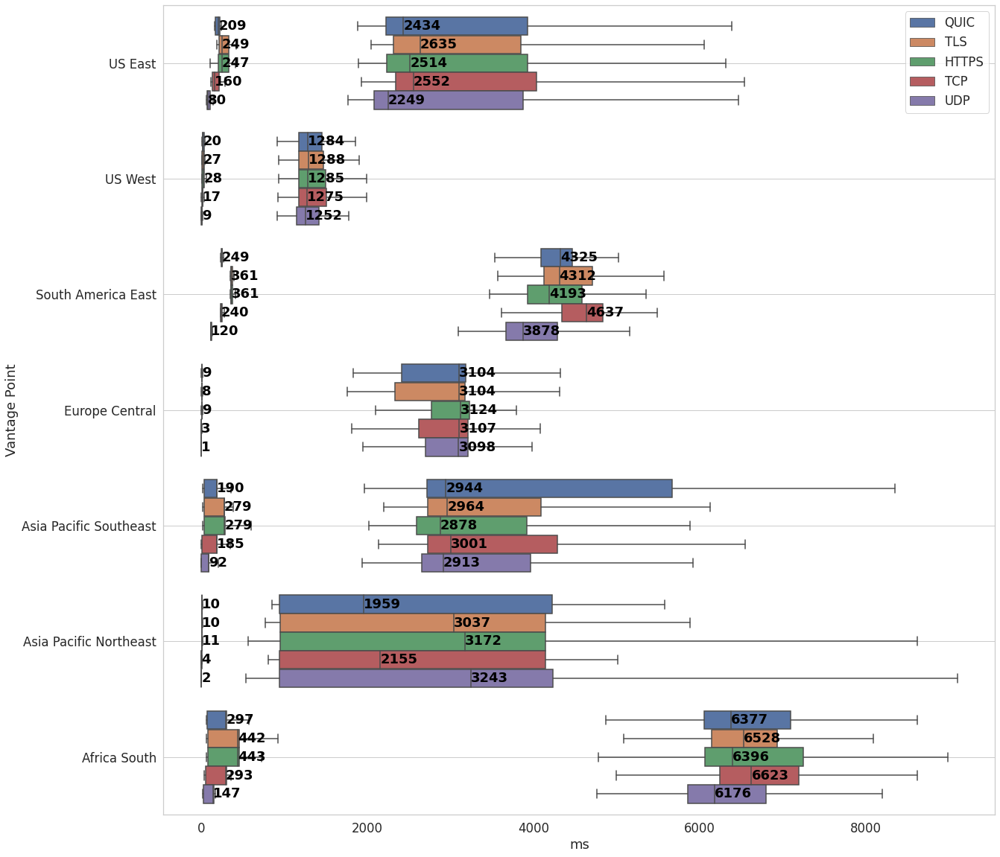

**www.netflix.com**

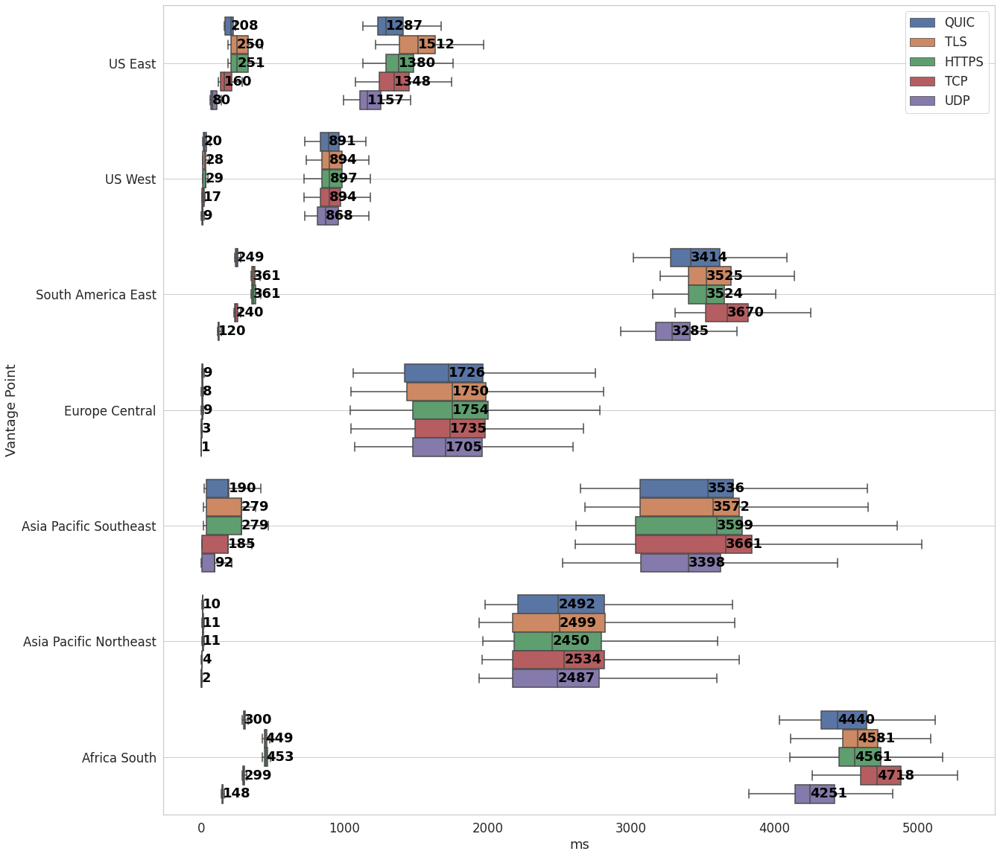

**www.youtube.com**

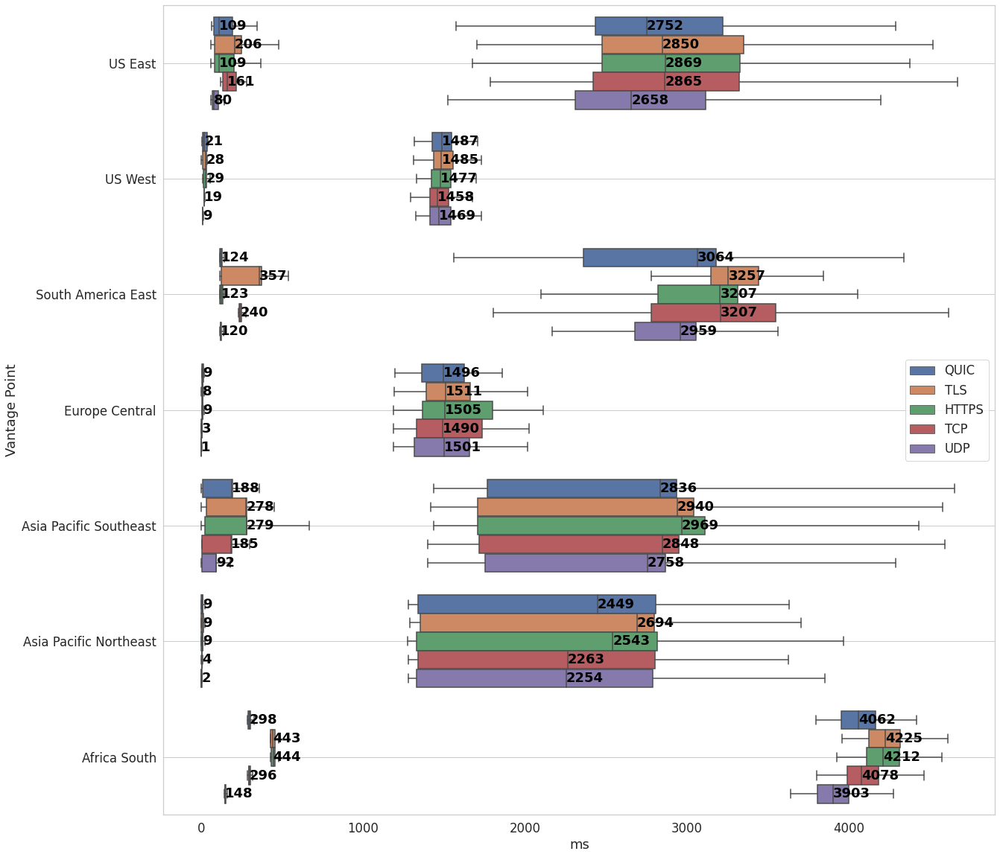

**www.microsoft.com**

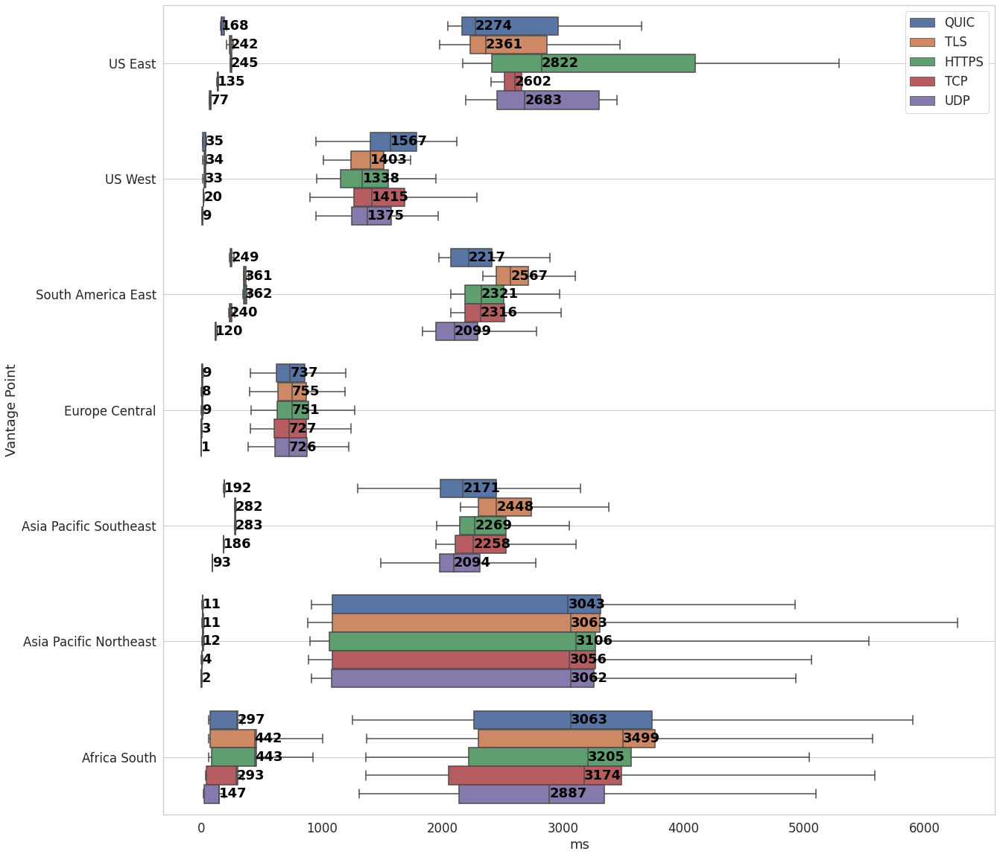

**All**

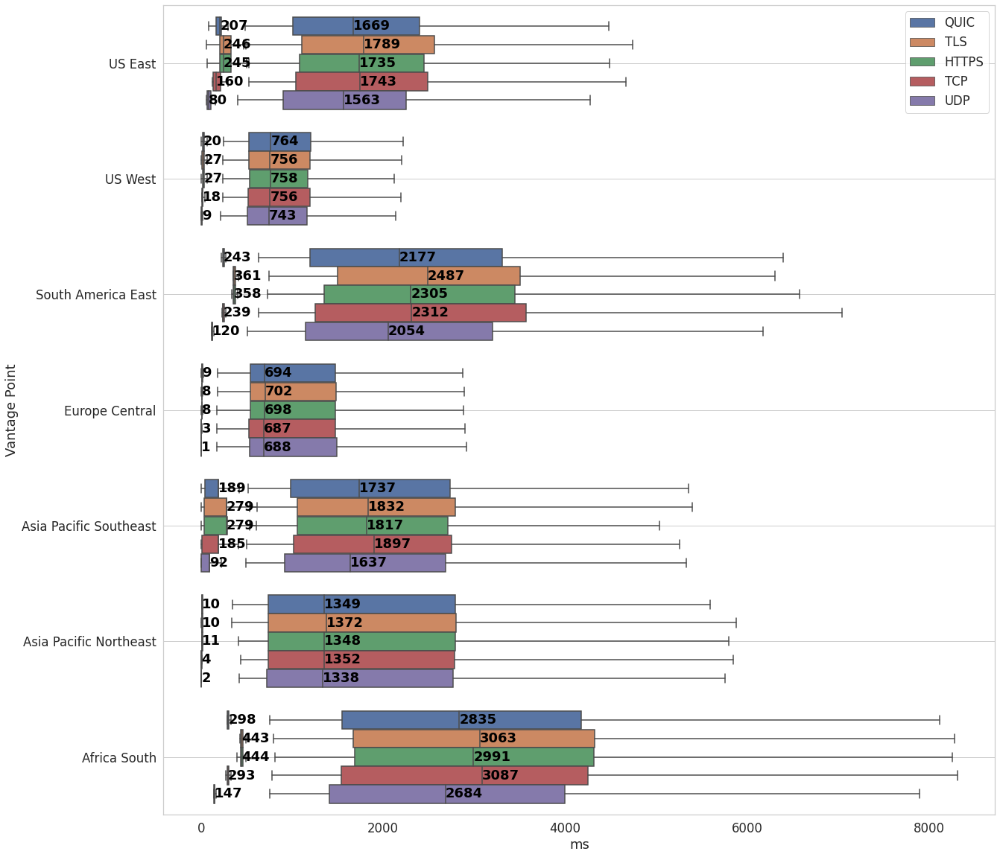

In [79]:
printmd(f"***Vantage Point Comparison (Lookup End - Load Event Start)***")
plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['elapsed', 'loadEventStart'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['elapsed', 'loadEventStart'], ylabel='Vantage Point')

***Vantage Point Comparison (Lookup End - Difference between Lookup End and Pageload End)***

**www.wikipedia.org**

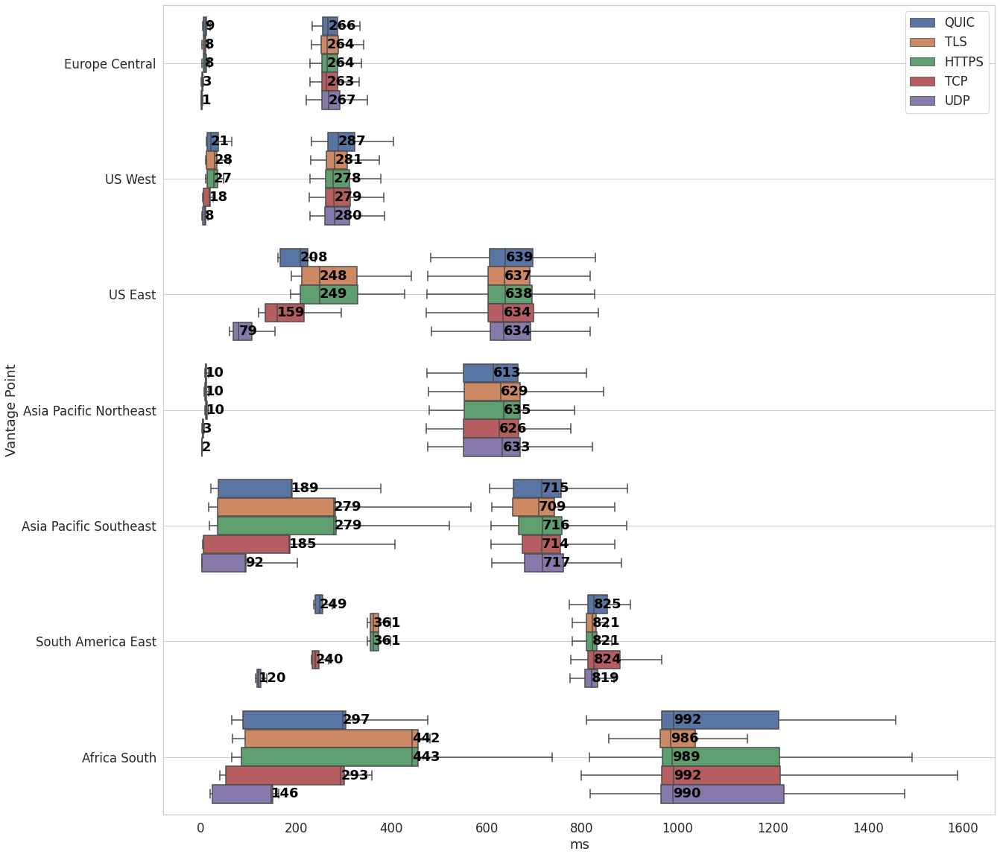

**www.instagram.com**

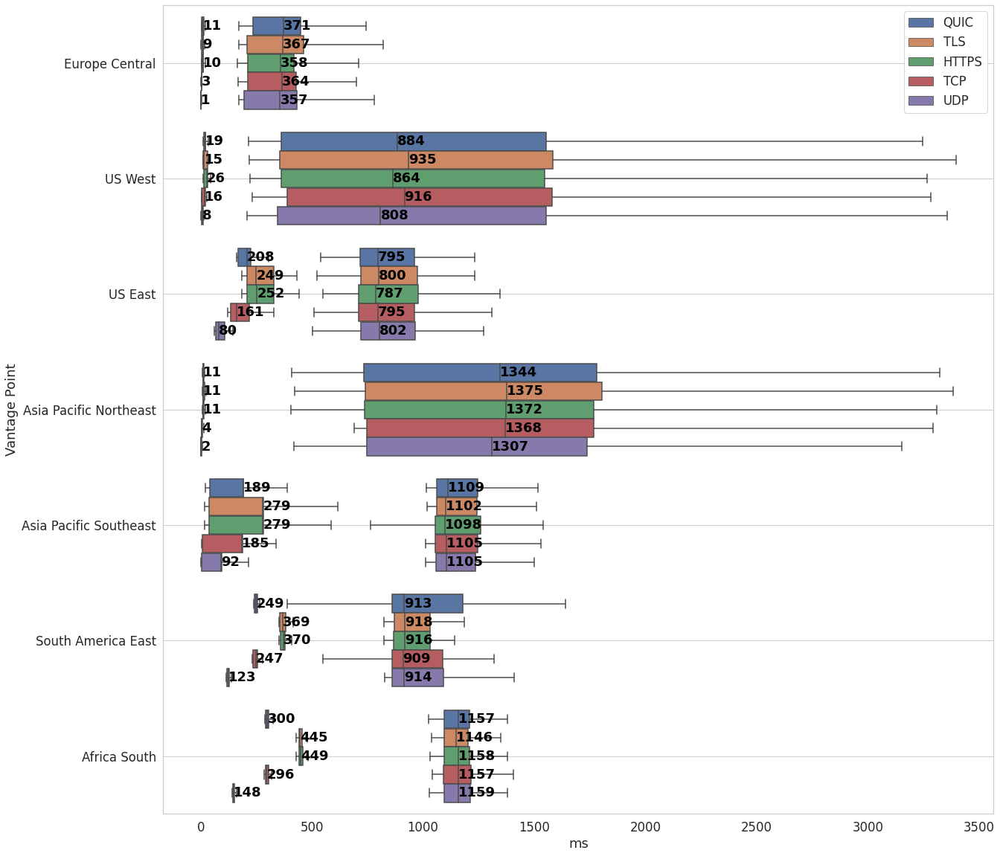

**www.facebook.com**

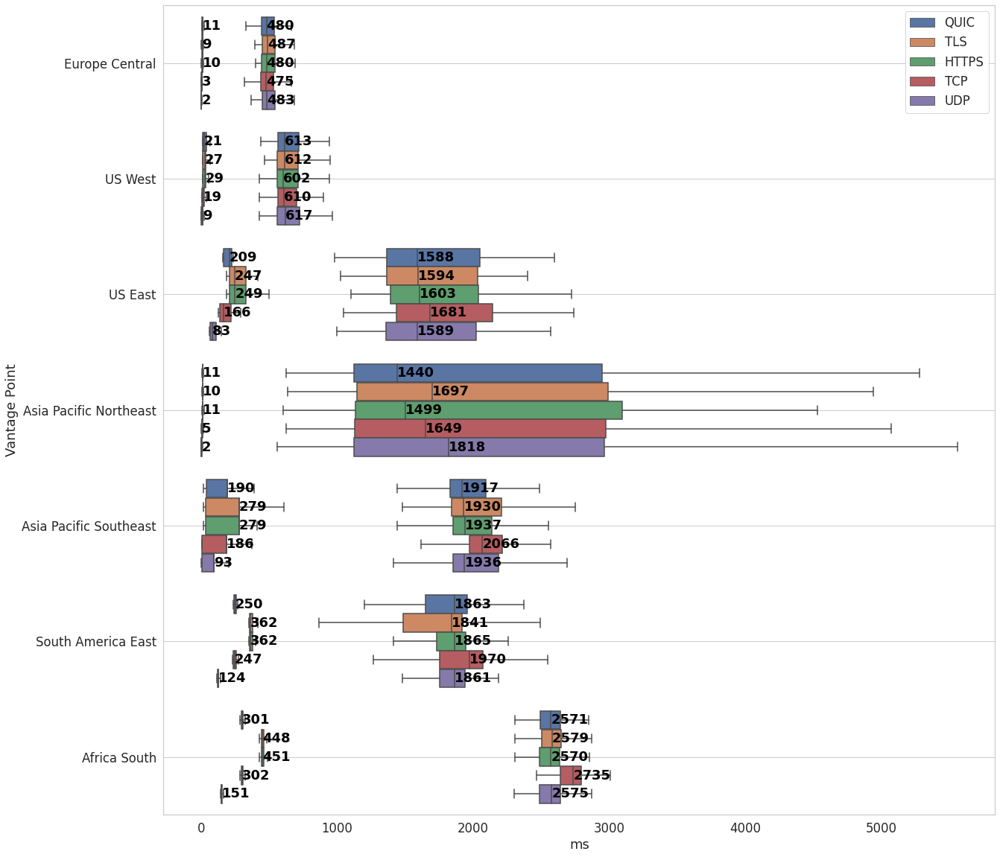

**www.apple.com**

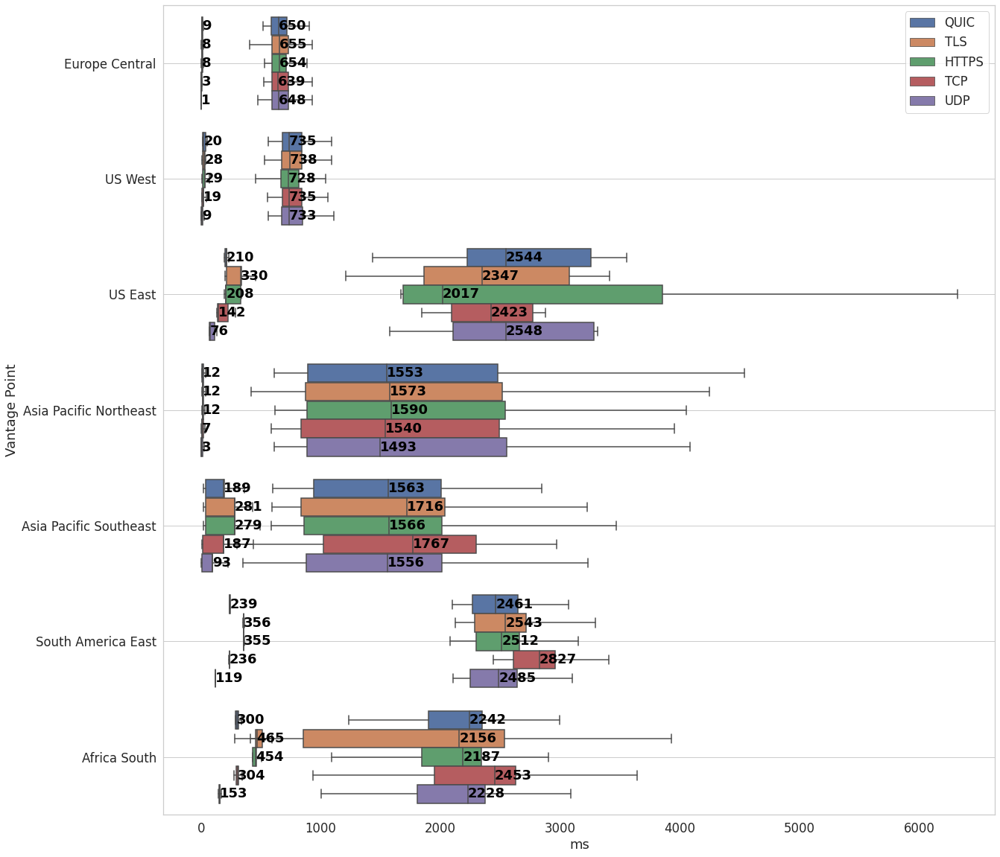

**www.linkedin.com**

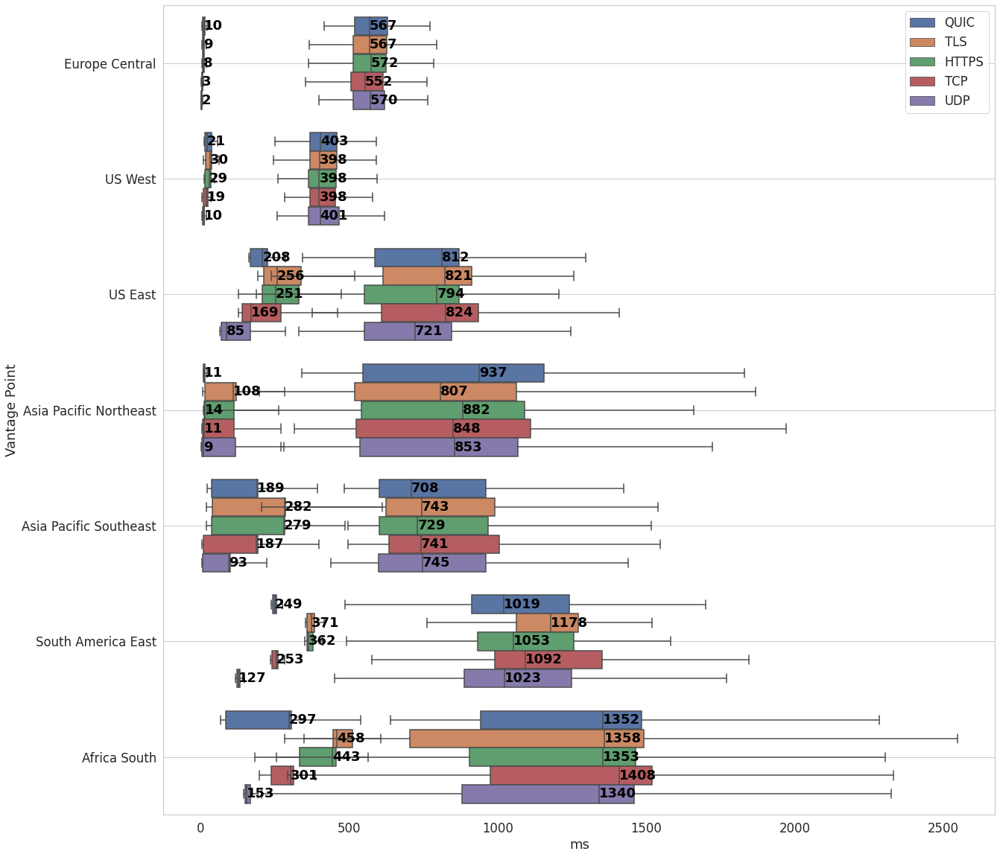

**twitter.com**

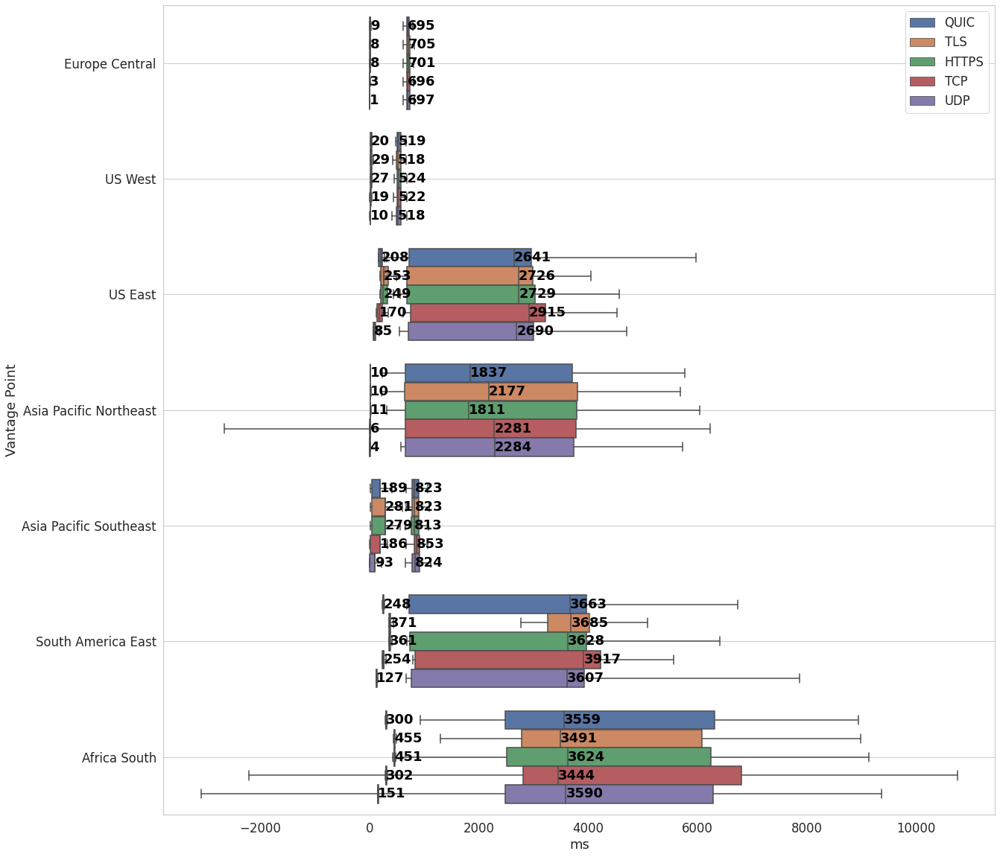

**www.google.com**

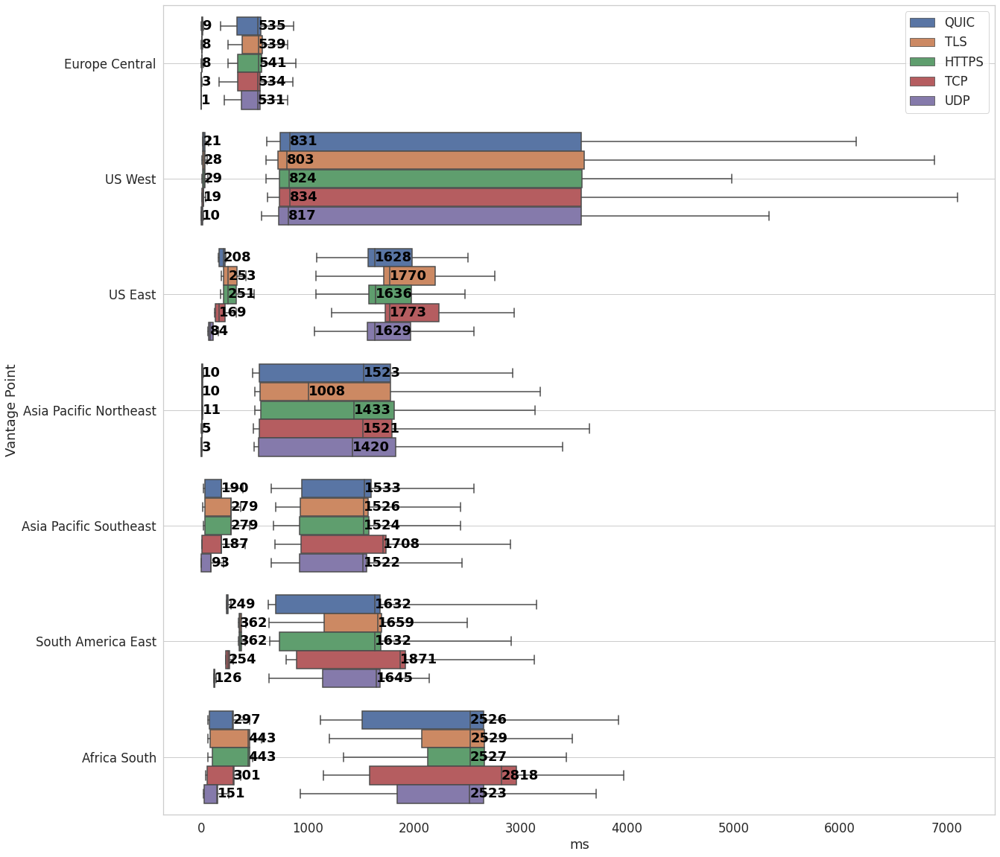

**www.baidu.com**

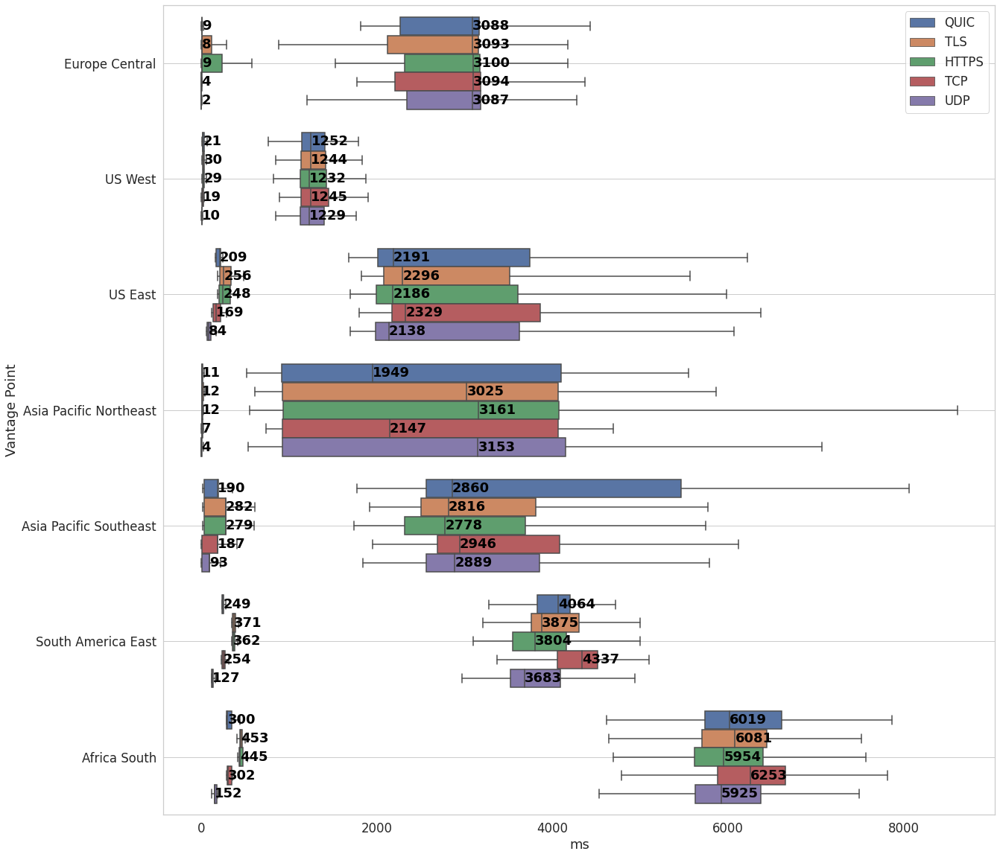

**www.netflix.com**

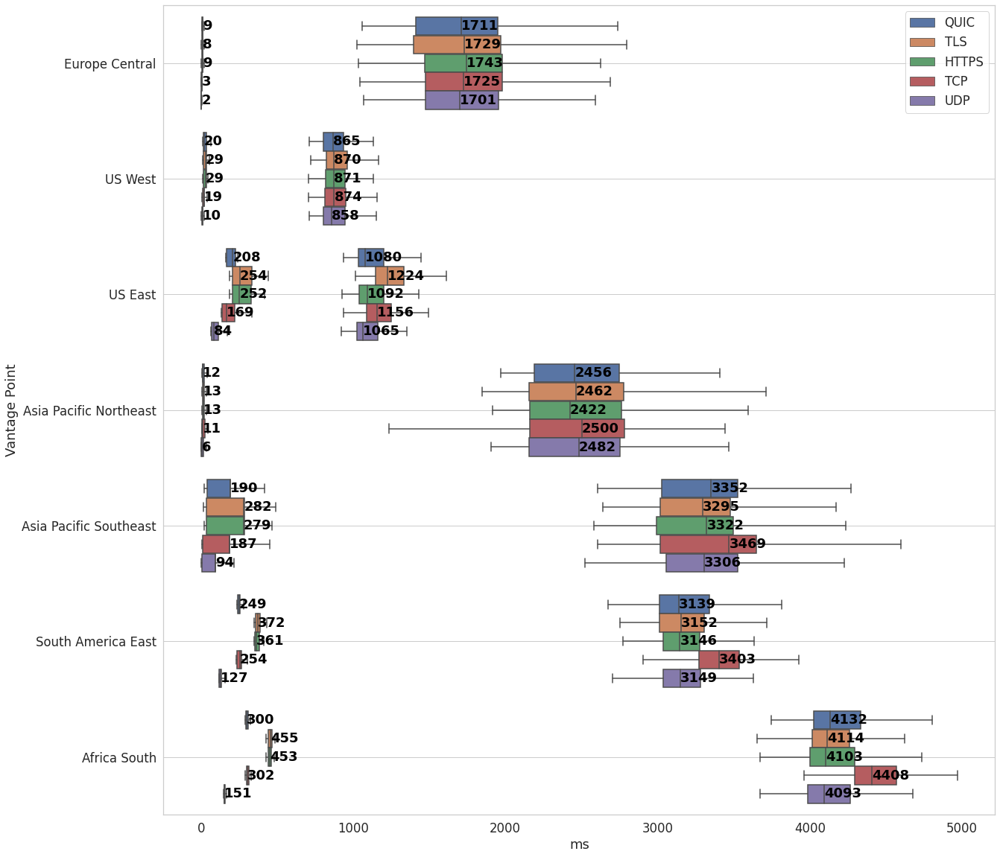

**www.youtube.com**

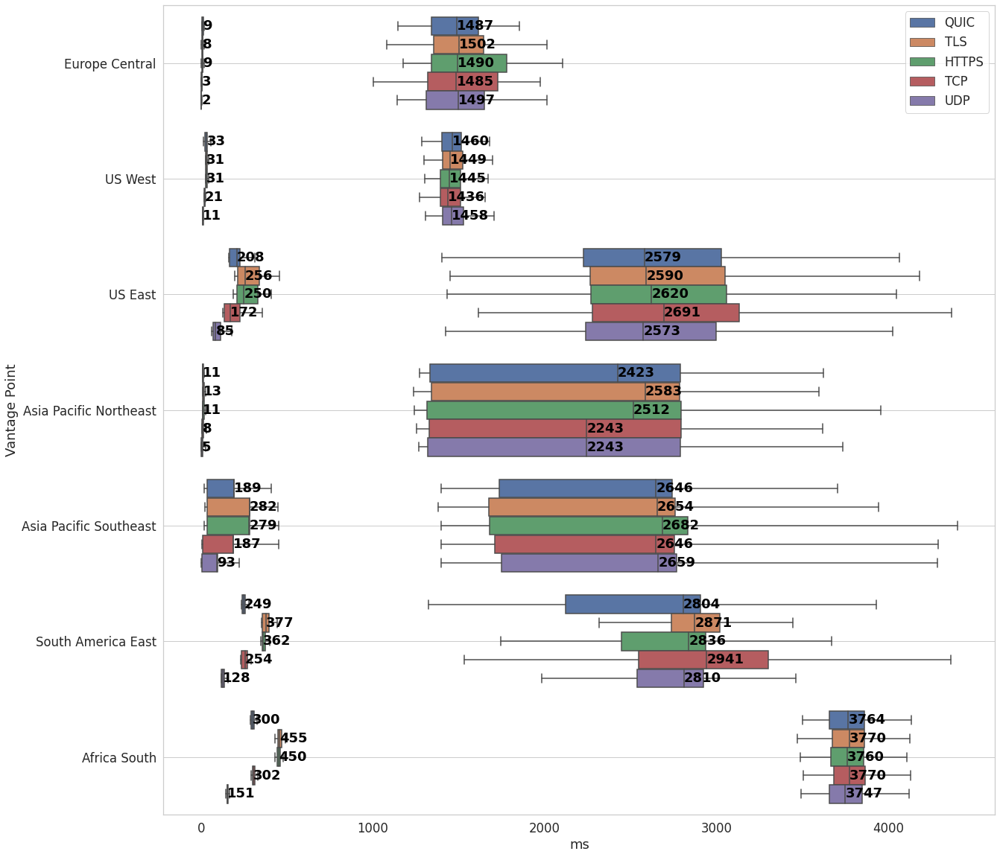

**www.microsoft.com**

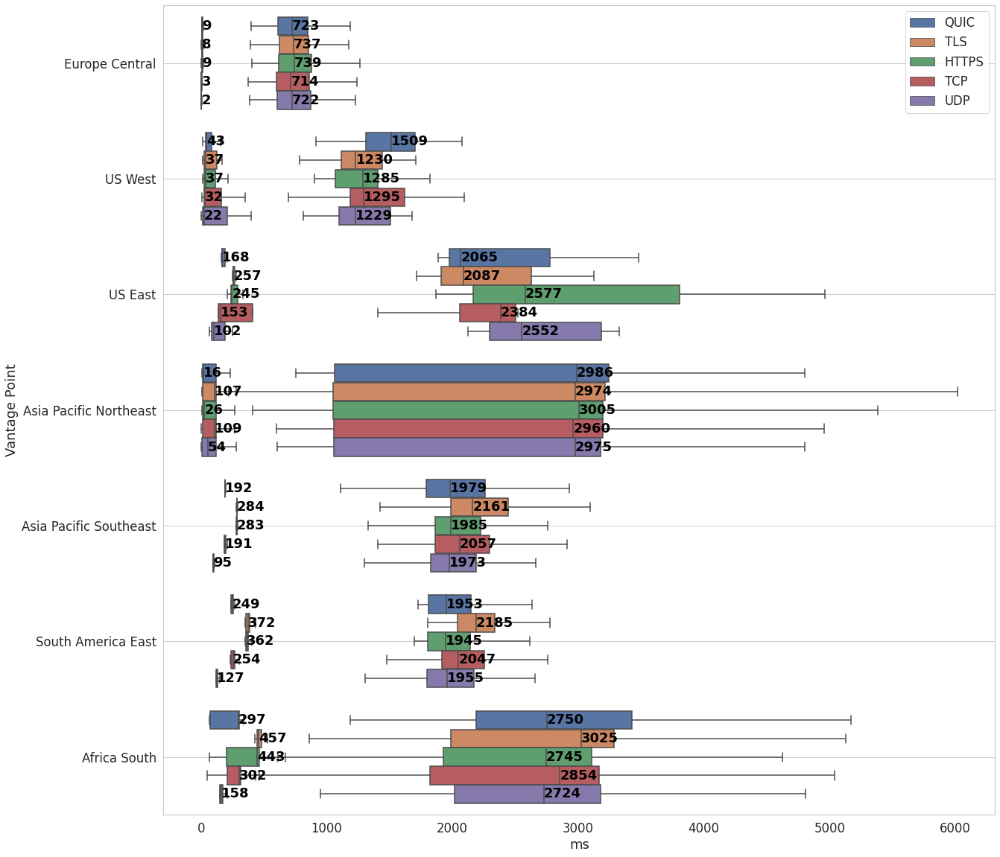

**All**

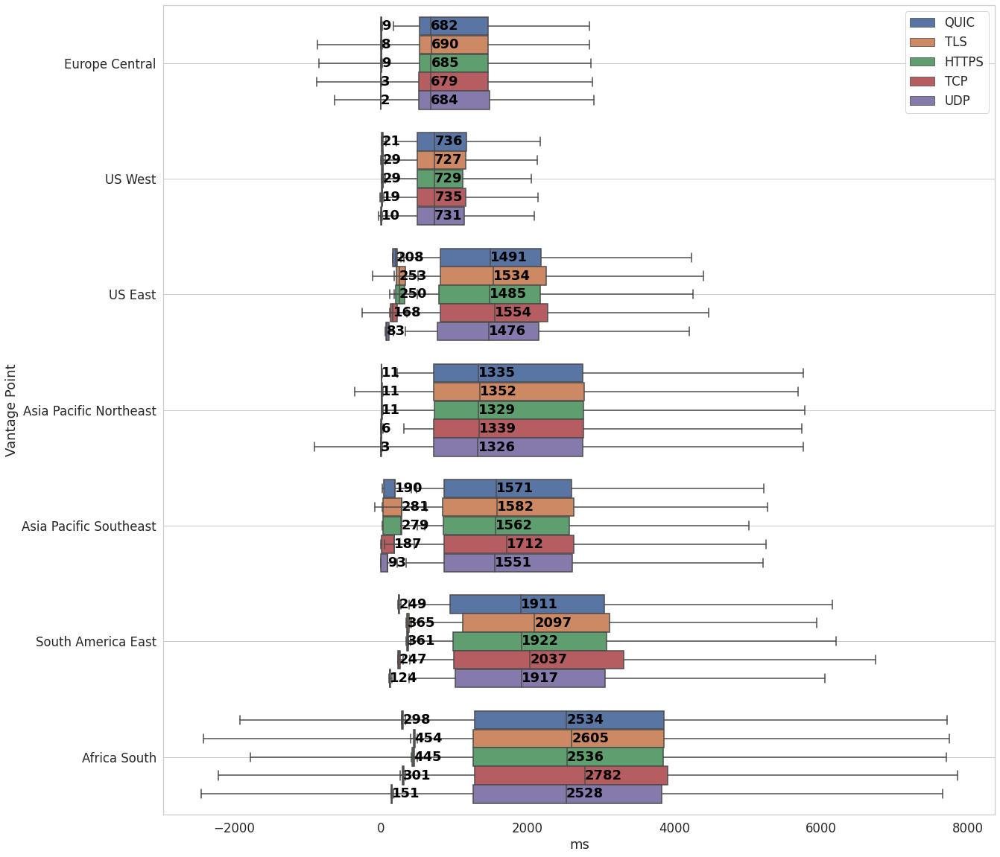

In [64]:
printmd(f"***Vantage Point Comparison (Lookup End - Difference between Lookup End and Pageload End)***")
plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['max_lookup_end', 'difLookupEnd'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['max_lookup_end', 'difLookupEnd'], ylabel='Vantage Point')

***Vantage Point Comparison (Lookup End - Difference between Lookup End and FCP)***

**www.wikipedia.org**

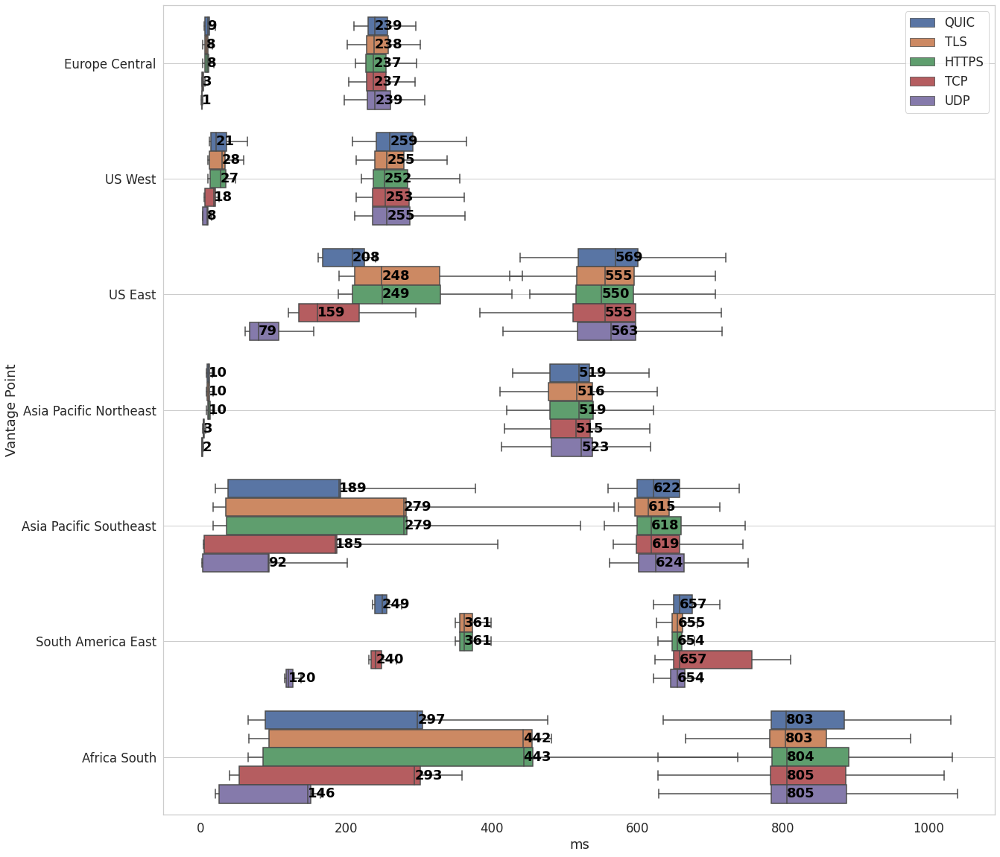

**www.instagram.com**

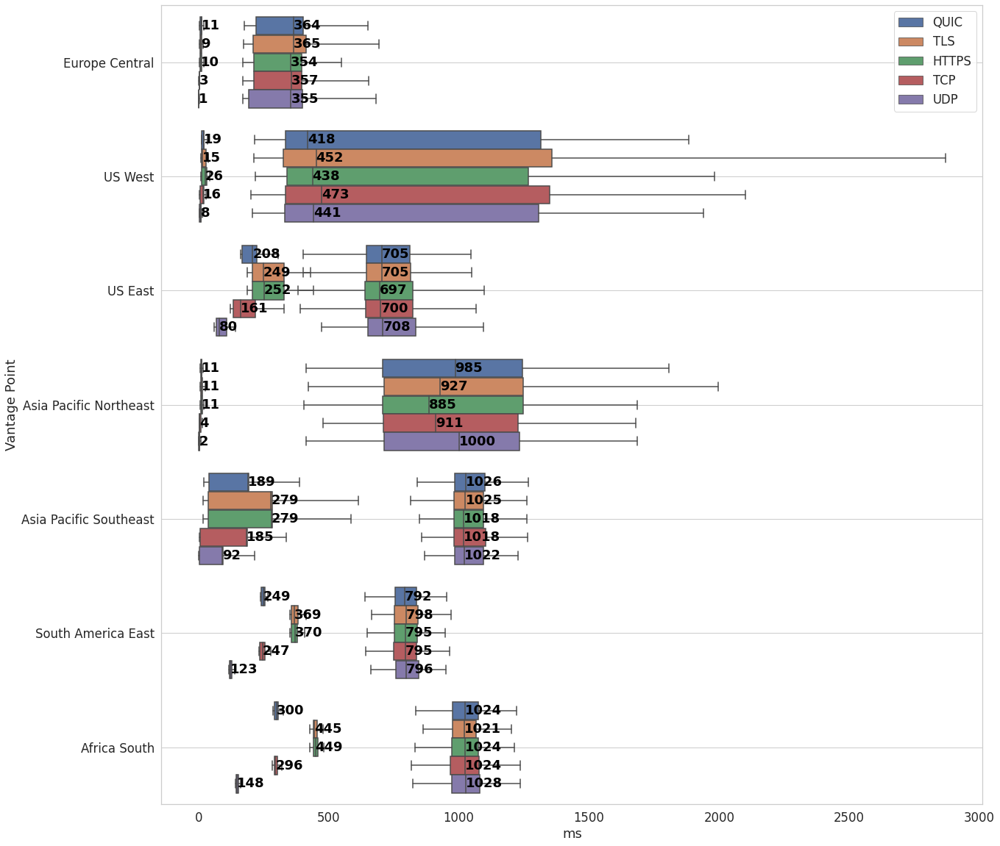

**www.facebook.com**

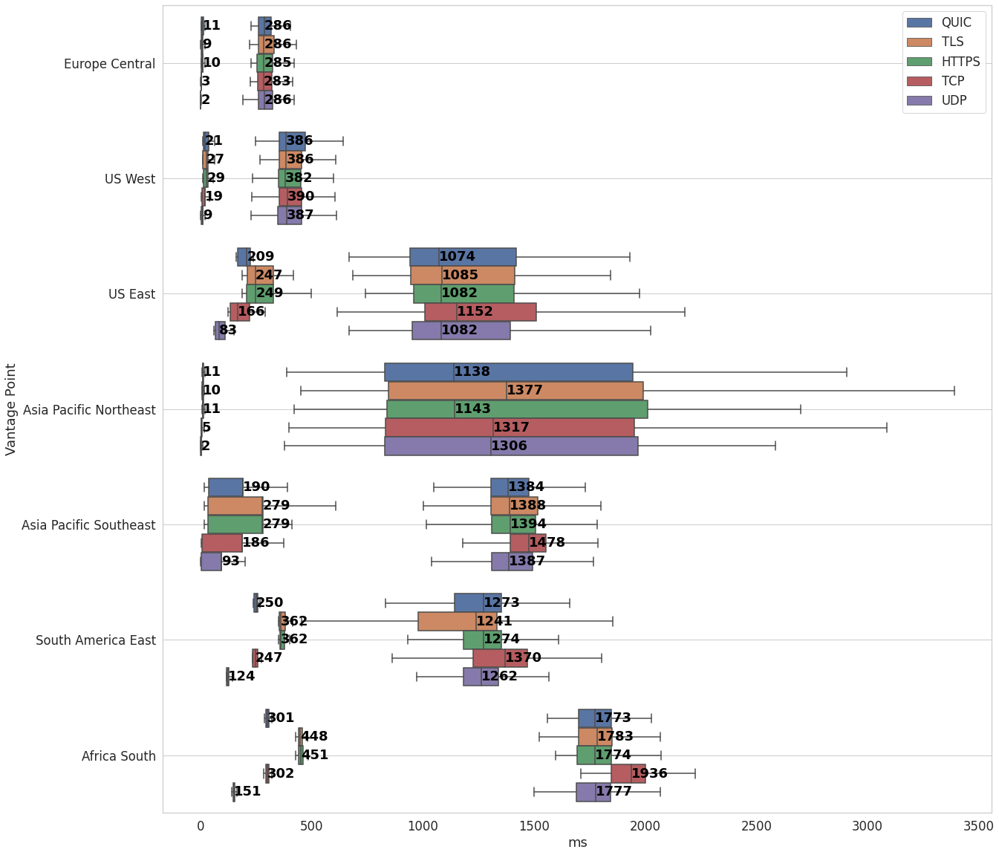

**www.apple.com**

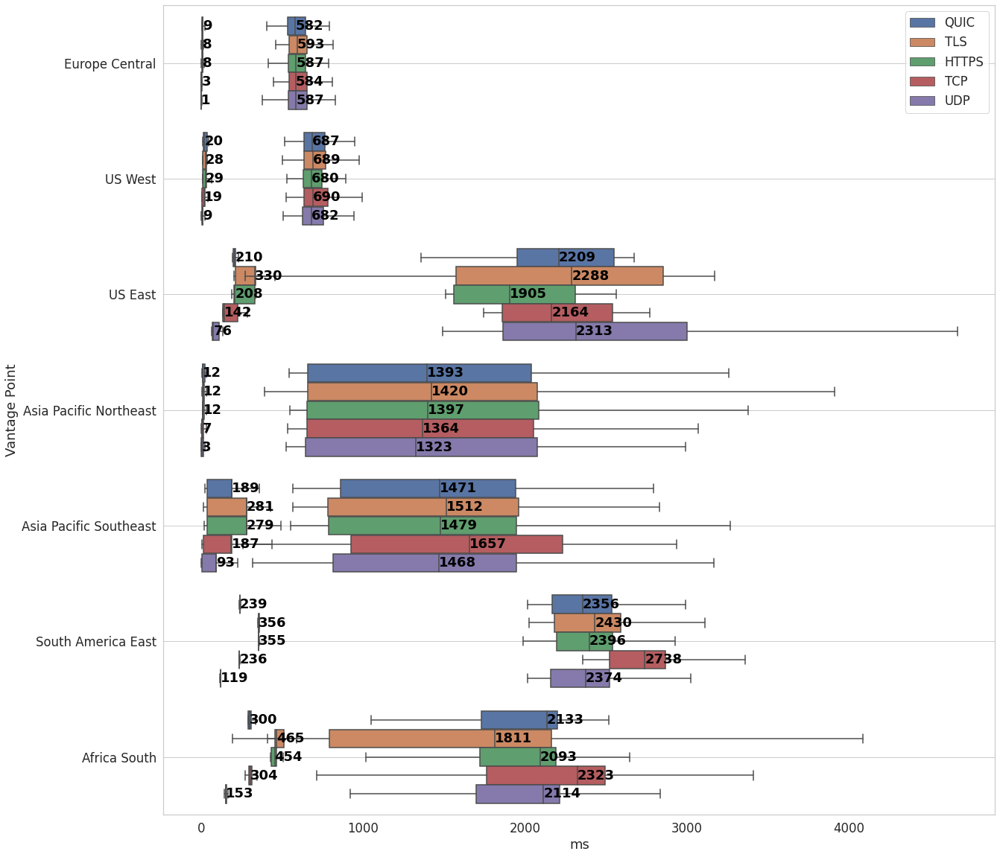

**www.linkedin.com**

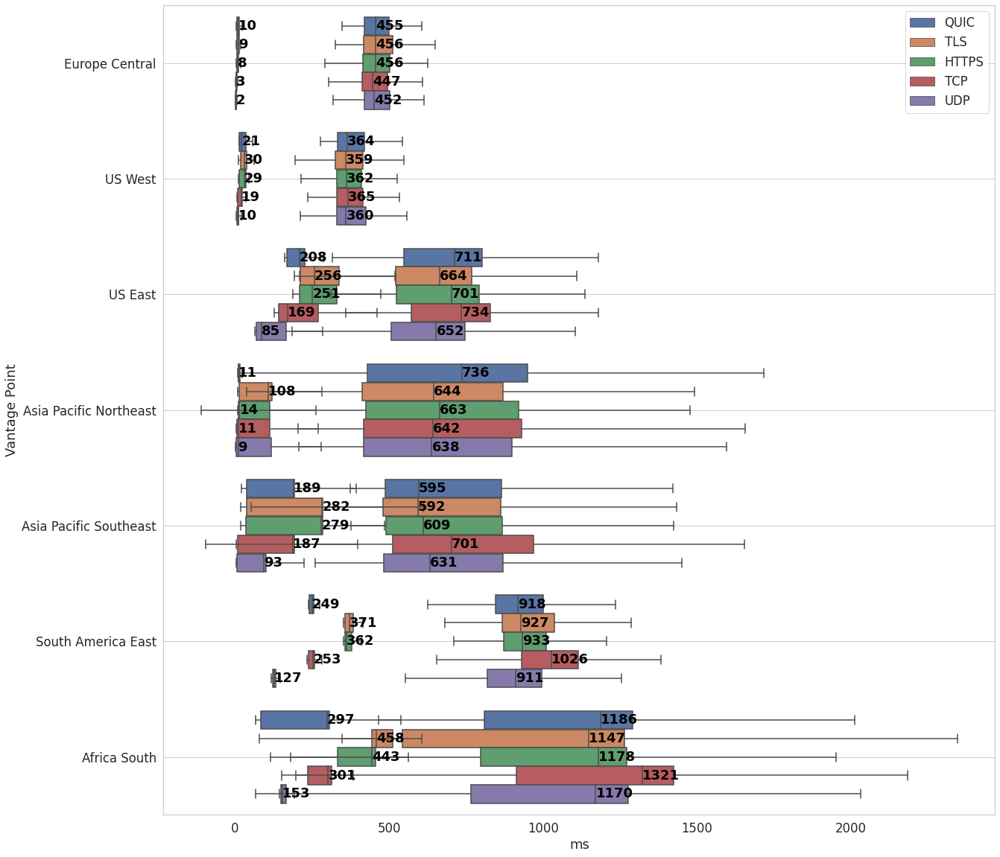

**twitter.com**

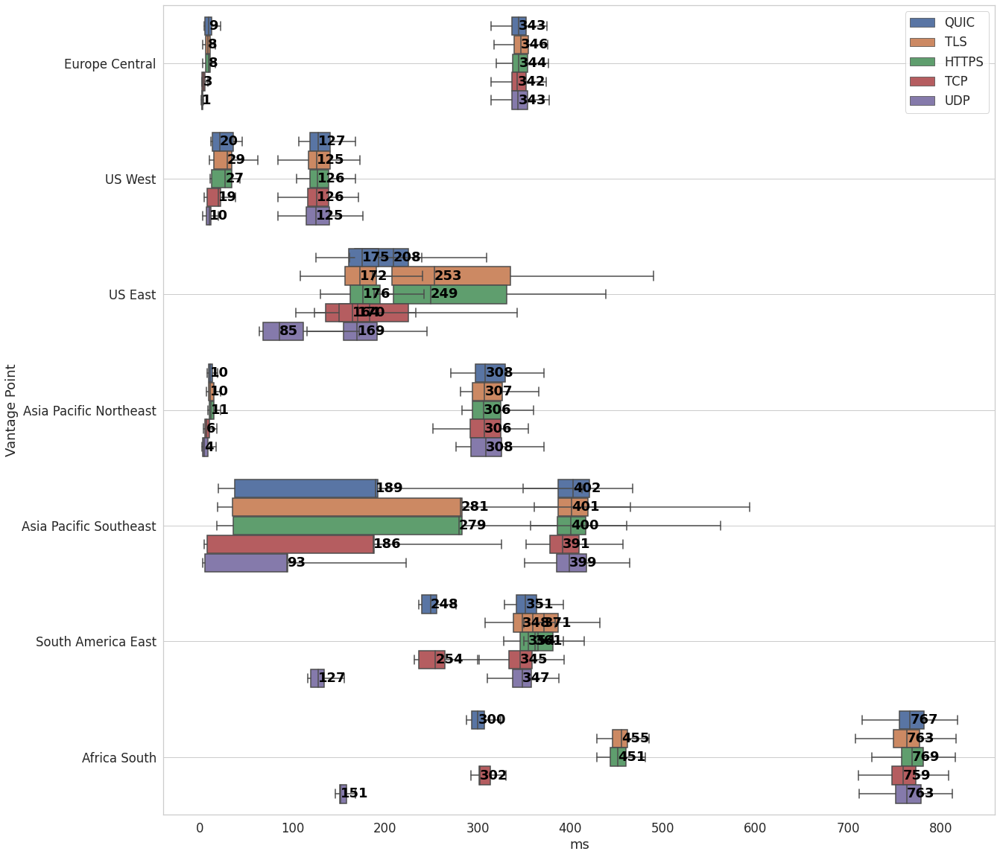

**www.google.com**

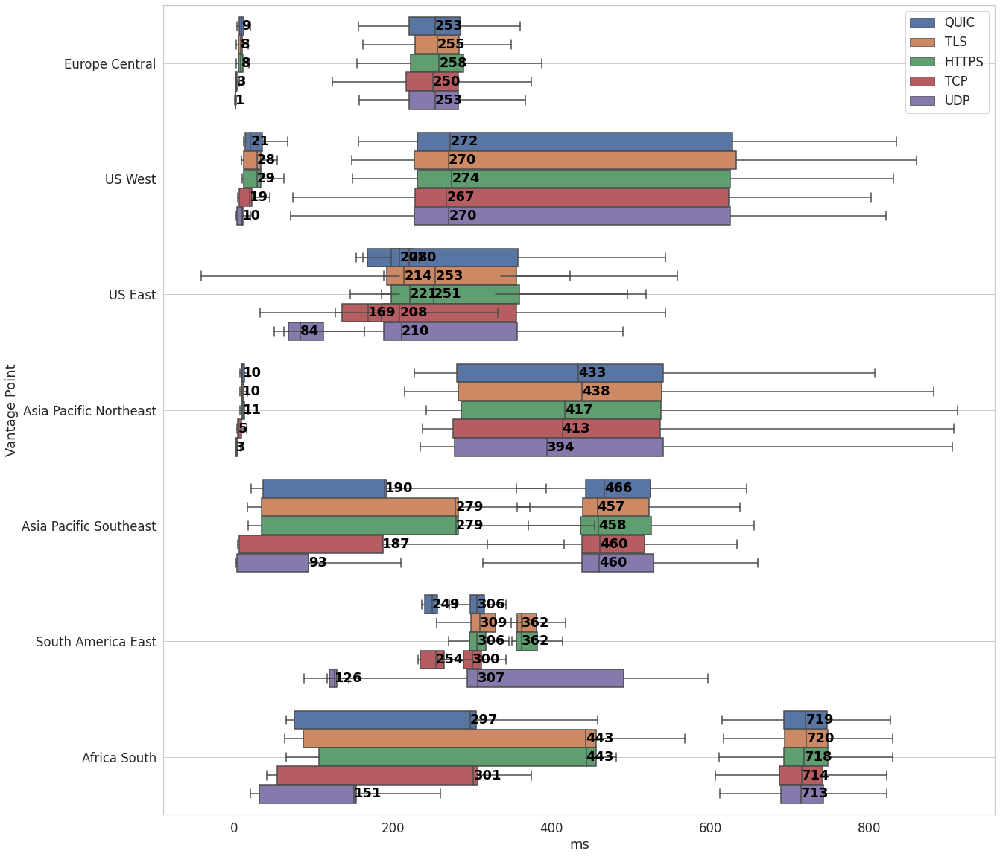

**www.baidu.com**

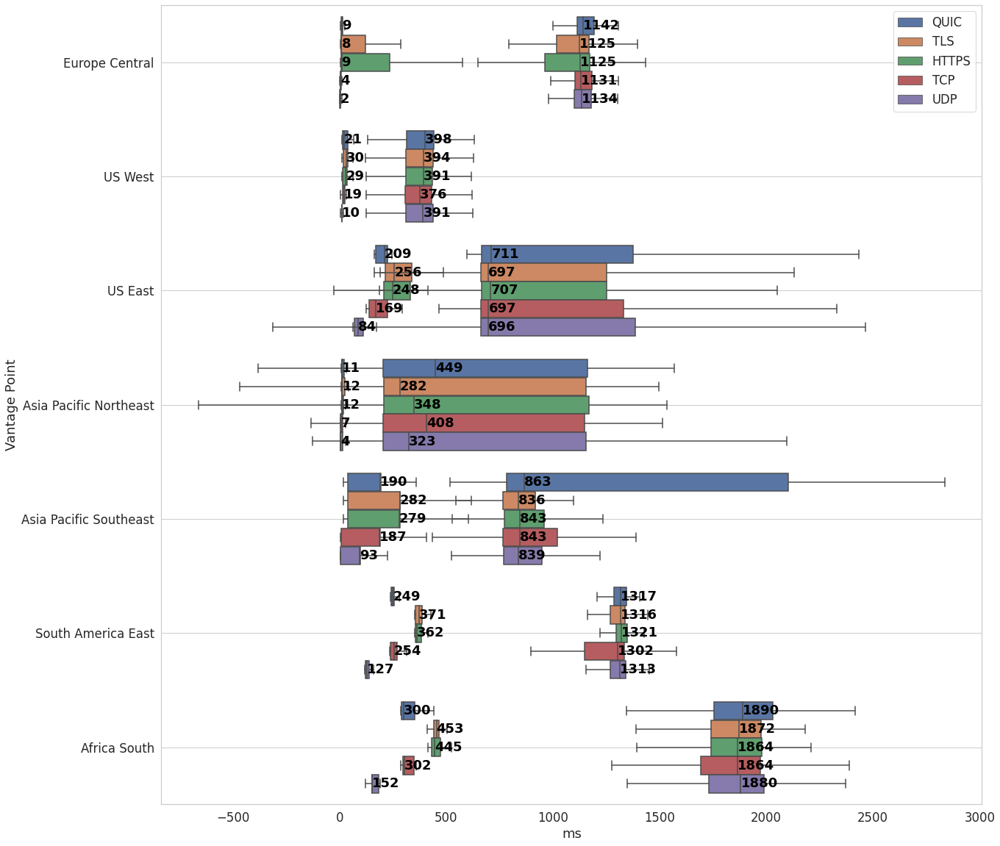

**www.netflix.com**

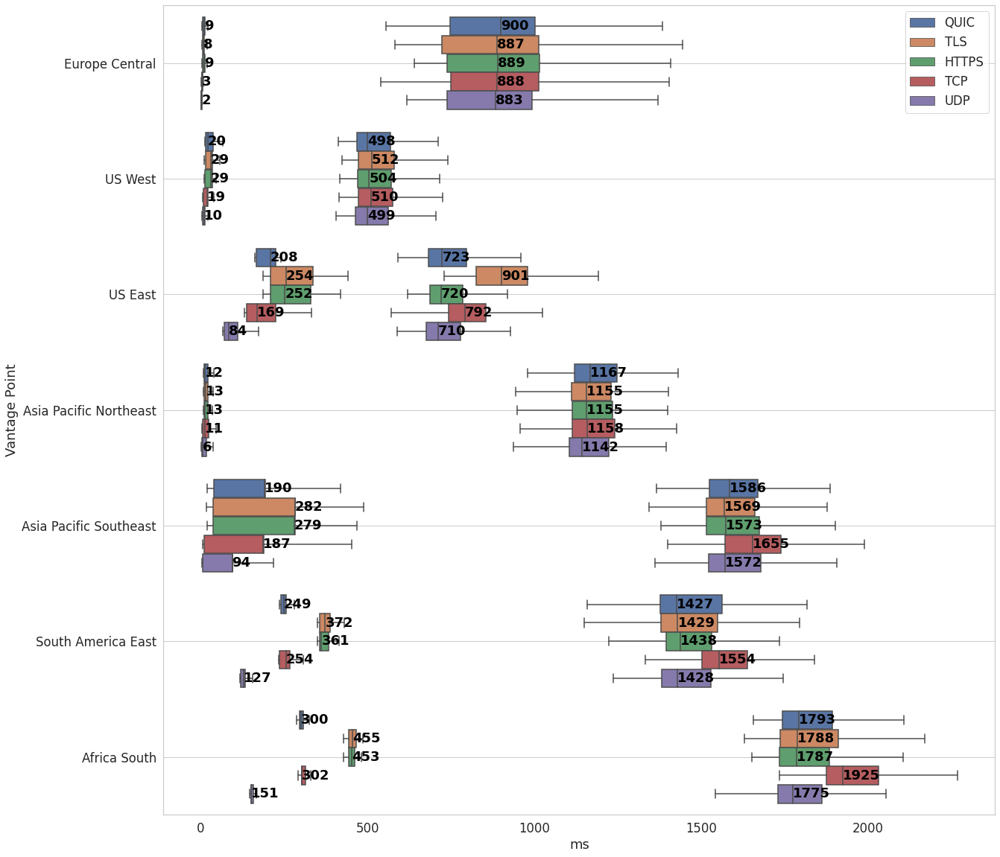

**www.youtube.com**

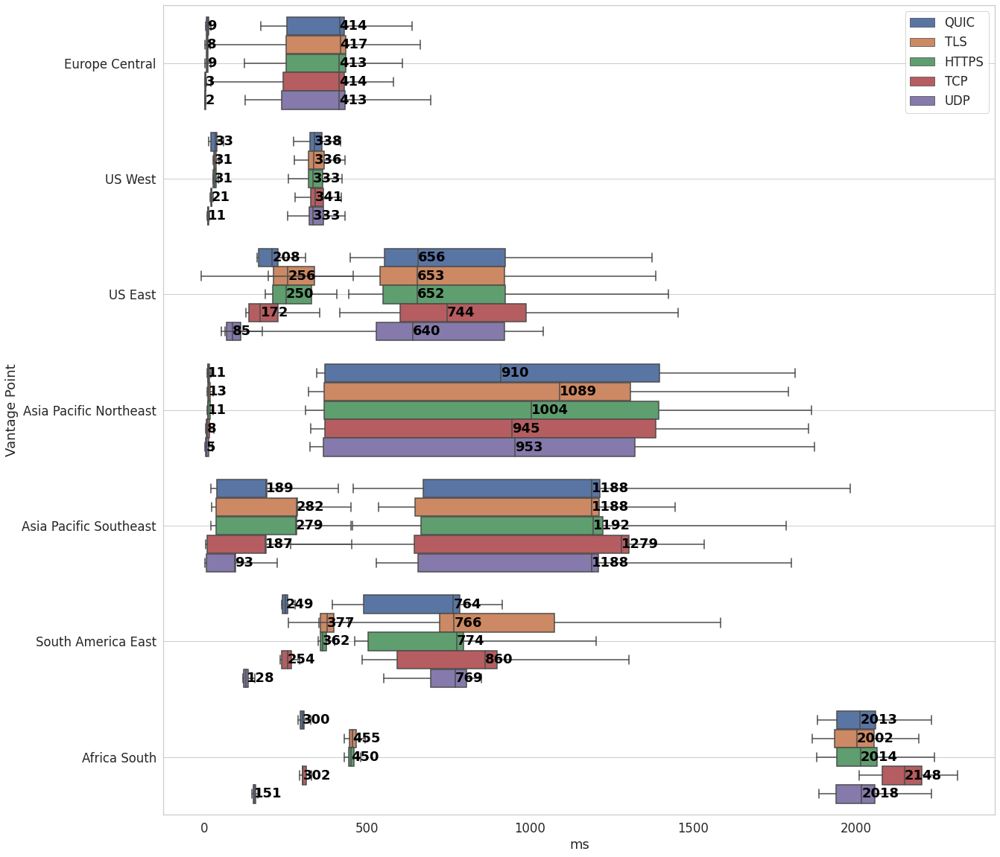

**www.microsoft.com**

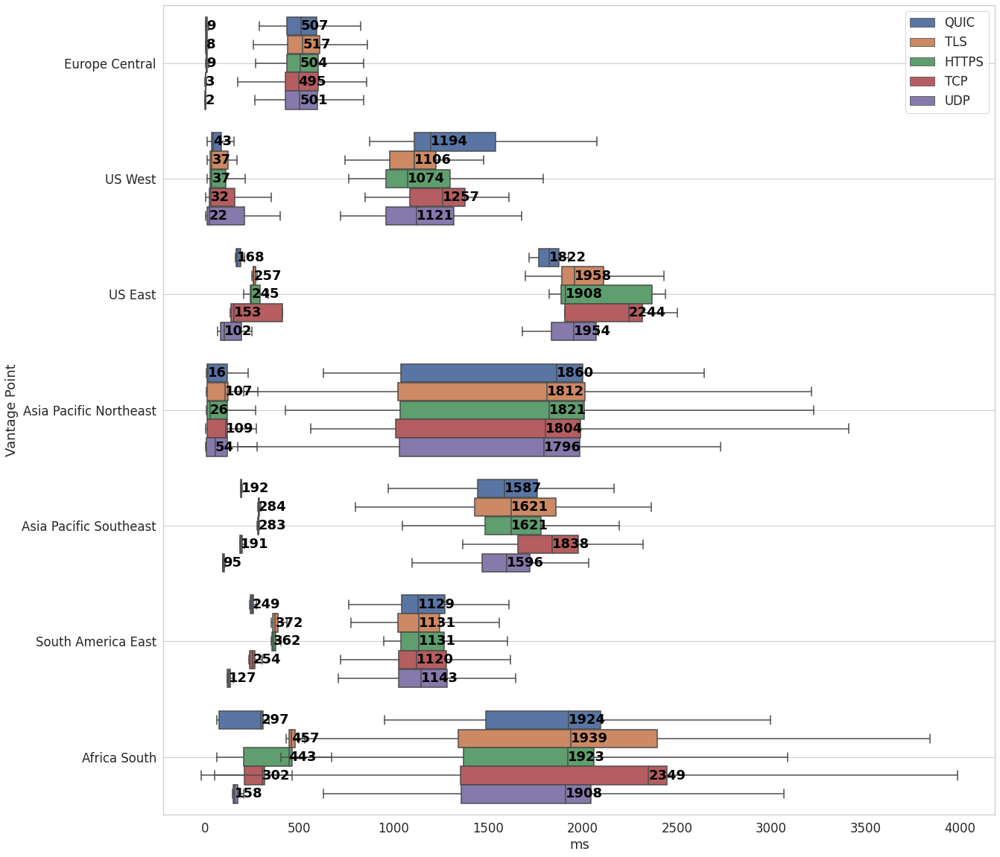

**All**

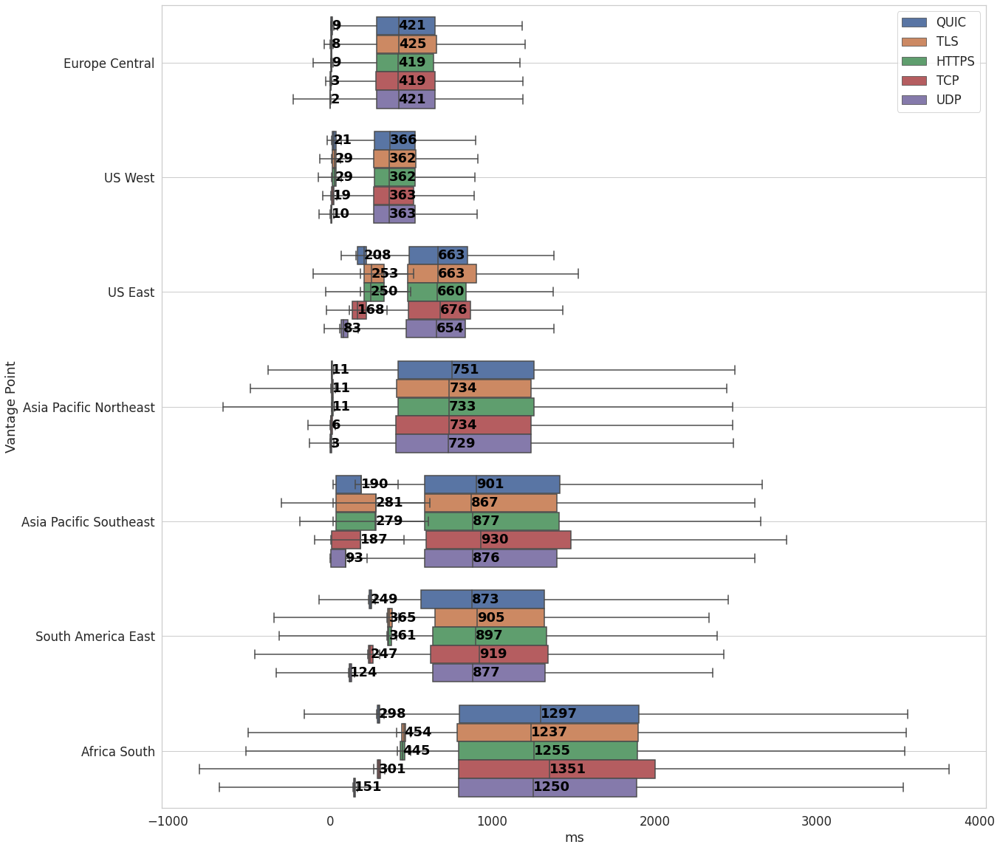

In [63]:
printmd(f"***Vantage Point Comparison (Lookup End - Difference between Lookup End and FCP)***")
plt.rcParams["figure.figsize"] = (20,20)
for domain in domain_order:
    multiCompare('domain', domain, 'vantagePoint', ['max_lookup_end', 'difLookupFcp'], ylabel='Vantage Point')
multiCompare('domain', 'All', 'vantagePoint', ['max_lookup_end', 'difLookupFcp'], ylabel='Vantage Point')

# Heatmaps

In [34]:
def createHeatmap(param='timeByTransferSize', fmt='.3g', aggfunc=np.mean, data=df):
    plt.rcParams["figure.figsize"] = (8,6)
    sns.set(font_scale=1.2)
    heatmap_data = pd.pivot_table(data, values=param,
                         index=['vantagePoint'],
                         columns='protocol',
                         aggfunc=aggfunc)
    sns.heatmap(heatmap_data, annot=True, fmt=fmt, cmap='Reds')
    plt.yticks(rotation=0) 
    plt.show()

***Page Load Time in Relation to Decoded Body Size (aggregation function: mean)***

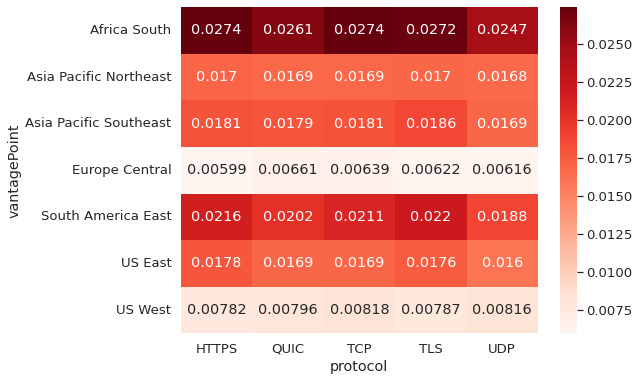

In [35]:
printmd(f"***Page Load Time in Relation to Decoded Body Size (aggregation function: mean)***")

createHeatmap('timeByDecodedSize')

***Page Load Time in Relation to Transfer Size (aggregation function: mean)***

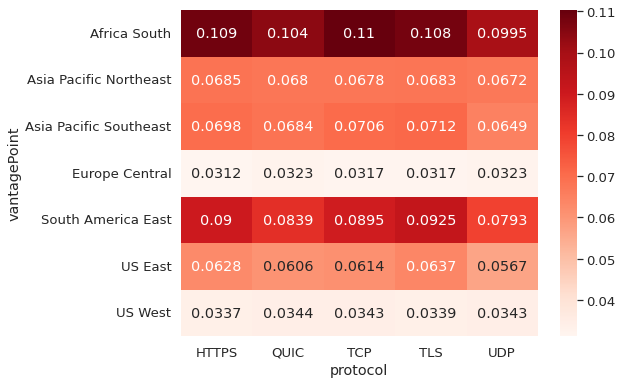

In [36]:
printmd(f"***Page Load Time in Relation to Transfer Size (aggregation function: mean)***")

createHeatmap()

***Page Load Time in Relation to Transfer Size (aggregation function: median)***

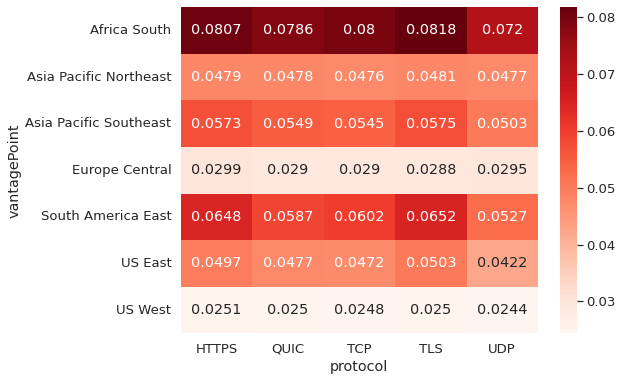

In [37]:
printmd(f"***Page Load Time in Relation to Transfer Size (aggregation function: median)***")

createHeatmap(aggfunc=np.median)

***Page Load Time (aggregation function: median)***

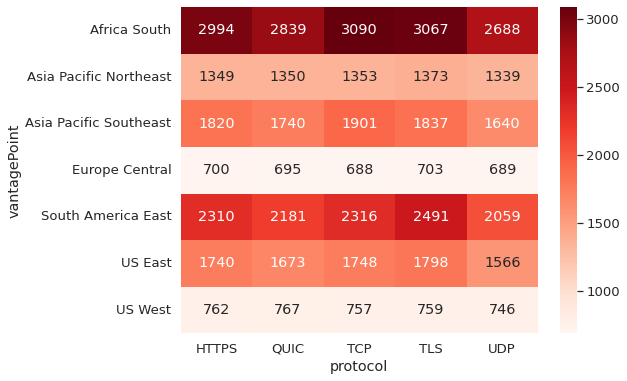

In [38]:
printmd(f"***Page Load Time (aggregation function: median)***")

createHeatmap('loadEventEnd', '.0f', np.median)

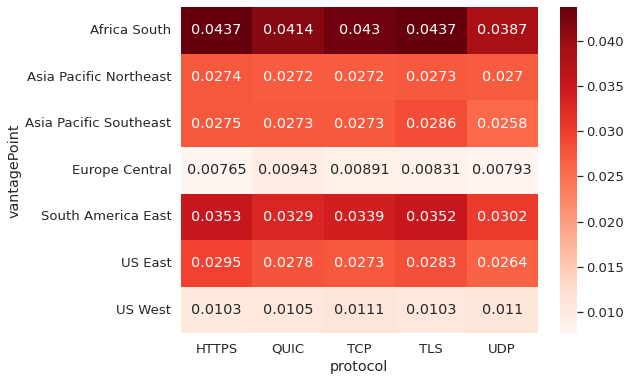

In [39]:
# compare lightweight pages to heavyweight pages
createHeatmap('timeByDecodedSize', '.3g', np.mean, df[df['decodedBodySize'] < 100000])

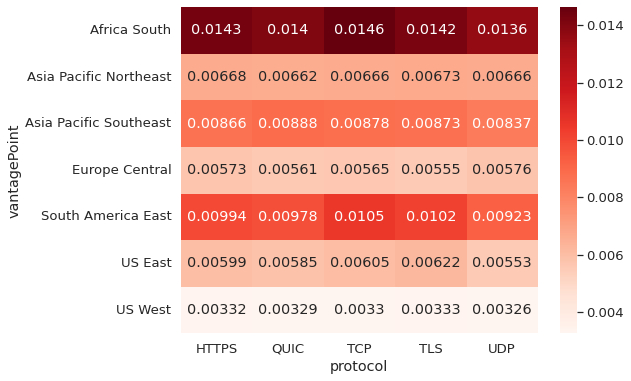

In [40]:
createHeatmap('timeByDecodedSize', '.3g', np.mean, df[df['decodedBodySize'] > 250000])

# Correlation Matrices

In [223]:
df_corr = df[['responseStart', 'firstContentfulPaint', 'avg_lookup_end', 'elapsed', 'min_lookup_end', 'loadEventEnd', 'timeByTransferSize', 'timeByDecodedSize']].copy()
corrMatrix = df_corr.corr()[['avg_lookup_end']].sort_values(by='avg_lookup_end', ascending=False)

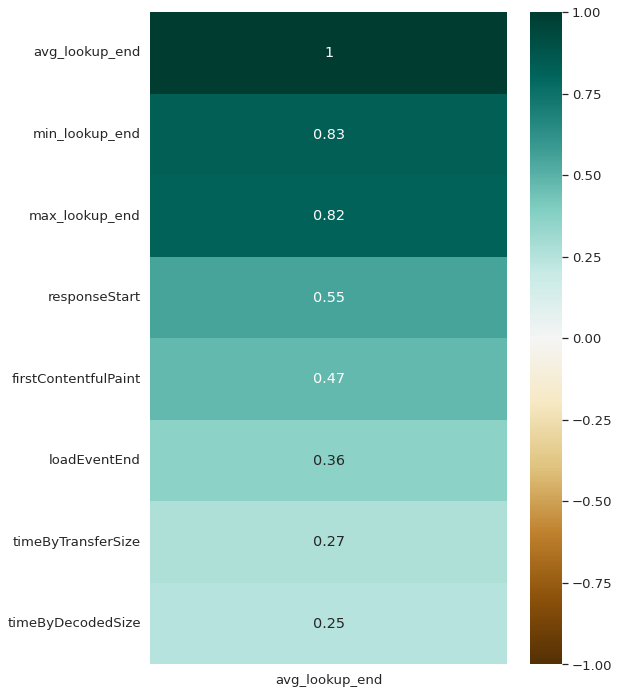

In [42]:
plt.rcParams["figure.figsize"] = (8, 12)
sns.heatmap(corrMatrix, annot=True, cmap='BrBG', vmin=-1, vmax=1)
plt.show()

In [220]:
df_corr_2 = df[df['vantagePoint'] == 'Africa South']
df_corr_2 = df_corr_2[['responseStart', 'firstContentfulPaint', 'avg_lookup_end', 'max_lookup_end', 'min_lookup_end', 'loadEventEnd', 'protocol']].copy()
df_corr_2['protocol'] = df_corr_2['protocol'].astype('category').cat.codes

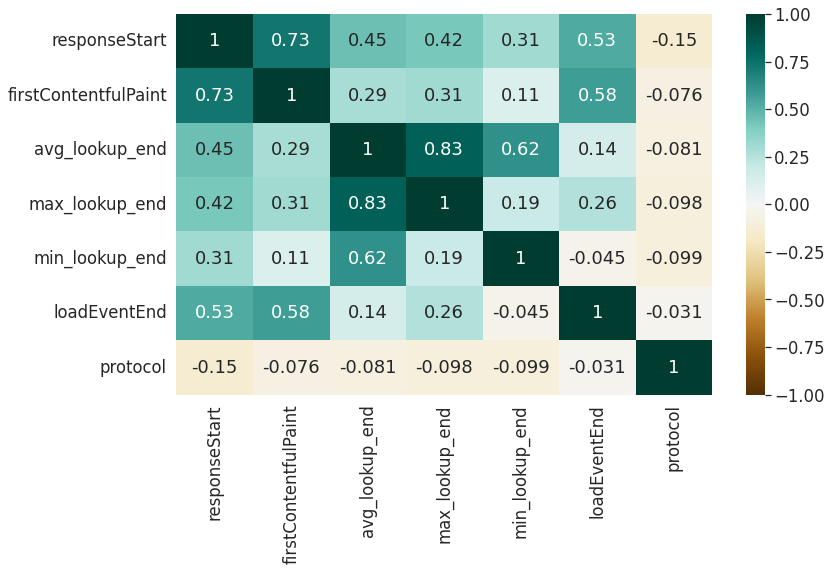

In [224]:
plt.rcParams["figure.figsize"] = (12, 7)
sns.heatmap(df_corr_2.corr(), annot=True, cmap='BrBG', vmin=-1, vmax=1)
plt.show()

**QUIC**

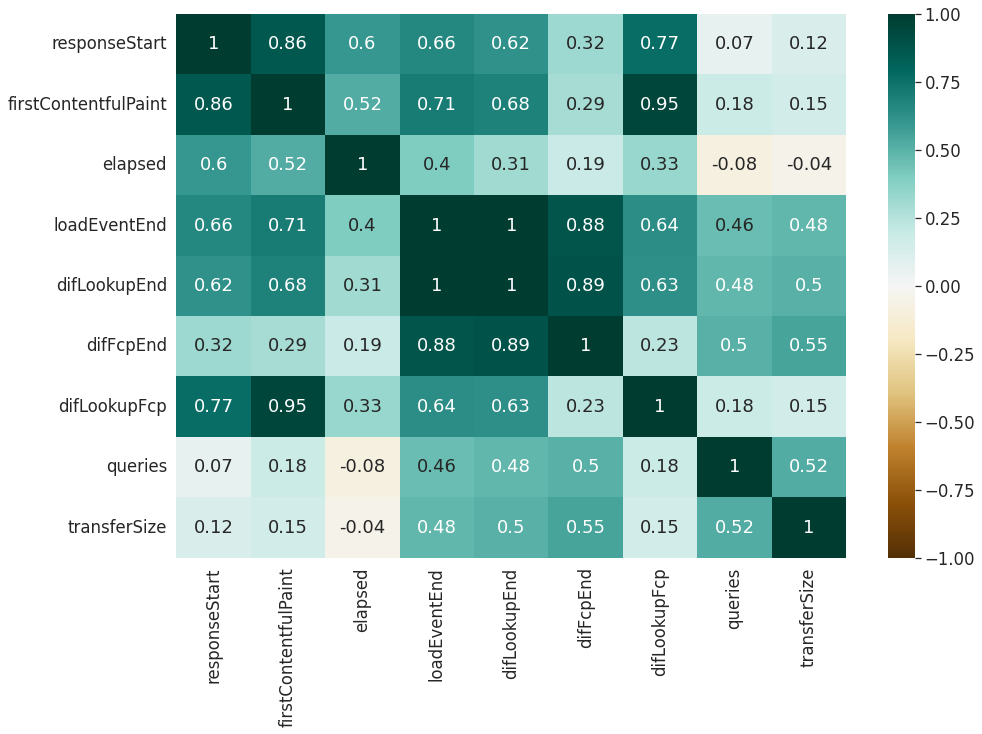

**TLS**

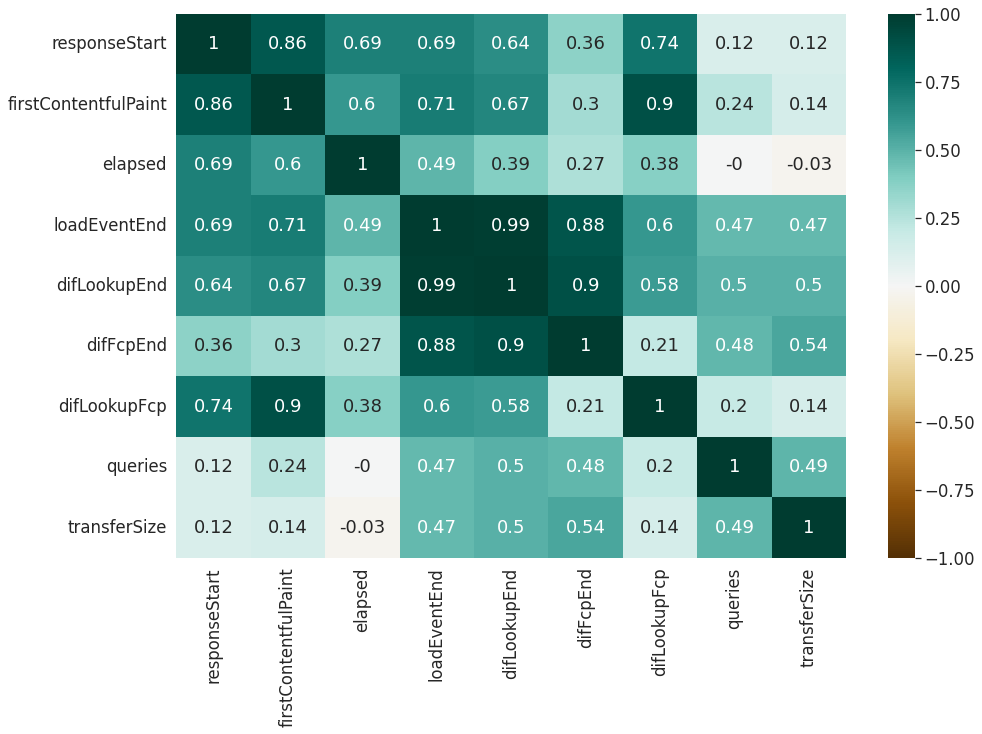

**HTTPS**

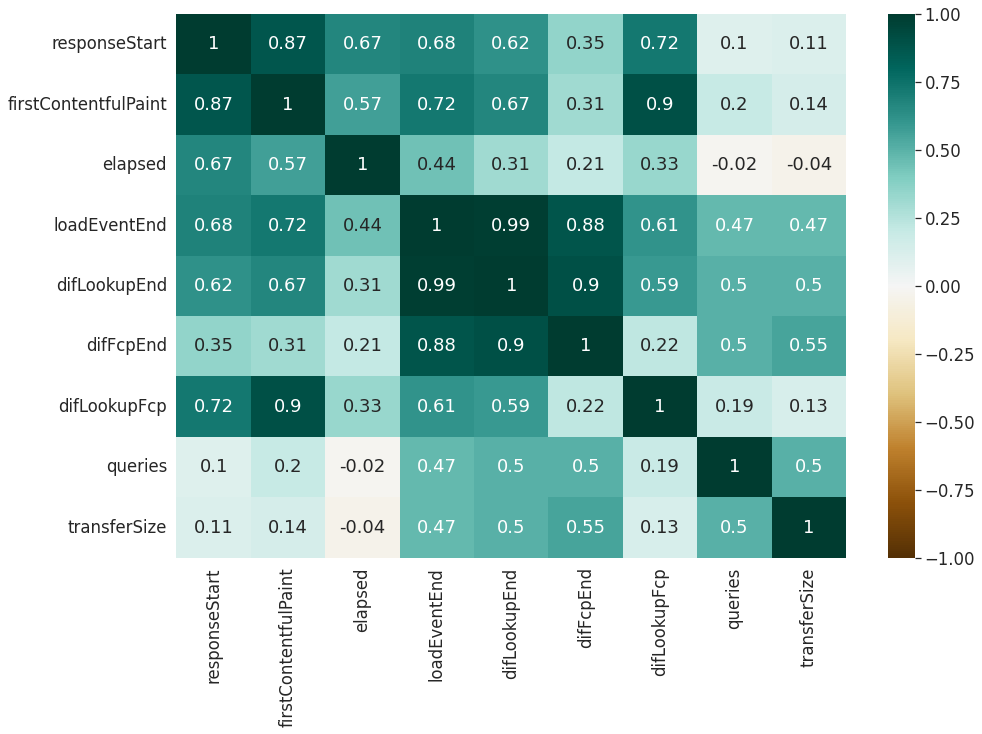

**TCP**

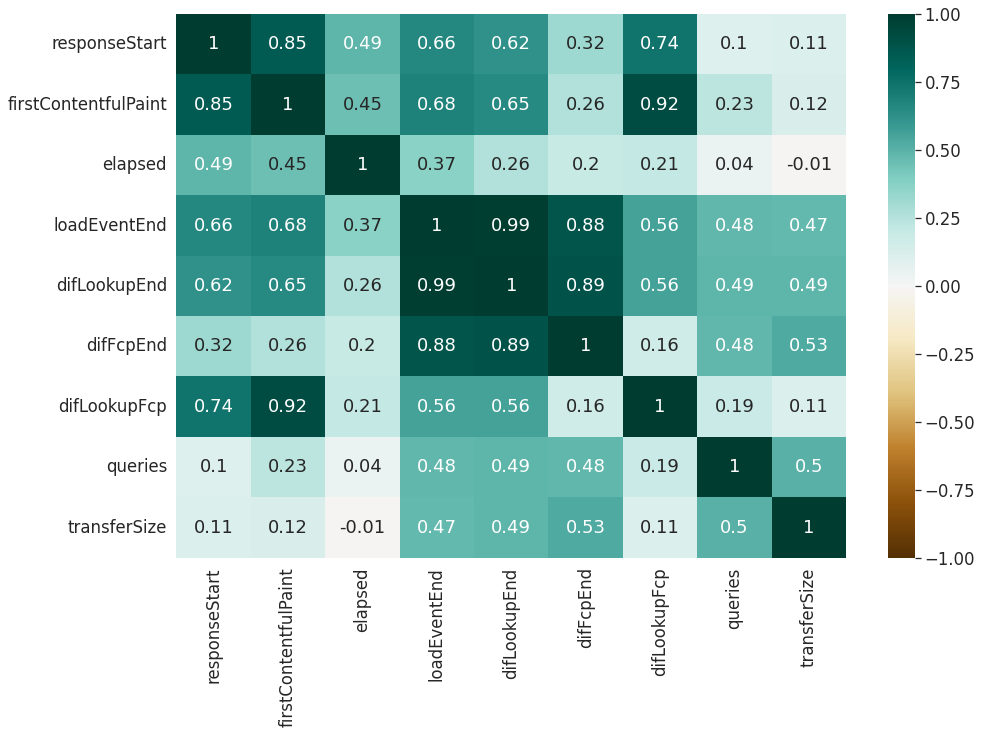

**UDP**

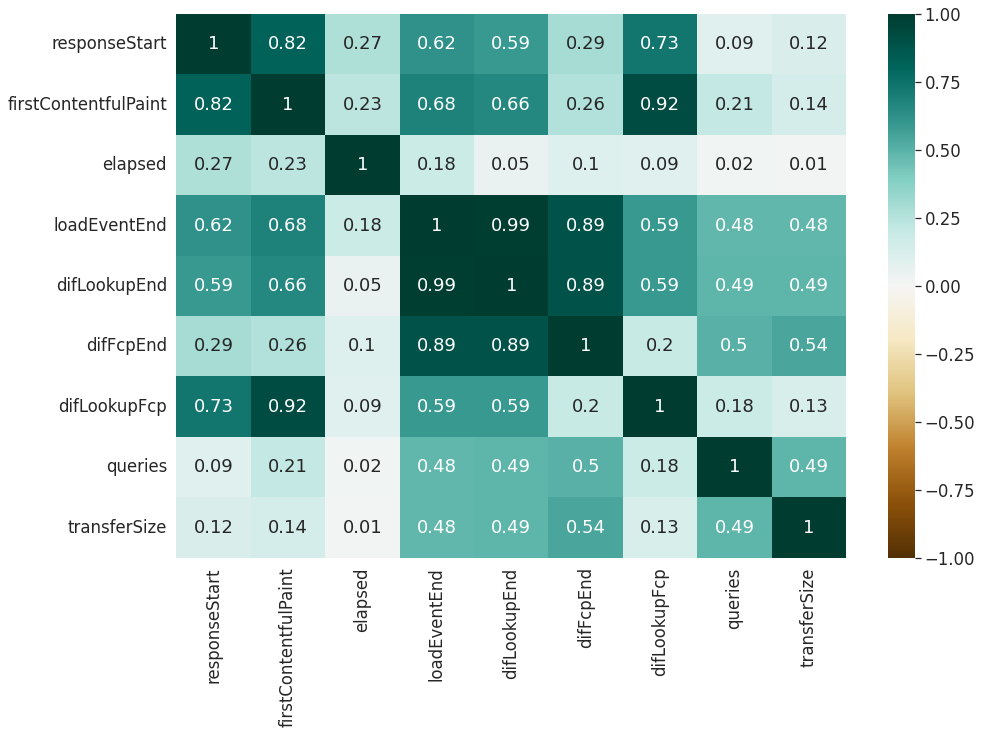

In [225]:
df_corr_3 = df.copy()
df_corr_3 = df_corr_3[['responseStart', 'firstContentfulPaint', 'elapsed', 'loadEventEnd', 'difLookupEnd', 'difFcpEnd', 'difLookupFcp', 'queries', 'transferSize', 'protocol']].copy()
plt.rcParams["figure.figsize"] = (15, 10)
for protocol in protocols:
    printmd(f"**{protocol}**")
    df_corr_new = df_corr_3[df_corr_3['protocol'] == protocol].copy()
    sns.heatmap(round(df_corr_new.corr(), 2), annot=True, cmap='BrBG', vmin=-1, vmax=1)
    plt.show()

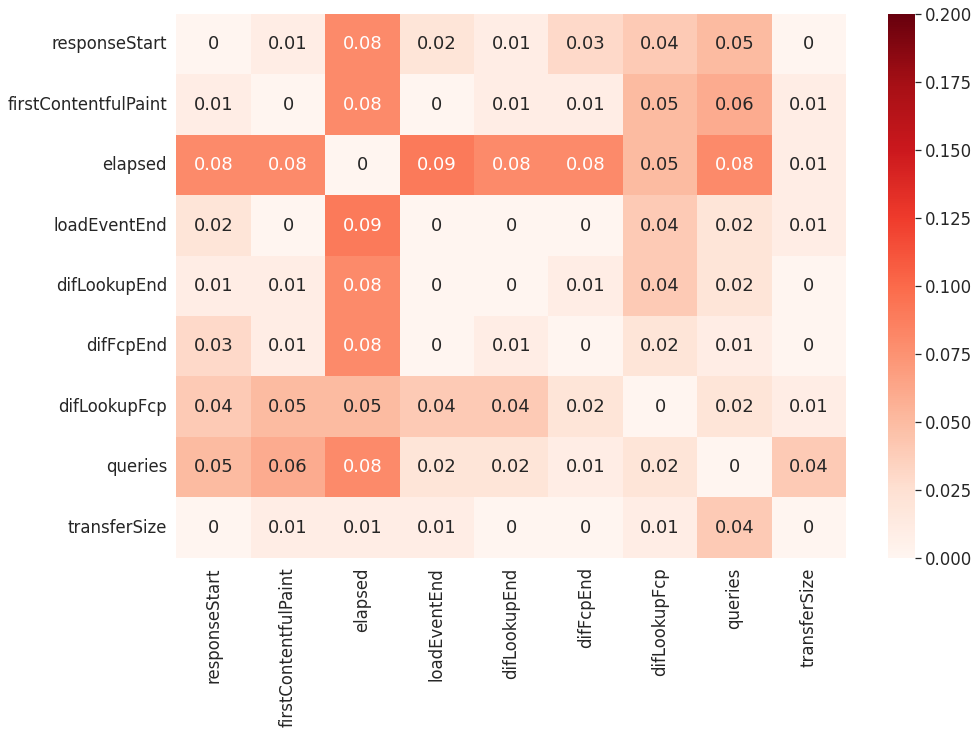

In [226]:
# compare correlation matrixes
tls_quic = df_corr_3[df_corr_3['protocol'] == 'TLS'].copy().corr() - df_corr_3[df_corr_3['protocol'] == 'QUIC'].copy().corr()
new_df = round(tls_quic, 2).abs()
sns.heatmap(new_df, annot=True, cmap='Reds', vmin=0, vmax=0.2)
plt.show()

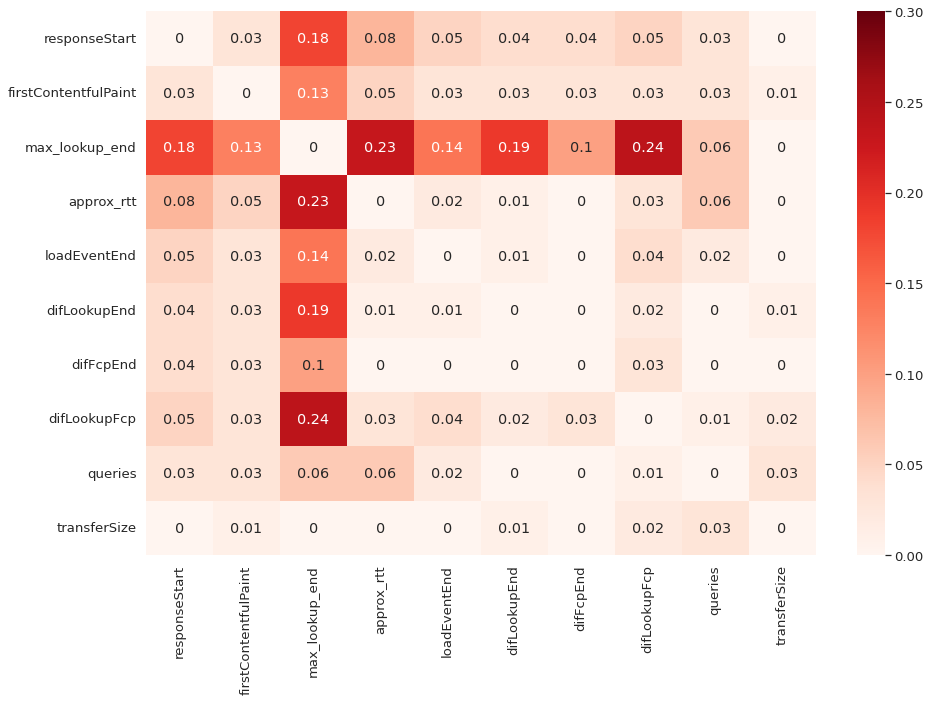

In [47]:
udp_quic = df_corr_3[df_corr_3['protocol'] == 'UDP'].copy().corr() - df_corr_3[df_corr_3['protocol'] == 'QUIC'].copy().corr()
new_df = round(udp_quic, 2).abs()
sns.heatmap(new_df, annot=True, cmap='Reds', vmin=0, vmax=0.3)
plt.show()

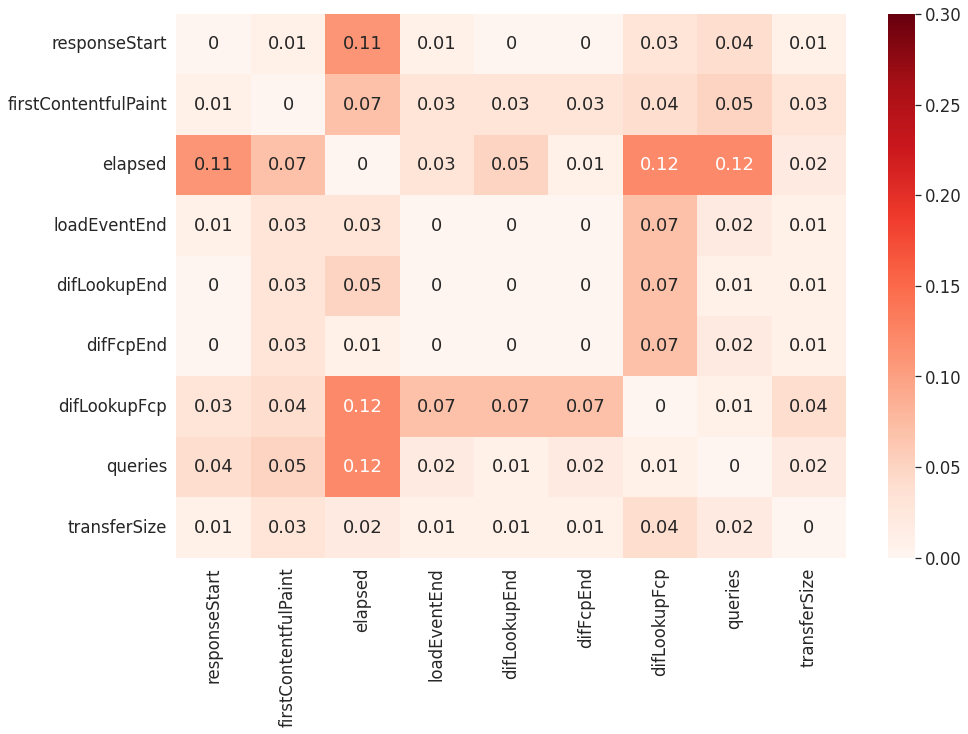

In [227]:
tcp_quic = df_corr_3[df_corr_3['protocol'] == 'TCP'].copy().corr() - df_corr_3[df_corr_3['protocol'] == 'QUIC'].copy().corr()
new_df = round(tcp_quic, 2).abs()
sns.heatmap(new_df, annot=True, cmap='Reds', vmin=0, vmax=0.3)
plt.show()

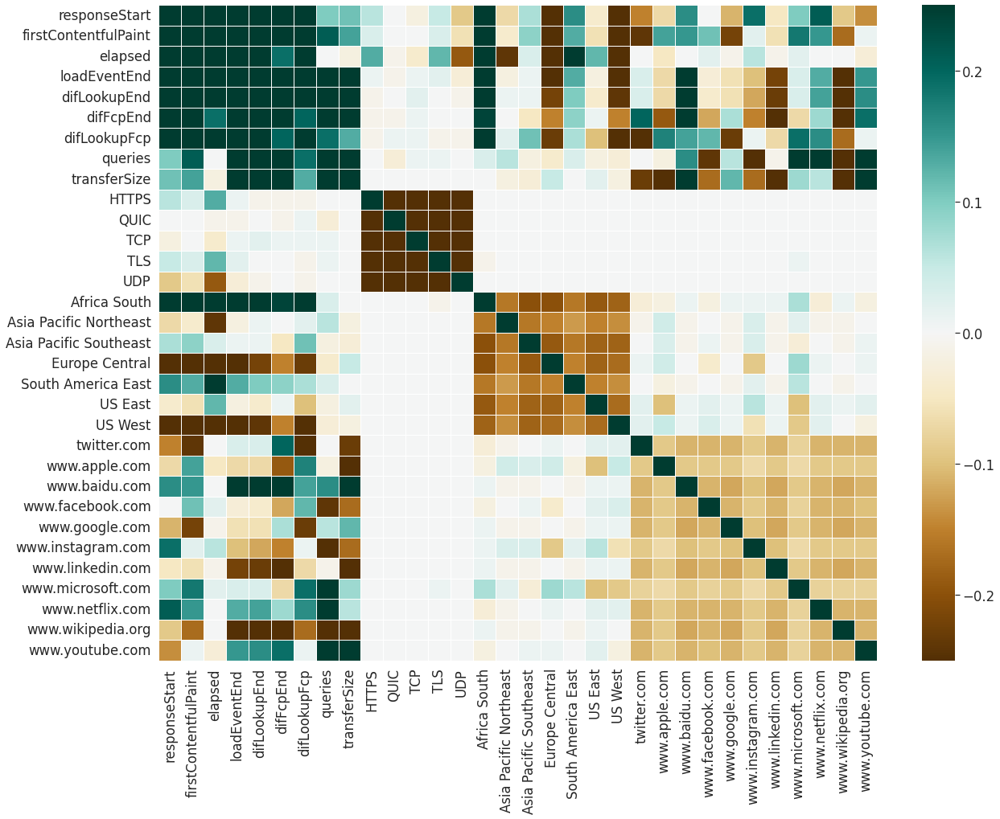

In [230]:
df_corr_4 = df.copy()
df_corr_4 = df_corr_4[['responseStart', 'firstContentfulPaint', 'elapsed', 'loadEventEnd', 'difLookupEnd', 'difFcpEnd', 'difLookupFcp', 'queries', 'transferSize', 'protocol', 'vantagePoint', 'domain']]
df_corr_4 = pd.get_dummies(df_corr_4, columns=['protocol', 'vantagePoint', 'domain'], prefix_sep='', prefix='')

plt.rcParams["figure.figsize"] = (20, 15)
sns.heatmap(round(df_corr_4.corr(), 2), annot=False, cmap='BrBG', vmin=-0.25, vmax=0.25, linewidths=.5)
plt.show()

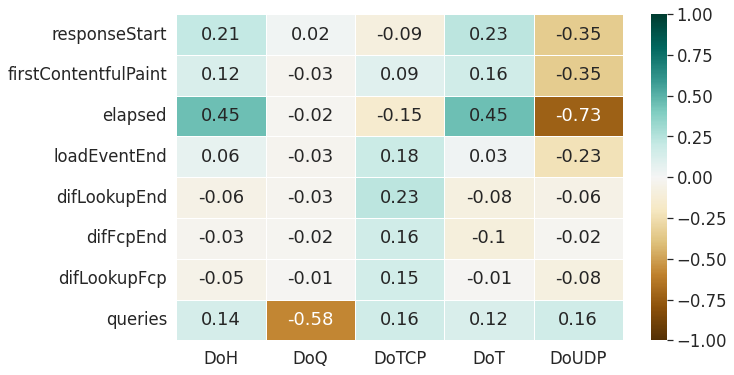

In [230]:
df_corr_4 = df[df['vantagePoint'] == 'South America East'].copy()
df_corr_4 = df_corr_4[df_corr_4['domain'] == 'www.netflix.com']
df_corr_4 = df_corr_4[['responseStart', 'firstContentfulPaint', 'elapsed', 'loadEventEnd', 'difLookupEnd', 'difFcpEnd', 'difLookupFcp', 'queries', 'transferSize', 'protocol']]
df_corr_4 = pd.get_dummies(df_corr_4, columns=['protocol'], prefix_sep='', prefix='').rename(columns={'QUIC': 'DoQ', 'HTTPS': 'DoH', 'TLS': 'DoT', 'UDP': 'DoUDP', 'TCP':'DoTCP'})
corr = df_corr_4.corr().iloc[0:8,9:14]
plt.rcParams["figure.figsize"] = (10, 6)
sns.heatmap(round(corr, 2), annot=True, cmap='BrBG', vmin=-1, vmax=1, linewidths=.5)
plt.show()

## Misc

**All vantage Points**

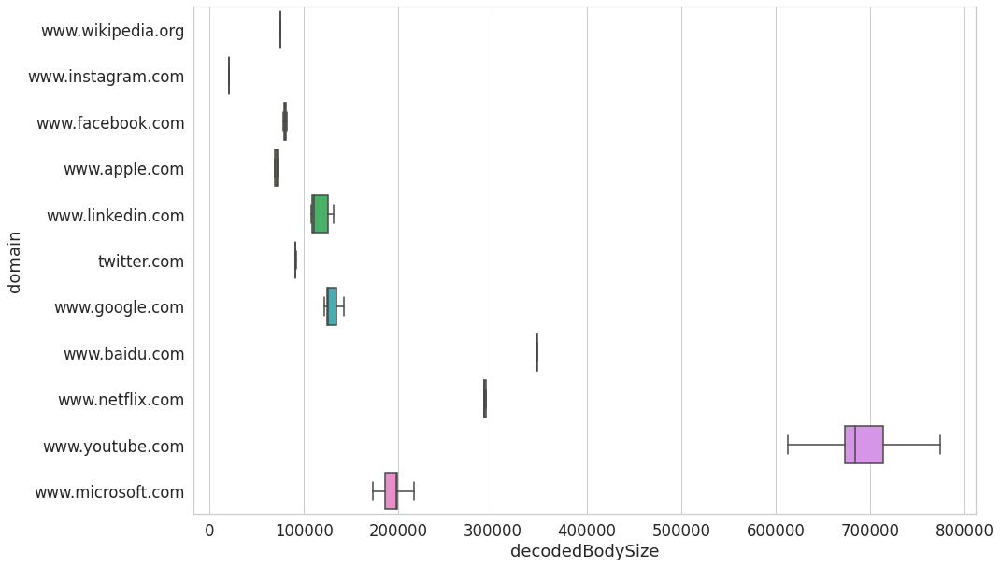

In [219]:
plt.rcParams["figure.figsize"] = (15,10)

printmd(f"**All vantage Points**")
ax = sns.boxplot(x='decodedBodySize', y='domain', data=df, order=domain_order, showfliers=False)
plt.show()

In [216]:
def compareQueries(domain, protocol=None):
    plt.rcParams["figure.figsize"] = (25,10)
    df_domain = df[df['domain'] == domain]
    if protocol:
        df_domain = df[df['protocol'] == protocol]
        printmd(f"**{protocol}**")
    
    printmd(f"**{domain}**")
    fig, axs = plt.subplots(2, 4, sharex=True)
    i = 0
    for vantagePoint in vp_order:
        ax = axs[int(i/4),i%4]
        df_vp = df_domain[df_domain['vantagePoint'] == vantagePoint]
        df_vp['queries'].hist(bins=10, label=vantagePoint, ax=ax)
        print(f"{vantagePoint}: {df_vp['queries'].mean()}")
        ax.set_title(vantagePoint)
        ax.tick_params(labelbottom=True)
        ax.set_xlim(0, 40)
        i+=1
    print(f"All: {df_domain['queries'].mean()}")
    df_domain['queries'].hist(bins=10, label='All', ax=axs[1,3])
    axs[1,3].set_title('All')
    plt.show()

**www.netflix.com**

US East: 5.991889312977099
US West: 6.411428571428571
South America East: 7.966174368747023
Europe Central: 6.781324440209624
Asia Pacific Southeast: 7.916070577014783
Asia Pacific Northeast: 7.987136731777037
Africa South: 7.627102354637193
All: 7.2397927884943085


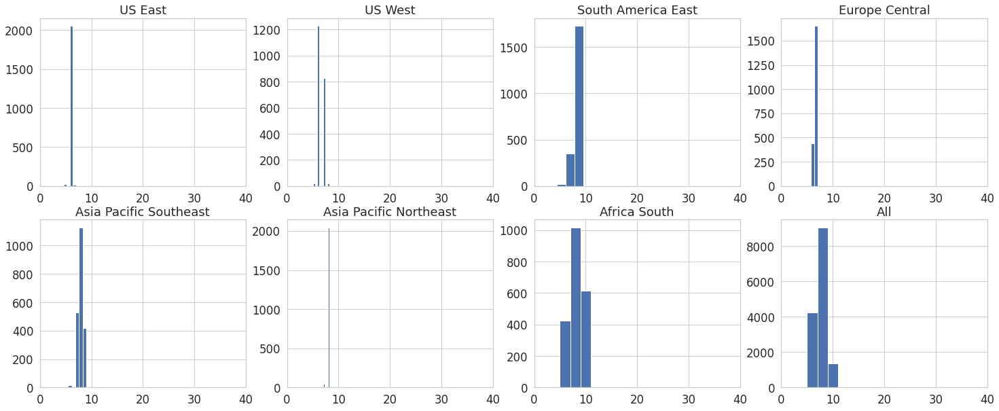

In [534]:
compareQueries('www.netflix.com')

**QUIC**

**www.netflix.com**

US East: 5.020246129416435
US West: 5.017070265978563
South America East: 4.434411589601111
Europe Central: 4.167295098233777
Asia Pacific Southeast: 4.675223880597015
Asia Pacific Northeast: 5.107008139765734
Africa South: 4.466859983429992
All: 4.699663280447438


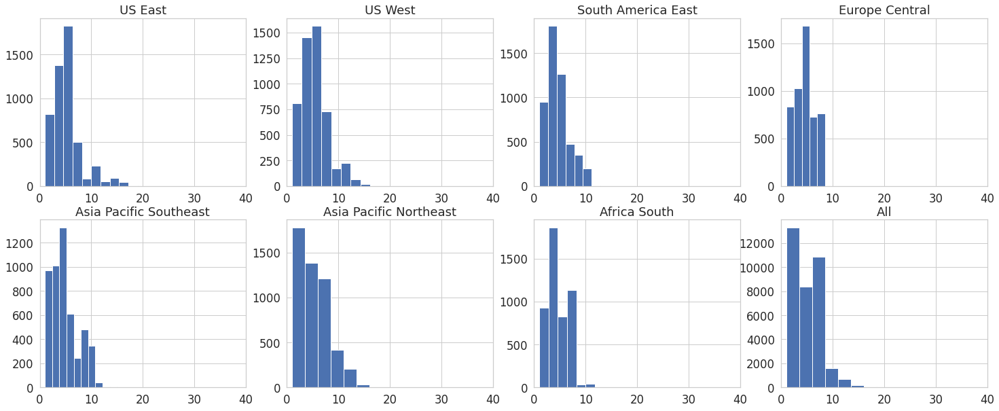

**TLS**

**www.netflix.com**

US East: 5.089122667725288
US West: 5.030760071442747
South America East: 4.876761262155189
Europe Central: 4.190873015873016
Asia Pacific Southeast: 4.767150526943726
Asia Pacific Northeast: 5.1360746920937626
Africa South: 4.952750809061489
All: 4.862282664830436


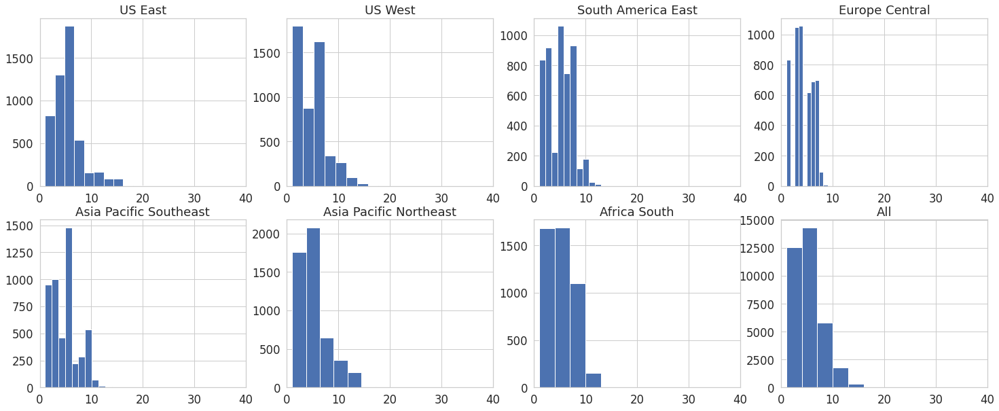

**HTTPS**

**www.netflix.com**

US East: 5.079841112214498
US West: 5.029575228265185
South America East: 4.839023421992854
Europe Central: 4.1752679634775705
Asia Pacific Southeast: 4.749106788408098
Asia Pacific Northeast: 5.121796145440095
Africa South: 4.8958204653078035
All: 4.84114947116344


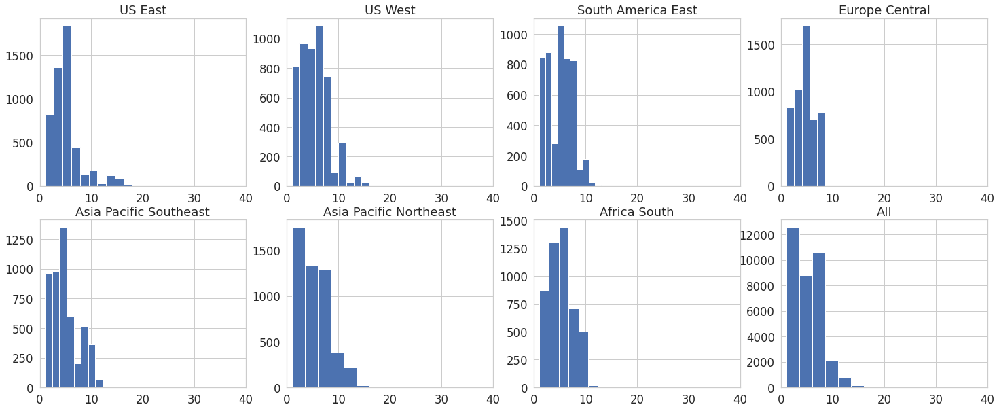

**TCP**

**www.netflix.com**

US East: 4.998213576816197
US West: 5.01726875744343
South America East: 4.868055555555555
Europe Central: 4.180464562239428
Asia Pacific Southeast: 4.831380337636544
Asia Pacific Northeast: 5.1467143140758385
Africa South: 4.9049876339653755
All: 4.8493029620549075


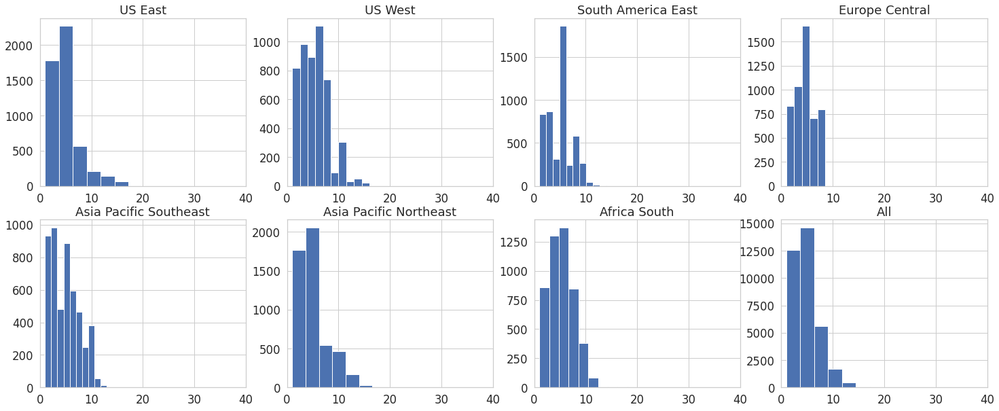

**UDP**

**www.netflix.com**

US East: 5.035912698412698
US West: 5.004366812227074
South America East: 4.839618896387456
Europe Central: 4.184163524508831
Asia Pacific Southeast: 4.740079365079365
Asia Pacific Northeast: 5.140127388535032
Africa South: 4.8958204653078035
All: 4.8338465047325805


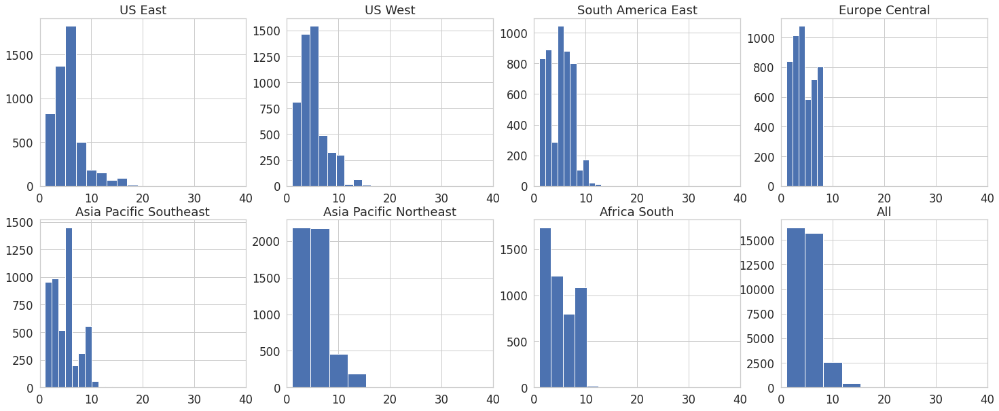

In [533]:
for protocol in protocols:
    compareQueries('www.netflix.com', protocol)

In [54]:
#connection.close()

**www.netflix.com**

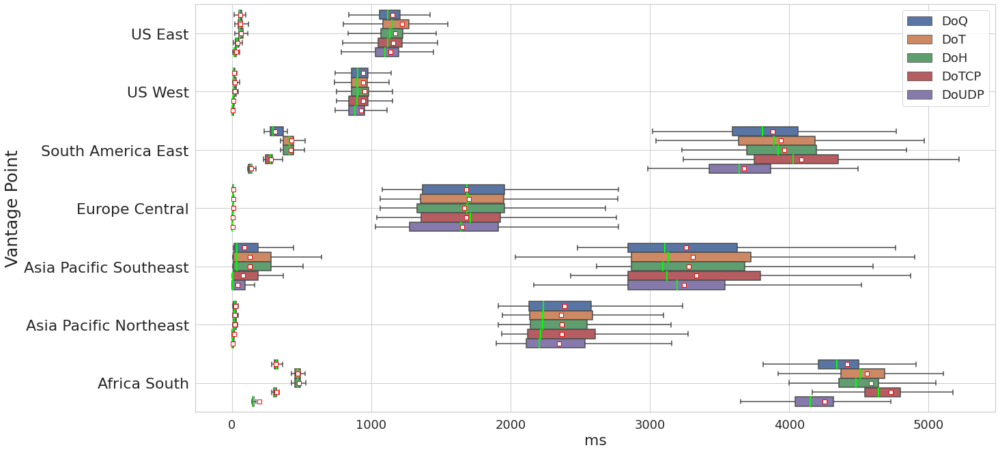

In [544]:
plt.rcParams["figure.figsize"] = (21,11)
multiCompare('domain', 'www.netflix.com', 'vantagePoint', ['elapsed', 'loadEventStart'], ylabel='Vantage Point', save='vp-netflix-presentation', medians=False)

**Asia Pacific Southeast**

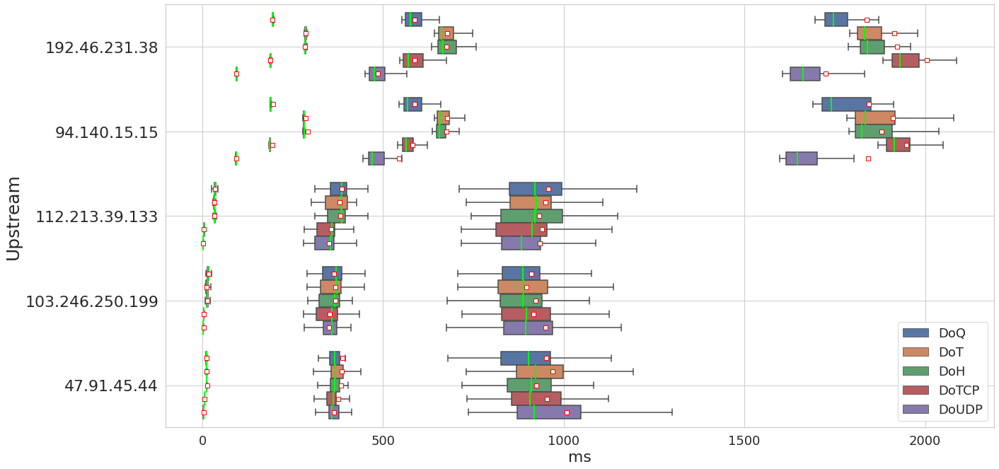

In [545]:
plt.rcParams["figure.figsize"] = (21,11)
multiCompare('vantagePoint', 'Asia Pacific Southeast', 'server', ['elapsed', 'responseStart', 'loadEventStart'], server_domain='www.google.com', ylabel='Upstream', medians=False, save='ap-southeast-upstreams-presentation')

In [559]:
def specialPlot(this_df, half='1st', first='vantagePoint', first_val='All', second='domain', value_vars=['max_lookup_end', 'firstContentfulPaint', 'loadEventEnd'], medians=True, xlabel='ms', ylabel=None, server_domain=None, showfliers=False, xlim=None, save=None, showmeans=True):
    printmd(f"**{first_val}**")
    sns.set(font_scale=1.5)
    sns.set_style("whitegrid")
    
    df_filtered = this_df[this_df[first] == first_val].copy()
    
    if second == 'vantagePoint':
        order = vp_order
    if second == 'domain':
        order = []
        for index, row in df_new.iterrows():
            domain_string = f"{index} ({int(row['queries'])})"
            df_filtered.loc[df_filtered.domain==index, 'domain'] = domain_string
            order.append(domain_string)
    if half == '1st':
        order = order[:6]
    else:
        order = order[6:]
            
    if second == 'server':
        order = df_filtered['server'].unique().tolist()
        if server_domain:
            df_filtered = df_filtered[df_filtered['domain'] == server_domain]

    df_melted = pd.melt(df_filtered, id_vars=['protocol', second], value_vars=value_vars)
    axes = []
    for i, val_var in enumerate(value_vars):
        axes.append(sns.boxplot(x='value', y=second, meanprops=dict(markerfacecolor='white', markeredgecolor='red', marker='s'), medianprops=dict(color="lime", alpha=1, linewidth=2), hue='protocol', hue_order=protocols, data=df_melted[df_melted['variable'] == val_var], orient='h', showfliers=showfliers, showmeans=showmeans, order=order))
        if i == 0:
            ax0 = axes[0]
            handles, labels = ax0.get_legend_handles_labels()
        ax = axes[i]
        
        # set alpha
        #for patch in ax.artists:
        #   r, g, b, a = patch.get_facecolor()
        #   patch.set_facecolor((r, g, b, .9))
        
    if not ylabel:
        ylabel=second
    if xlim:
        ax0.set_xlim(xlim[0], xlim[1])
    ax0.set_ylabel(ylabel, fontsize=25)
    ax0.set_xlabel(xlabel, fontsize=22)
    ax0.tick_params(axis='y', labelsize=22)
    ax0.tick_params(axis='x', labelsize=18)
    ax0.grid(True)
    
    # medians
    if medians:
        for i, val_var in enumerate(value_vars):
            data=df_melted[df_melted['variable'] == val_var].copy()
            data[second] = pd.Categorical(data[second], order)
            data['protocol'] = pd.Categorical(data['protocol'], protocols)
            m1  = data.sort_values([second, 'protocol']).groupby([second, 'protocol'])['value'].median().values
            ax = axes[i]
            annotate_medians(ax, m1)
    
    plt.legend(handles, ['DoQ', 'DoT', 'DoH', 'DoTCP', 'DoUDP'], loc='best', fontsize='medium')
    if save:
        plt.savefig(f"figures/{save}.pdf", bbox_inches='tight')
    plt.show()

In [564]:
first_domain_half_df = df[(df['domain'] == 'www.wikipedia.org') | (df['domain'] == 'www.instagram.com') | (df['domain'] == 'www.facebook.com') | (df['domain'] == 'www.amazon.com') | (df['domain'] == 'www.apple.com') | (df['domain'] == 'www.linkedin.com')].copy()
second_domain_half_df = df[(df['domain'] != 'www.wikipedia.org') & (df['domain'] != 'www.instagram.com') & (df['domain'] != 'www.facebook.com') & (df['domain'] != 'www.amazon.com') & (df['domain'] != 'www.apple.com') & (df['domain'] != 'www.linkedin.com')].copy()

**Africa South**

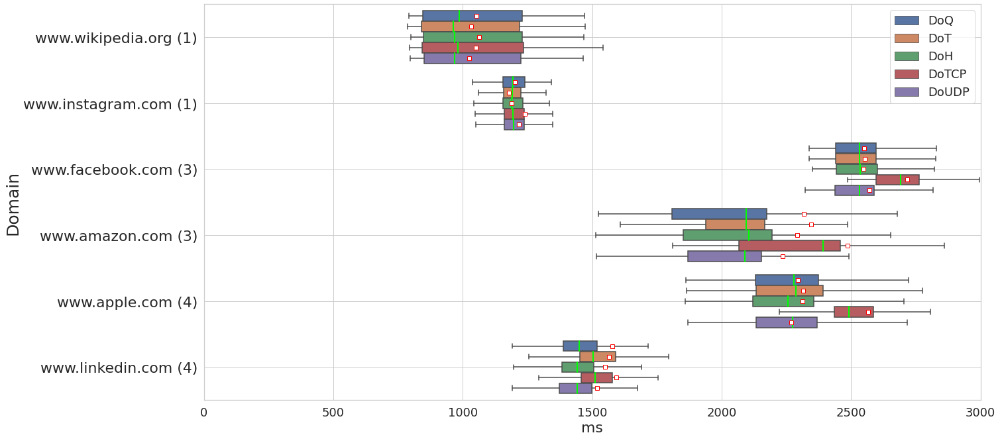

In [566]:
plt.rcParams["figure.figsize"] = (21,11)
specialPlot(first_domain_half_df, '1st', 'vantagePoint', 'Africa South', 'domain', ['difLookupEnd'], ylabel='Domain', save='domains-af-presentation', medians=False, xlim=(0,3000))

**Africa South**

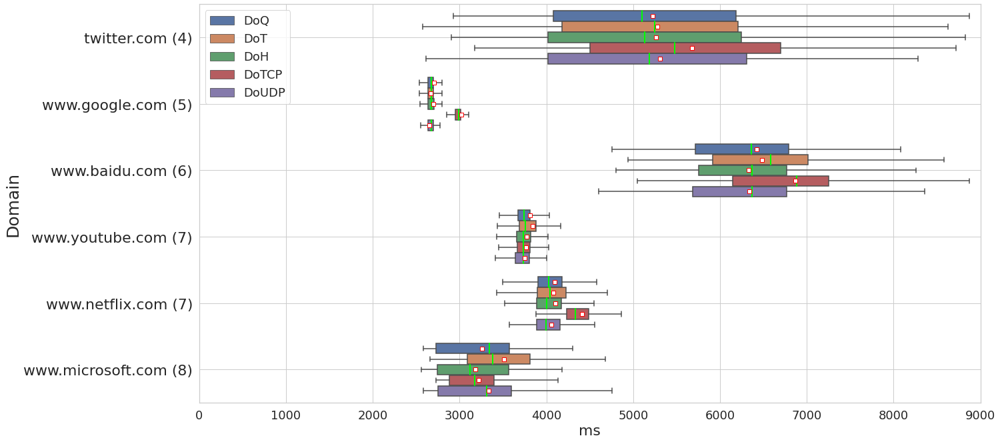

In [565]:
plt.rcParams["figure.figsize"] = (21,11)
specialPlot(second_domain_half_df, '2nd', 'vantagePoint', 'Africa South', 'domain', ['difLookupEnd'], ylabel='Domain', save='domains-af-presentation-2', medians=False, xlim=(0,9000))

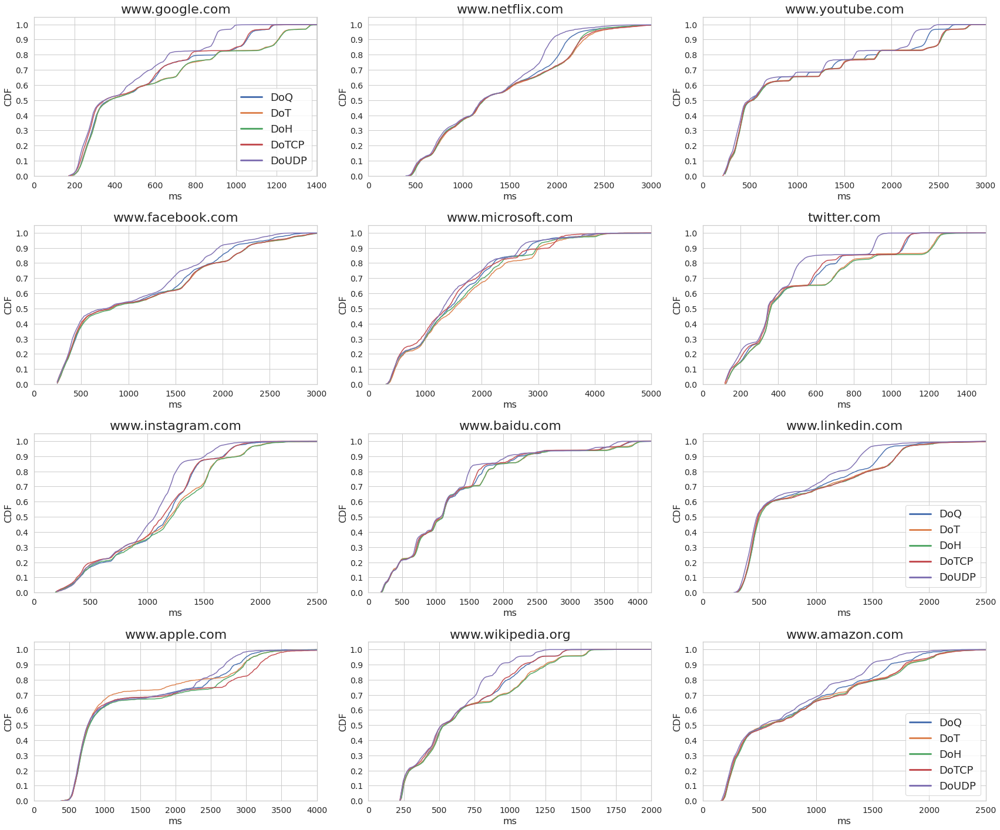

In [568]:
i = 0
fig, axs = plt.subplots(4, 3, figsize=(24, 20), sharey='col')
axes = []
times = {}

for domain in domain_order:
    dom_df = df[df['domain'] == domain]
    dom_df = dom_df[dom_df['firstContentfulPaint'] > 0]
    for protocol in protocols:
        times[protocol] = dom_df[dom_df['protocol'] == protocol]['firstContentfulPaint']
    ax = axs[int(i/3),i%3]
    sns.lineplot(x=calculateCDF(times['QUIC'])[0], y=calculateCDF(times['QUIC'])[1], label="DoQ", ax=ax)
    sns.lineplot(x=calculateCDF(times['TLS'])[0], y=calculateCDF(times['TLS'])[1], label="DoT", ax=ax)
    sns.lineplot(x=calculateCDF(times['HTTPS'])[0], y=calculateCDF(times['HTTPS'])[1], label="DoH", ax=ax)
    sns.lineplot(x=calculateCDF(times['TCP'])[0], y=calculateCDF(times['TCP'])[1], label="DoTCP", ax=ax)
    sns.lineplot(x=calculateCDF(times['UDP'])[0], y=calculateCDF(times['UDP'])[1], label="DoUDP", ax=ax)

    ax.set_xlabel("ms", fontsize = 16)
    ax.set_ylabel("CDF", fontsize = 16)
    ax.tick_params(labelleft=True)
    ax.tick_params(labelbottom=True)
    ax.set_title(domain, fontsize = 22)
    ax.tick_params(axis='both', labelsize=14)
    ax.set_ylim(0.0, 1.05)
    ax.yaxis.set_ticks(np.arange(0.0, 1.01, 0.1))
    
    switcher = {
        'www.netflix.com': 3000,
        'www.google.com': 1401,
        'www.youtube.com': 3000,
        'www.facebook.com': 3000,
        'twitter.com': 1501,
        'www.instagram.com': 2501,
        'www.linkedin.com': 2501,
        'www.apple.com': 4000,
        'www.wikipedia.org': 2000,
        'www.amazon.com': 2501,
        'www.baidu.com': 4200
    }
    ax.set_xlim(0, switcher.get(domain, 5000))
    
    if i == 11 or i == 0 or i == 8:
        leg = ax.legend(loc="lower right", fontsize='medium')
        for line in leg.get_lines():
            line.set_linewidth(3.0)
    else:
        ax.get_legend().remove()
    fig.tight_layout()

    i += 1
plt.savefig("figures/domains-cdf-presentation.pdf", bbox_inches='tight')
plt.show()